In [155]:
import pandas as pd 
import numpy as np
from sklearn.model_selection import TimeSeriesSplit
from sklearn.ensemble import RandomForestRegressor
from sklearn.metrics import mean_squared_error

# Load the data from the Excel file
file_path = 'P:/CALYX/Cash_Securitisation_Optimisation_20240722.xlsx'
df = pd.read_excel(file_path, sheet_name='Gestion Cash', header=None)

# Extract the relevant parts of the dataframe
series_names_it = df.iloc[32:67, 0].values

# Extract the time series and data series
time_series = df.iloc[4, 10:113]  # Columns K (index 10) to DH (index 113)
data_series_it = df.iloc[32:67, 10:113]  # Rows 33 to 67 (index 32 to 66), columns K (index 10) to DH (index 113)

# Convert the data to a DataFrame with time as the index
data_series_it.columns = time_series.values
data_series_it.index = series_names_it  # Adjust the index to match the original rows

# Transpose the DataFrame and convert the index to datetime
data_series_it = data_series_it.T
data_series_it.index = pd.to_datetime(data_series_it.index, format='%Y-%m-%d')

# Function to create lagged features
def create_lagged_features(df, n_lags=2):
    df_transformed = pd.DataFrame(index=df.index)
    df_transformed['y'] = df['Close']
    for i in range(1, n_lags + 1):
        df_transformed[f'Lag_{i}'] = df['Close'].shift(i)
    df_transformed.dropna(inplace=True)
    return df_transformed

# Function to perform ensemble learning with TimeSeriesSplit
def perform_ensemble_learning(X, y, n_splits=3):
    tscv = TimeSeriesSplit(n_splits=n_splits)
    ensemble_predictions = []
    actual_values = []
    
    model = RandomForestRegressor(n_estimators=100, random_state=42)

    for train_index, test_index in tscv.split(X):
        X_train, X_test = X.iloc[train_index], X.iloc[test_index]
        y_train, y_test = y.iloc[train_index], y.iloc[test_index]

        model.fit(X_train, y_train)
        predictions = model.predict(X_test)
        
        ensemble_predictions.extend(predictions)
        actual_values.extend(y_test)

    mse = mean_squared_error(actual_values, ensemble_predictions)
    return mse

# Loop through each series, prepare the data, train the model, and evaluate performance
results = {}

for series_name in data_series_it.columns:
    print(f'Processing series: {series_name}')
    df_series = data_series_it[[series_name]].rename(columns={series_name: 'Close'})
    df_transformed = create_lagged_features(df_series, n_lags=2)
    X = df_transformed.drop('y', axis=1).astype(float)
    y = df_transformed['y'].astype(float)
    
    mse = perform_ensemble_learning(X, y, n_splits=3)
    results[series_name] = mse
    
    print(f"Ensemble MSE for {series_name}: {mse}")

# Convert results to DataFrame for better visualization
results_df = pd.DataFrame.from_dict(results, orient='index', columns=['Ensemble MSE'])

# Display the results in a formatted manner
print(f"{'Model':<10} | {'Ensemble MSE':<15}")
print('-' * 30)
for series_name in results_df.index:
    ensemble_mse = results_df.loc[series_name, 'Ensemble MSE']
    print(f"{series_name:<10} | {ensemble_mse:<15.4f}")

# Print the average MSE values in a formatted table
tableau_mse_ensemble_all = f"""
+--------------+--------------+
|   Dataset    |     MSE      |
+--------------+--------------+
"""
for series_name, mse in results.items():
    tableau_mse_ensemble_all += f"| {series_name:<12} | {mse:<12.4f} |\n"
tableau_mse_ensemble_all += "+--------------+--------------+"

print(tableau_mse_ensemble_all)


Processing series: LNACT_Collec
Ensemble MSE for LNACT_Collec: 18757429297407.527
Processing series: LNAAE_Collec
Ensemble MSE for LNAAE_Collec: 1548861810561.3843
Processing series: LNATO_Collec
Ensemble MSE for LNATO_Collec: 9651934300659.867
Processing series: LNAT2_Collec
Ensemble MSE for LNAT2_Collec: 76550483608.24739
Processing series: LNACC_Collec
Ensemble MSE for LNACC_Collec: 82464236669336.5
Processing series: LNACE_Collec
Ensemble MSE for LNACE_Collec: 0.0
Processing series: LNAC3_Collec
Ensemble MSE for LNAC3_Collec: 0.0
Processing series: LNAC4_Collec
Ensemble MSE for LNAC4_Collec: 0.0
Processing series: LNAC6_Collec
Ensemble MSE for LNAC6_Collec: 151823611.7881396
Processing series: LNDOL_Collec
Ensemble MSE for LNDOL_Collec: 3813807215949.525
Processing series: LNEDI_Collec
Ensemble MSE for LNEDI_Collec: 104910369920134.2
Processing series: LNEDN_Collec
Ensemble MSE for LNEDN_Collec: 11823852619361.834
Processing series: LNENT_Collec
Ensemble MSE for LNENT_Collec: 83449

Evaluation and Impact Evaluating this ensemble learning approach with time series data splitting involves considering:

Predictive Performance:
The Mean Squared Error (MSE) across all splits provides an aggregated measure of the ensemble model's forecasting accuracy.

Model Robustness:
By leveraging multiple models trained on different time segments, this approach can offer increased robustness against overfitting and temporal variance in the data.

Computational Cost:
Training multiple models can be computationally intensive, especially for large datasets or when using a high number of splits.

# Conclusion
Ensemble learning with time series data splitting presents a valuable strategy for leveraging the predictive power of multiple models while respecting the temporal sequence of the data. This method can enhance forecasting accuracy and model robustness by capturing diverse temporal patterns across the dataset. By carefully implementing and evaluating this approach, data scientists can effectively utilize ensemble methods for time series forecasting, balancing the trade-offs between computational cost, model performance, and robustness.

For a comprehensive evaluation of resampling methods in time series forecasting using supervised learning methods such as Bagging and Random Forest, it's beneficial to incorporate a technique that ensures both robust model evaluation and the preservation of time series characteristics: Combining Time Series Cross-Validation with Model Averaging.

This approach involves using time series cross-validation to evaluate model performance across different segments of the data, then averaging the predictions of models trained on each segment. This strategy not only respects the temporal order of the data but also leverages the strength of multiple models to potentially improve forecast accuracy and reliability.

# Combining Time Series Cross-Validation with Model Averaging
The essence of this method is to train a separate model on each fold generated by time series cross-validation and then to average their predictions for a given forecast horizon. This can help smooth out predictions and reduce the risk associated with any single model's overfitting to its training segment.

Implementation in Python with Random Forest Assuming that X and y are your features and target variable respectively, prepared from your time series dataset, the following Python code demonstrates how to implement this method:

Evaluation and Impact When evaluating this approach, consider:

Predictive Performance: The Mean Squared Error (MSE) offers a direct measure of how well the averaged model predictions align with actual outcomes. Lower MSE indicates better performance. Model Stability: Averaging predictions across multiple models can reduce the variance and potentially improve the stability of the forecast. Computational Efficiency: While this method involves training multiple models, the potential for improved accuracy and reliability must be weighed against the increased computational demand. Conclusion Combining time series cross-validation with model averaging presents a balanced approach to forecasting in time series data. By leveraging multiple models trained on different segments of the time series, this method aims to enhance forecast accuracy and mitigate the risks of overfitting or underperformance by any single model. This strategy can be particularly effective in scenarios where the time series exhibits varying patterns or where robust model evaluation is critical to the forecasting task.

To further explore and evaluate resampling methods for time series datasets using supervised learning methods like Bagging and Random Forest, and to assess the impact of these methods on model performance, let's consider a strategy that combines the strengths of multiple approaches: Sequential Bootstrapping.

# Sequential Bootstrapping for Time Series
Sequential Bootstrapping is a resampling technique designed for time series data, aiming to preserve the temporal dependencies within the data while providing samples for training and validation. This method is particularly useful for financial time series where the autocorrelation structure is significant. It involves selecting subsequences of the data in a way that respects the time series order, allowing for the creation of training and test sets that maintain the inherent temporal structure.

Implementation in Python with Random Forest The example below demonstrates how you might implement a simplified version of Sequential Bootstrapping to create training and test sets for evaluating a Random Forest model on time series data. This approach assumes X and y represent your features and target variable, respectively, prepared from your time series dataset.

In [156]:
import pandas as pd 
import numpy as np
from sklearn.model_selection import train_test_split, TimeSeriesSplit
from sklearn.ensemble import RandomForestRegressor
from sklearn.metrics import mean_squared_error

# Load the data from the Excel file
file_path = 'P:/CALYX/Cash_Securitisation_Optimisation_20240722.xlsx'
df = pd.read_excel(file_path, sheet_name='Gestion Cash', header=None)

# Extract the relevant parts of the dataframe
series_names_it = df.iloc[32:67, 0].values

# Extract the time series and data series
time_series = df.iloc[4, 10:113]  # Columns K (index 10) to DH (index 113)
data_series_it = df.iloc[32:67, 10:113]  # Rows 33 to 67 (index 32 to 66), columns K (index 10) to DH (index 113)

# Convert the data to a DataFrame with time as the index
data_series_it.columns = time_series.values
data_series_it.index = series_names_it  # Adjust the index to match the original rows

# Transpose the DataFrame and convert the index to datetime
data_series_it = data_series_it.T
data_series_it.index = pd.to_datetime(data_series_it.index, format='%Y-%m-%d')

# Function to create lagged features
def create_lagged_features(df, n_lags=2):
    df_transformed = pd.DataFrame(index=df.index)
    df_transformed['y'] = df['Close']
    for i in range(1, n_lags + 1):
        df_transformed[f'Lag_{i}'] = df['Close'].shift(i)
    df_transformed.dropna(inplace=True)
    return df_transformed

# Function to perform ensemble learning with TimeSeriesSplit
def perform_ensemble_learning(X, y, n_splits=5):
    tscv = TimeSeriesSplit(n_splits=n_splits)
    mse_scores = []
    
    model = RandomForestRegressor(n_estimators=100, random_state=42)

    for train_index, test_index in tscv.split(X):
        X_train, X_test = X.iloc[train_index], X.iloc[test_index]
        y_train, y_test = y.iloc[train_index], y.iloc[test_index]

        model.fit(X_train, y_train)
        predictions = model.predict(X_test)
        
        mse = mean_squared_error(y_test, predictions)
        mse_scores.append(mse)

    return np.mean(mse_scores)

# Function to perform sequential bootstrapping
def perform_sequential_bootstrapping(X, y, n_iterations=10, test_size=0.2):
    n_samples = len(X)
    sample_size = int(n_samples * 0.8)
    mse_scores = []
    
    model = RandomForestRegressor(n_estimators=100, random_state=42)

    for _ in range(n_iterations):
        indices = np.sort(np.random.choice(n_samples, size=sample_size, replace=True))
        X_boot, y_boot = X.iloc[indices], y.iloc[indices]
        
        split_point = int(len(X_boot) * 0.8)
        X_train, X_test = X_boot[:split_point], X_boot[split_point:]
        y_train, y_test = y_boot[:split_point], y_boot[split_point:]
        
        model.fit(X_train, y_train)
        predictions = model.predict(X_test)
        
        mse = mean_squared_error(y_test, predictions)
        mse_scores.append(mse)

    return np.mean(mse_scores)

# Iterate over each series
results = {}
for series_name in data_series_it.columns:
    print(f'Processing series: {series_name}')
    df_series = data_series_it[[series_name]].rename(columns={series_name: 'Close'})
    df_transformed = create_lagged_features(df_series, n_lags=2)
    X = df_transformed.drop('y', axis=1).astype(float)
    y = df_transformed['y'].astype(float)
    
    # Perform ensemble learning
    ensemble_mse = perform_ensemble_learning(X, y, n_splits=5)
    print(f"Ensemble MSE for {series_name}: {ensemble_mse}")
    
    # Perform sequential bootstrapping
    bootstrapping_mse = perform_sequential_bootstrapping(X, y, n_iterations=10)
    print(f"Sequential Bootstrapping Average MSE for {series_name}: {bootstrapping_mse}")
    
    results[series_name] = {'Ensemble MSE': ensemble_mse, 'Bootstrapping MSE': bootstrapping_mse}

# Convert results to DataFrame for better visualization
results_df = pd.DataFrame.from_dict(results, orient='index')

# Display the results in a formatted manner
print(f"{'Model':<10} | {'Ensemble MSE':<15} | {'Bootstrapping MSE':<15}")
print('-' * 45)
for series_name in results_df.index:
    ensemble_mse = results_df.loc[series_name, 'Ensemble MSE']
    bootstrapping_mse = results_df.loc[series_name, 'Bootstrapping MSE']
    print(f"{series_name:<10} | {ensemble_mse:<15.4f} | {bootstrapping_mse:<15.4f}")

# Print the average MSE values in a formatted table
tableau_average_mse_all = f"""
+--------------+--------------+--------------+
|   Dataset    | Ensemble MSE | Bootstrapping MSE |
+--------------+--------------+--------------+
"""
for series_name, mse_values in results.items():
    ensemble_mse = mse_values['Ensemble MSE']
    bootstrapping_mse = mse_values['Bootstrapping MSE']
    tableau_average_mse_all += f"| {series_name:<12} | {ensemble_mse:<12.4f} | {bootstrapping_mse:<12.4f} |\n"
tableau_average_mse_all += "+--------------+--------------+--------------+"

print(tableau_average_mse_all)


Processing series: LNACT_Collec
Ensemble MSE for LNACT_Collec: 18875012269182.68
Sequential Bootstrapping Average MSE for LNACT_Collec: 21009755810606.25
Processing series: LNAAE_Collec
Ensemble MSE for LNAAE_Collec: 1526642539355.1
Sequential Bootstrapping Average MSE for LNAAE_Collec: 1162296264642.2368
Processing series: LNATO_Collec
Ensemble MSE for LNATO_Collec: 9690900281071.332
Sequential Bootstrapping Average MSE for LNATO_Collec: 7367227502020.787
Processing series: LNAT2_Collec
Ensemble MSE for LNAT2_Collec: 78542025266.1179
Sequential Bootstrapping Average MSE for LNAT2_Collec: 70615875040.66893
Processing series: LNACC_Collec
Ensemble MSE for LNACC_Collec: 80312842177239.83
Sequential Bootstrapping Average MSE for LNACC_Collec: 20643663828341.906
Processing series: LNACE_Collec
Ensemble MSE for LNACE_Collec: 0.0
Sequential Bootstrapping Average MSE for LNACE_Collec: 0.0
Processing series: LNAC3_Collec
Ensemble MSE for LNAC3_Collec: 0.0
Sequential Bootstrapping Average MSE f

Evaluation and Impact When evaluating this approach, consider:

Predictive Performance: The Mean Squared Error (MSE) offers a direct measure of how well the averaged model predictions align with actual outcomes. Lower MSE indicates better performance. Model Stability: Averaging predictions across multiple models can reduce the variance and potentially improve the stability of the forecast. Computational Efficiency: While this method involves training multiple models, the potential for improved accuracy and reliability must be weighed against the increased computational demand. Conclusion Combining time series cross-validation with model averaging presents a balanced approach to forecasting in time series data. By leveraging multiple models trained on different segments of the time series, this method aims to enhance forecast accuracy and mitigate the risks of overfitting or underperformance by any single model. This strategy can be particularly effective in scenarios where the time series exhibits varying patterns or where robust model evaluation is critical to the forecasting task.

To further explore and evaluate resampling methods for time series datasets using supervised learning methods like Bagging and Random Forest, and to assess the impact of these methods on model performance, let's consider a strategy that combines the strengths of multiple approaches: Sequential Bootstrapping

Evaluation and Impact When utilizing Sequential Bootstrapping for time series forecasting with models like Bagging and Random Forest, consider the following:

Preservation of Temporal Dependencies: Sequential Bootstrapping aims to maintain the chronological order within each sample, which is crucial for accurate time series forecasting. Model Performance: The Mean Squared Error (MSE) provides insight into the model's accuracy across various bootstrap samples, reflecting its ability to generalize to different segments of the time series. Computational Efficiency: While generating multiple bootstrap samples can be computationally intensive, this method allows for a thorough evaluation of model robustness and stability over time. Conclusion Sequential Bootstrapping offers a nuanced approach to resampling time series data for the purpose of model evaluation, balancing the need to preserve temporal dependencies with the benefits of bootstrap sampling. By carefully implementing this method and assessing its impact on model performance, data scientists can gain valuable insights into the effectiveness of ensemble methods for time series forecasting, ensuring that models are both accurate and robust across different time periods.

For a comprehensive exploration of resampling methods tailored for time series datasets when using supervised learning techniques like Bagging and Random Forest, and to accurately evaluate the impact of these resampling methods, let's introduce a nuanced approach: Hybrid Resampling for Time Series.

# Hybrid Resampling for Time Series
Hybrid Resampling combines elements from various resampling techniques to leverage their strengths and mitigate weaknesses, particularly for time series data. This method could entail using time series-specific cross-validation, such as Time Series Split or Walk-Forward Validation, in conjunction with techniques like bootstrapping to enhance model stability and performance evaluation.

Implementation in Python with Random Forest The following Python example demonstrates a hybrid approach, combining Time Series Split for model validation with bootstrapping segments of the training data to increase diversity in the training process. This is particularly useful for datasets with significant autocorrelation or seasonality.

In [157]:
import pandas as pd 
import numpy as np
from sklearn.model_selection import TimeSeriesSplit
from sklearn.utils import resample
from sklearn.ensemble import RandomForestRegressor
from sklearn.metrics import mean_squared_error

# Load the data from the Excel file
file_path = 'P:/CALYX/Cash_Securitisation_Optimisation_20240722.xlsx'
df = pd.read_excel(file_path, sheet_name='Gestion Cash', header=None)

# Extract the relevant parts of the dataframe
series_names_it = df.iloc[32:67, 0].values

# Extract the time series and data series
time_series = df.iloc[4, 10:113]  # Columns K (index 10) to DH (index 113)
data_series_it = df.iloc[32:67, 10:113]  # Rows 33 to 67 (index 32 to 66), columns K (index 10) to DH (index 113)

# Convert the data to a DataFrame with time as the index
data_series_it.columns = time_series.values
data_series_it.index = series_names_it  # Adjust the index to match the original rows

# Transpose the DataFrame and convert the index to datetime
data_series_it = data_series_it.T
data_series_it.index = pd.to_datetime(data_series_it.index, format='%Y-%m-%d')

# Function to create lagged features
def create_lagged_features(df, n_lags=2):
    df_transformed = pd.DataFrame(index=df.index)
    df_transformed['y'] = df['Close']
    for i in range(1, n_lags + 1):
        df_transformed[f'Lag_{i}'] = df['Close'].shift(i)
    df_transformed.dropna(inplace=True)
    return df_transformed

# Function to perform hybrid resampling with TimeSeriesSplit
def hybrid_resampling_with_tscv(X, y, n_splits=5):
    tscv = TimeSeriesSplit(n_splits=n_splits)
    mse_scores = []
    
    model = RandomForestRegressor(n_estimators=100, random_state=42)

    for train_index, test_index in tscv.split(X):
        X_train, X_test = X.iloc[train_index], X.iloc[test_index]
        y_train, y_test = y.iloc[train_index], y.iloc[test_index]

        X_train_boot, y_train_boot = resample(X_train, y_train, random_state=42)

        model.fit(X_train_boot, y_train_boot)

        predictions = model.predict(X_test)
        
        mse = mean_squared_error(y_test, predictions)
        mse_scores.append(mse)

    return np.mean(mse_scores)

# Iterate over each series
results = {}
for series_name in data_series_it.columns:
    print(f'Processing series: {series_name}')
    df_series = data_series_it[[series_name]].rename(columns={series_name: 'Close'})
    df_transformed = create_lagged_features(df_series, n_lags=2)
    X = df_transformed.drop('y', axis=1).astype(float)
    y = df_transformed['y'].astype(float)
    
    # Perform hybrid resampling with TimeSeriesSplit
    hybrid_mse = hybrid_resampling_with_tscv(X, y, n_splits=5)
    print(f"Hybrid Resampling Average MSE for {series_name}: {hybrid_mse}")
    
    results[series_name] = {'Hybrid Resampling MSE': hybrid_mse}

# Convert results to DataFrame for better visualization
results_df = pd.DataFrame.from_dict(results, orient='index')

# Display the results in a formatted manner
print(f"{'Model':<10} | {'Hybrid Resampling MSE':<15}")
print('-' * 45)
for series_name in results_df.index:
    hybrid_mse = results_df.loc[series_name, 'Hybrid Resampling MSE']
    print(f"{series_name:<10} | {hybrid_mse:<15.4f}")

# Print the average MSE values in a formatted table
tableau_average_mse_all = f"""
+--------------+--------------+
|   Dataset    | Average MSE  |
+--------------+--------------+
"""
for series_name, mse_values in results.items():
    hybrid_mse = mse_values['Hybrid Resampling MSE']
    tableau_average_mse_all += f"| {series_name:<12} | {hybrid_mse:<12.4f} |\n"
tableau_average_mse_all += "+--------------+--------------+"

print(tableau_average_mse_all)


Processing series: LNACT_Collec
Hybrid Resampling Average MSE for LNACT_Collec: 18750944795721.78
Processing series: LNAAE_Collec
Hybrid Resampling Average MSE for LNAAE_Collec: 1500970778032.7788
Processing series: LNATO_Collec
Hybrid Resampling Average MSE for LNATO_Collec: 9979888455874.672
Processing series: LNAT2_Collec
Hybrid Resampling Average MSE for LNAT2_Collec: 81666412720.7958
Processing series: LNACC_Collec
Hybrid Resampling Average MSE for LNACC_Collec: 76785626515875.08
Processing series: LNACE_Collec
Hybrid Resampling Average MSE for LNACE_Collec: 0.0
Processing series: LNAC3_Collec
Hybrid Resampling Average MSE for LNAC3_Collec: 0.0
Processing series: LNAC4_Collec
Hybrid Resampling Average MSE for LNAC4_Collec: 0.0
Processing series: LNAC6_Collec
Hybrid Resampling Average MSE for LNAC6_Collec: 177586975.68398085
Processing series: LNDOL_Collec
Hybrid Resampling Average MSE for LNDOL_Collec: 5468268873035.776
Processing series: LNEDI_Collec
Hybrid Resampling Average MSE

Evaluation and Impact
When applying Hybrid Resampling in time series forecasting:

Preservation of Temporal Order:
This method maintains the chronological order during the validation phase, crucial for time series data.

#### Model Diversity:
By introducing bootstrapping into the training phase, it potentially increases the diversity of the data each model is exposed to, which can improve model robustness.

#### Predictive Performance:
The effectiveness of the hybrid approach is measured through the average MSE across all validation splits, offering insights into the model's accuracy and generalization capability.

#### Computational Considerations:
While this approach can be more computationally intensive due to the added step of bootstrapping, it provides a balanced evaluation of model performance across diverse training scenarios.

# Conclusion
Hybrid Resampling for time series combines the rigorous evaluation of time series split methods with the diversified training approach of bootstrapping, aiming to enhance model performance and reliability. By carefully implementing and assessing this method, data scientists can gain deeper insights into the predictive capabilities of their models, ensuring that they are both accurate and robust across different segments of time series data. This strategy is particularly valuable in contexts where data characteristics and model stability are critical for forecasting accuracy.

Given the focus on exploring various resampling techniques for time series datasets with supervised learning methods like Bagging and Random Forest, it's clear that selecting the right approach is crucial for accurate model evaluation and forecasting. An interesting and somewhat advanced method to consider is Model Stacking with Time Series Cross-Validation.

# Model Stacking with Time Series Cross-Validation
Model stacking involves training multiple models on the same dataset and then using another model to learn how to best combine their predictions. When applied to time series, this method can be combined with time series cross-validation to ensure that the temporal order of the data is respected.

Implementation in Python This example demonstrates how to implement a basic model stacking framework combined with time series cross-validation, using Random Forest as the base model and a linear model as the meta-learner to combine the predictions.

In [158]:
import numpy as np 
import pandas as pd
from sklearn.model_selection import TimeSeriesSplit
from sklearn.ensemble import RandomForestRegressor
from sklearn.linear_model import LinearRegression
from sklearn.metrics import mean_squared_error

# Load the data from the Excel file
file_path = 'P:/CALYX/Cash_Securitisation_Optimisation_20240722.xlsx'
df = pd.read_excel(file_path, sheet_name='Gestion Cash', header=None)

# Extract the relevant parts of the dataframe
series_names_it = df.iloc[32:67, 0].values

# Extract the time series and data series
time_series = df.iloc[4, 10:113]  # Columns K (index 10) to DH (index 113)
data_series_it = df.iloc[32:67, 10:113]  # Rows 33 to 67 (index 32 to 66), columns K (index 10) to DH (index 113)

# Convert the data to a DataFrame with time as the index
data_series_it.columns = time_series.values
data_series_it.index = series_names_it  # Adjust the index to match the original rows

# Transpose the DataFrame and convert the index to datetime
data_series_it = data_series_it.T
data_series_it.index = pd.to_datetime(data_series_it.index, format='%Y-%m-%d')

# Function to create lagged features
def create_lagged_features(df, n_lags=2):
    df_transformed = pd.DataFrame(index=df.index)
    df_transformed['y'] = df['Close']
    for i in range(1, n_lags + 1):
        df_transformed[f'Lag_{i}'] = df['Close'].shift(i)
    df_transformed.dropna(inplace=True)
    return df_transformed

# Function to perform stacking with TimeSeriesSplit
def perform_stacking(X, y, n_splits=5):
    tscv = TimeSeriesSplit(n_splits=n_splits)
    
    oof_predictions = np.zeros(X.shape[0])
    
    for train_index, val_index in tscv.split(X):
        X_train_fold, X_val_fold = X.iloc[train_index], X.iloc[val_index]
        y_train_fold, y_val_fold = y.iloc[train_index], y.iloc[val_index]
        
        base_model = RandomForestRegressor(n_estimators=100, random_state=42)
        base_model.fit(X_train_fold, y_train_fold)
        oof_predictions[val_index] = base_model.predict(X_val_fold)
    
    oof_predictions = oof_predictions.reshape(-1, 1)
    
    meta_model = LinearRegression()
    meta_model.fit(oof_predictions, y)
    
    base_model_full = RandomForestRegressor(n_estimators=100, random_state=42)
    base_model_full.fit(X, y)
    X_test_predictions = base_model_full.predict(X).reshape(-1, 1)
    
    final_predictions = meta_model.predict(X_test_predictions)
    
    mse = mean_squared_error(y, final_predictions)
    return mse

# Iterate over each series
results = {}
for series_name in data_series_it.columns:
    print(f'Processing series: {series_name}')
    df_series = data_series_it[[series_name]].rename(columns={series_name: 'Close'})
    df_transformed = create_lagged_features(df_series, n_lags=2)
    X = df_transformed.drop('y', axis=1).astype(float)
    y = df_transformed['y'].astype(float)
    
    # Perform stacking
    stacking_mse = perform_stacking(X, y, n_splits=5)
    print(f"Stacking Model MSE for {series_name}: {stacking_mse}")
    
    results[series_name] = {'Stacking MSE': stacking_mse}

# Convert results to DataFrame for better visualization
results_df = pd.DataFrame.from_dict(results, orient='index')

# Display the results in a formatted manner
print(f"{'Model':<10} | {'Stacking MSE':<15}")
print('-' * 45)
for series_name in results_df.index:
    stacking_mse = results_df.loc[series_name, 'Stacking MSE']
    print(f"{series_name:<10} | {stacking_mse:<15.4f}")

# Print the average MSE values in a formatted table
tableau_average_mse_all = f"""
+--------------+--------------+
|   Dataset    | Average MSE  |
+--------------+--------------+
"""
for series_name, mse_values in results.items():
    stacking_mse = mse_values['Stacking MSE']
    tableau_average_mse_all += f"| {series_name:<12} | {stacking_mse:<12.4f} |\n"
tableau_average_mse_all += "+--------------+--------------+"

print(tableau_average_mse_all)


Processing series: LNACT_Collec
Stacking Model MSE for LNACT_Collec: 16385251711864.557
Processing series: LNAAE_Collec
Stacking Model MSE for LNAAE_Collec: 1605960731406.4421
Processing series: LNATO_Collec
Stacking Model MSE for LNATO_Collec: 8858252443478.2
Processing series: LNAT2_Collec
Stacking Model MSE for LNAT2_Collec: 71319810787.42198
Processing series: LNACC_Collec
Stacking Model MSE for LNACC_Collec: 85420990160324.55
Processing series: LNACE_Collec
Stacking Model MSE for LNACE_Collec: 0.0
Processing series: LNAC3_Collec
Stacking Model MSE for LNAC3_Collec: 0.0
Processing series: LNAC4_Collec
Stacking Model MSE for LNAC4_Collec: 0.0
Processing series: LNAC6_Collec
Stacking Model MSE for LNAC6_Collec: 188954939.96404284
Processing series: LNDOL_Collec
Stacking Model MSE for LNDOL_Collec: 4450460963552.116
Processing series: LNEDI_Collec
Stacking Model MSE for LNEDI_Collec: 66907781763078.16
Processing series: LNEDN_Collec
Stacking Model MSE for LNEDN_Collec: 6910861713206.8

Evaluation and Impact

#### Pros:
Diverse Predictions: Stacking leverages the strengths of multiple models, potentially leading to better generalization on unseen data. Temporal Integrity: Using time series cross-validation ensures that the model respects the temporal order, crucial for time series forecasting.

#### Cons:
Complexity: Model stacking is more complex to implement and tune compared to using a single model. Computational Cost: Training multiple models and a meta-model can be computationally expensive. Conclusion Model Stacking with Time Series Cross-Validation represents a sophisticated approach to improve forecasting performance in time series datasets. By thoughtfully combining the predictions of multiple models while respecting the temporal sequence of data, this method can potentially yield more accurate and robust forecasts. The key to success lies in selecting complementary models for the base layer and carefully designing the meta-model to effectively learn from their predictions.

Exploring and evaluating various resampling methods for time series datasets using supervised learning methods, such as Bagging and Random Forest, offers a pathway to refine model performance and reliability. A strategic approach to consider is Adaptive Resampling with Time Series Data, which dynamically adjusts the training and testing sets based on model performance feedback.

Adaptive Resampling for Time Series
Adaptive Resampling tailors the resampling process to the specific characteristics and challenges of the time series data at hand. This method can involve dynamically changing the size of the training and test sets or adjusting the sampling strategy based on previous model performance, aiming to focus more on challenging or informative segments of the data.

Implementation Strategy with Random Forest in Python Implementing Adaptive Resampling for time series forecasting with Python involves a more complex setup where the resampling strategy evolves based on model feedback. Below, we outline a conceptual approach using Random Forest, focusing on dynamically adjusting the training window size based on error metrics from previous iterations.

Exploring and evaluating various resampling methods for time series datasets using supervised learning methods, such as Bagging and Random Forest, offers a pathway to refine model performance and reliability. A strategic approach to consider is Adaptive Resampling with Time Series Data, which dynamically adjusts the training and testing sets based on model performance feedback.

# Adaptive Resampling for Time Series
Adaptive Resampling tailors the resampling process to the specific characteristics and challenges of the time series data at hand. This method can involve dynamically changing the size of the training and test sets or adjusting the sampling strategy based on previous model performance, aiming to focus more on challenging or informative segments of the data.

Implementation Strategy with Random Forest in Python Implementing Adaptive Resampling for time series forecasting with Python involves a more complex setup where the resampling strategy evolves based on model feedback. Below, we outline a conceptual approach using Random Forest, focusing on dynamically adjusting the training window size based on error metrics from previous iterations.

In [159]:
import numpy as np 
import pandas as pd
from sklearn.ensemble import RandomForestRegressor
from sklearn.metrics import mean_squared_error

# Load the data from the Excel file
file_path = 'P:/CALYX/Cash_Securitisation_Optimisation_20240722.xlsx'
df = pd.read_excel(file_path, sheet_name='Gestion Cash', header=None)

# Extract the relevant parts of the dataframe
series_names_it = df.iloc[32:67, 0].values

# Extract the time series and data series
time_series = df.iloc[4, 10:113]  # Columns K (index 10) to DH (index 113)
data_series_it = df.iloc[32:67, 10:113]  # Rows 33 to 67 (index 32 to 66), columns K (index 10) to DH (index 113)

# Convert the data to a DataFrame with time as the index
data_series_it.columns = time_series.values
data_series_it.index = series_names_it  # Adjust the index to match the original rows

# Transpose the DataFrame and convert the index to datetime
data_series_it = data_series_it.T
data_series_it.index = pd.to_datetime(data_series_it.index, format='%Y-%m-%d')

# Function to create lagged features
def create_lagged_features(df, n_lags=2):
    df_transformed = pd.DataFrame(index=df.index)
    df_transformed['y'] = df['Close']
    for i in range(1, n_lags + 1):
        df_transformed[f'Lag_{i}'] = df['Close'].shift(i)
    df_transformed.dropna(inplace=True)
    return df_transformed

# Function to perform expanding window validation
def perform_expanding_window_validation(X, y, initial_size_ratio=0.5, growth_rate=0.1):
    train_size = int(len(X) * 0.8)
    X_train, X_test = X.iloc[:train_size], X.iloc[train_size:]
    y_train, y_test = y.iloc[:train_size], y.iloc[train_size:]

    initial_window_size = int(len(X_train) * initial_size_ratio)
    max_window_size = len(X_train)
    current_window_size = initial_window_size

    model_performance = []

    while current_window_size <= max_window_size:
        X_train_current = X_train.iloc[:current_window_size]
        y_train_current = y_train.iloc[:current_window_size]

        model = RandomForestRegressor(n_estimators=100, random_state=42)
        model.fit(X_train_current, y_train_current)

        predictions = model.predict(X_test)
        mse = mean_squared_error(y_test, predictions)
        model_performance.append((current_window_size, mse))

        current_window_size = int(current_window_size * (1 + growth_rate))
        if current_window_size > max_window_size:
            break

    return pd.DataFrame(model_performance, columns=['Window Size', 'MSE'])

# Iterate over each series and perform expanding window validation
results = {}
for series_name in data_series_it.columns:
    print(f'Processing series: {series_name}')
    df_series = data_series_it[[series_name]].rename(columns={series_name: 'Close'})
    df_transformed = create_lagged_features(df_series, n_lags=2)
    X = df_transformed.drop('y', axis=1).astype(float)
    y = df_transformed['y'].astype(float)
    
    # Perform expanding window validation
    model_performance_df = perform_expanding_window_validation(X, y)
    results[series_name] = model_performance_df
    print(model_performance_df)

# Display the results
for series_name, df in results.items():
    print(f"Results for {series_name}:")
    print(df)

# Summary of average MSE for each series
average_mse_summary = {series_name: df['MSE'].mean() for series_name, df in results.items()}
average_mse_df = pd.DataFrame.from_dict(average_mse_summary, orient='index', columns=['Average MSE'])
print(average_mse_df)

# Display the results in a formatted manner
print(f"{'Model':<10} | {'Average MSE':<15}")
print('-' * 45)
for series_name, average_mse in average_mse_summary.items():
    print(f"{series_name:<10} | {average_mse:<15.4f}")

# Print the average MSE values in a formatted table
tableau_average_mse_all = f"""
+--------------+--------------+
|   Dataset    | Average MSE  |
+--------------+--------------+
"""
for series_name, average_mse in average_mse_summary.items():
    tableau_average_mse_all += f"| {series_name:<12} | {average_mse:<12.4f} |\n"
tableau_average_mse_all += "+--------------+--------------+"

print(tableau_average_mse_all)


Processing series: LNACT_Collec
   Window Size           MSE
0           40  2.053822e+13
1           44  2.003827e+13
2           48  1.979430e+13
3           52  1.972660e+13
4           57  1.976388e+13
5           62  1.994114e+13
6           68  1.985978e+13
7           74  1.995317e+13
Processing series: LNAAE_Collec
   Window Size           MSE
0           40  1.480855e+12
1           44  1.261327e+12
2           48  1.283325e+12
3           52  1.265580e+12
4           57  1.245235e+12
5           62  1.153457e+12
6           68  1.142267e+12
7           74  1.152591e+12
Processing series: LNATO_Collec
   Window Size           MSE
0           40  1.193095e+13
1           44  1.183156e+13
2           48  1.186885e+13
3           52  1.278263e+13
4           57  1.280252e+13
5           62  1.284794e+13
6           68  1.295737e+13
7           74  1.292288e+13
Processing series: LNAT2_Collec
   Window Size           MSE
0           40  8.376982e+10
1           44  8.136647e+10
2 

KeyboardInterrupt: 

# Evaluation and Impact
#### Pros:
Focused Learning: By adapting the training strategy based on performance feedback, the model may better learn from the most informative parts of the time series. Flexibility: This approach allows for experimentation with different aspects of the training process, such as window sizes and sampling strategies.

#### Cons:
Complexity: Implementing and tuning an adaptive resampling strategy requires careful consideration and additional computational efforts. Risk of Overfitting: If not properly managed, focusing too intensely on certain data segments can lead to overfitting. Conclusion Adaptive Resampling offers a nuanced method to enhance the training process of time series forecasting models by dynamically adjusting based on model feedback. This strategy aims to concentrate learning efforts on the most challenging or informative data segments, potentially leading to improved model performance and generalization. Careful implementation and continuous monitoring are essential to leverage the benefits of adaptive resampling while mitigating risks such as overfitting or increased complexity.

For a thorough analysis and evaluation of resampling methods tailored to time series datasets using supervised learning techniques like Bagging and Random Forest, it's essential to consider a strategy that effectively captures the temporal dynamics of the data. Seasonal-Trend Decomposition Procedure Based on Loess (STL) Resampling is an advanced approach that can be particularly useful for time series with strong seasonal components.

# Differential Resampling for Time Series
Differential resampling involves transforming the dataset to reflect differences between consecutive data points, thereby potentially reducing trend and seasonality effects. This transformation allows the learning algorithm to focus on the underlying patterns in the data changes, which can be more stationary and thus easier to model.

Implementation with Random Forest in Python This example demonstrates how to apply differential resampling to a time series dataset, using a Random Forest regressor for forecasting. The implementation assumes X and y represent your dataset, with y being the target time series and X containing features derived from y (e.g., lagged terms).

In [160]:
import numpy as np 
import pandas as pd
from sklearn.ensemble import RandomForestRegressor
from sklearn.metrics import mean_squared_error
from sklearn.model_selection import train_test_split

# Load the data from the Excel file
file_path = 'P:/CALYX/Cash_Securitisation_Optimisation_20240722.xlsx'
df = pd.read_excel(file_path, sheet_name='Gestion Cash', header=None)

# Extract the relevant parts of the dataframe
series_names_it = df.iloc[32:67, 0].values

# Extract the time series and data series
time_series = df.iloc[4, 10:113]  # Columns K (index 10) to DH (index 113)
data_series_it = df.iloc[32:67, 10:113]  # Rows 33 to 67 (index 32 to 66), columns K (index 10) to DH (index 113)

# Convert the data to a DataFrame with time as the index
data_series_it.columns = time_series.values
data_series_it.index = series_names_it  # Adjust the index to match the original rows

# Transpose the DataFrame and convert the index to datetime
data_series_it = data_series_it.T
data_series_it.index = pd.to_datetime(data_series_it.index, format='%Y-%m-%d')

# Function to create lagged features
def create_lagged_features(df, n_lags=2):
    df_transformed = pd.DataFrame(index=df.index)
    df_transformed['y'] = df['Close']
    for i in range(1, n_lags + 1):
        df_transformed[f'Lag_{i}'] = df['Close'].shift(i)
    df_transformed.dropna(inplace=True)
    return df_transformed

# Iterate over each series and perform differential resampling
results = {}
for series_name in data_series_it.columns:
    print(f'Processing series: {series_name}')
    df_series = data_series_it[[series_name]].rename(columns={series_name: 'Close'})
    df_transformed = create_lagged_features(df_series, n_lags=2)
    X = df_transformed.drop('y', axis=1).astype(float)
    y = df_transformed['y'].astype(float)
    
    y_diff = np.diff(y, n=1)  # Compute 1st order differences
    X_diff = X.diff().dropna()  # Align X with the differenced y
    
    X_train, X_test, y_train_diff, y_test_diff = train_test_split(X_diff, y_diff, test_size=0.2, shuffle=False)
    
    model = RandomForestRegressor(n_estimators=100, random_state=42)
    model.fit(X_train, y_train_diff)
    
    predictions_diff = model.predict(X_test)
    
    mse_diff = mean_squared_error(y_test_diff, predictions_diff)
    results[series_name] = mse_diff
    print(f"Differential Resampling MSE for {series_name}: {mse_diff}")

# Display the results in a formatted table
print(f"{'Dataset':<12} | {'MSE':<10}")
print('-' * 25)
for series_name, mse_diff in results.items():
    print(f"{series_name:<12} | {mse_diff:<10.4f}")

# Print the average MSE values in a formatted table
tableau_mse_diff_all = f"""
+--------------+--------------+
|   Dataset    |     MSE      |
+--------------+--------------+
"""
for series_name, mse_diff in results.items():
    tableau_mse_diff_all += f"| {series_name:<12} | {mse_diff:<12.4f} |\n"
tableau_mse_diff_all += "+--------------+--------------+"

print(tableau_mse_diff_all)


Processing series: LNACT_Collec
Differential Resampling MSE for LNACT_Collec: 19573797151902.723
Processing series: LNAAE_Collec
Differential Resampling MSE for LNAAE_Collec: 1186854168278.5552
Processing series: LNATO_Collec
Differential Resampling MSE for LNATO_Collec: 13584346101957.2
Processing series: LNAT2_Collec
Differential Resampling MSE for LNAT2_Collec: 82032100786.19217
Processing series: LNACC_Collec
Differential Resampling MSE for LNACC_Collec: 10499349017037.262
Processing series: LNACE_Collec
Differential Resampling MSE for LNACE_Collec: 0.0
Processing series: LNAC3_Collec
Differential Resampling MSE for LNAC3_Collec: 0.0
Processing series: LNAC4_Collec
Differential Resampling MSE for LNAC4_Collec: 0.0
Processing series: LNAC6_Collec
Differential Resampling MSE for LNAC6_Collec: 149348329.12750626
Processing series: LNDOL_Collec
Differential Resampling MSE for LNDOL_Collec: 1920557715314.7007
Processing series: LNEDI_Collec
Differential Resampling MSE for LNEDI_Collec: 

### Evaluation and Impact
Advantages:
Focus on Changes: By modeling the differences between data points, this method can better capture and forecast dynamics in datasets where the change between observations is more informative than their absolute values. Reduced Trend and Seasonality: Differential resampling naturally reduces the impact of trend and seasonality, potentially simplifying the underlying pattern the model needs to learn.

Considerations:
Model Interpretation: The model is trained on differenced data, so interpretations and predictions relate to changes rather than absolute levels. Care must be taken when interpreting results. Reintegration: Predictions made on differenced data need to be reintegrated to the original scale for actionable insights or comparisons, adding a post-processing step.

### Conclusion
Differential Resampling offers a targeted approach to modeling time series data by focusing on the changes between observations, which can be particularly useful for datasets with strong trends or seasonal effects. This method allows supervised learning algorithms like Random Forest to concentrate on the essential dynamics of the dataset, potentially improving forecasting accuracy. However, careful consideration must be given to the transformation and reintegration process to ensure the results are meaningful and aligned with the original forecasting objectives.

To further explore and evaluate resampling methods for time series datasets within supervised learning frameworks like Bagging and Random Forest, it's crucial to delve into approaches that not only preserve the temporal integrity of the data but also enhance the model's ability to capture and predict future trends accurately. One such method that merits attention is Bootstrap Aggregating (Bagging) with Time Series Data.

# Bootstrap Aggregating (Bagging) with Time Series Data
Bagging involves training multiple models on different subsets of the training data (sampled with replacement) and then aggregating their predictions. For time series data, a straightforward application of traditional bagging can disrupt the temporal order, leading to poor model performance. However, by employing a variation of bagging that respects the time series structure, such as using block bootstrapping to maintain temporal dependencies, we can effectively leverage bagging techniques.

Implementation with Random Forest in Python The following example showcases how to implement a form of bagging that is suitable for time series forecasting, using Random Forest as the base model. The focus is on employing block bootstrapping to preserve the sequential nature of the data:

In [ ]:
from sklearn.ensemble import RandomForestRegressor 
from sklearn.metrics import mean_squared_error, mean_absolute_error
import numpy as np
import pandas as pd

# Load the data from the Excel file
file_path = 'P:/CALYX/Cash_Securitisation_Optimisation_20240722.xlsx'
df = pd.read_excel(file_path, sheet_name='Gestion Cash', header=None)

# Extract the relevant parts of the dataframe
series_names_it = df.iloc[32:67, 0].values

# Extract the time series and data series
time_series = df.iloc[4, 10:113]  # Columns K (index 10) to DH (index 113)
data_series_it = df.iloc[32:67, 10:113]  # Rows 33 to 67 (index 32 to 66), columns K (index 10) to DH (index 113)

# Convert the data to a DataFrame with time as the index
data_series_it.columns = time_series.values
data_series_it.index = series_names_it  # Adjust the index to match the original rows

# Transpose the DataFrame and convert the index to datetime
data_series_it = data_series_it.T
data_series_it.index = pd.to_datetime(data_series_it.index, format='%Y-%m-%d')

# Function to create lagged features
def create_lagged_features(df, n_lags=2):
    df_transformed = pd.DataFrame(index=df.index)
    df_transformed['y'] = df['Close']
    for i in range(1, n_lags + 1):
        df_transformed[f'Lag_{i}'] = df['Close'].shift(i)
    df_transformed.dropna(inplace=True)
    return df_transformed

# Function for block bootstrapping
def block_bootstrap(X, y, block_size):
    n_blocks = int(len(X) / block_size)
    indices = np.concatenate([np.random.choice(range(i * block_size, (i + 1) * block_size), size=block_size, replace=True) for i in range(n_blocks)])
    return X.iloc[indices], y.iloc[indices]

# Number of models in the ensemble and block size
n_estimators = 10
block_size = 5

# Store results for all series
results = {}

# Iterate over each series
for series_name in data_series_it.columns:
    print(f'Processing series: {series_name}')
    df_series = data_series_it[[series_name]].rename(columns={series_name: 'Close'})
    df_transformed = create_lagged_features(df_series, n_lags=2)
    X = df_transformed.drop('y', axis=1).astype(float)
    y = df_transformed['y'].astype(float)
    
    predictions_list = []
    
    for _ in range(n_estimators):
        X_boot, y_boot = block_bootstrap(X, y, block_size)
        model = RandomForestRegressor(n_estimators=100, random_state=42)
        model.fit(X_boot, y_boot)
        predictions = model.predict(X)  # Predict on the original dataset for simplicity
        predictions_list.append(predictions)
    
    ensemble_predictions = np.mean(predictions_list, axis=0)
    
    mse = mean_squared_error(y, ensemble_predictions)
    rmse = np.sqrt(mse)
    mae = mean_absolute_error(y, ensemble_predictions)
    
    results[series_name] = {'MSE': mse, 'RMSE': rmse, 'MAE': mae}
    print(f"Ensemble MSE with Block Bootstrapping for {series_name}: {mse}")
    print(f"Ensemble RMSE with Block Bootstrapping for {series_name}: {rmse}")
    print(f"Ensemble MAE with Block Bootstrapping for {series_name}: {mae}")

# Display the results in a formatted table
print(f"{'Dataset':<12} | {'MSE':<10} | {'RMSE':<10} | {'MAE':<10}")
print('-' * 50)
for series_name, metrics in results.items():
    print(f"{series_name:<12} | {metrics['MSE']:<10.4f} | {metrics['RMSE']:<10.4f} | {metrics['MAE']:<10.4f}")

# Print the average MSE, RMSE, and MAE values in a formatted table
tableau_ensemble_evaluation = f"""
+--------------+--------------+--------------+--------------+
|   Dataset    |      MSE     |     RMSE     |     MAE      |
+--------------+--------------+--------------+--------------+
"""
for series_name, metrics in results.items():
    tableau_ensemble_evaluation += f"| {series_name:<12} | {metrics['MSE']:<12.4f} | {metrics['RMSE']:<12.4f} | {metrics['MAE']:<12.4f} |\n"
tableau_ensemble_evaluation += "+--------------+--------------+--------------+--------------+"

print(tableau_ensemble_evaluation)


### Evaluation and Impact
Advantages:
Reduced Overfitting: By aggregating predictions from multiple models trained on different subsets of the data, bagging can reduce the variance and overfitting. Preserved Temporal Dependencies: Using block bootstrapping within the bagging framework ensures the temporal order is maintained in each subsample.

Considerations:
Computational Cost: Training multiple models on bootstrapped datasets can be computationally intensive. Block Size Selection: The choice of block size is crucial and should reflect the inherent temporal dependencies in the data to ensure effective learning.

### Conclusion
Bagging with block bootstrapping presents a robust method for enhancing the forecasting performance of time series models. By carefully implementing this approach, it's possible to leverage the strength of ensemble learning while respecting the sequential nature of time series data. This method can lead to improved predictive accuracy and model stability, making it a valuable addition to the toolkit for time series forecasting with supervised learning methods.

For an advanced exploration of resampling methods tailored for time series forecasting using supervised learning techniques, such as Bagging and Random Forest, one effective approach is Temporal Cross-Validation with Feature Engineering. This method focuses on enhancing the model's ability to generalize across different time periods by dynamically adjusting the feature set used for training based on the temporal validation split.

# Temporal Cross-Validation with Feature Engineering
Temporal Cross-Validation involves dividing the time series data into training and testing sets in a manner that respects the chronological order. The twist in this approach comes from incorporating feature engineering within each fold of the cross-validation process, dynamically creating or selecting features based on the specific time period being validated. This can help capture varying temporal patterns more effectively.

Implementation with Random Forest in Python The example below demonstrates how to implement Temporal Cross-Validation with dynamic feature engineering using a Random Forest model for forecasting. This approach assumes X contains time-based features (e.g., lagged values, rolling windows statistics) and y is the target time series variable.

Processing series: LNACT_Collec
Temporal Cross-Validation Average MSE for LNACT_Collec: 18875012269182.68
Enhanced Resampling MSE for LNACT_Collec: 19028602312973.797
Ensemble MSE with Varied Historical Contexts for LNACT_Collec: 13989289618652.107
Average MSE with Cross-Validation on Shuffled Data for LNACT_Collec: 22683372148456.637


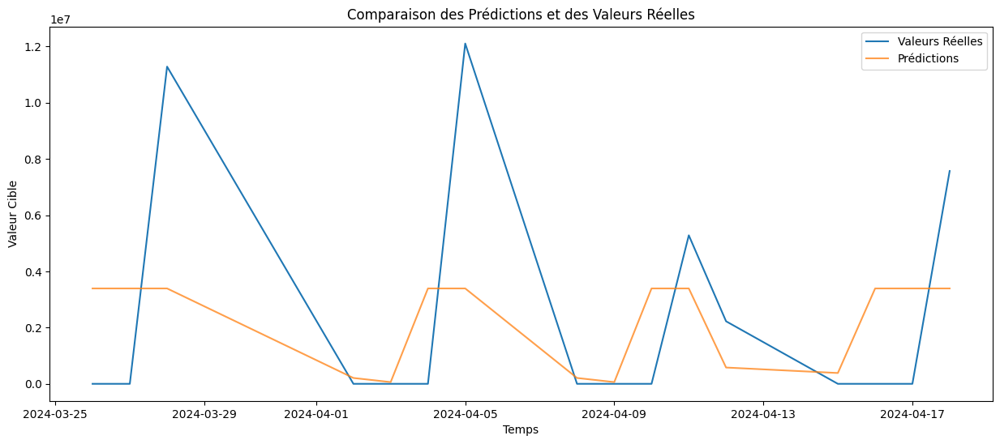

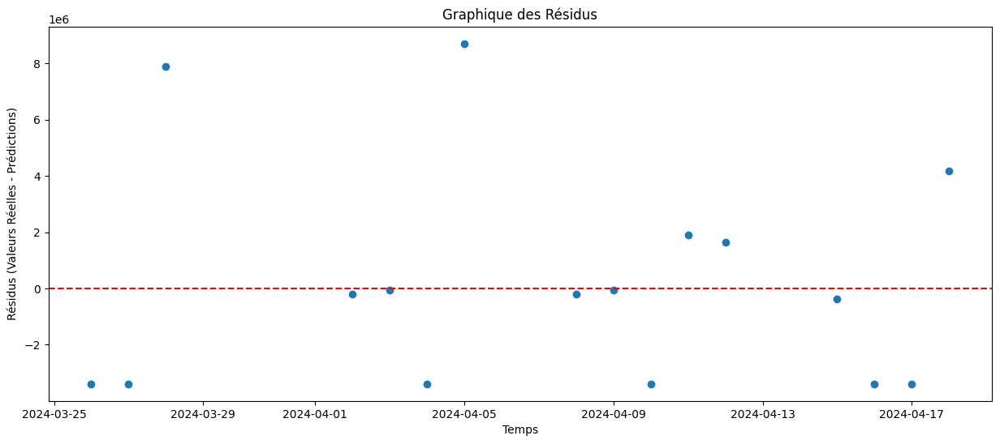

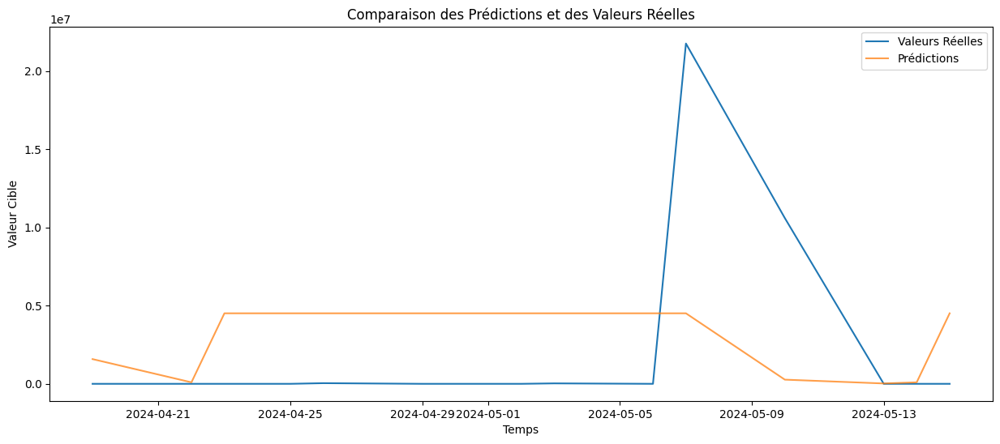

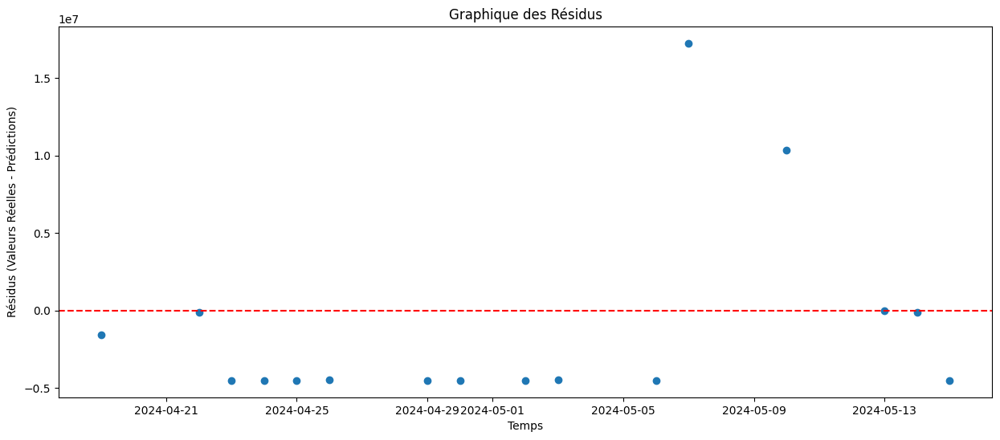

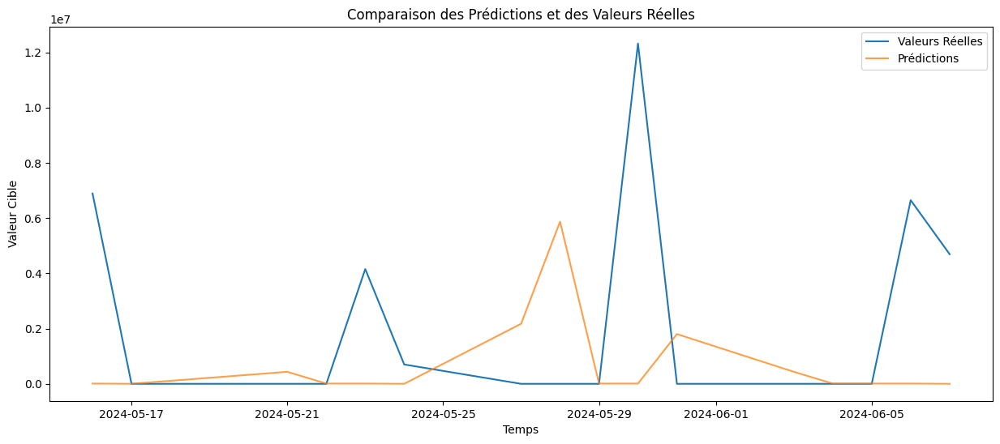

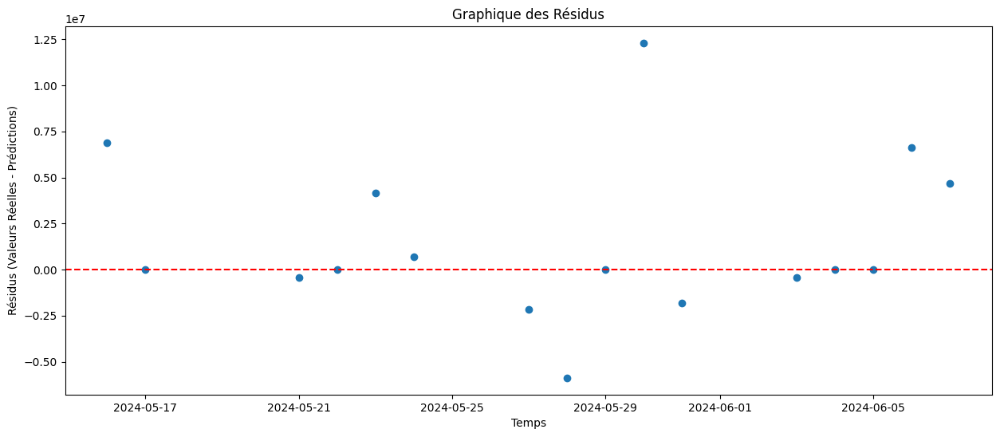

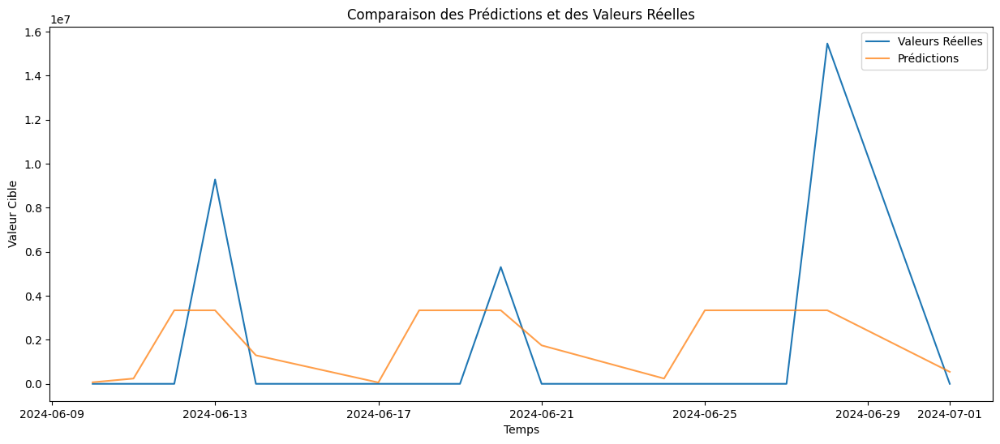

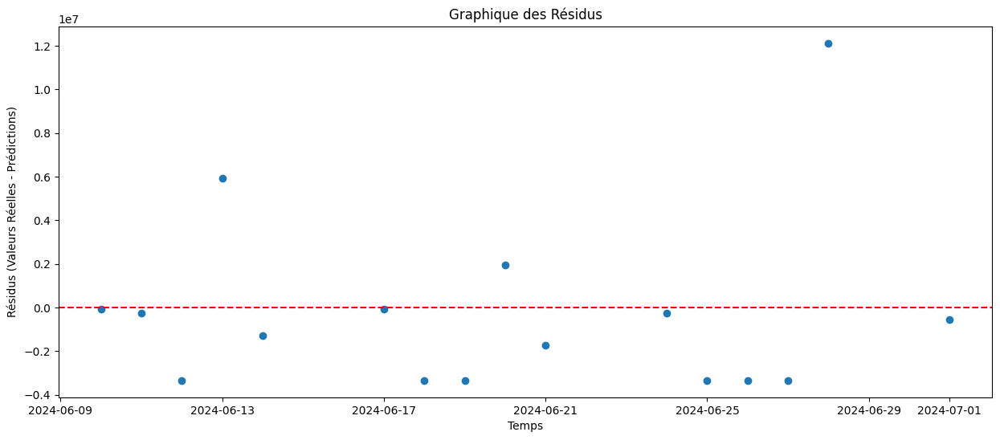

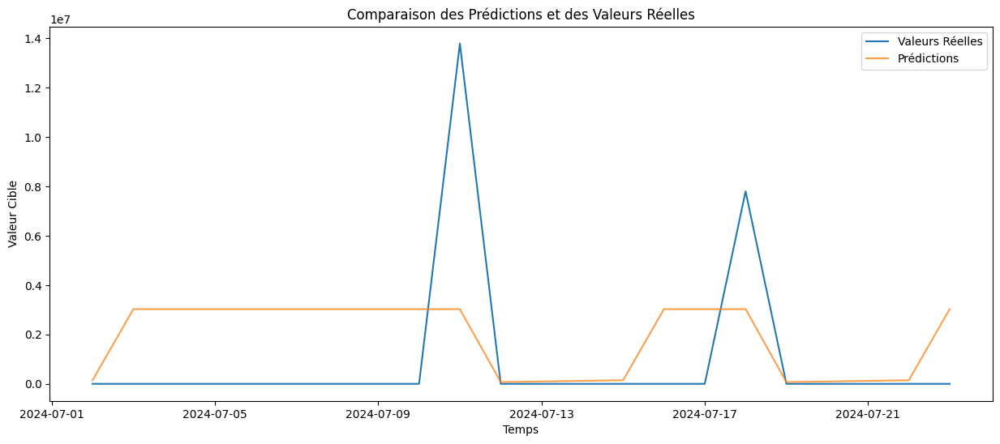

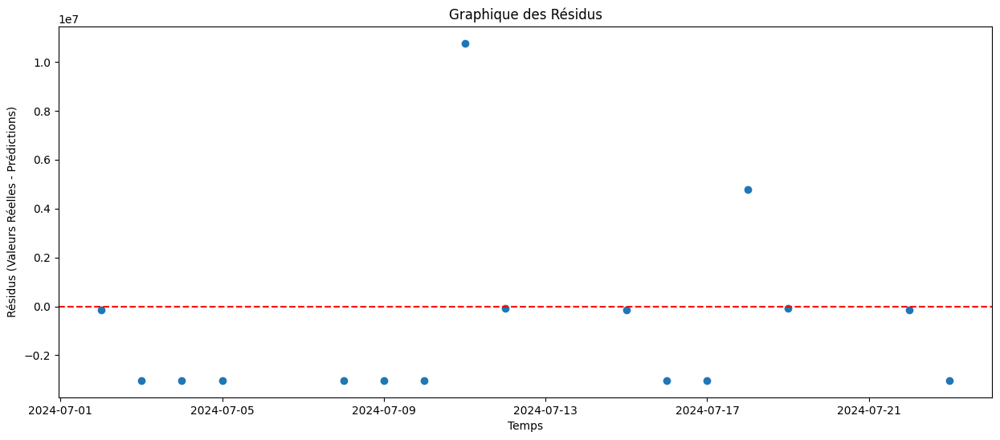

Rolling Window Analysis Average MSE for LNACT_Collec: 20566155863926.55
Processing series: LNAAE_Collec
Temporal Cross-Validation Average MSE for LNAAE_Collec: 1526642539355.1
Enhanced Resampling MSE for LNAAE_Collec: 582179368518.8917
Ensemble MSE with Varied Historical Contexts for LNAAE_Collec: 1440216309803.6843
Average MSE with Cross-Validation on Shuffled Data for LNAAE_Collec: 1874225347809.3516


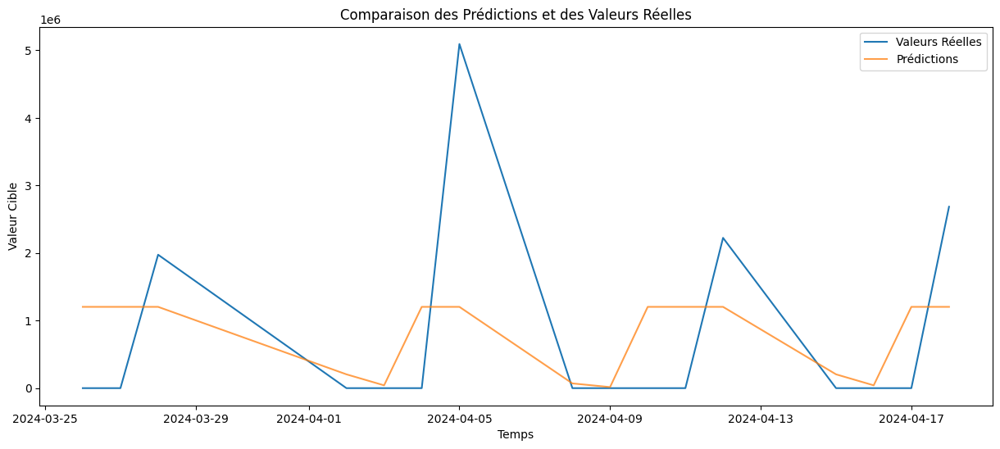

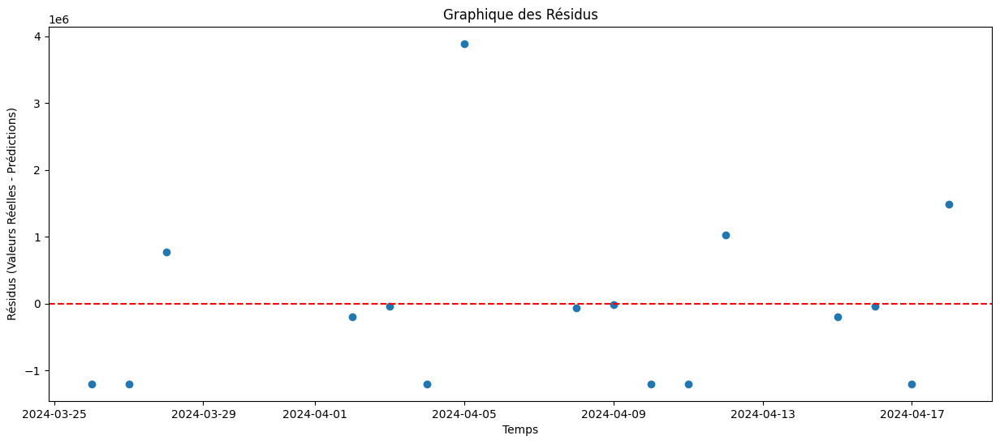

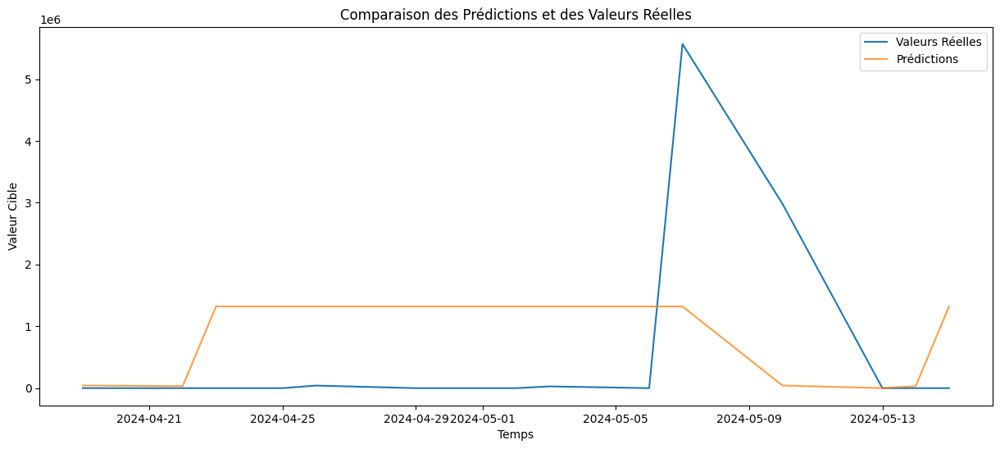

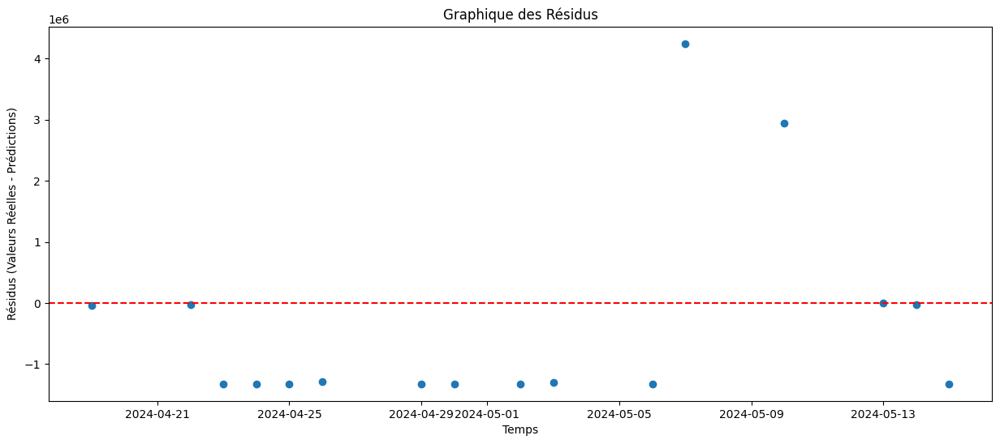

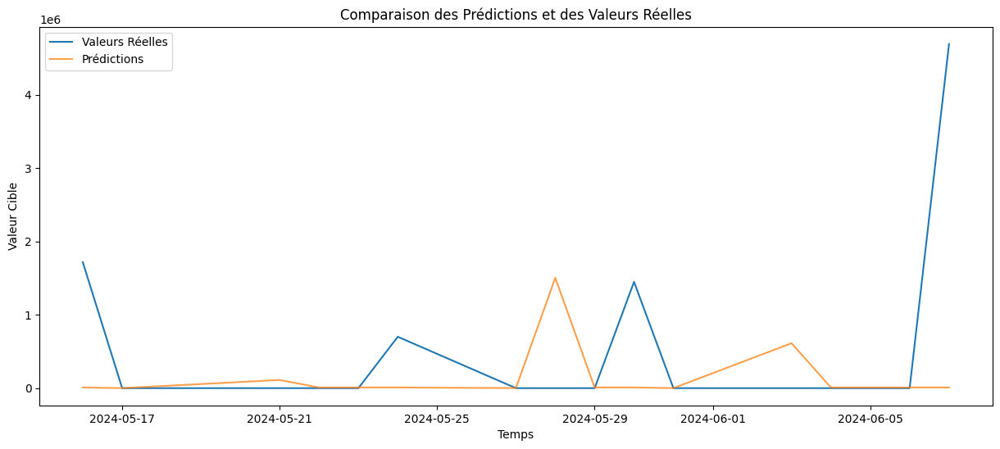

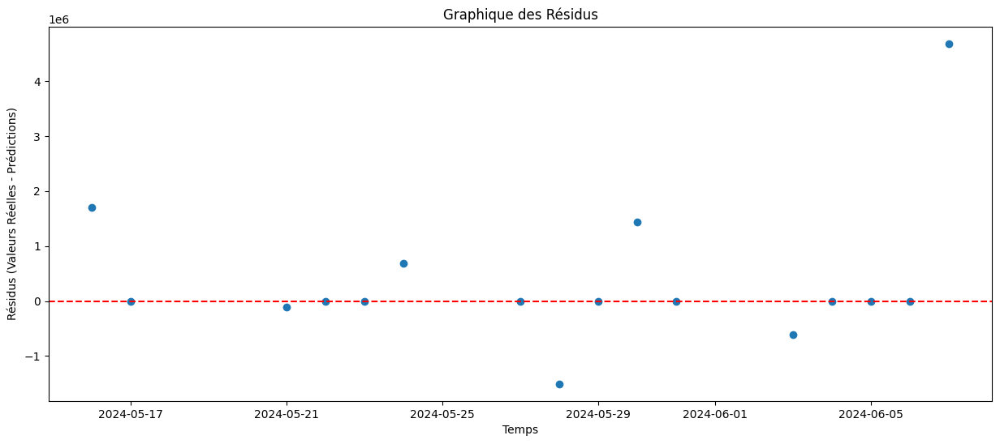

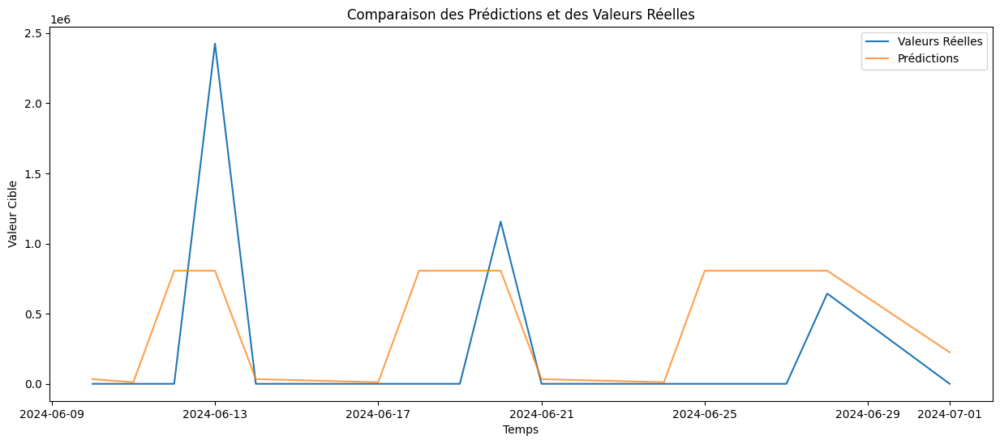

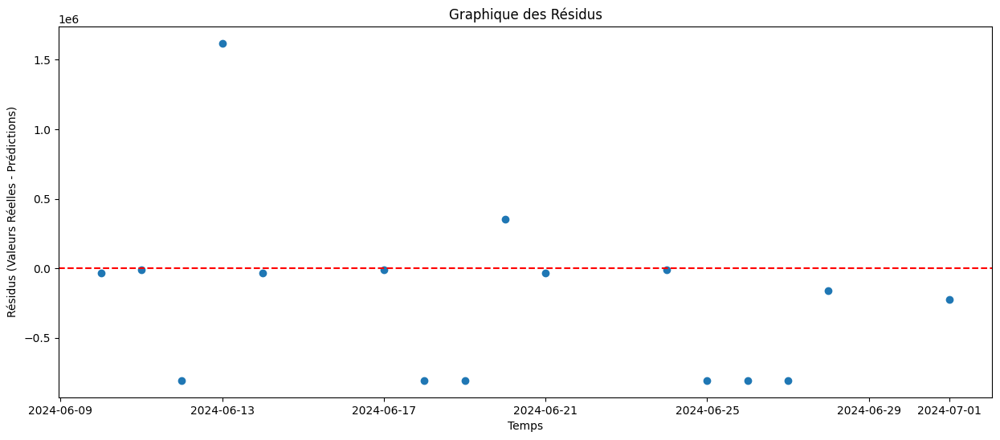

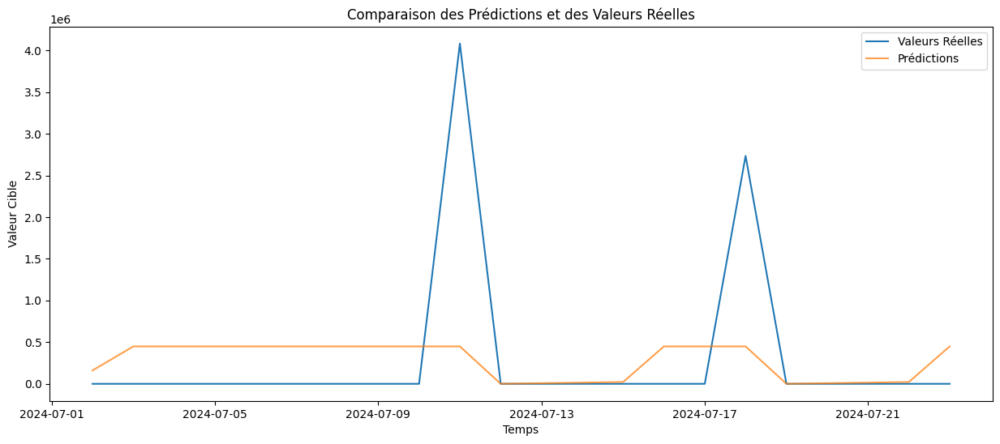

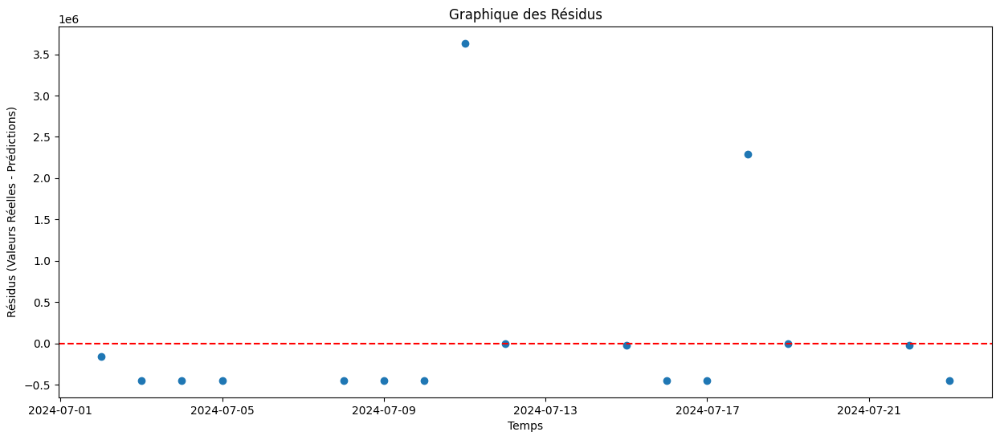

Rolling Window Analysis Average MSE for LNAAE_Collec: 1609692563685.223
Processing series: LNATO_Collec
Temporal Cross-Validation Average MSE for LNATO_Collec: 9690900281071.332
Enhanced Resampling MSE for LNATO_Collec: 12965409052455.148
Ensemble MSE with Varied Historical Contexts for LNATO_Collec: 8572430823814.714
Average MSE with Cross-Validation on Shuffled Data for LNATO_Collec: 9175755307325.766


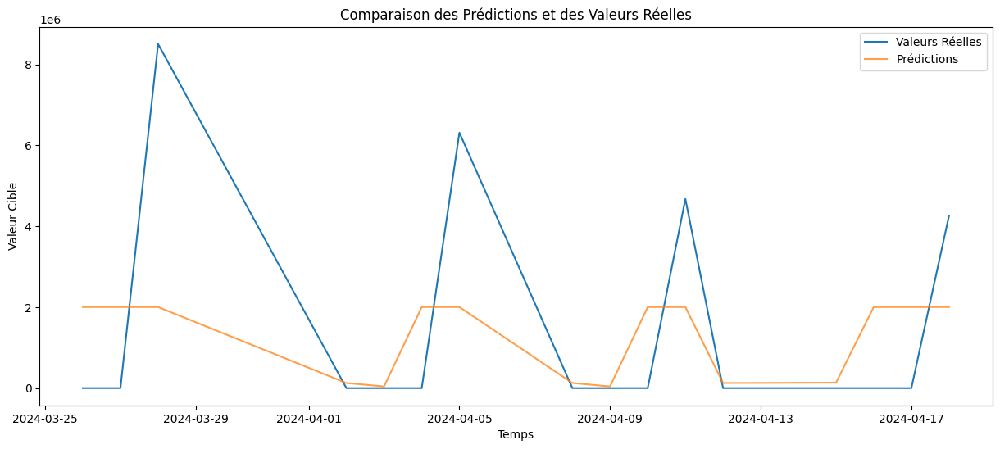

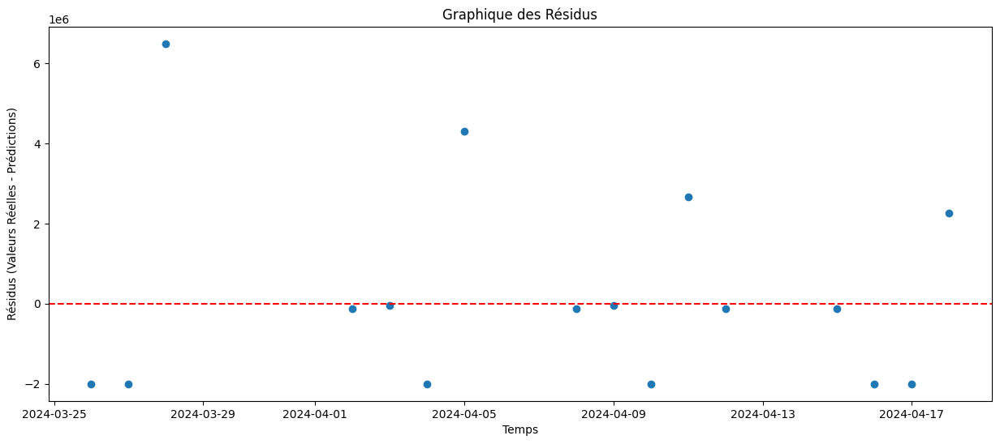

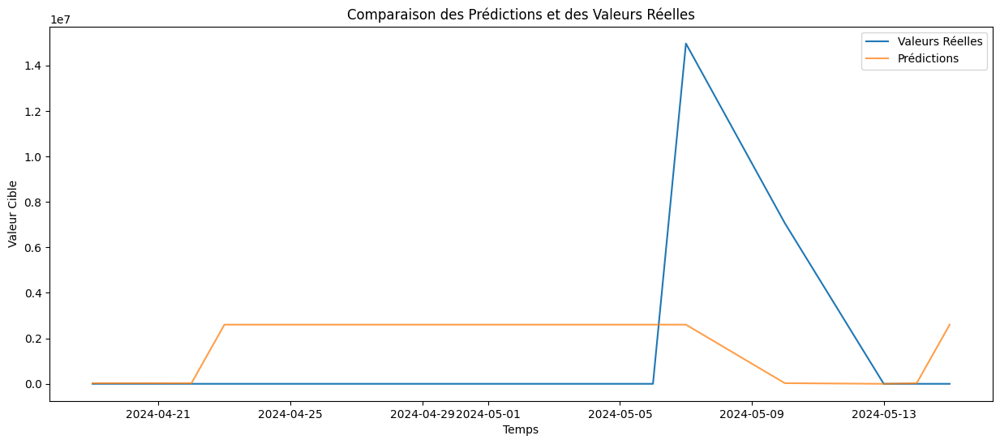

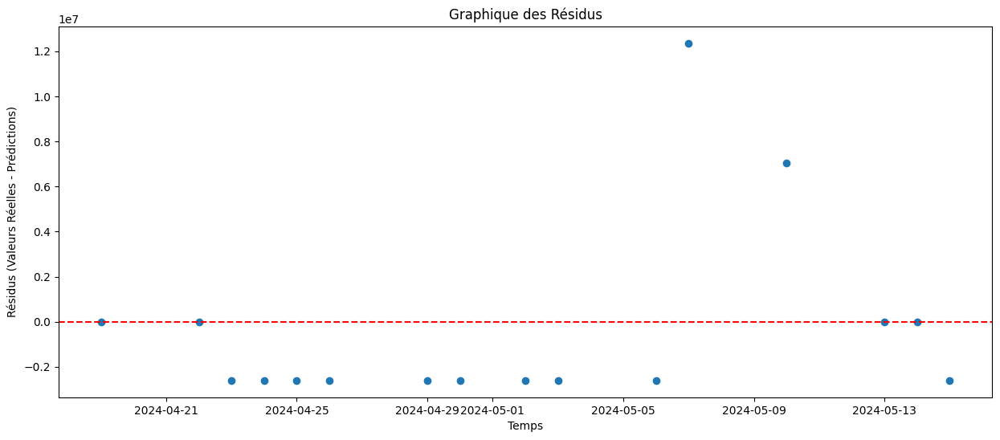

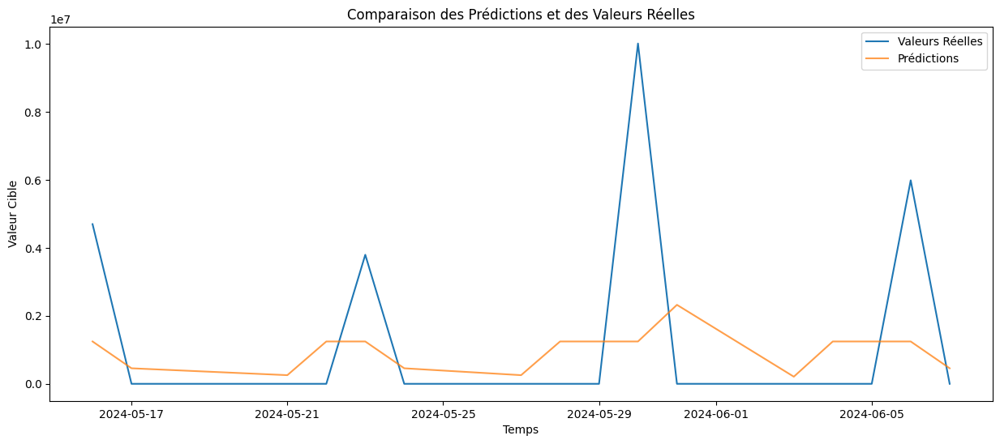

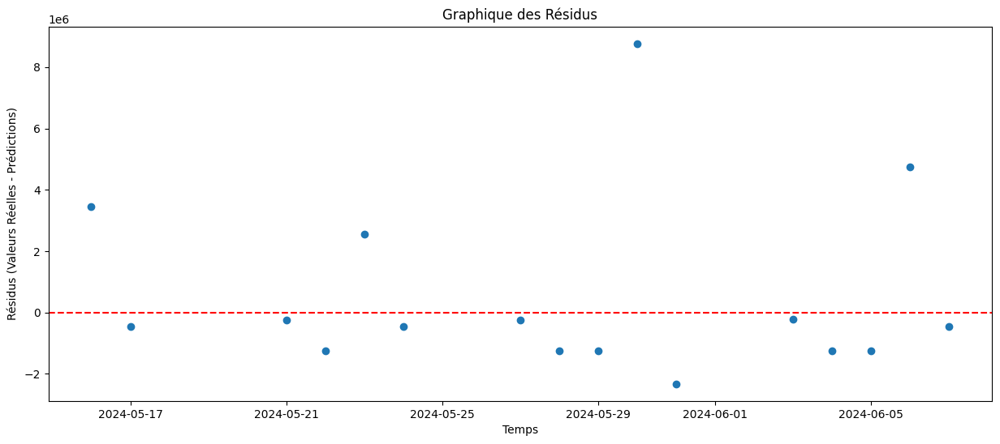

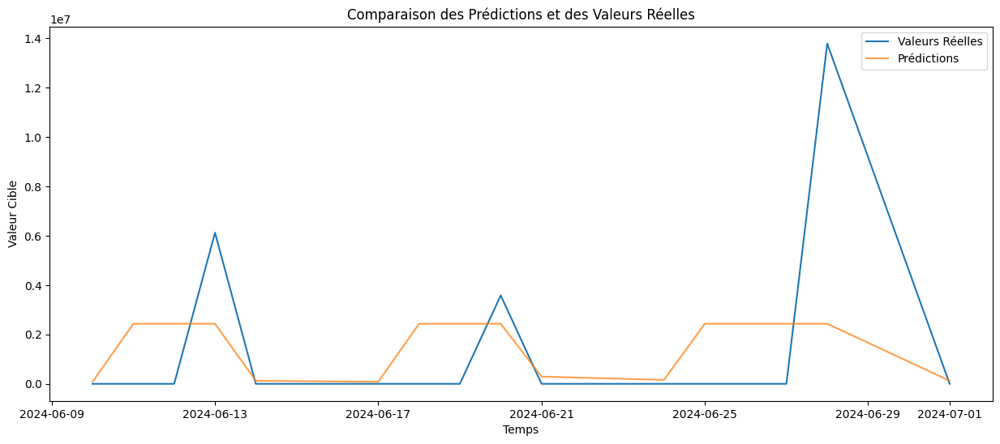

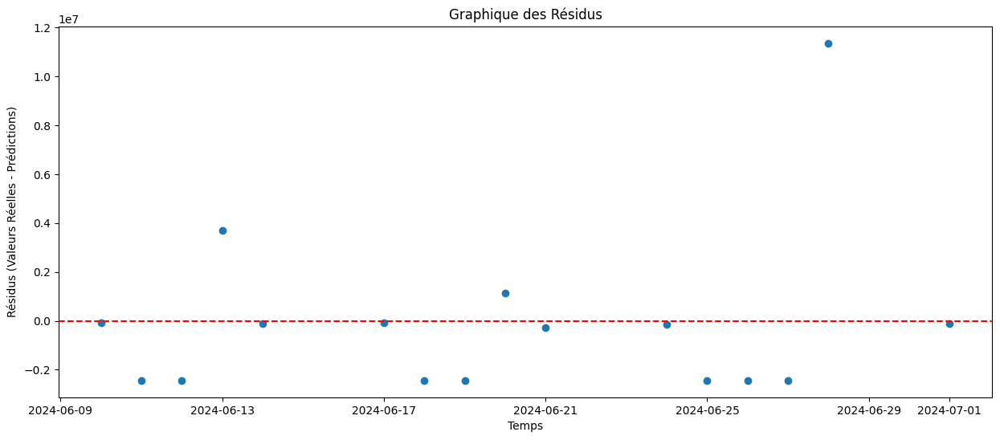

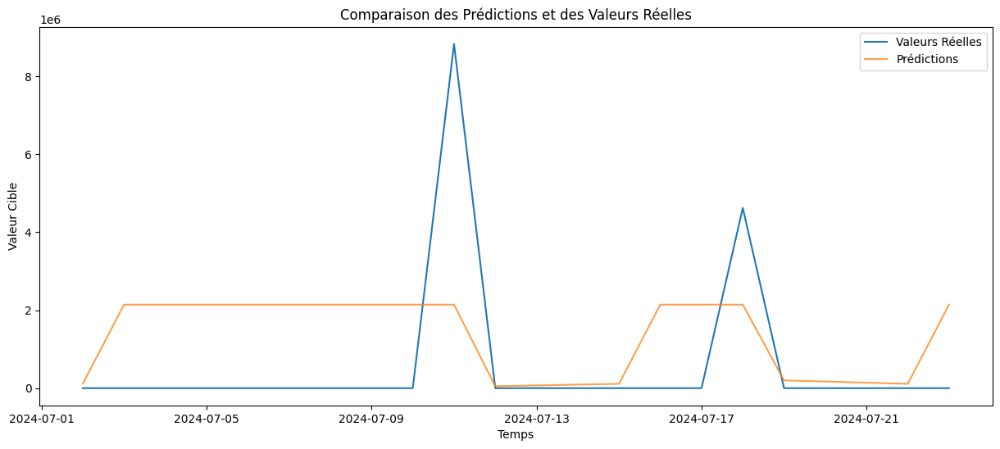

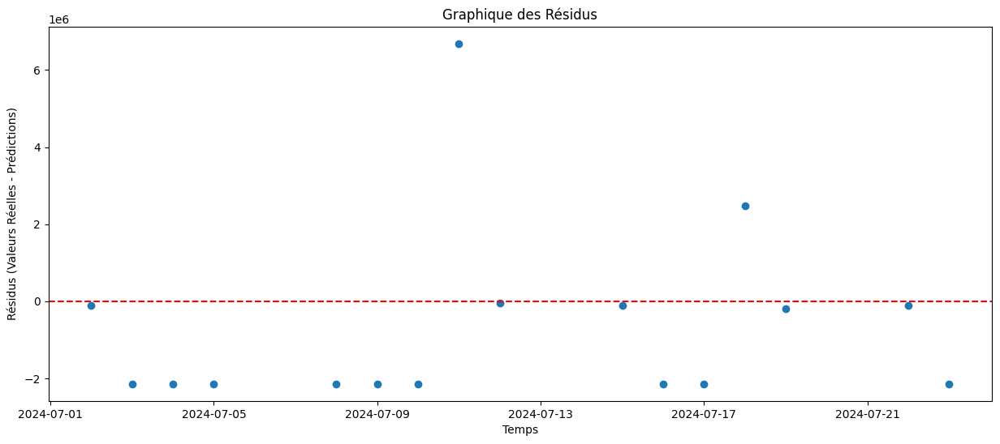

Rolling Window Analysis Average MSE for LNATO_Collec: 9712513387403.988
Processing series: LNAT2_Collec
Temporal Cross-Validation Average MSE for LNAT2_Collec: 78542025266.1179
Enhanced Resampling MSE for LNAT2_Collec: 87204276614.01265
Ensemble MSE with Varied Historical Contexts for LNAT2_Collec: 69496455682.61522
Average MSE with Cross-Validation on Shuffled Data for LNAT2_Collec: 73136588545.61086


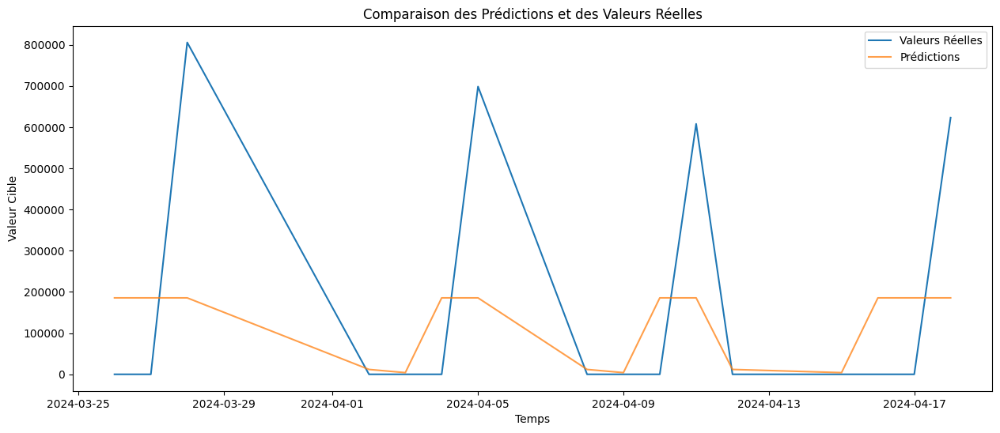

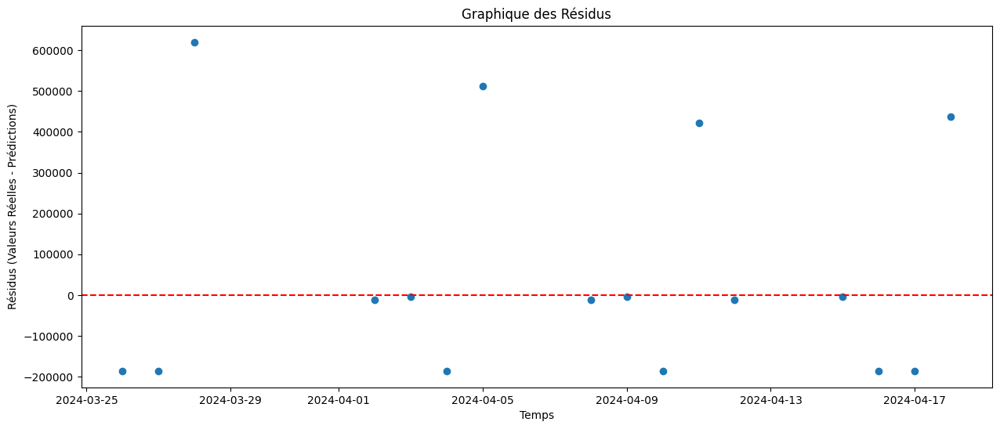

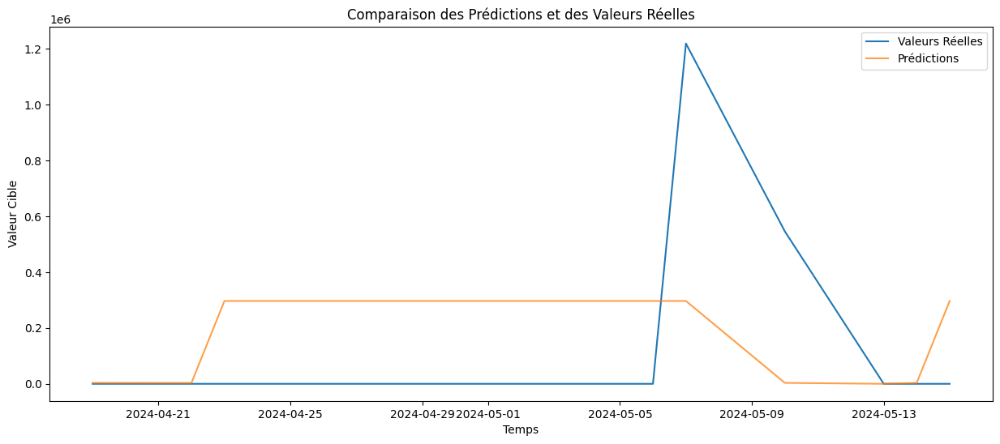

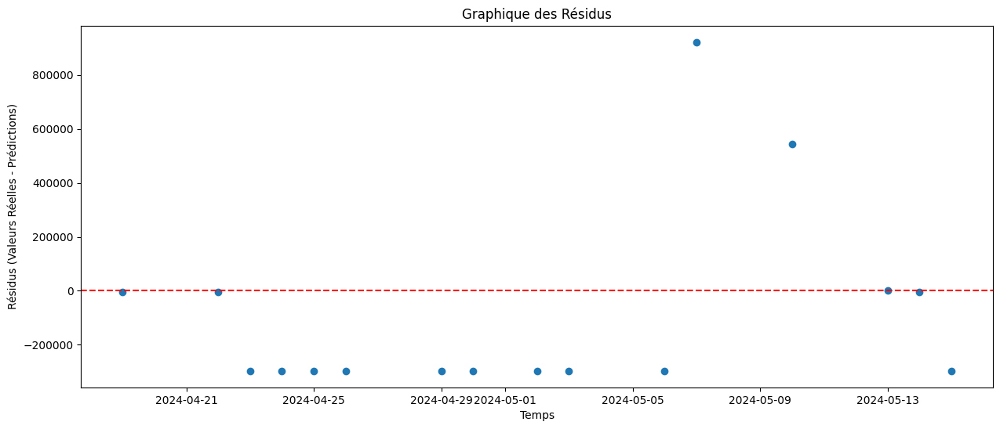

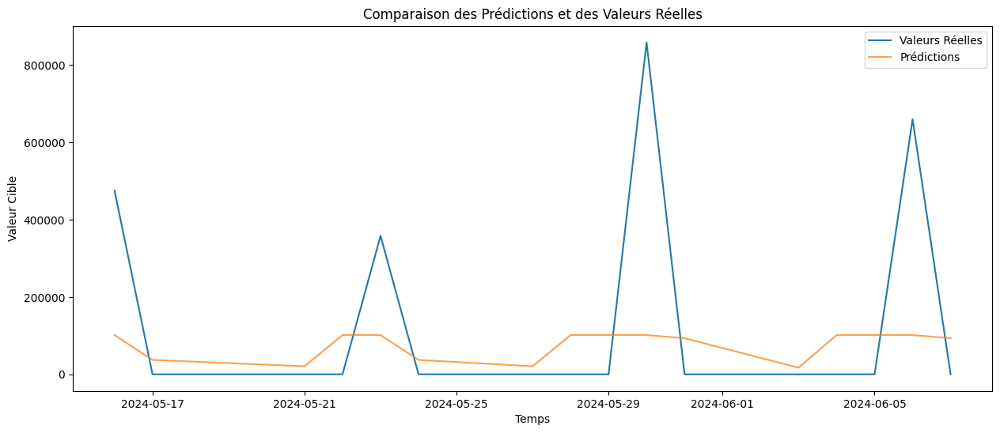

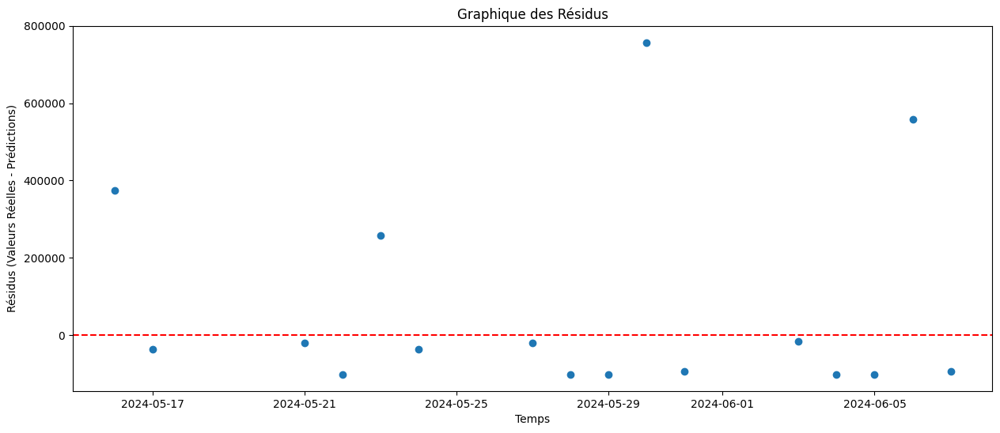

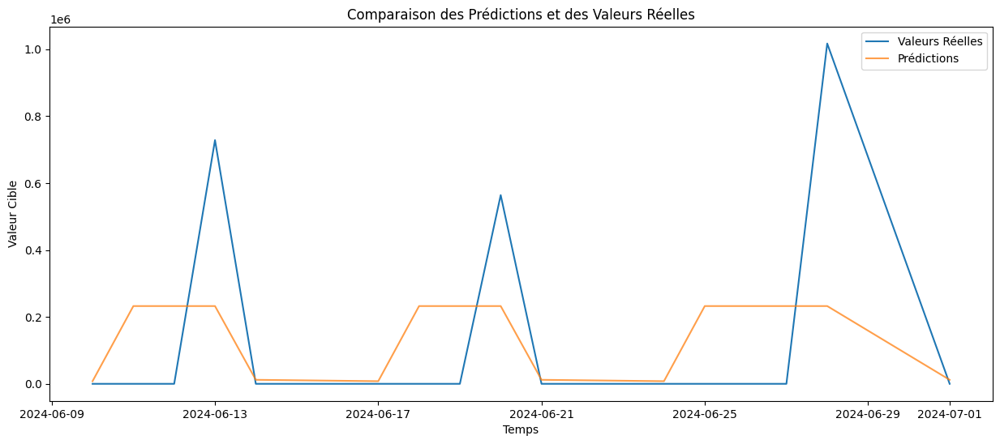

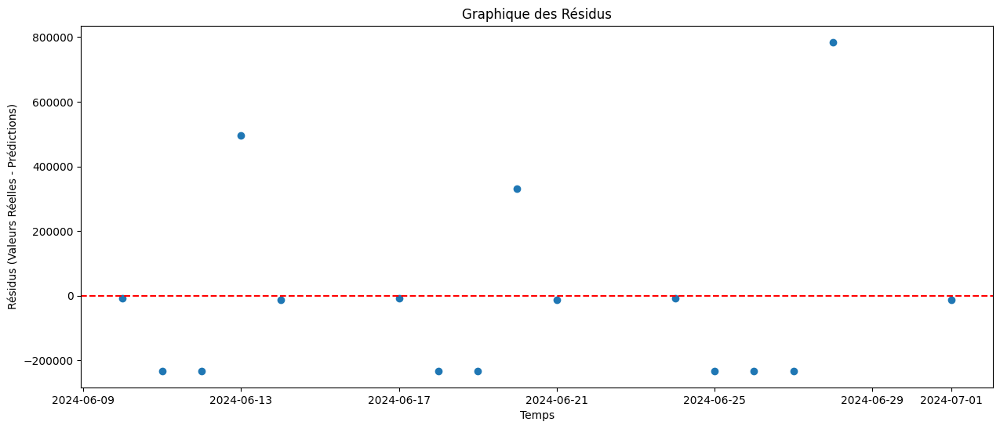

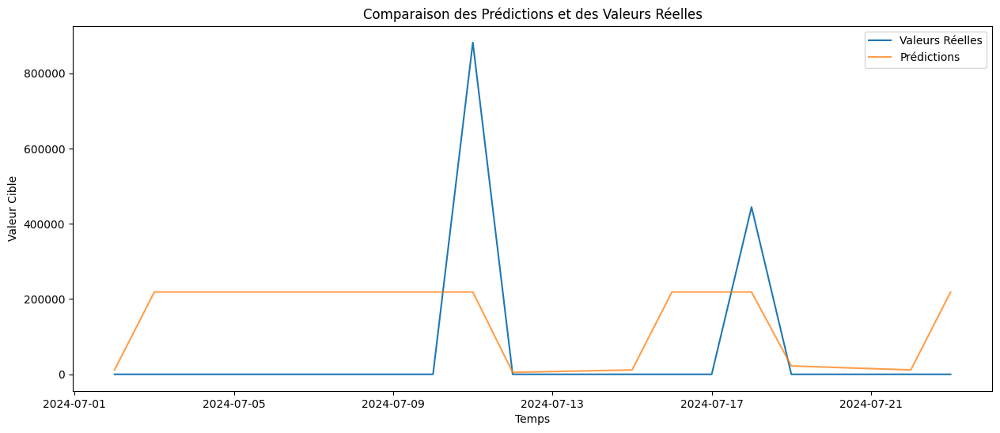

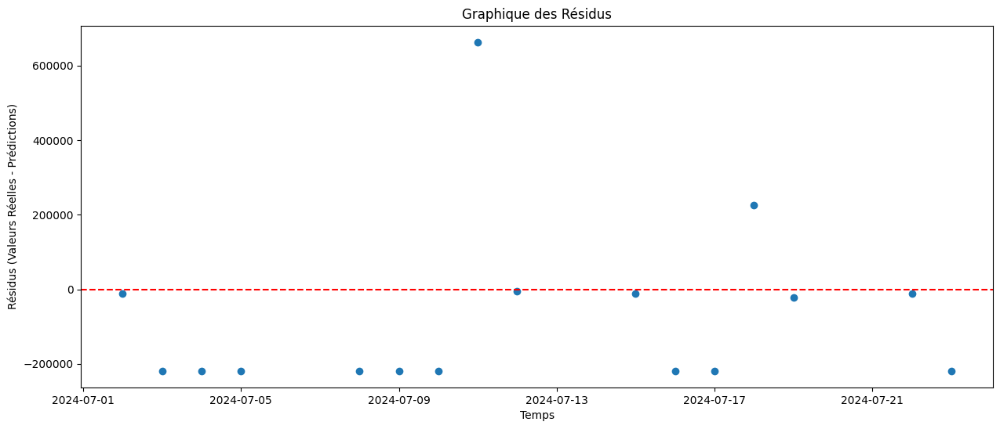

Rolling Window Analysis Average MSE for LNAT2_Collec: 83580895048.78944
Processing series: LNACC_Collec
Temporal Cross-Validation Average MSE for LNACC_Collec: 80312842177239.83
Enhanced Resampling MSE for LNACC_Collec: 100330121083329.45
Ensemble MSE with Varied Historical Contexts for LNACC_Collec: 83919237214164.73
Average MSE with Cross-Validation on Shuffled Data for LNACC_Collec: 84548977684272.8


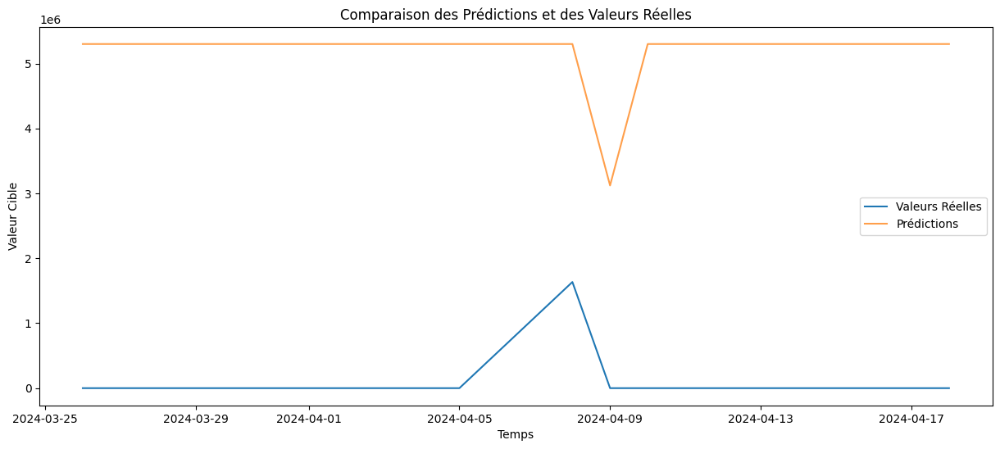

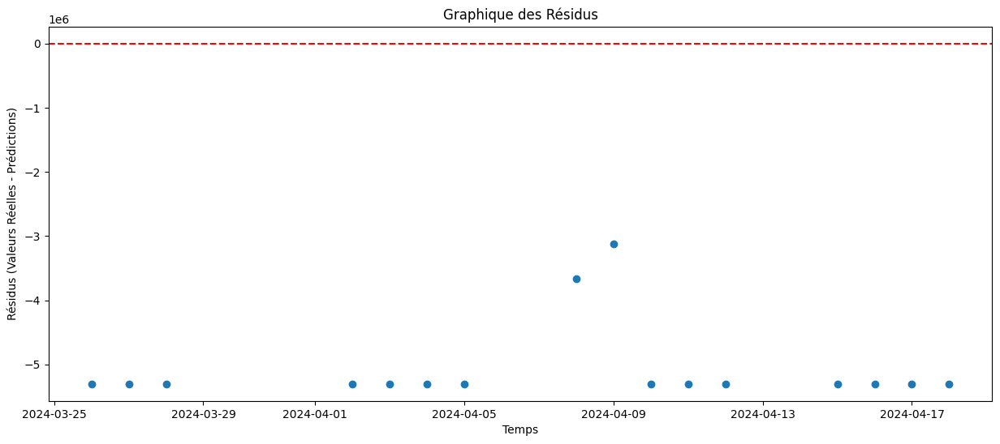

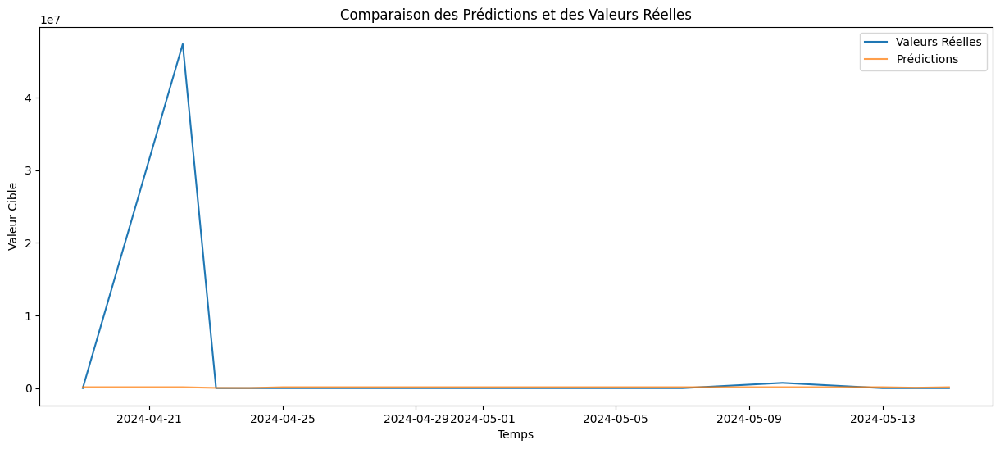

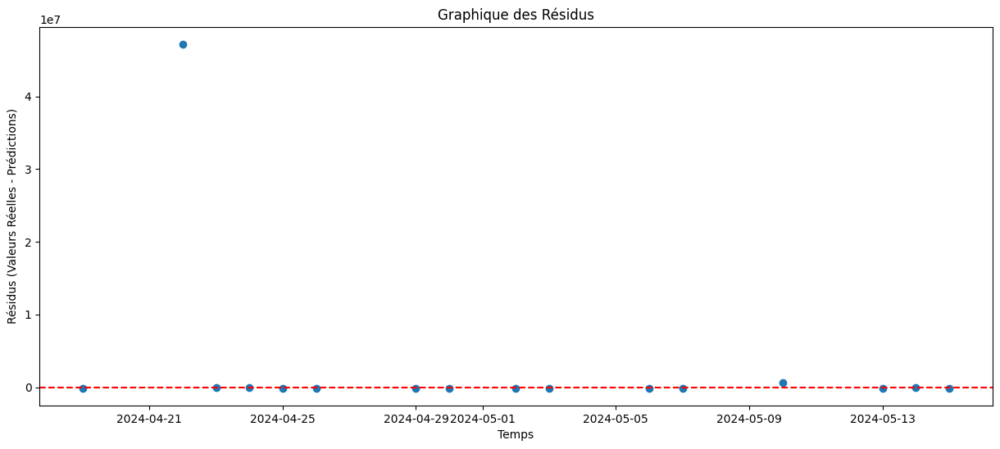

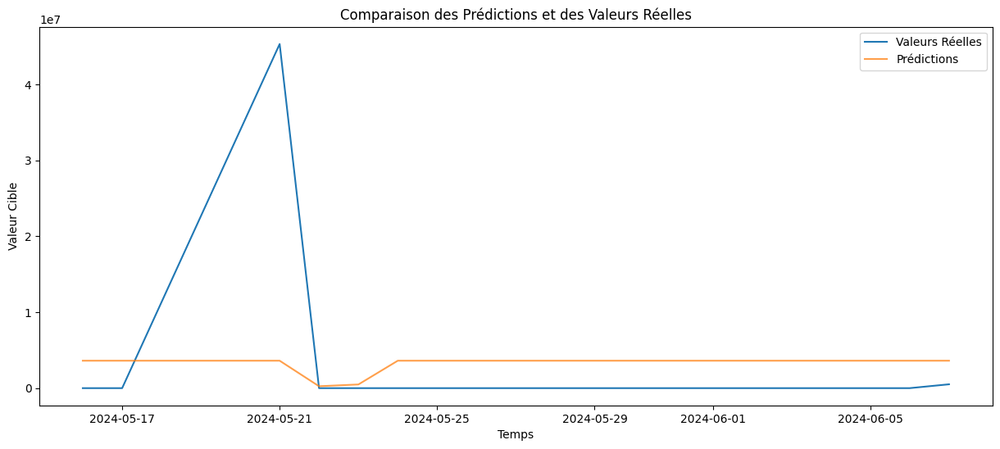

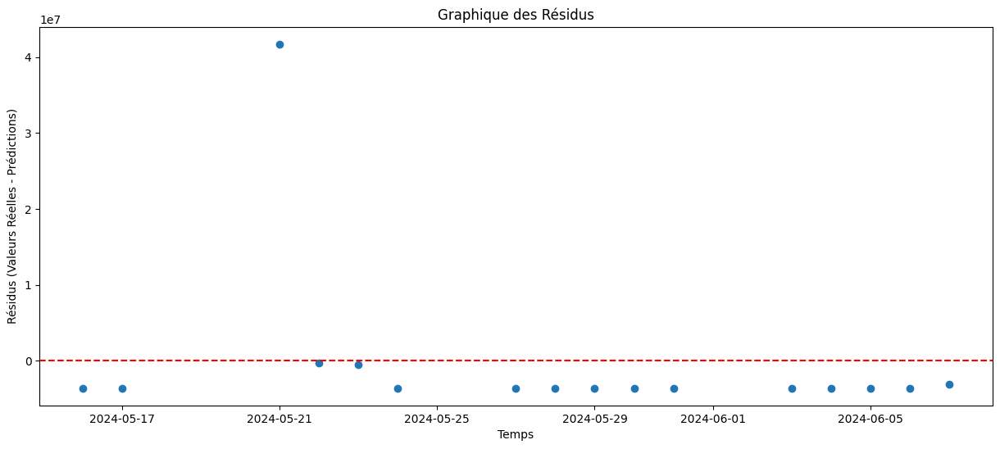

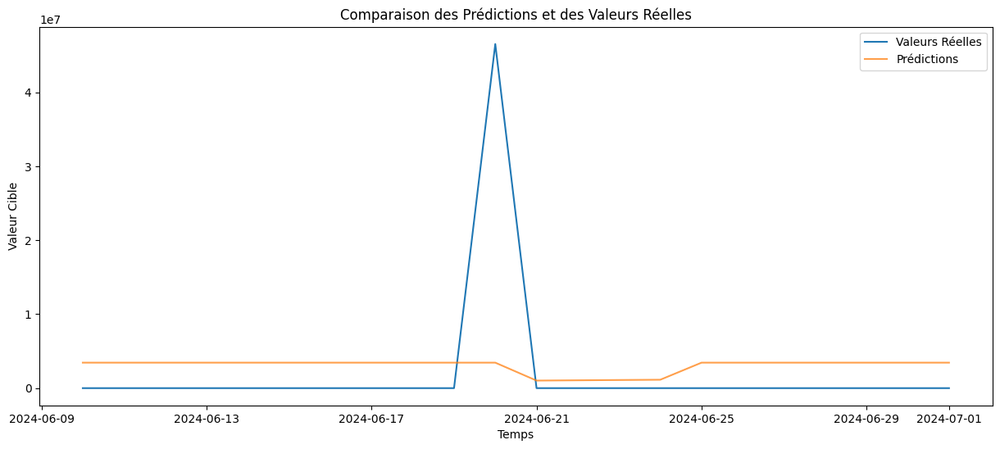

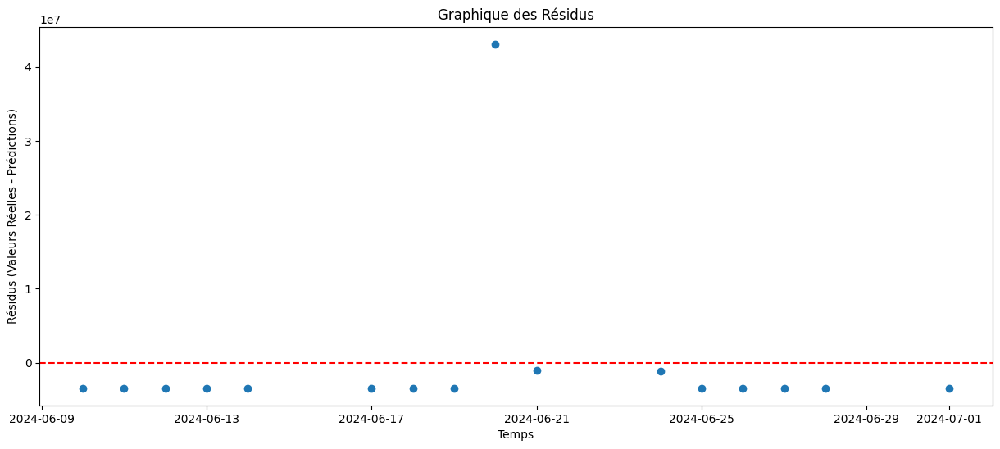

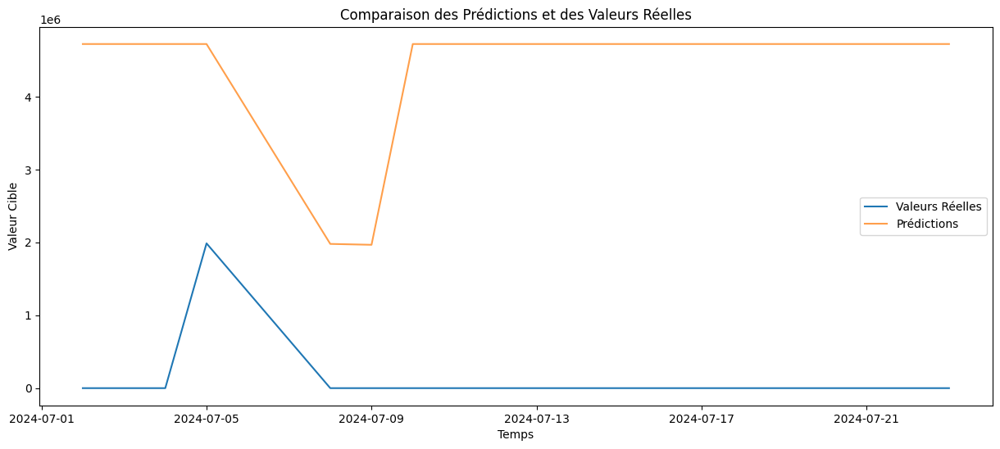

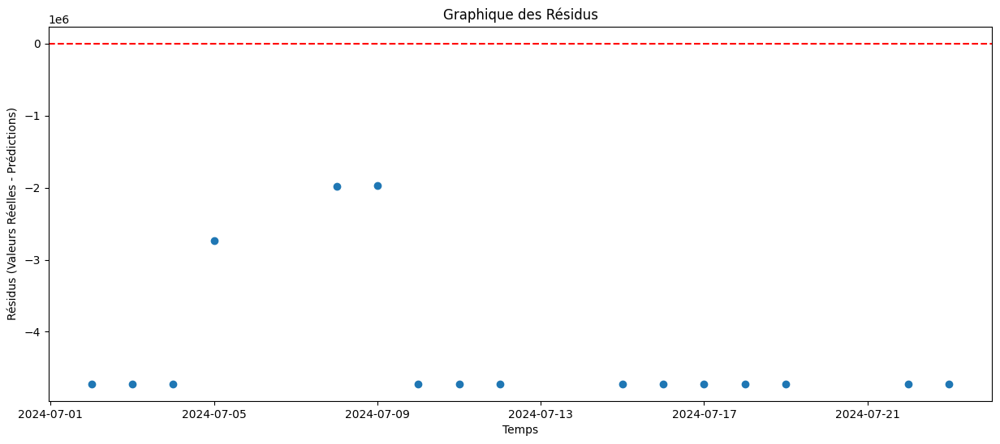

Rolling Window Analysis Average MSE for LNACC_Collec: 85925315193774.58
Processing series: LNACE_Collec
Temporal Cross-Validation Average MSE for LNACE_Collec: 0.0
Enhanced Resampling MSE for LNACE_Collec: 0.0
Ensemble MSE with Varied Historical Contexts for LNACE_Collec: 0.0
Average MSE with Cross-Validation on Shuffled Data for LNACE_Collec: 0.0


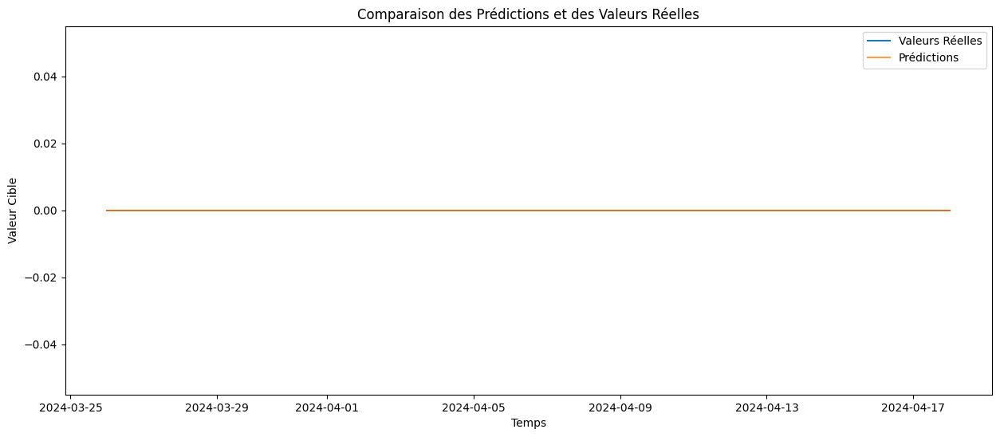

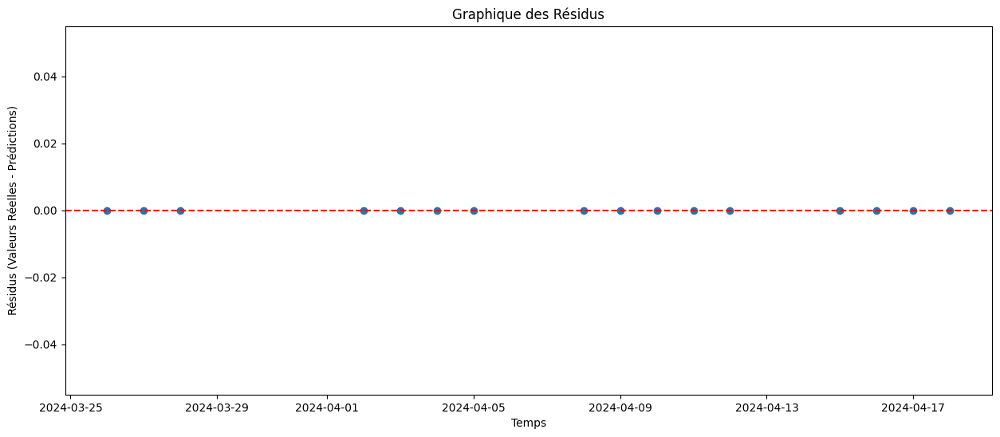

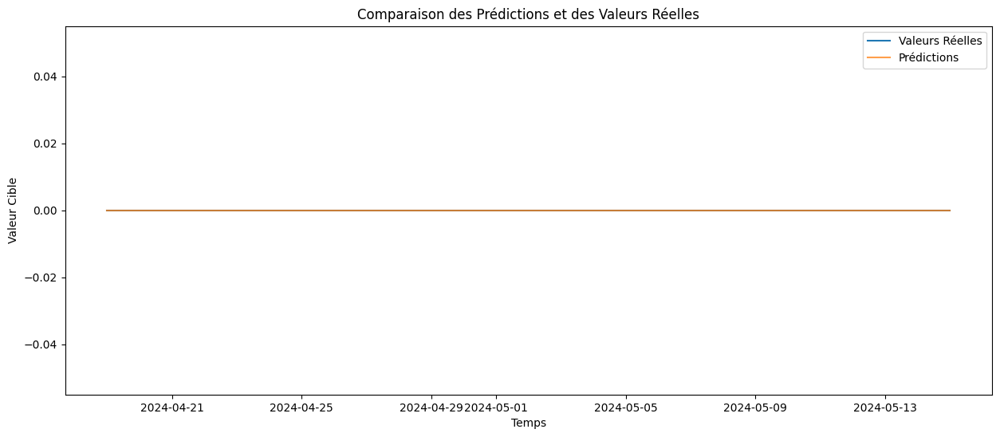

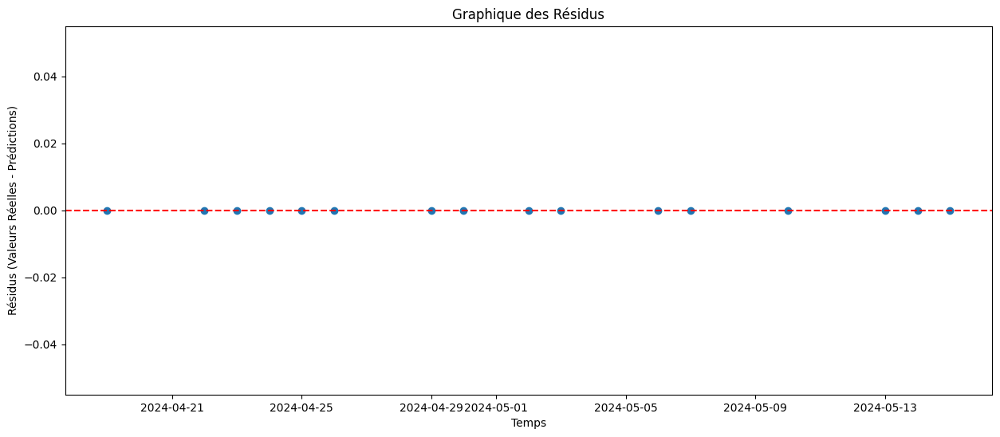

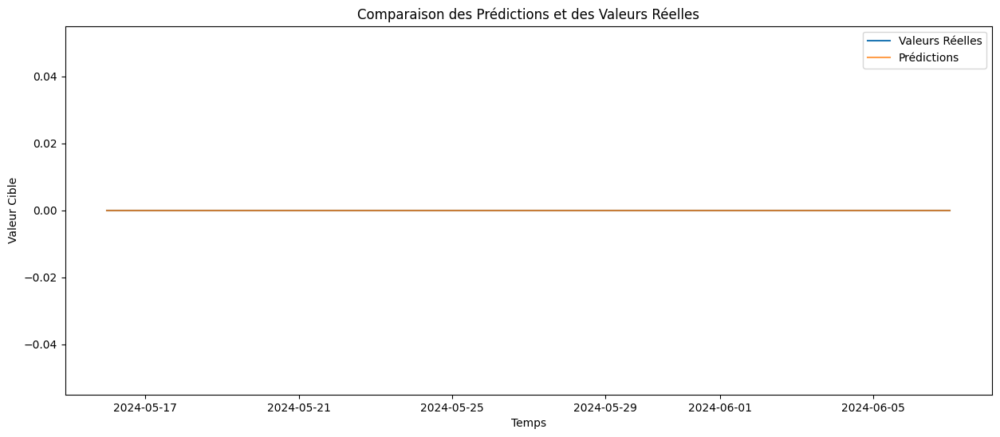

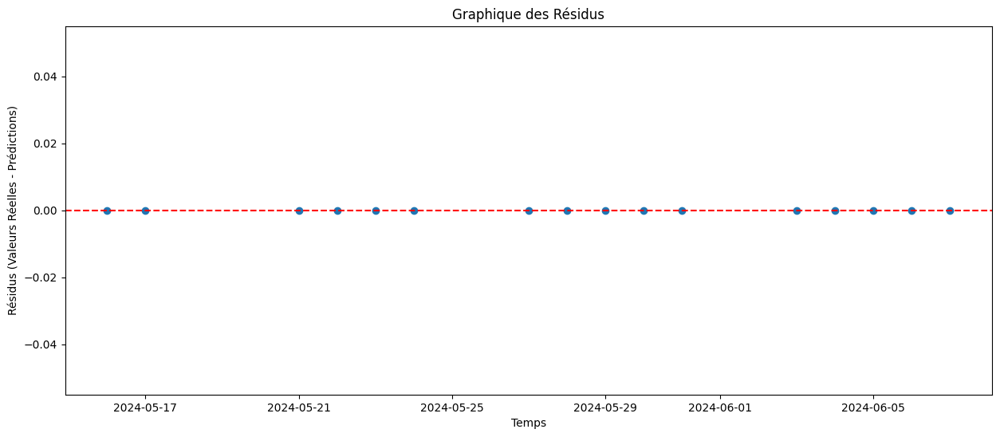

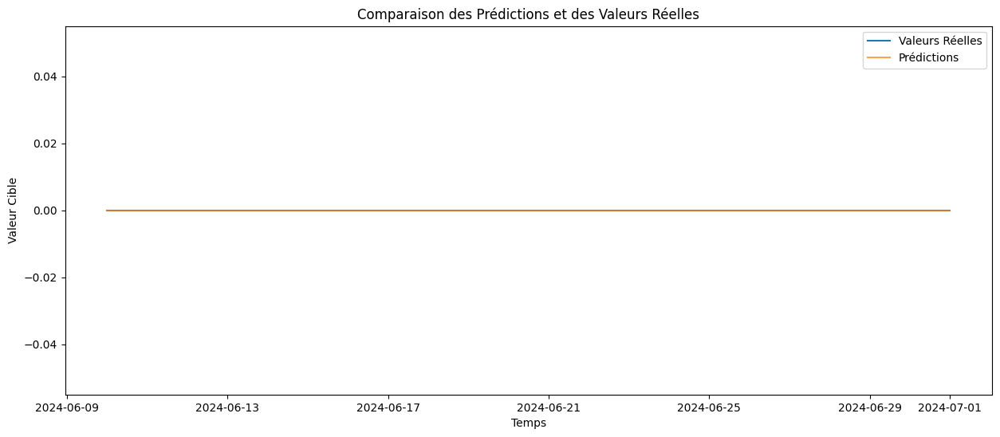

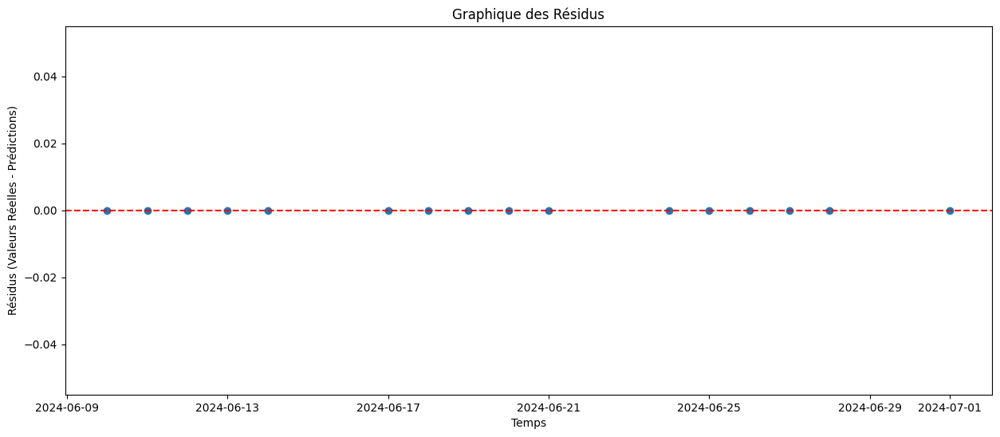

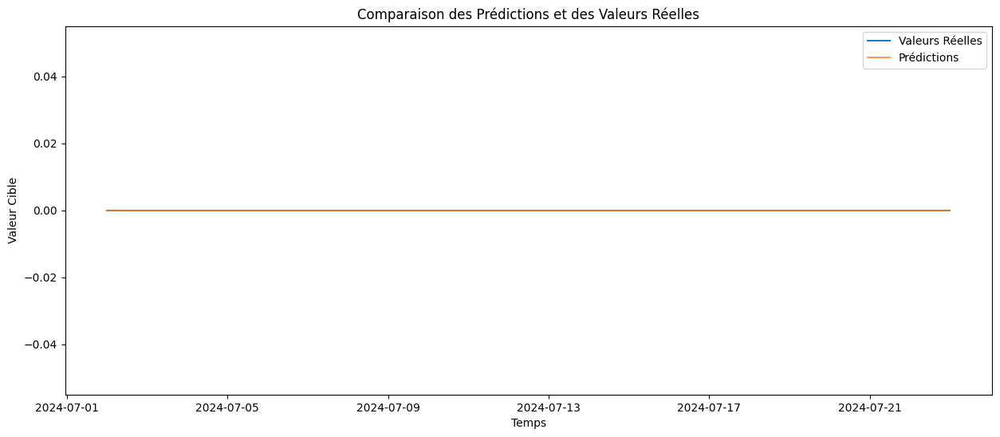

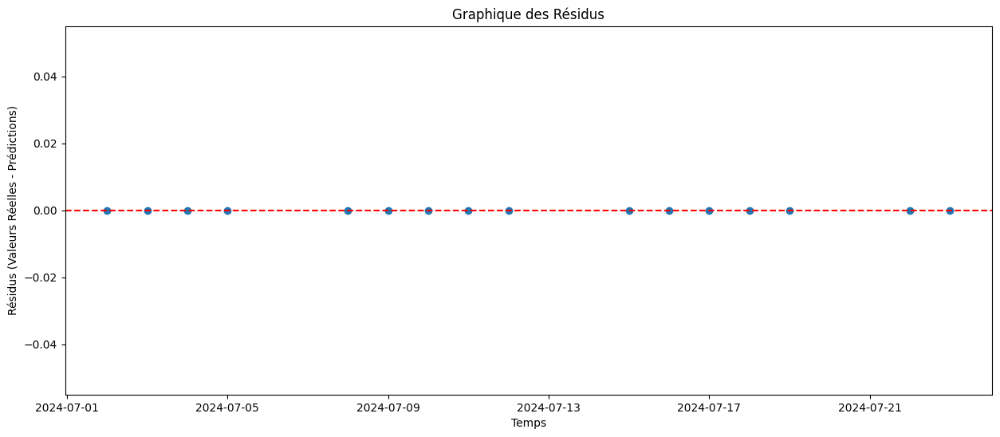

Rolling Window Analysis Average MSE for LNACE_Collec: 0.0
Processing series: LNAC3_Collec
Temporal Cross-Validation Average MSE for LNAC3_Collec: 0.0
Enhanced Resampling MSE for LNAC3_Collec: 0.0
Ensemble MSE with Varied Historical Contexts for LNAC3_Collec: 0.0
Average MSE with Cross-Validation on Shuffled Data for LNAC3_Collec: 0.0


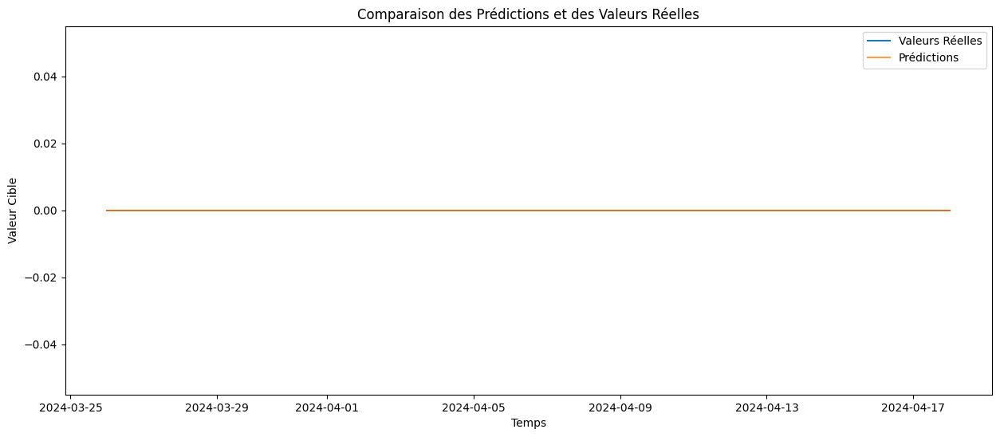

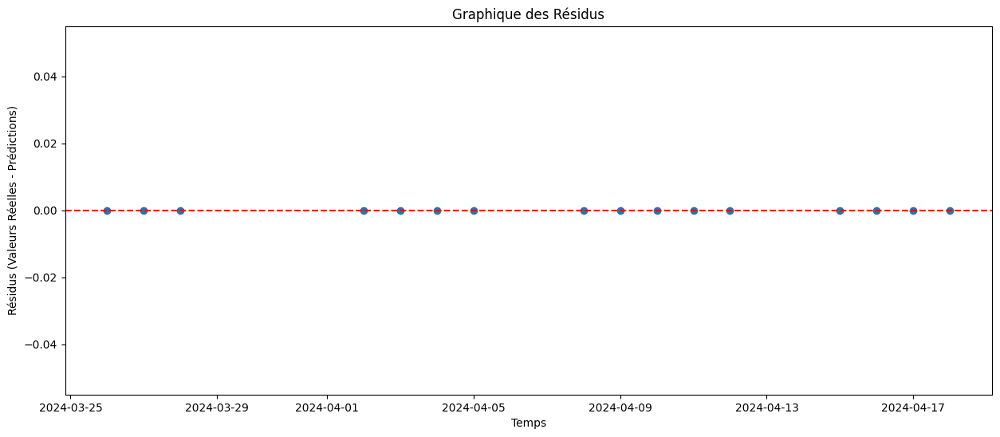

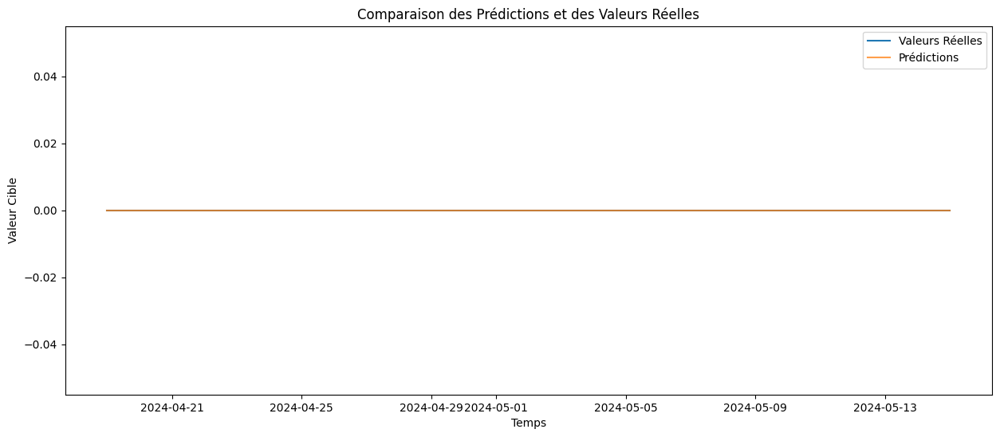

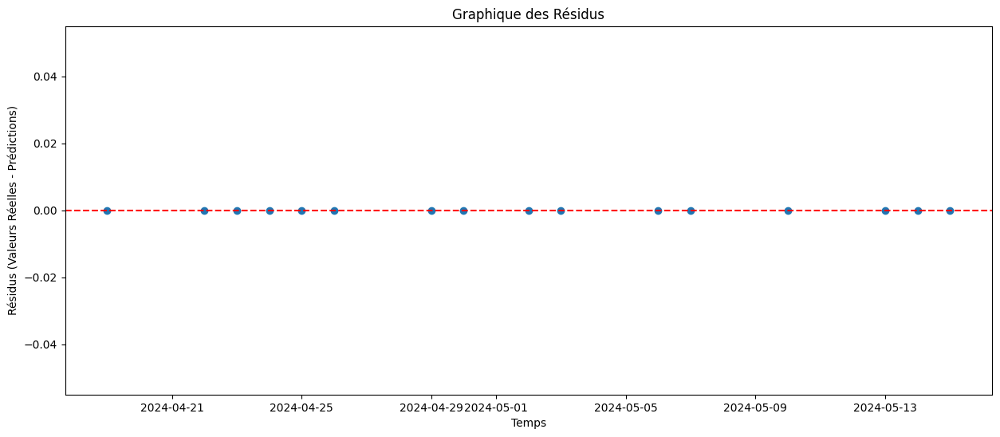

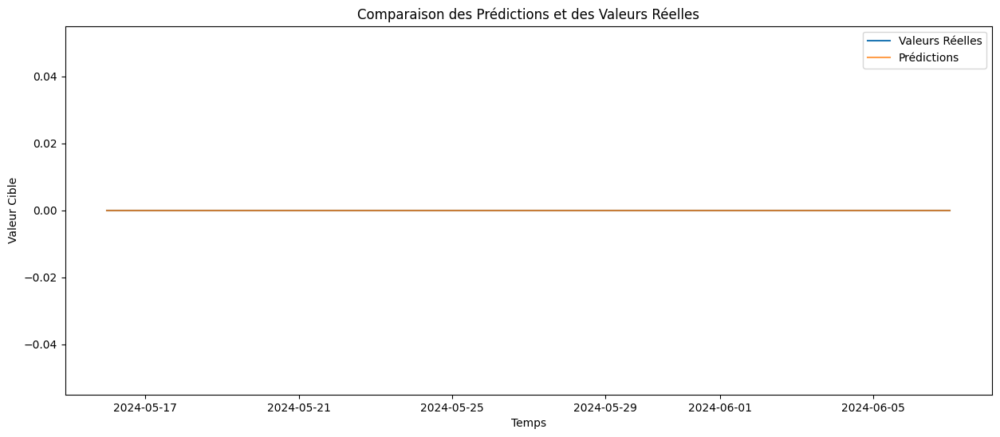

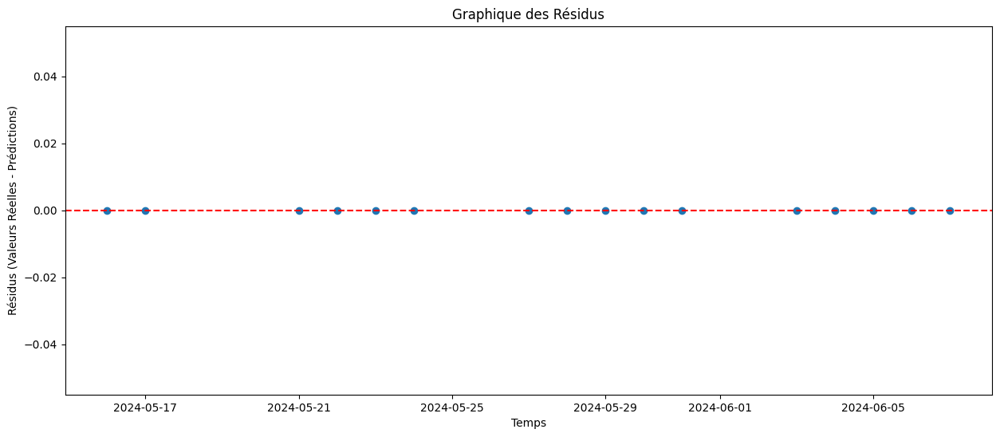

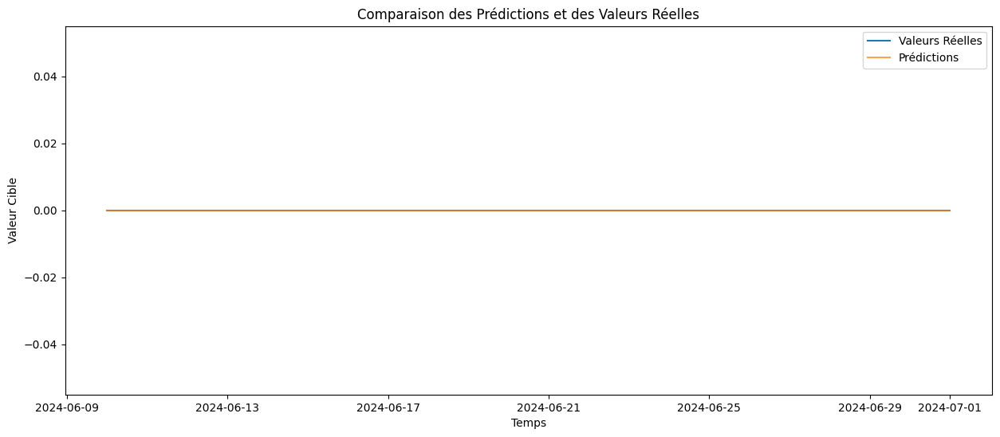

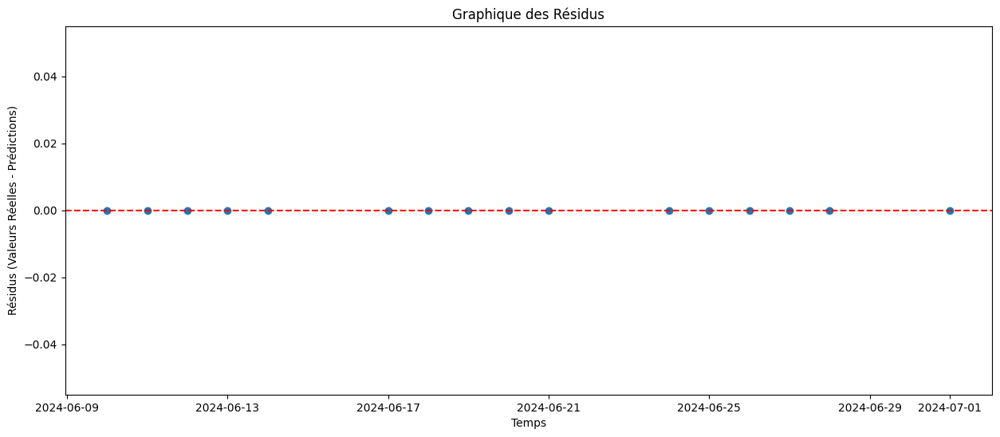

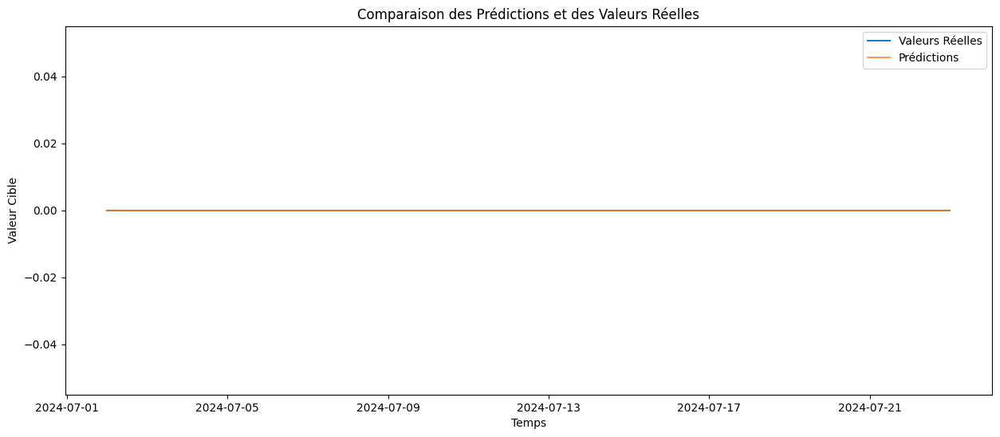

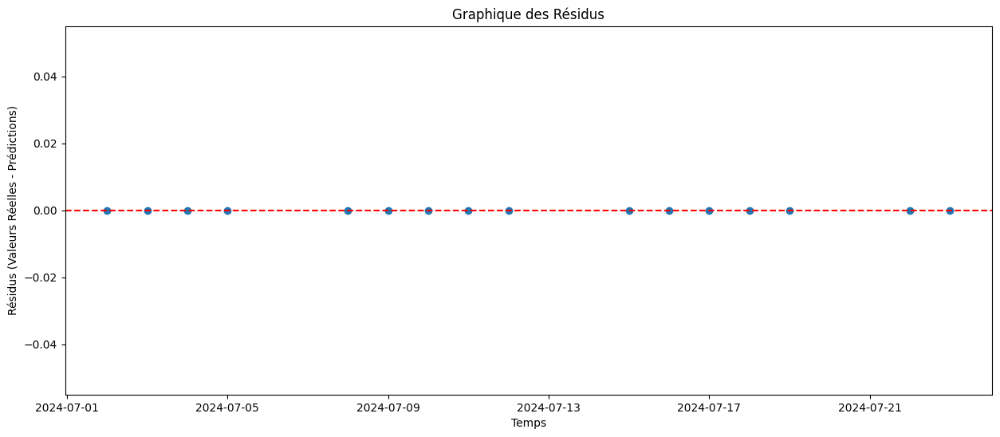

Rolling Window Analysis Average MSE for LNAC3_Collec: 0.0
Processing series: LNAC4_Collec
Temporal Cross-Validation Average MSE for LNAC4_Collec: 0.0
Enhanced Resampling MSE for LNAC4_Collec: 0.0
Ensemble MSE with Varied Historical Contexts for LNAC4_Collec: 0.0
Average MSE with Cross-Validation on Shuffled Data for LNAC4_Collec: 0.0


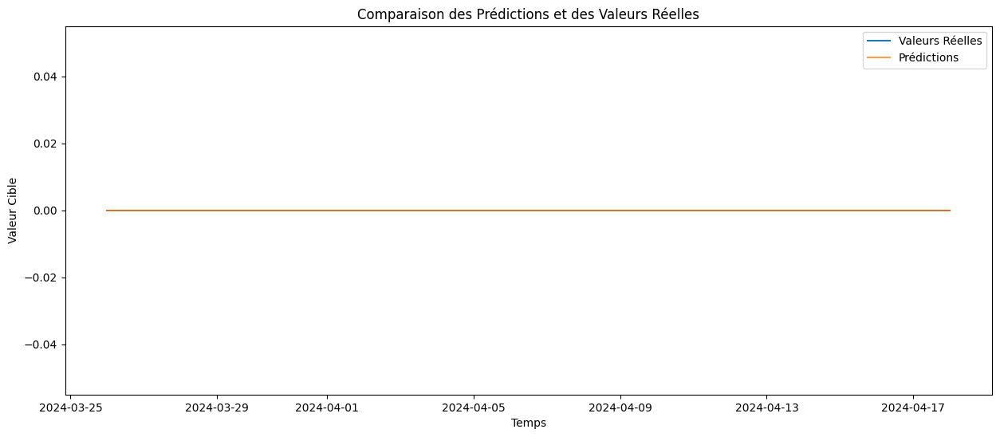

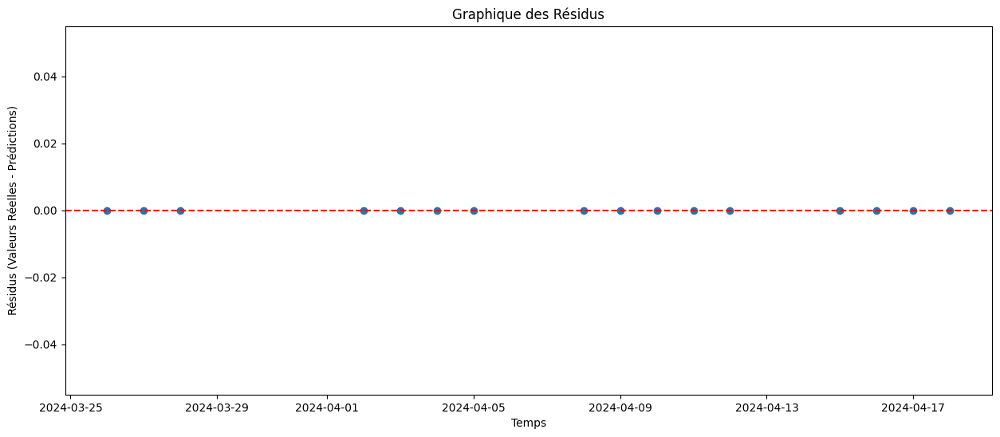

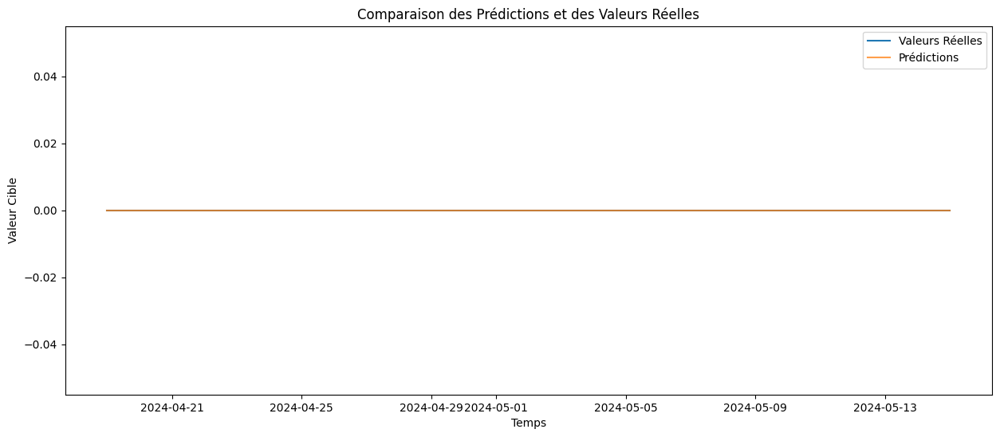

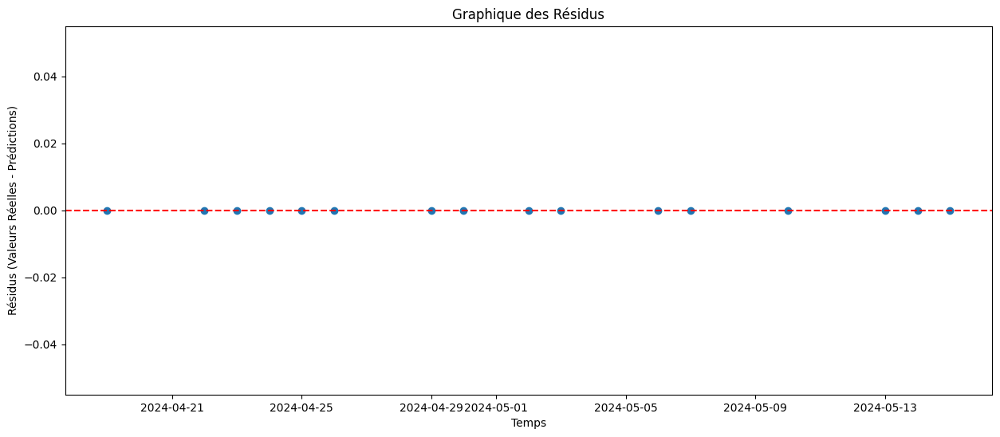

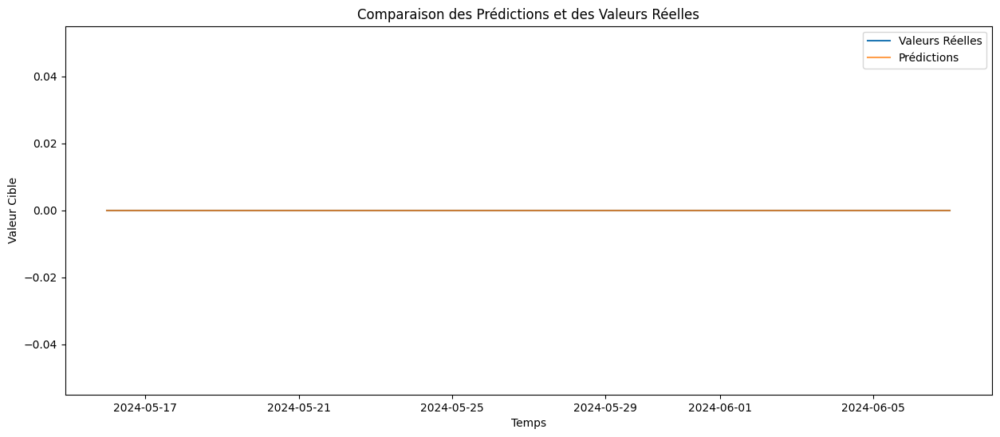

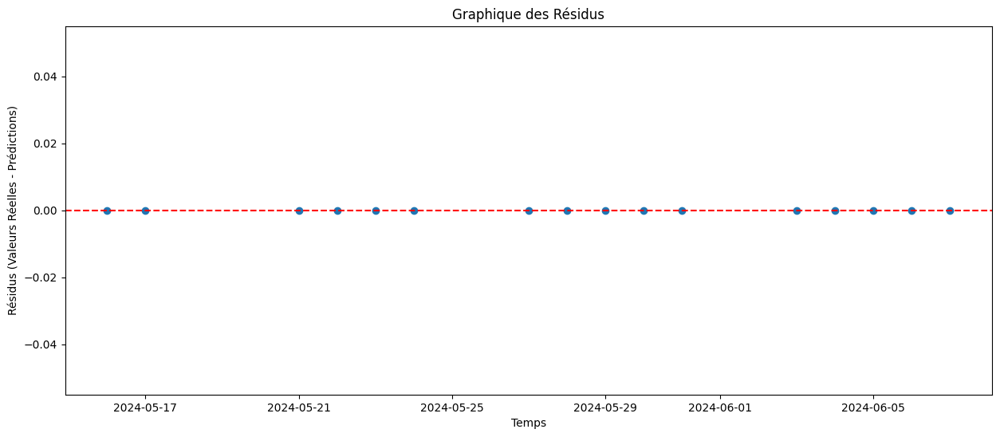

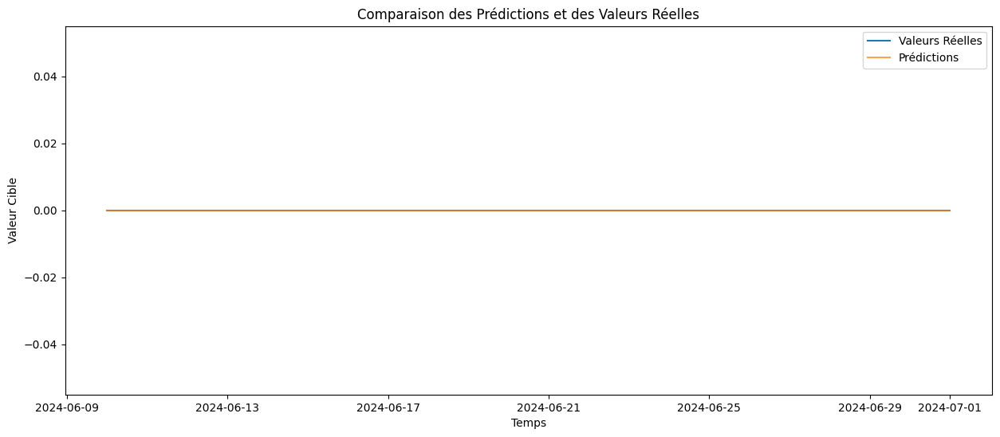

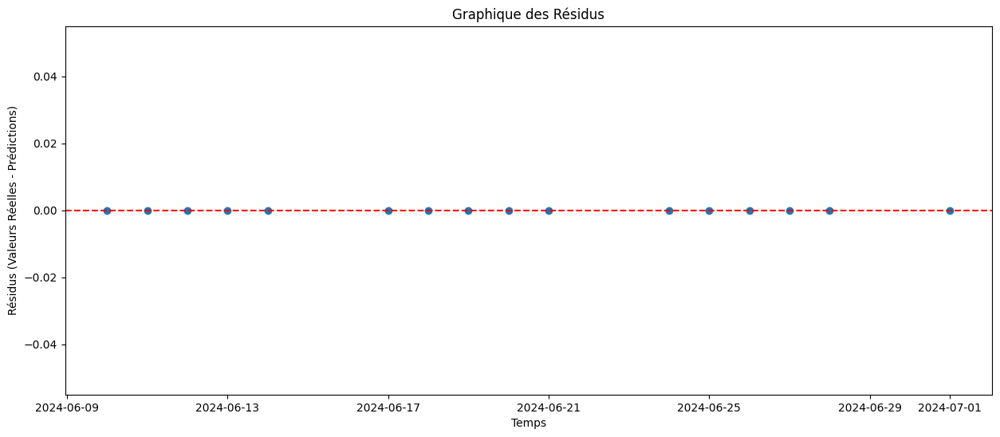

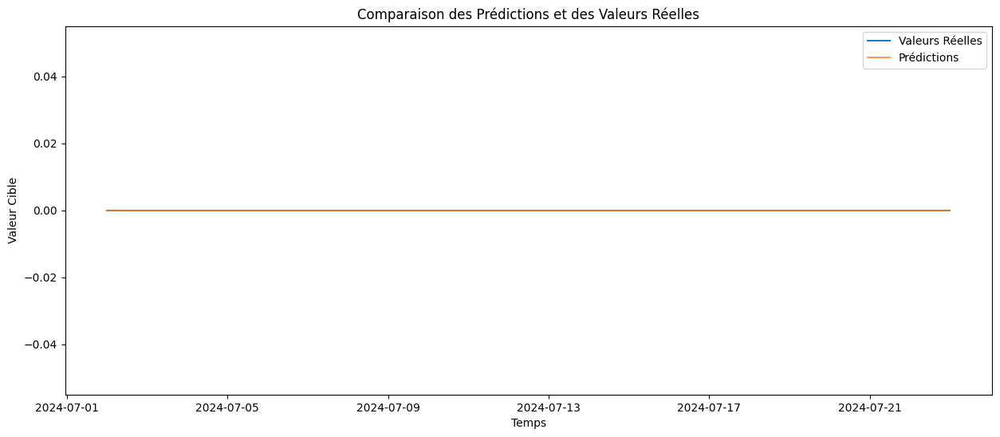

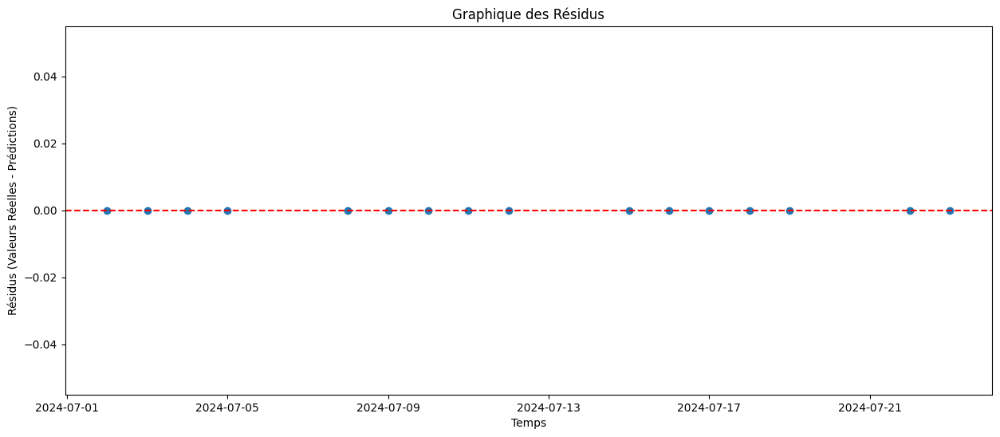

Rolling Window Analysis Average MSE for LNAC4_Collec: 0.0
Processing series: LNAC6_Collec
Temporal Cross-Validation Average MSE for LNAC6_Collec: 151976798.5703775
Enhanced Resampling MSE for LNAC6_Collec: 273565268.4530733
Ensemble MSE with Varied Historical Contexts for LNAC6_Collec: 161755824.1288327
Average MSE with Cross-Validation on Shuffled Data for LNAC6_Collec: 213981485.98118138


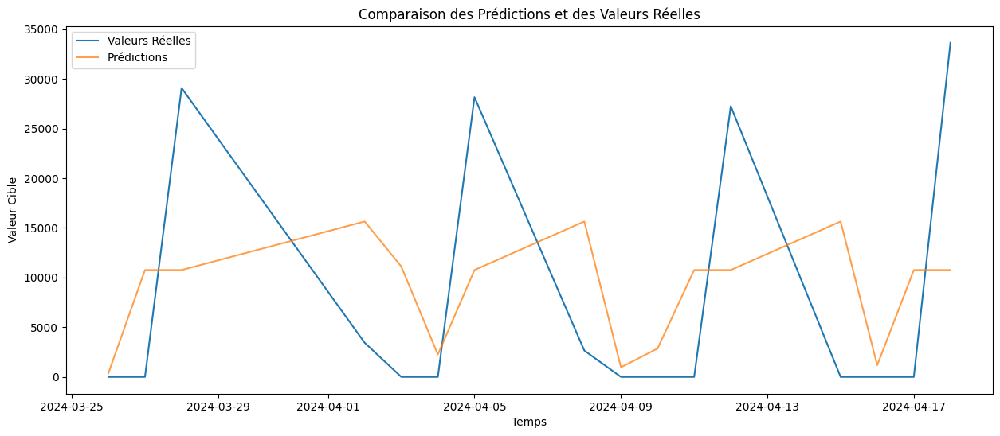

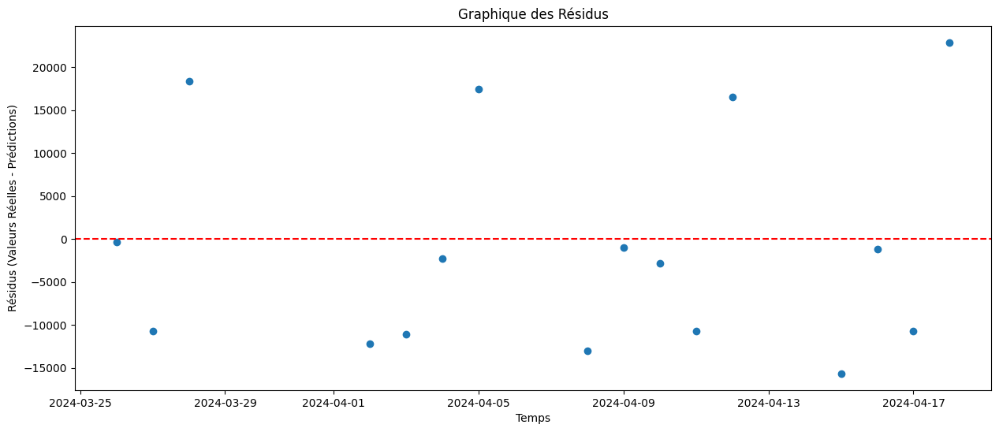

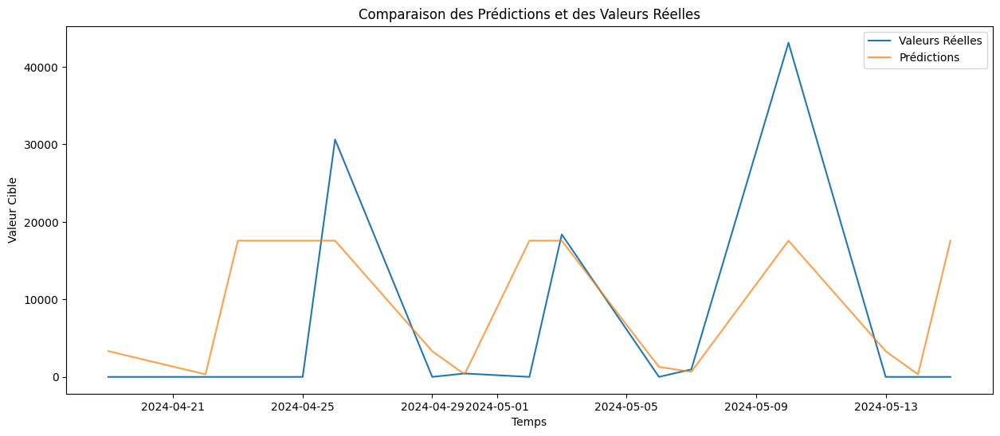

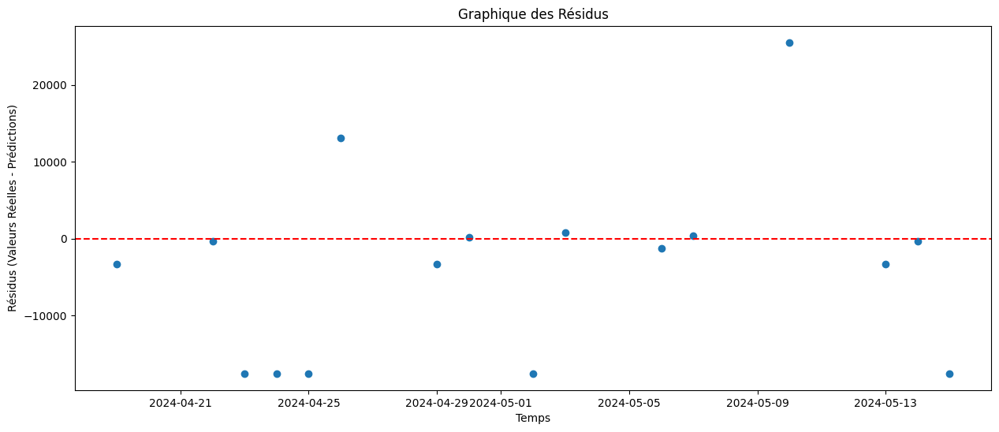

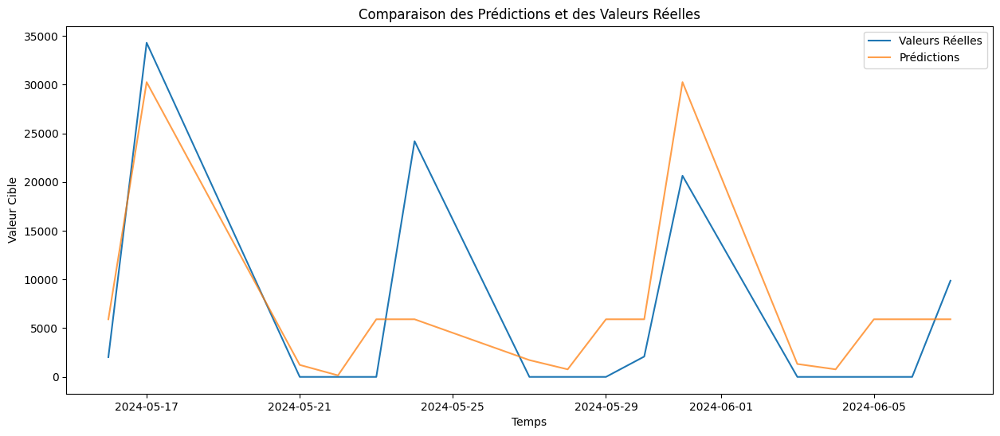

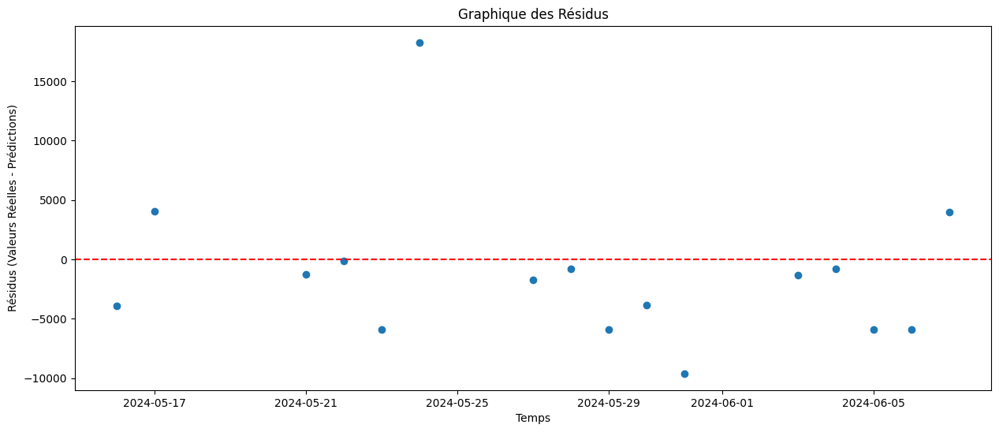

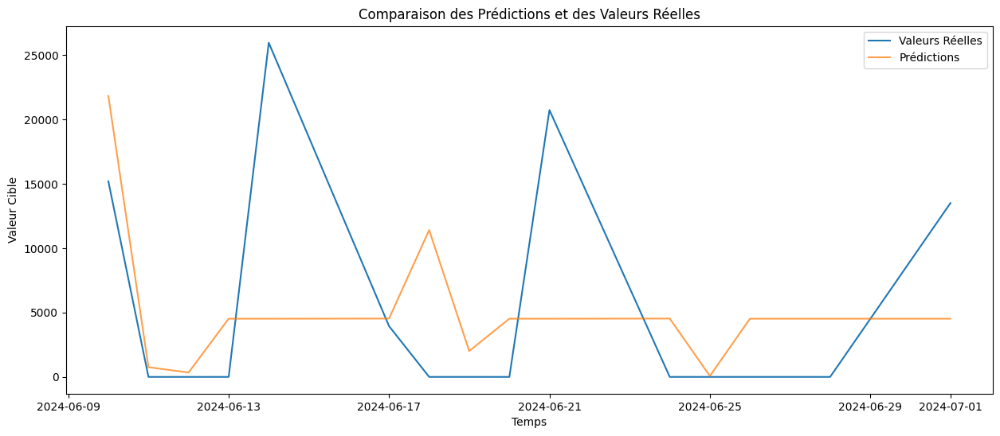

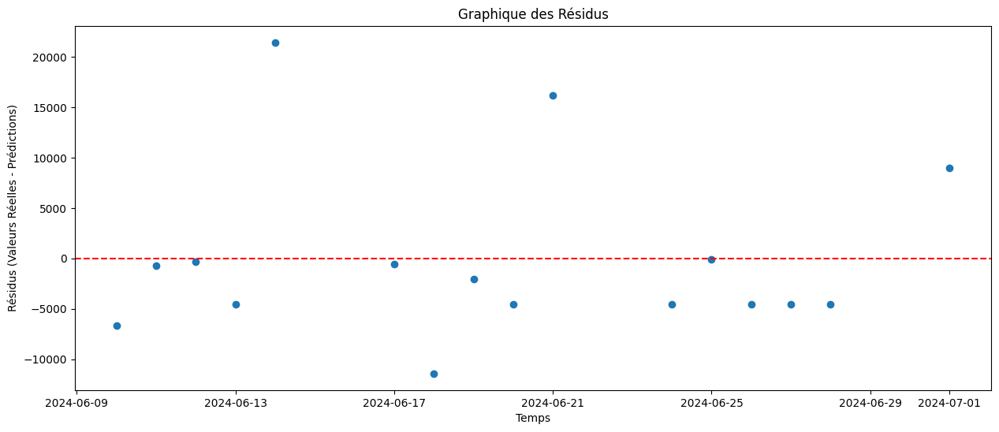

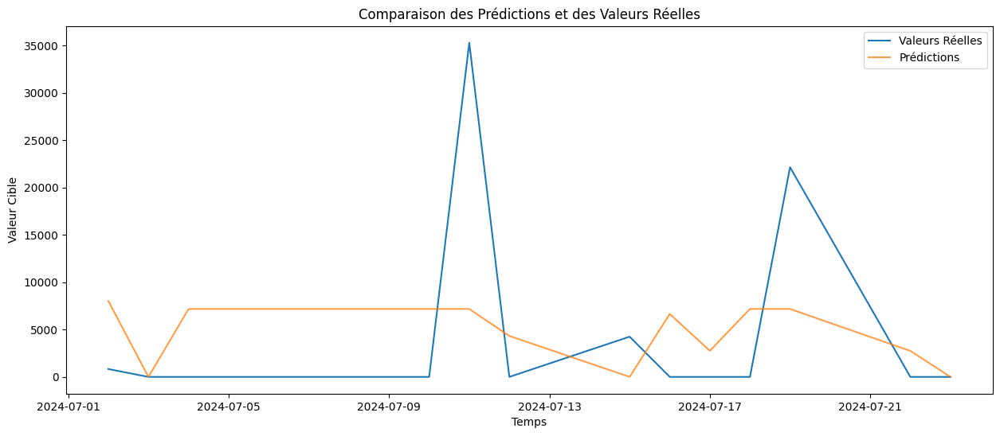

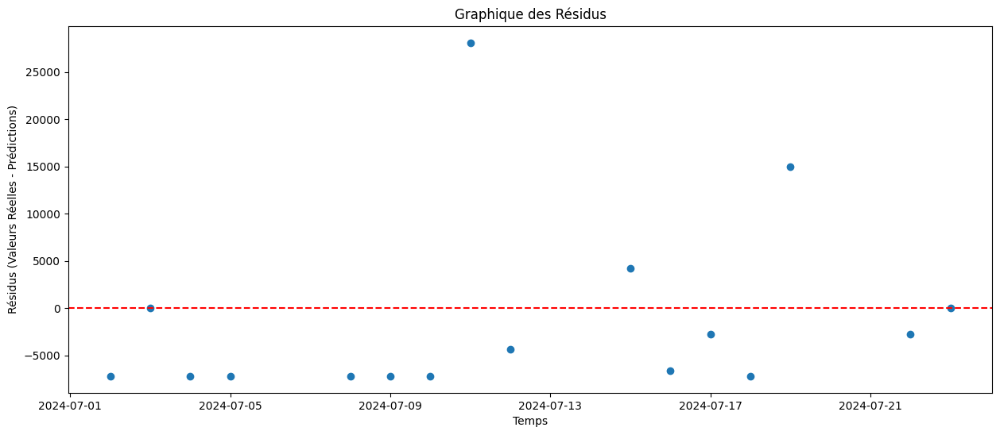

Rolling Window Analysis Average MSE for LNAC6_Collec: 101197178.71574943
Processing series: LNDOL_Collec
Temporal Cross-Validation Average MSE for LNDOL_Collec: 4265366425252.3877
Enhanced Resampling MSE for LNDOL_Collec: 2498096346326.681
Ensemble MSE with Varied Historical Contexts for LNDOL_Collec: 4343446719730.7993
Average MSE with Cross-Validation on Shuffled Data for LNDOL_Collec: 4953454346861.213


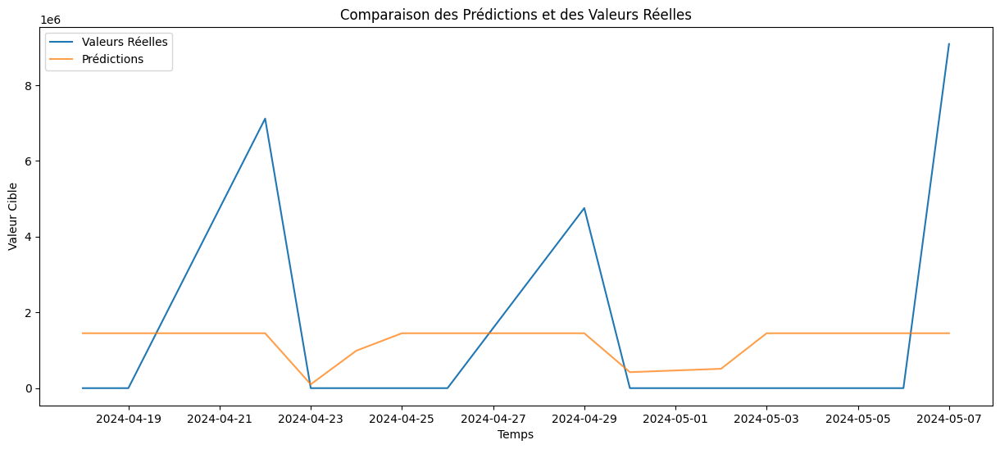

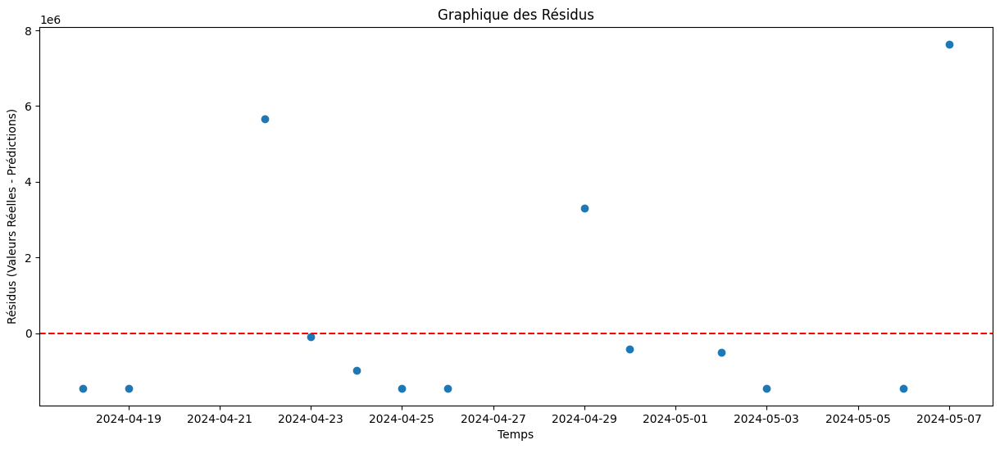

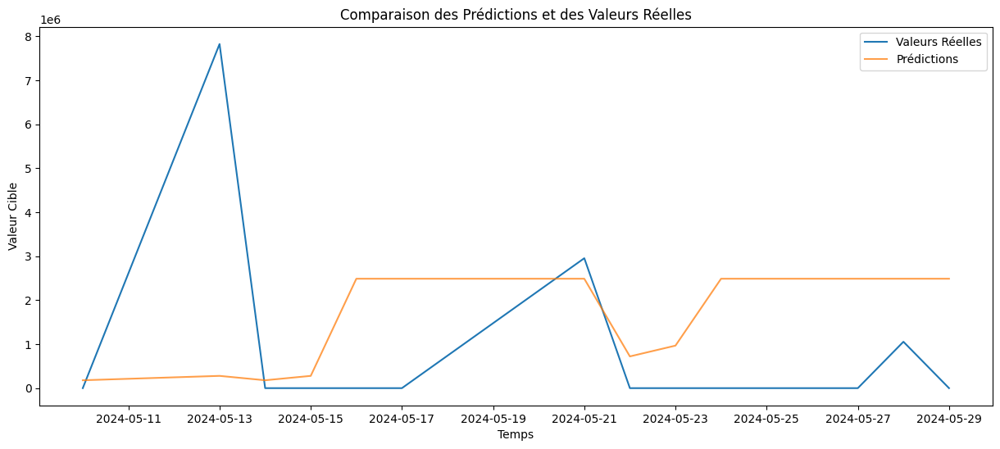

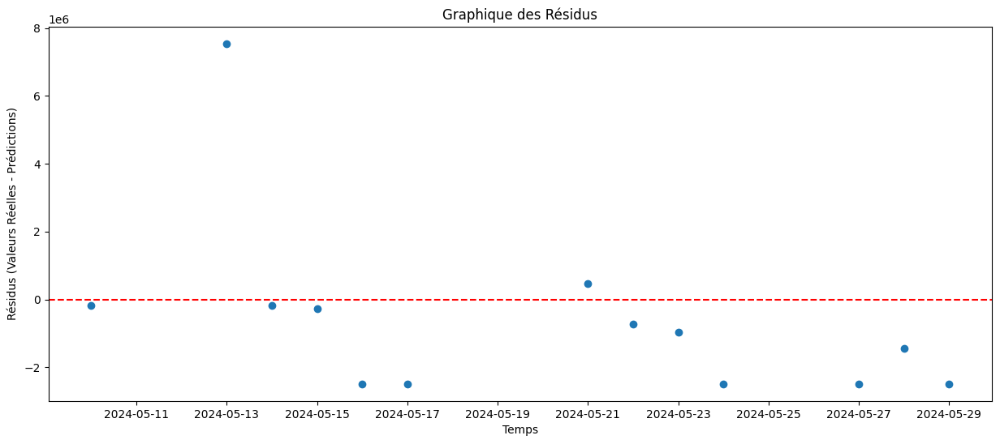

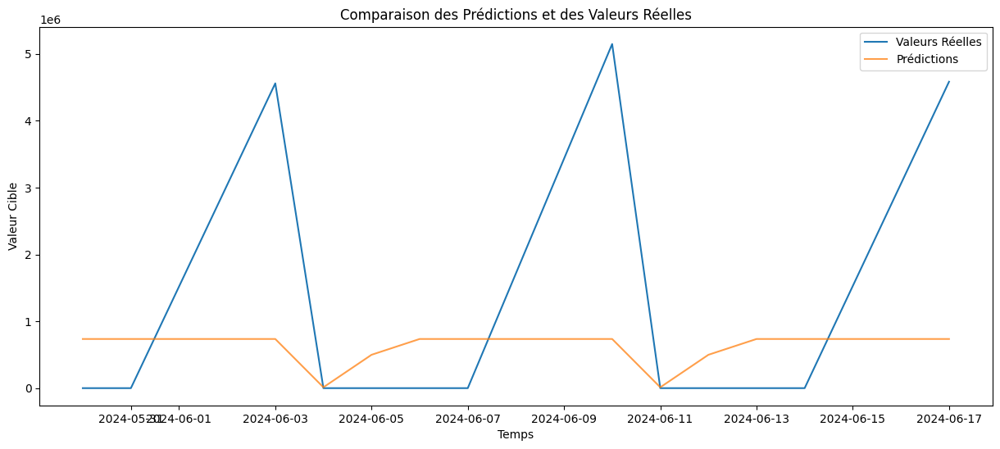

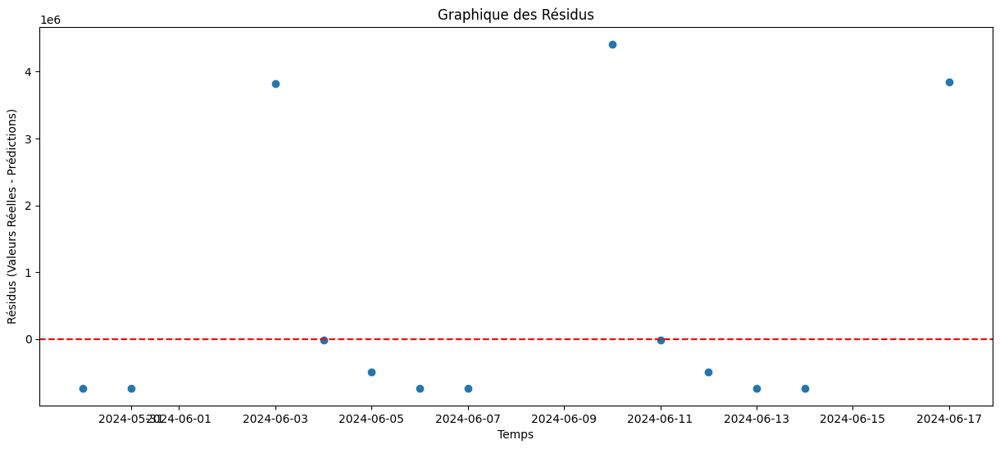

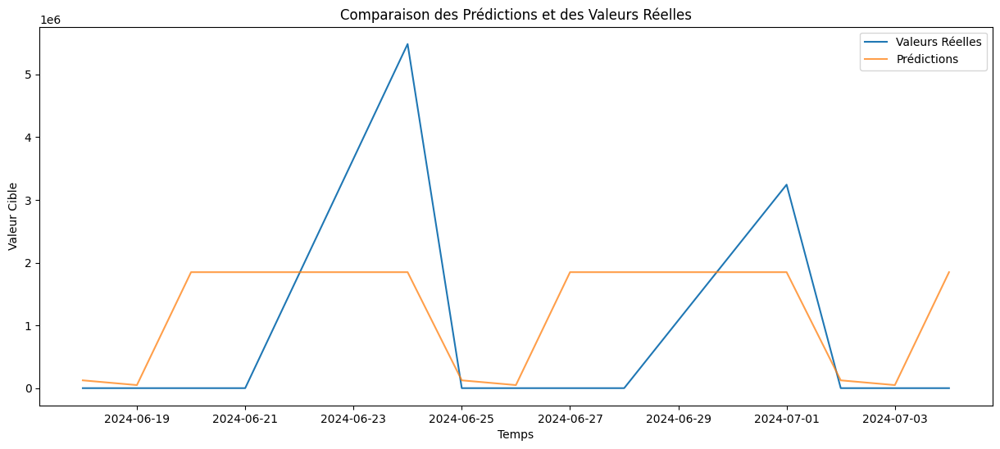

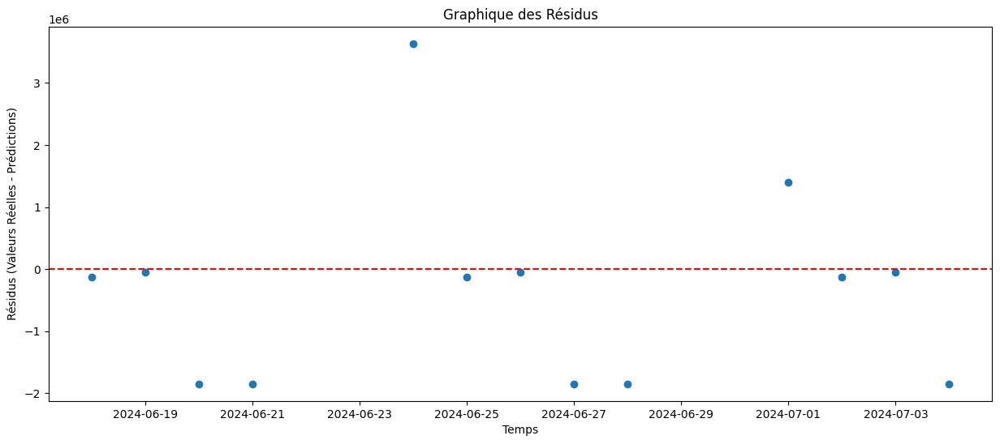

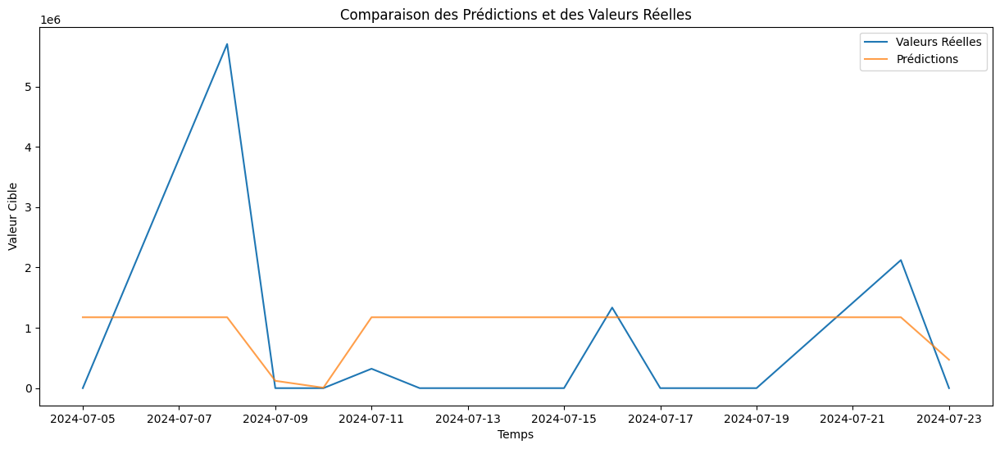

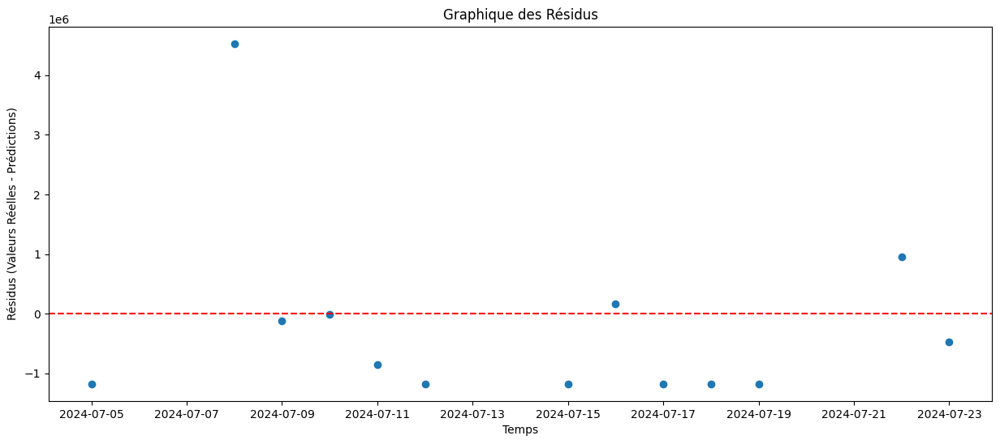

Rolling Window Analysis Average MSE for LNDOL_Collec: 4965550436337.826
Processing series: LNEDI_Collec
Temporal Cross-Validation Average MSE for LNEDI_Collec: 75631396572881.84
Enhanced Resampling MSE for LNEDI_Collec: 69740700955509.95
Ensemble MSE with Varied Historical Contexts for LNEDI_Collec: 20973868893379.15
Average MSE with Cross-Validation on Shuffled Data for LNEDI_Collec: 78682247985261.45


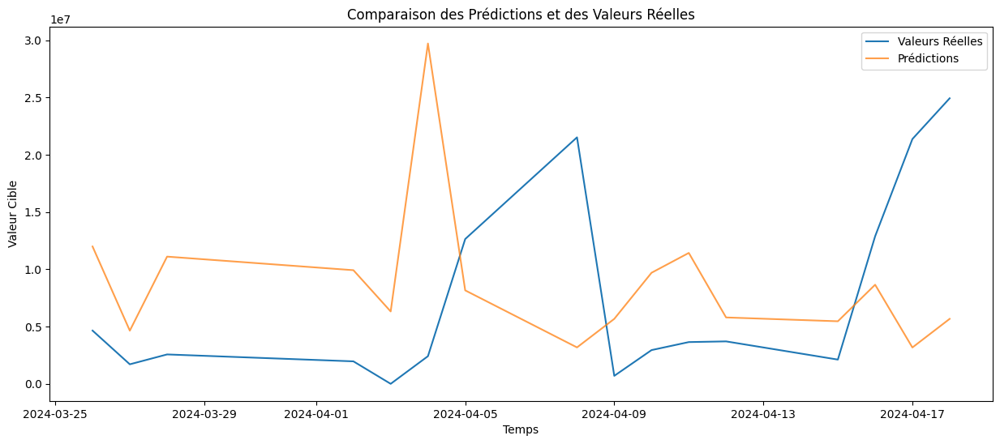

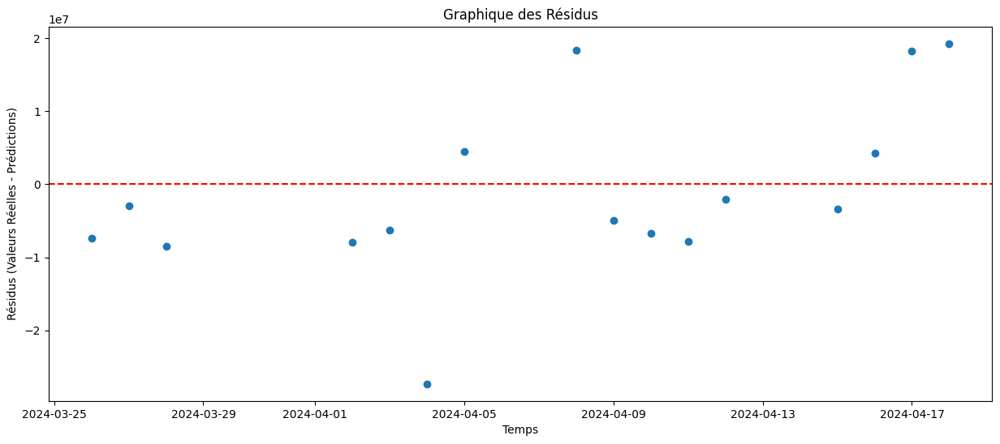

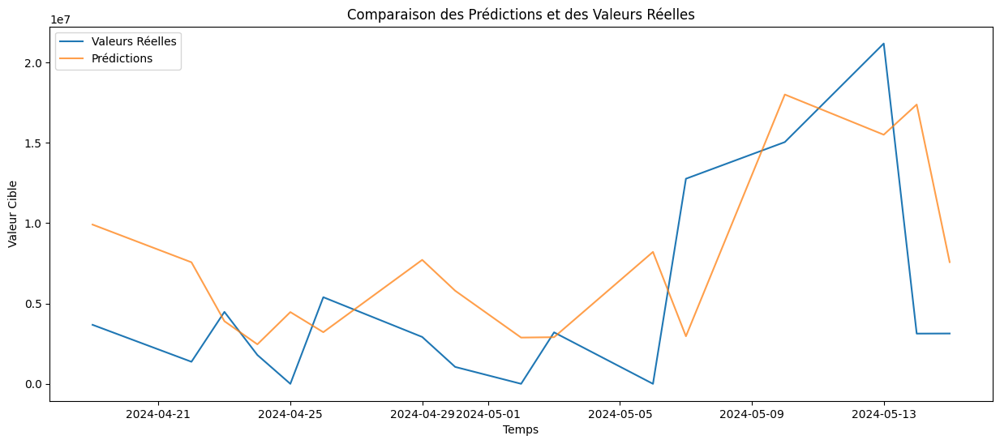

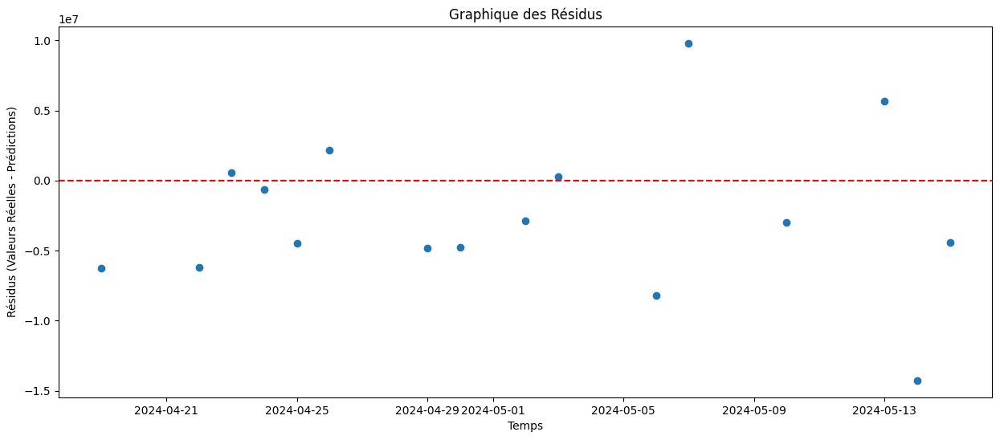

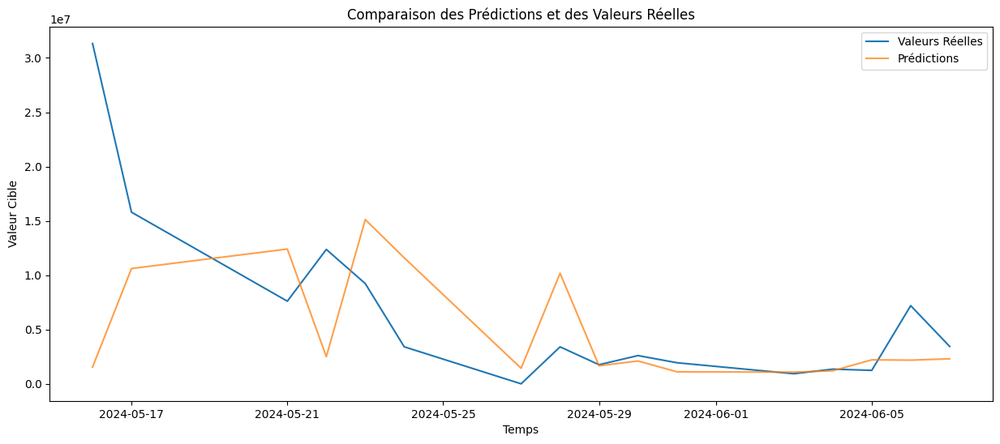

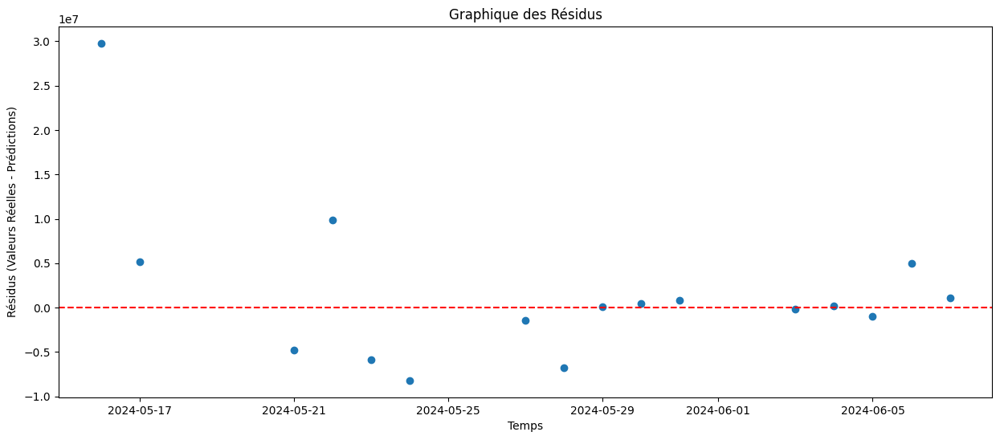

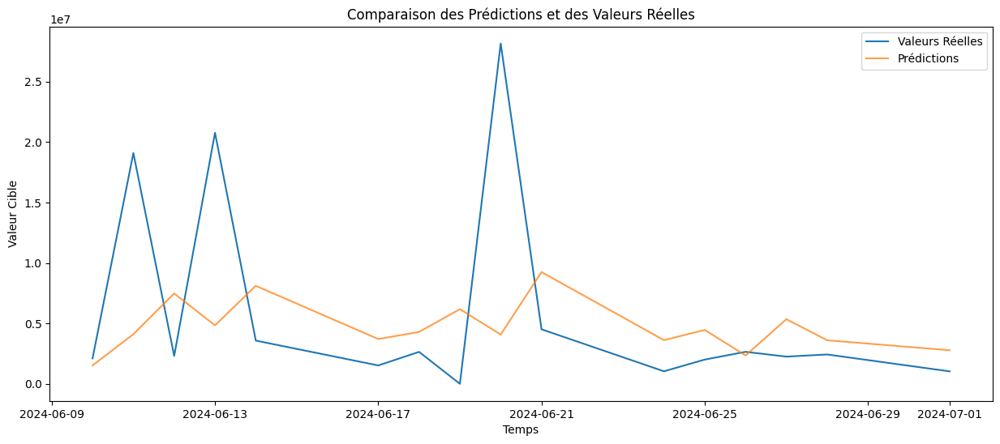

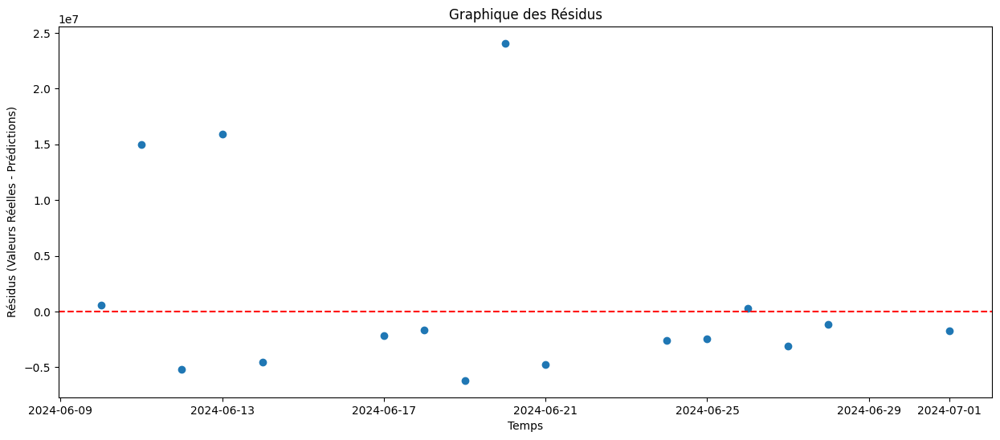

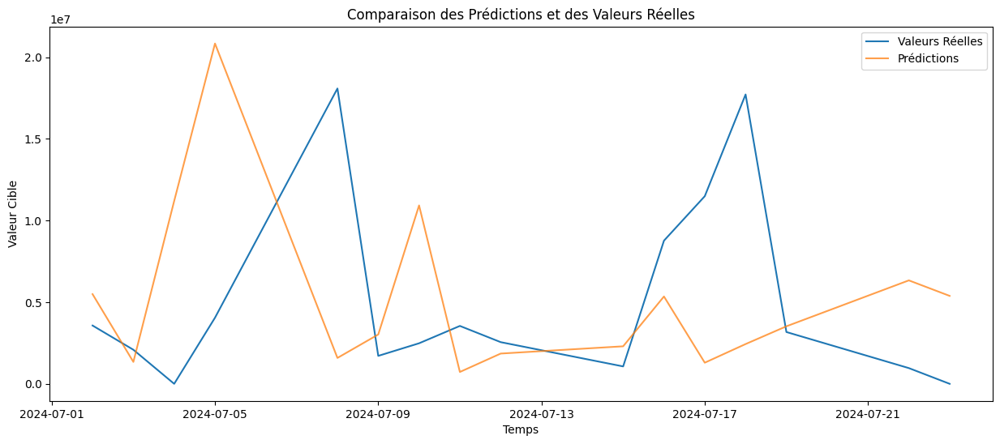

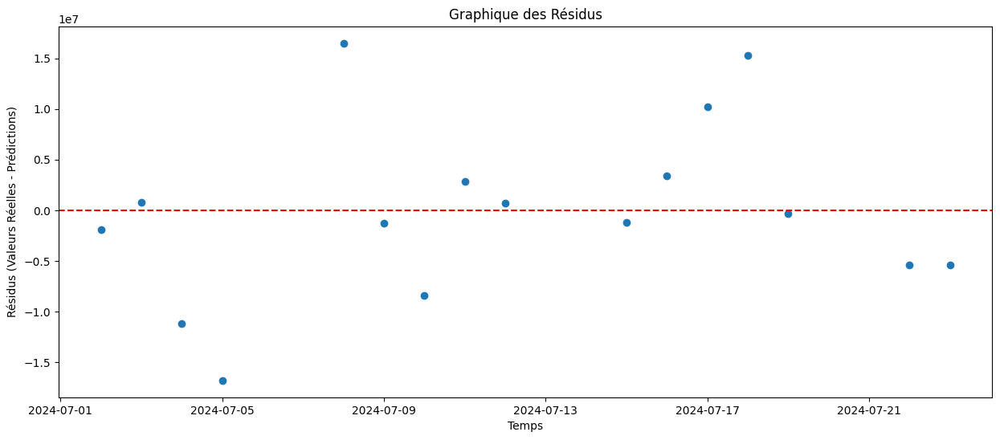

Rolling Window Analysis Average MSE for LNEDI_Collec: 79743322728147.72
Processing series: LNEDN_Collec
Temporal Cross-Validation Average MSE for LNEDN_Collec: 11133261981420.807
Enhanced Resampling MSE for LNEDN_Collec: 7796032247178.364
Ensemble MSE with Varied Historical Contexts for LNEDN_Collec: 4048160721474.661
Average MSE with Cross-Validation on Shuffled Data for LNEDN_Collec: 11919856412352.05


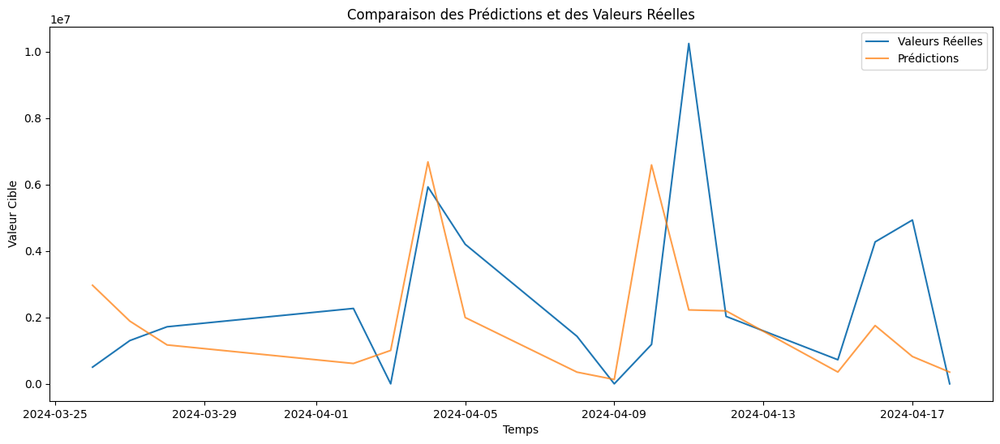

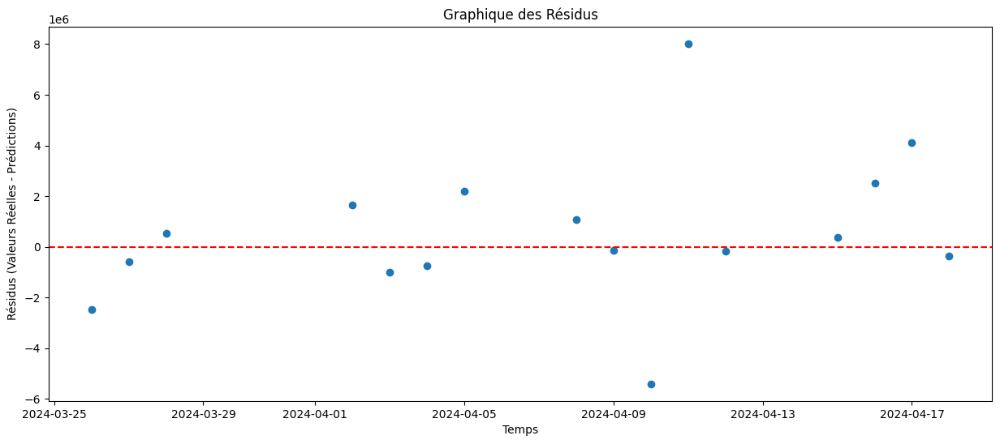

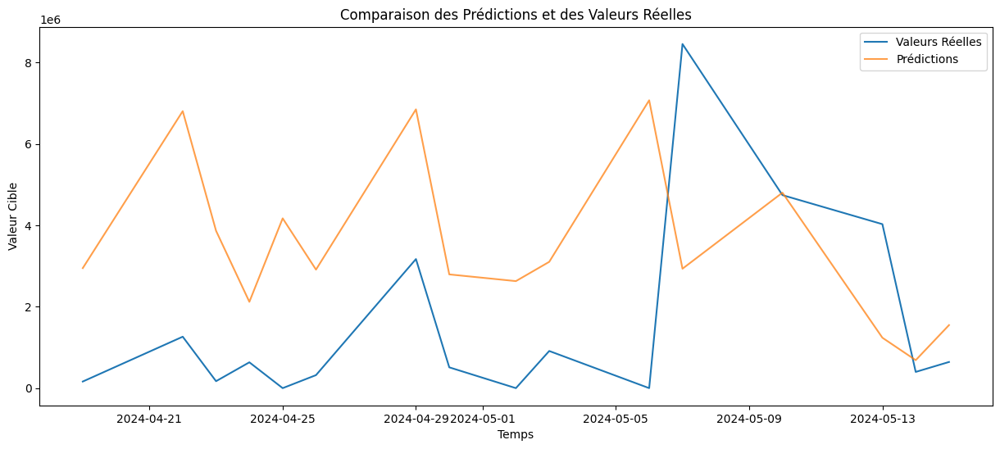

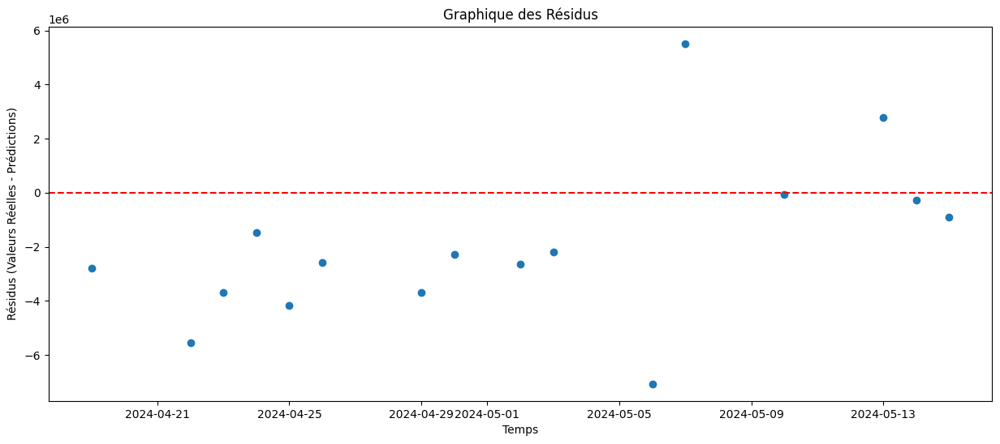

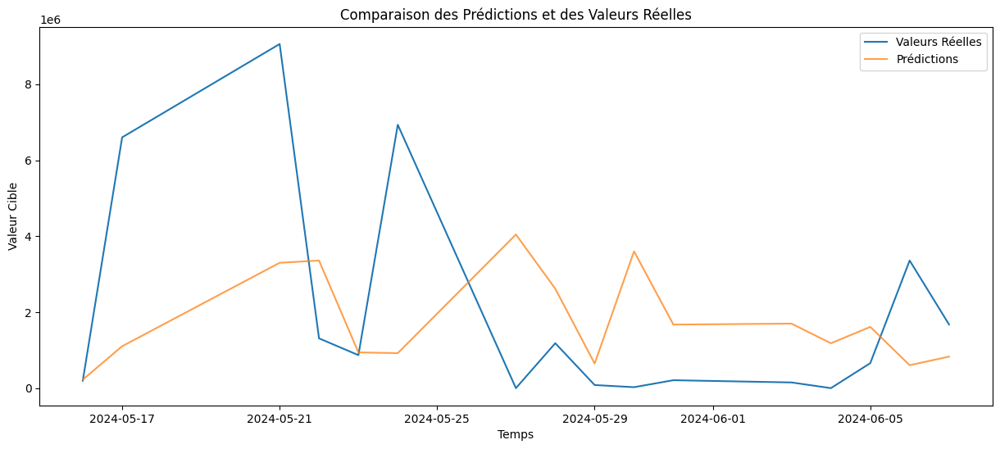

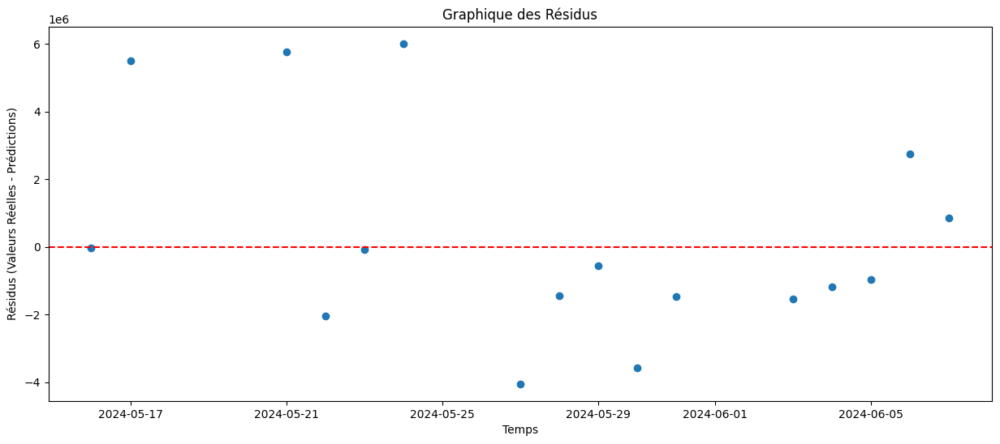

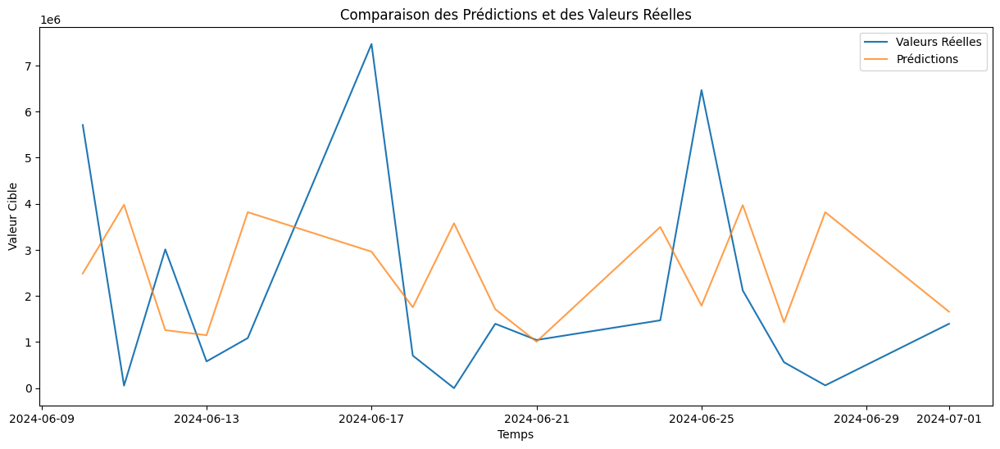

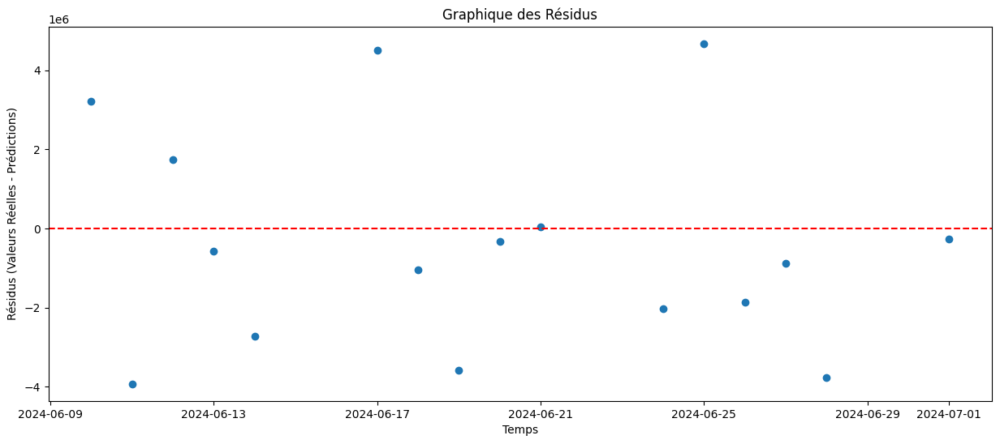

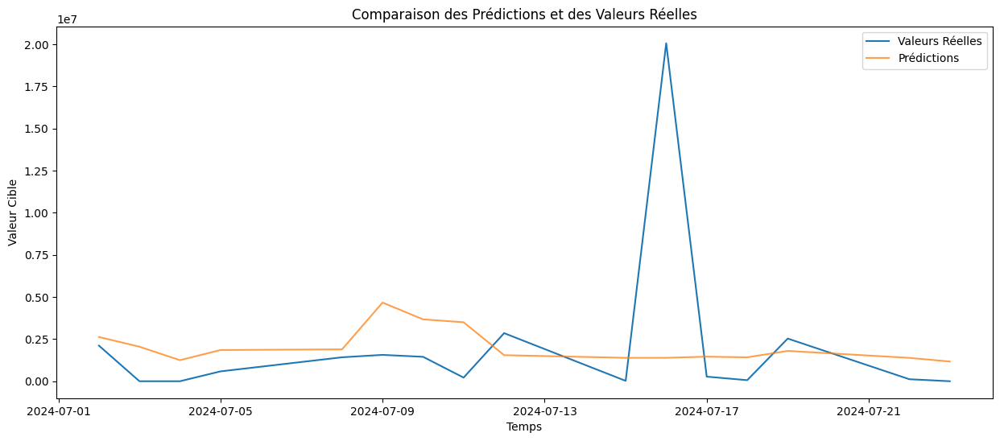

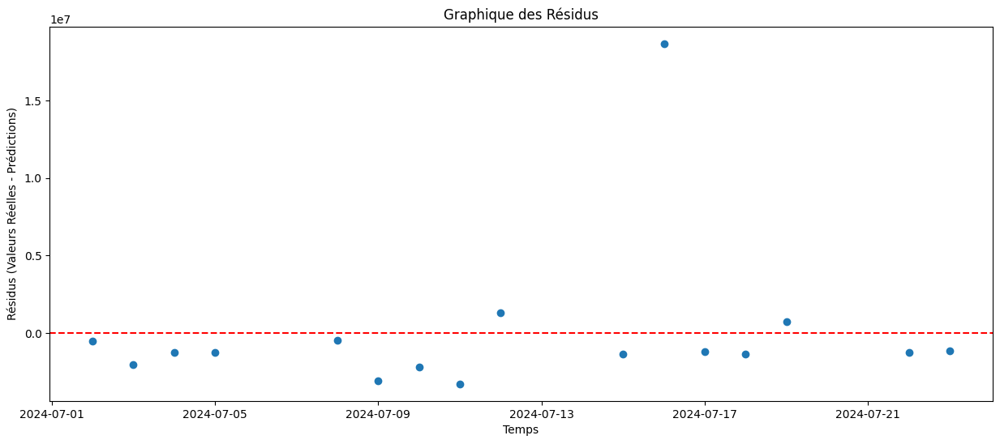

Rolling Window Analysis Average MSE for LNEDN_Collec: 12379581359441.338
Processing series: LNENT_Collec
Temporal Cross-Validation Average MSE for LNENT_Collec: 905447976672253.8
Enhanced Resampling MSE for LNENT_Collec: 910690573747617.5
Ensemble MSE with Varied Historical Contexts for LNENT_Collec: 299330467883874.4
Average MSE with Cross-Validation on Shuffled Data for LNENT_Collec: 740925024415512.9


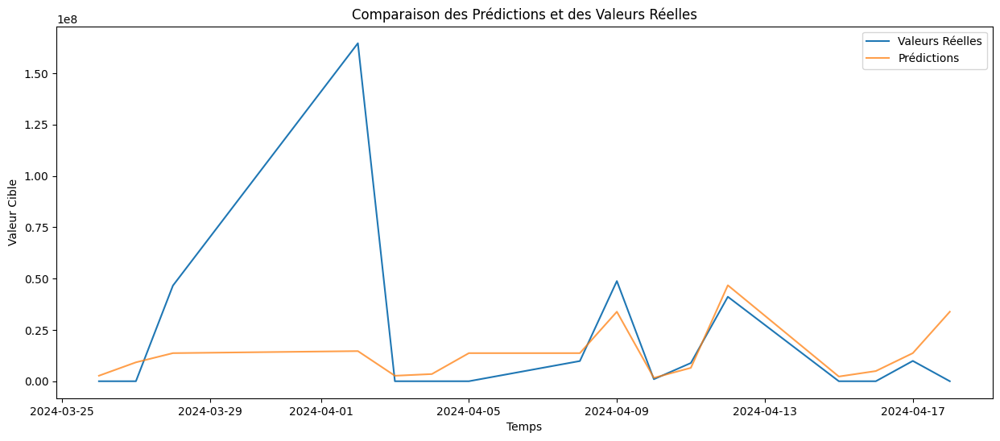

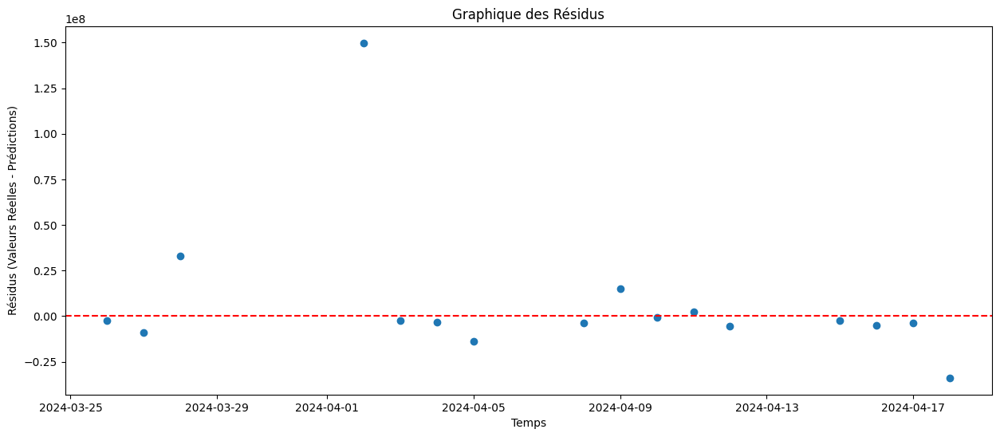

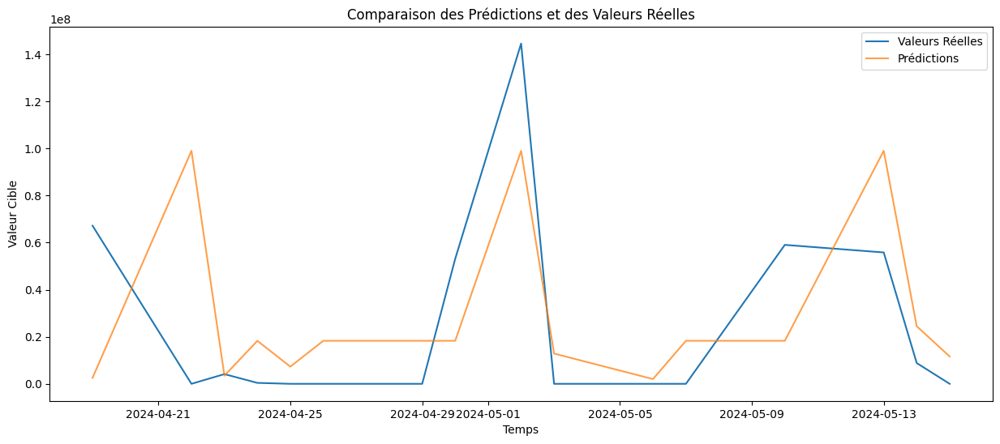

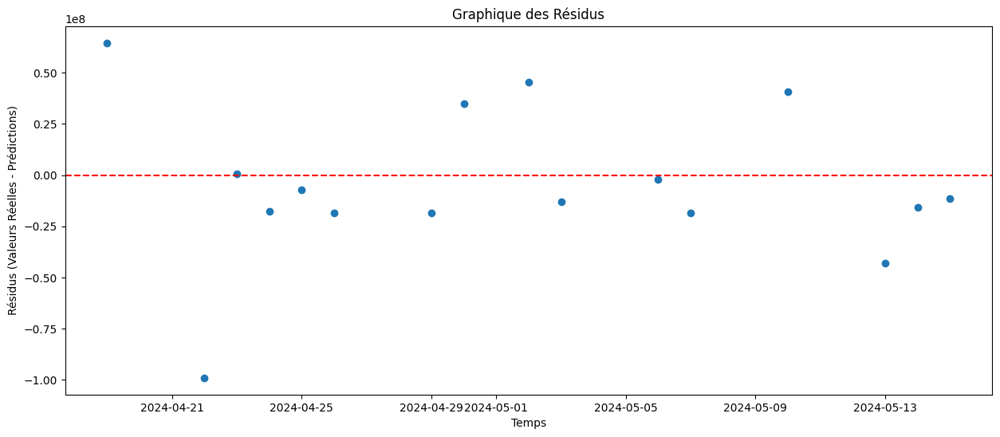

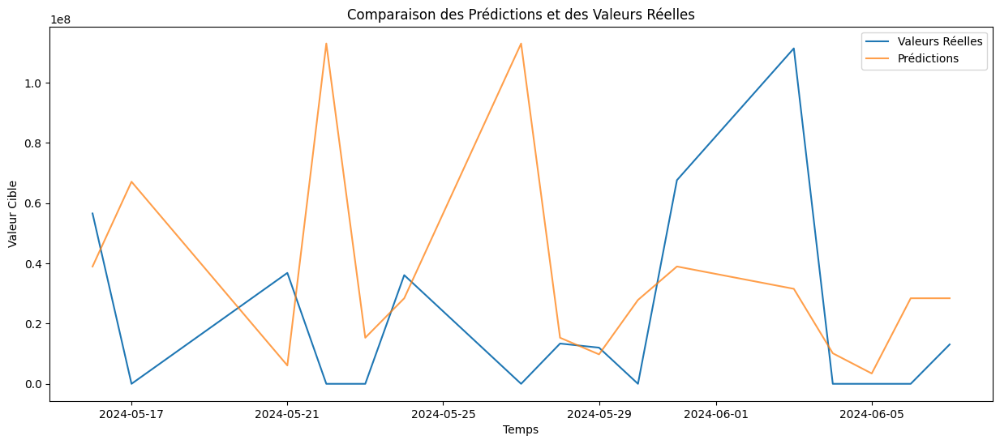

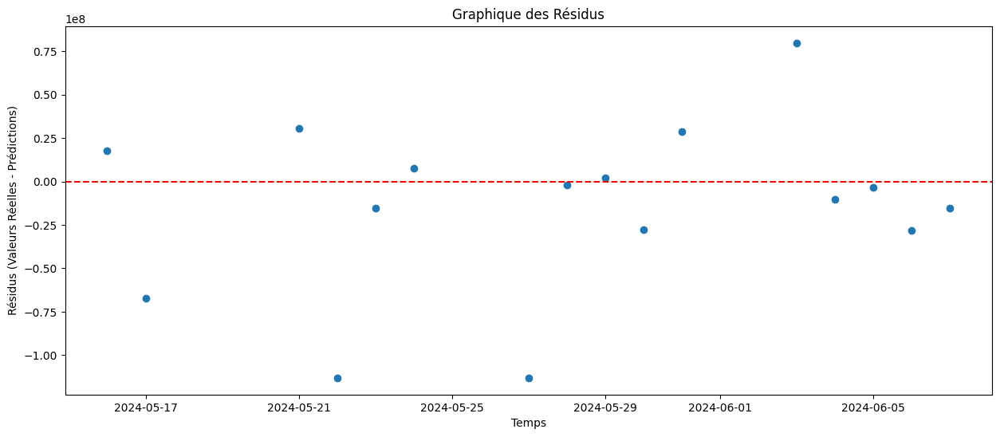

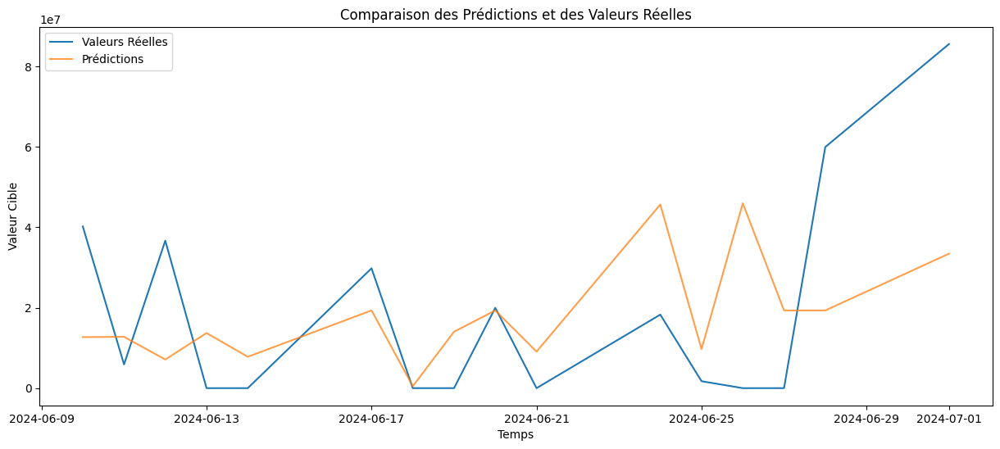

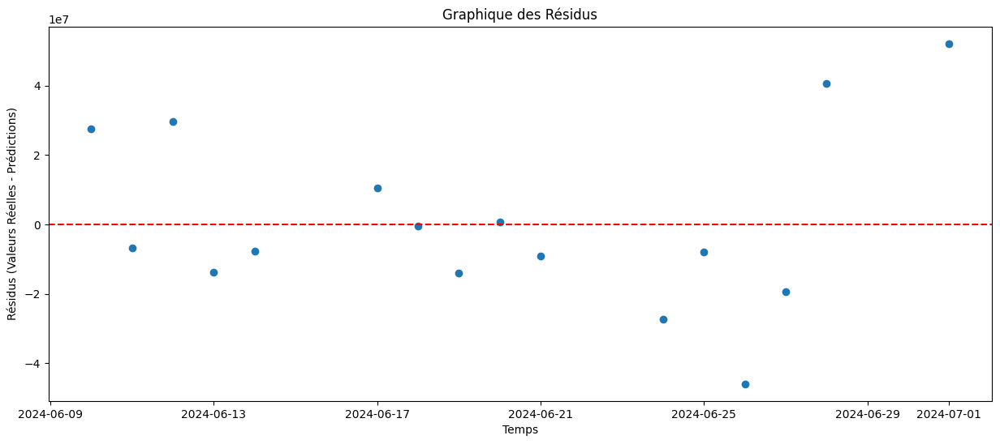

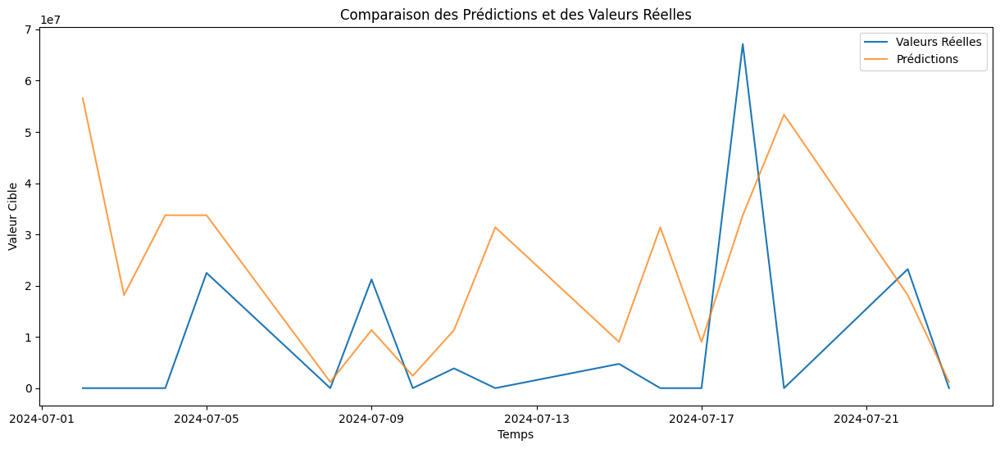

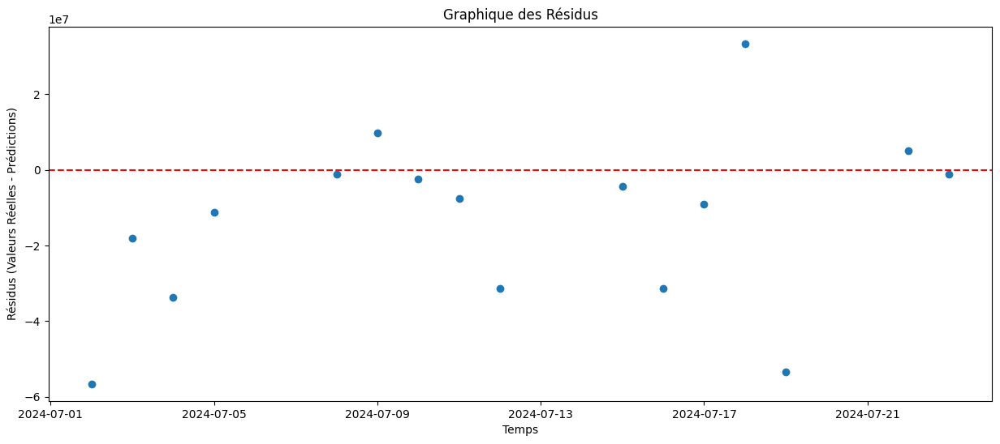

Rolling Window Analysis Average MSE for LNENT_Collec: 1372544988702239.5
Processing series: LNENE_Collec
Temporal Cross-Validation Average MSE for LNENE_Collec: 539950625740902.8
Enhanced Resampling MSE for LNENE_Collec: 593255911800511.0
Ensemble MSE with Varied Historical Contexts for LNENE_Collec: 245184103673702.0
Average MSE with Cross-Validation on Shuffled Data for LNENE_Collec: 516739904800983.5


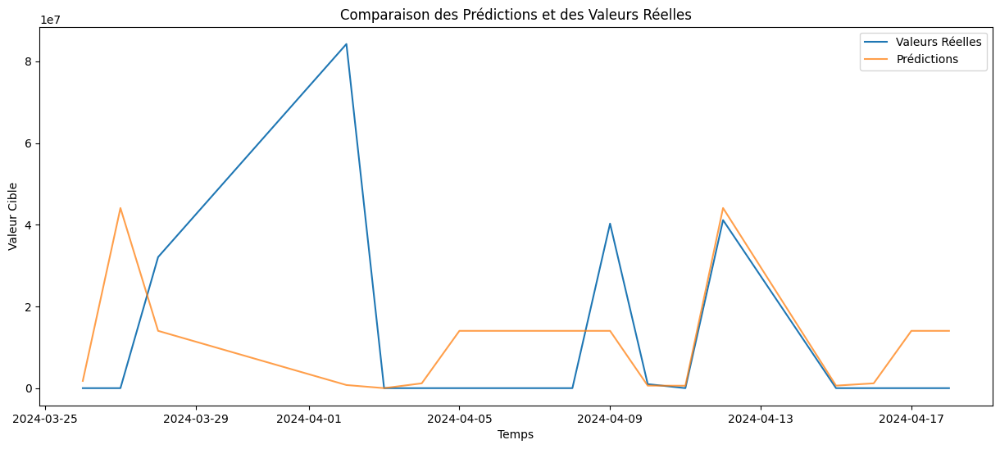

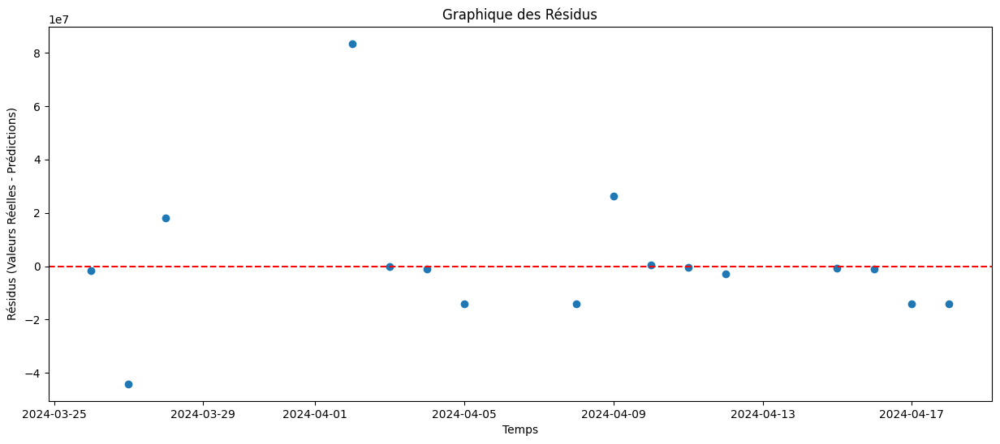

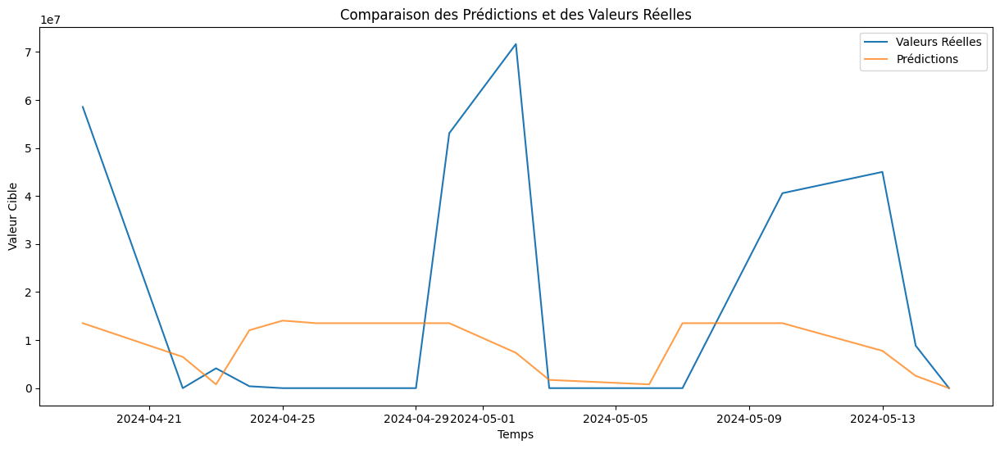

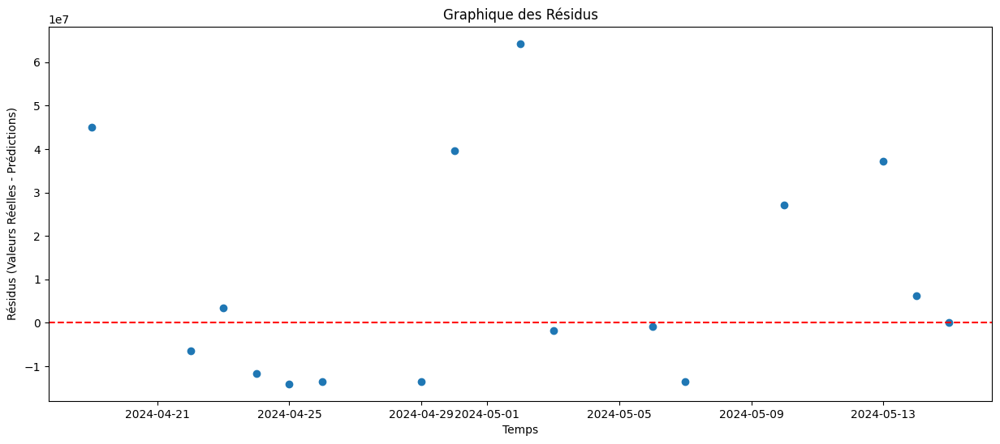

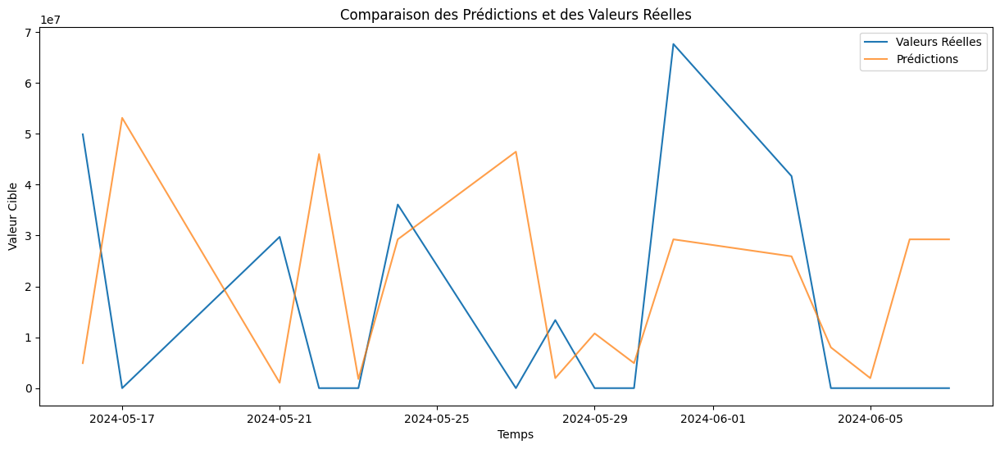

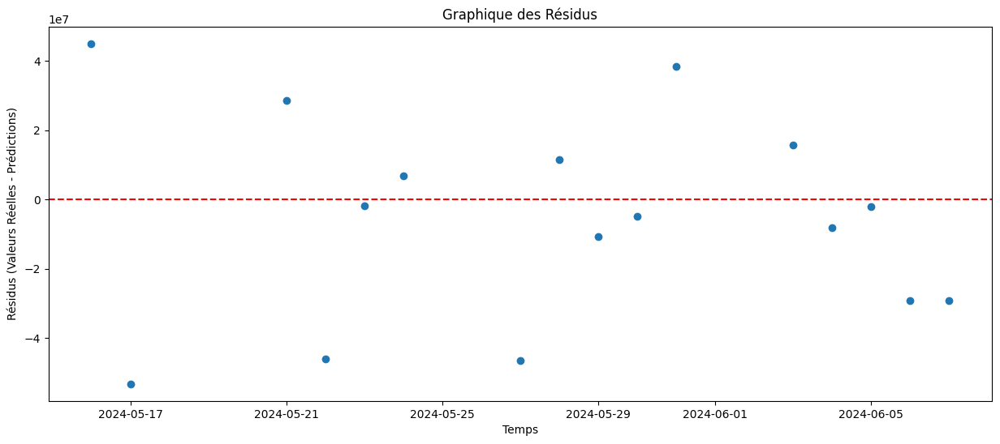

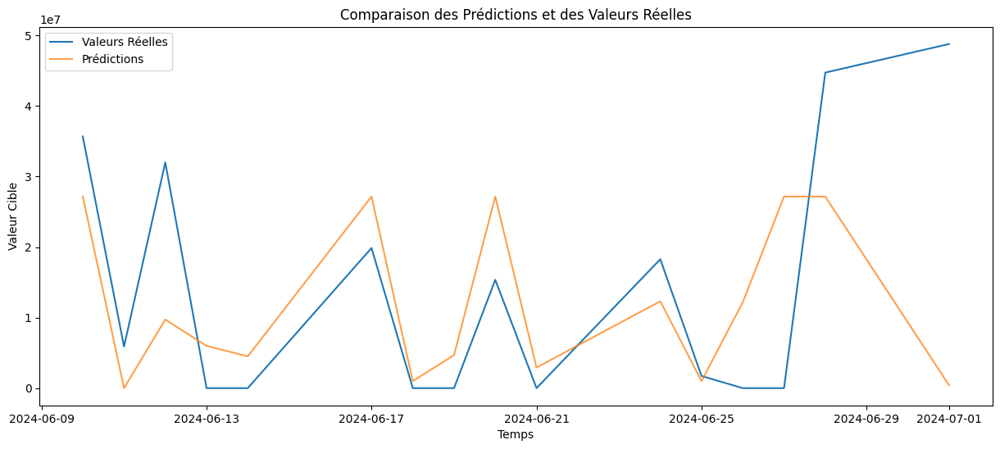

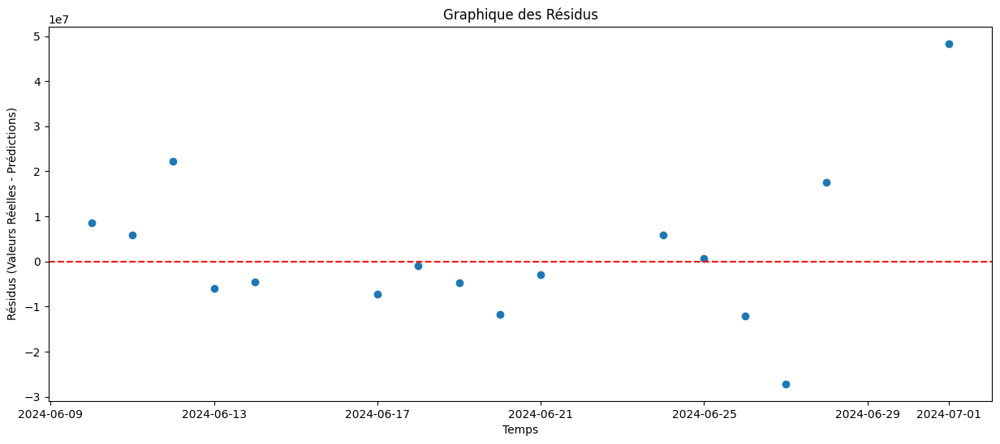

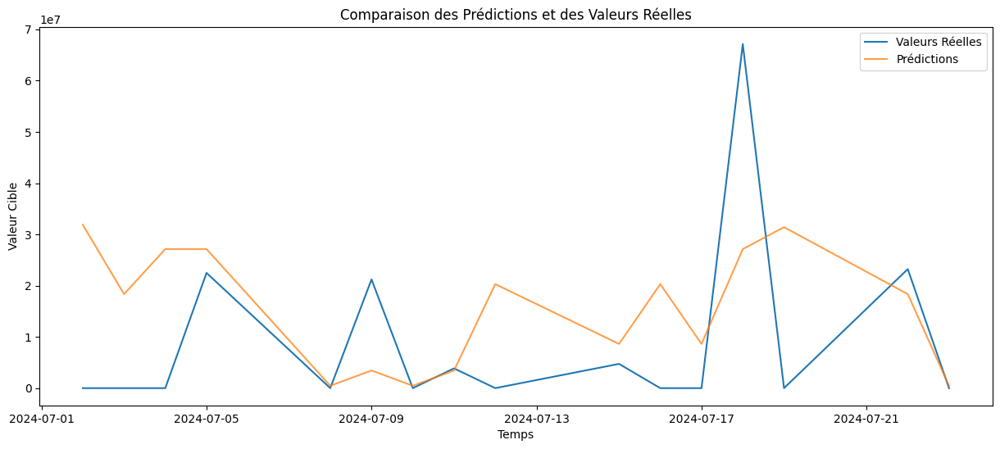

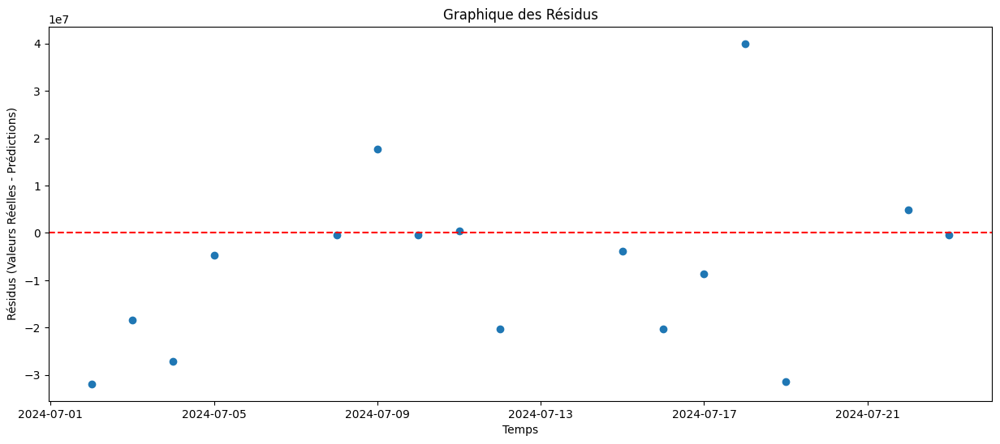

Rolling Window Analysis Average MSE for LNENE_Collec: 571621221292164.4
Processing series: LNENM_Collec
Temporal Cross-Validation Average MSE for LNENM_Collec: 301408273561025.3
Enhanced Resampling MSE for LNENM_Collec: 201960992924197.66
Ensemble MSE with Varied Historical Contexts for LNENM_Collec: 151846272902435.16
Average MSE with Cross-Validation on Shuffled Data for LNENM_Collec: 253896615195515.0


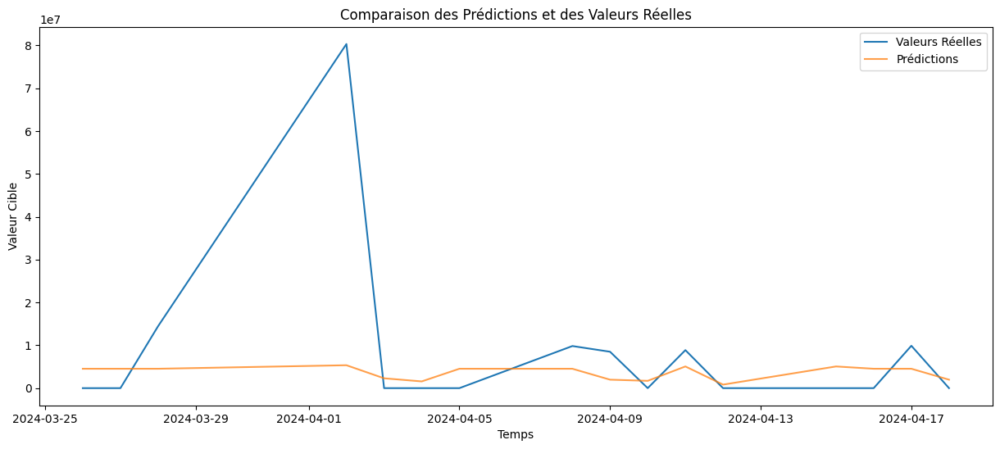

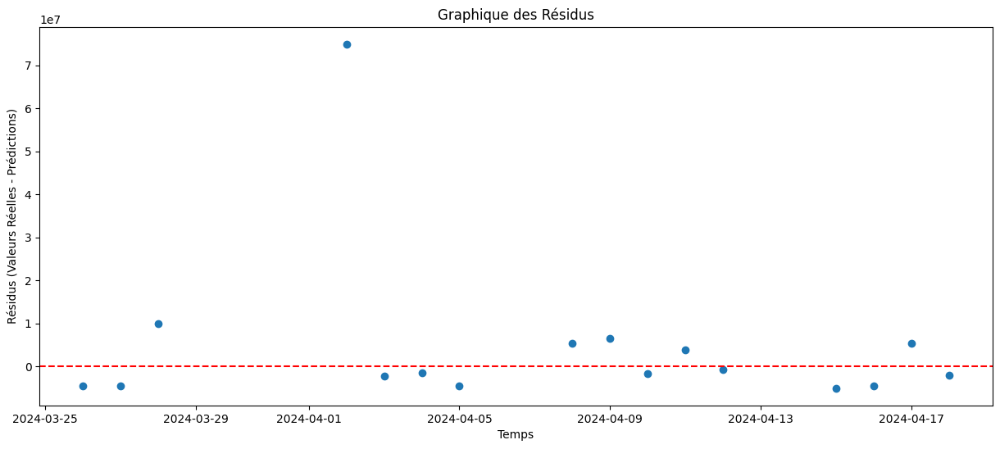

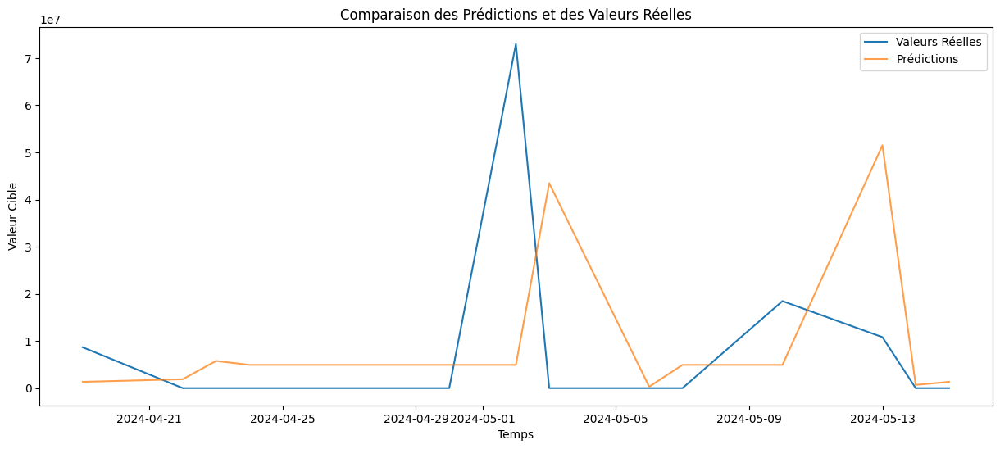

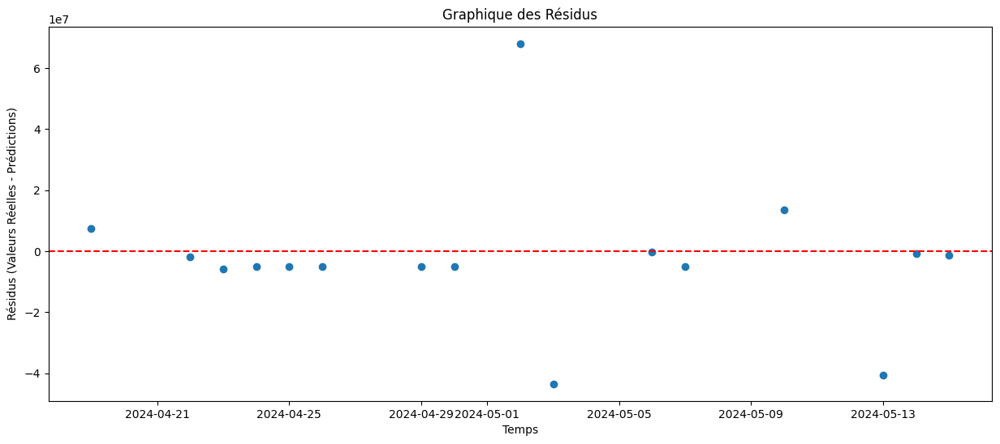

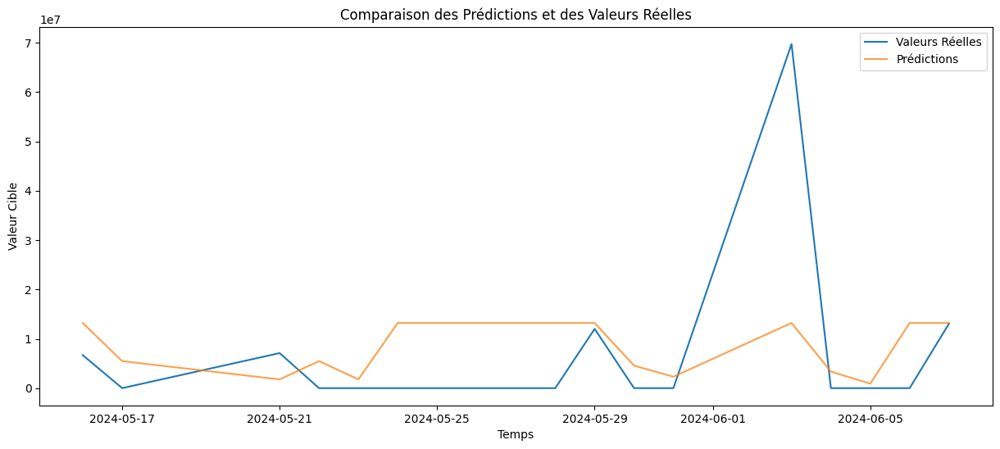

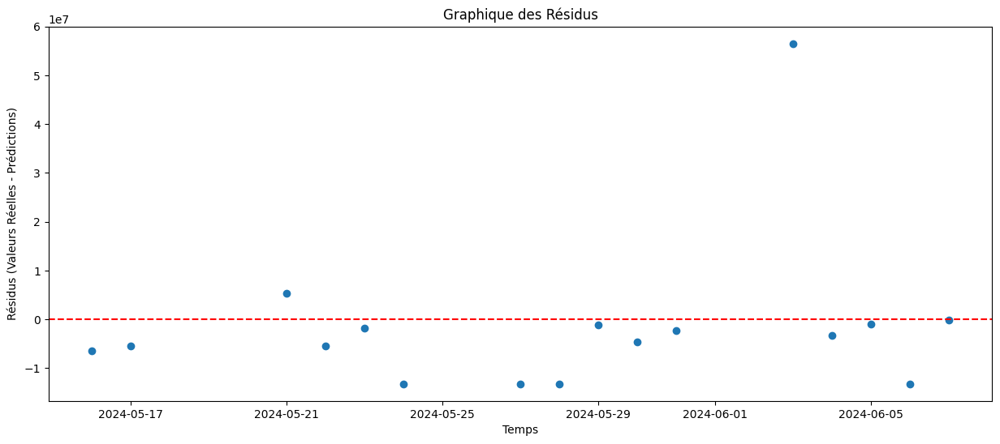

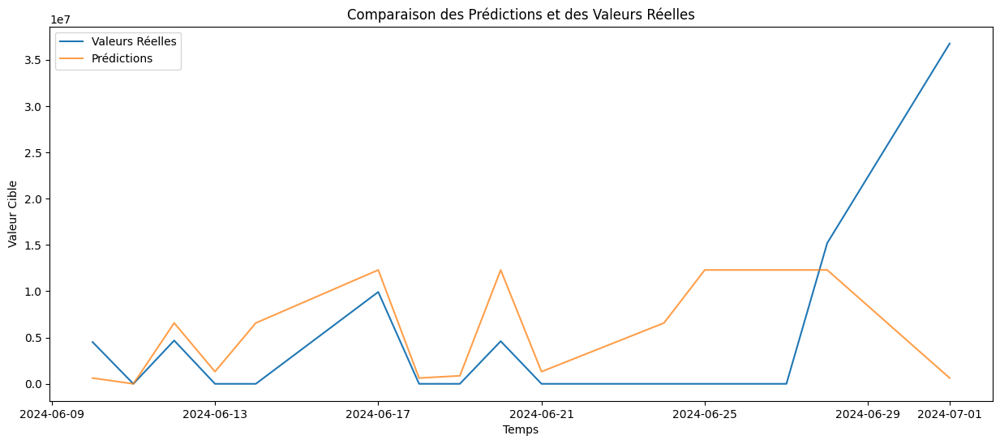

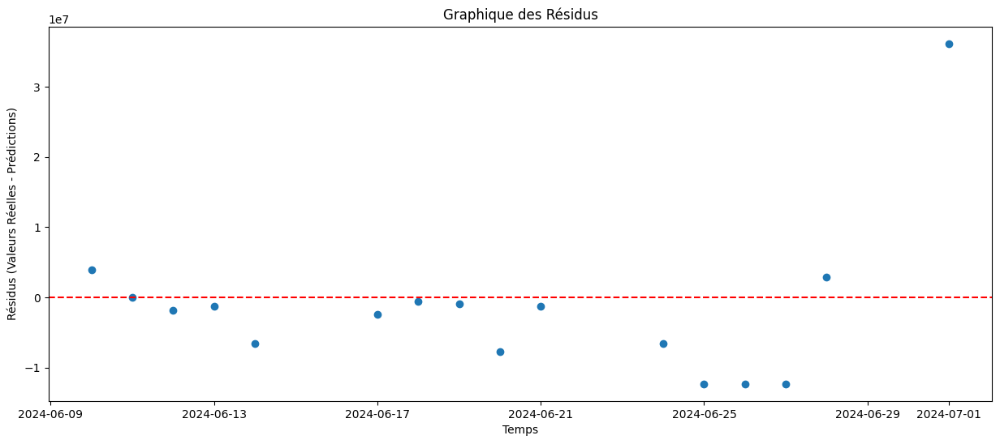

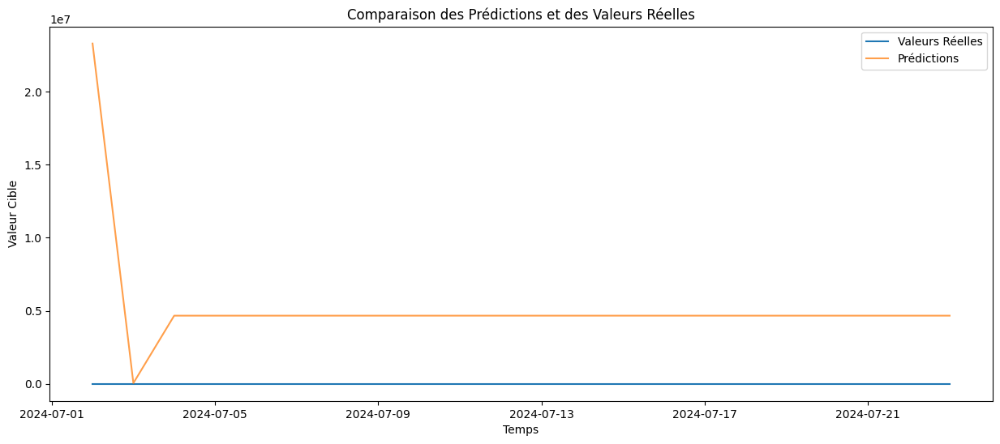

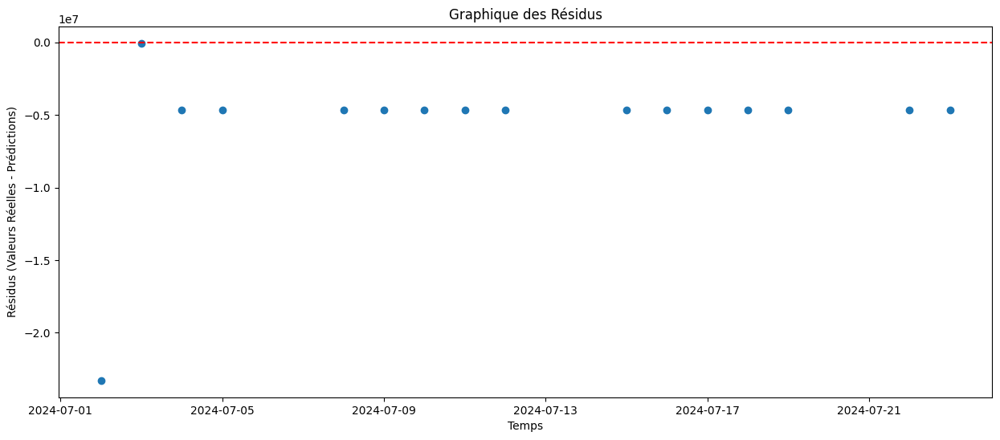

Rolling Window Analysis Average MSE for LNENM_Collec: 267675018849313.75
Processing series: LNEFM_Collec
Temporal Cross-Validation Average MSE for LNEFM_Collec: 6794478508472466.0
Enhanced Resampling MSE for LNEFM_Collec: 3101697435549585.5
Ensemble MSE with Varied Historical Contexts for LNEFM_Collec: 4146654962260318.0
Average MSE with Cross-Validation on Shuffled Data for LNEFM_Collec: 6825005698520250.0


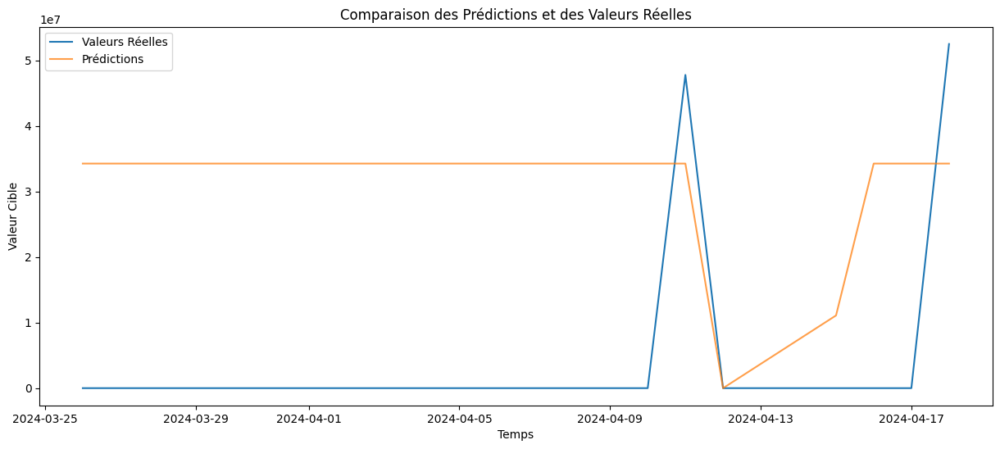

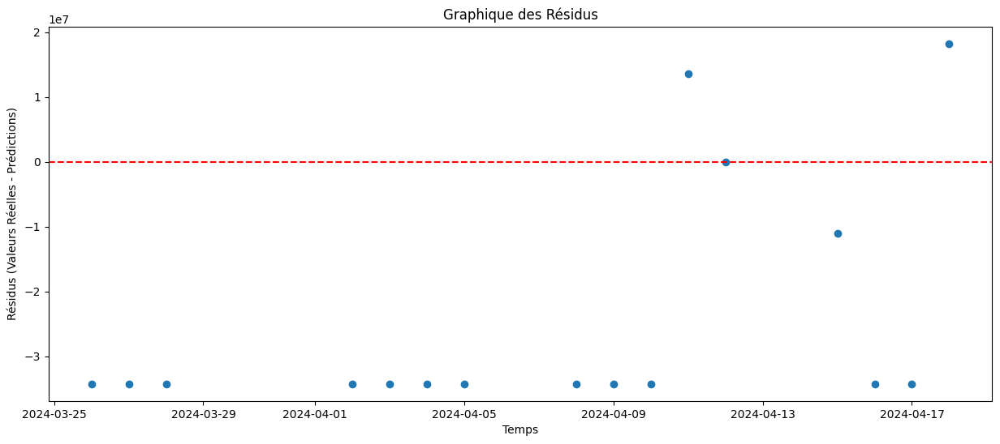

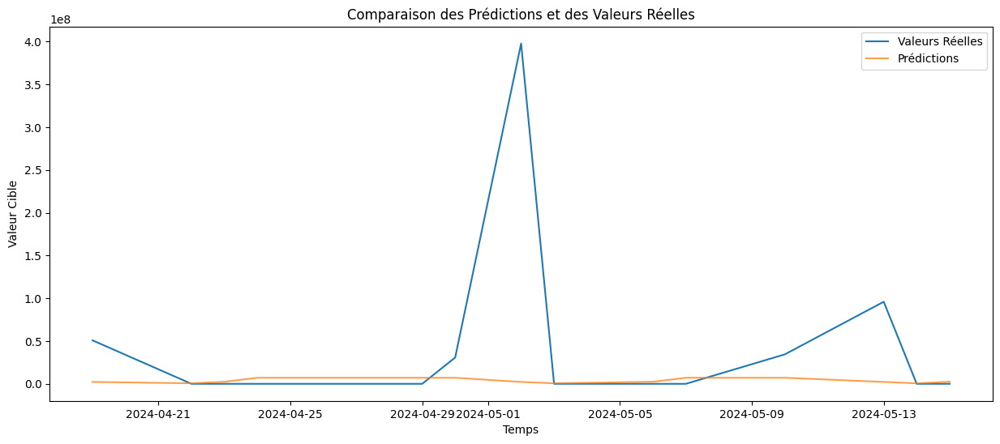

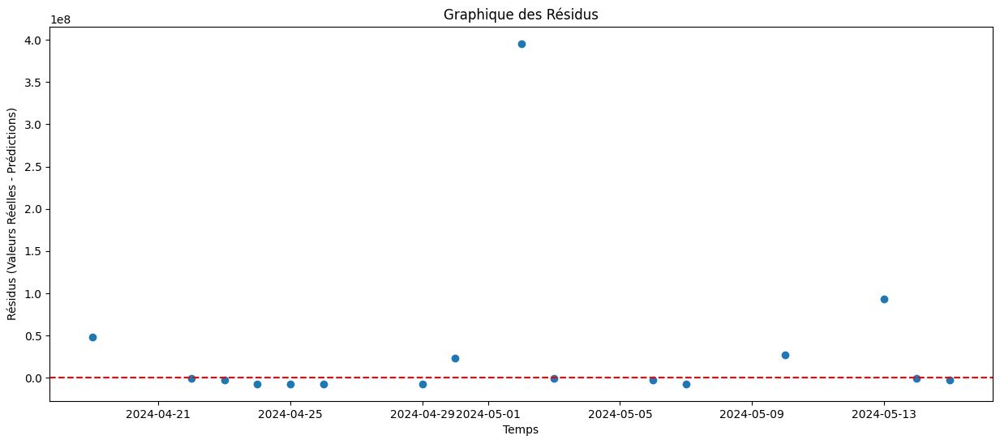

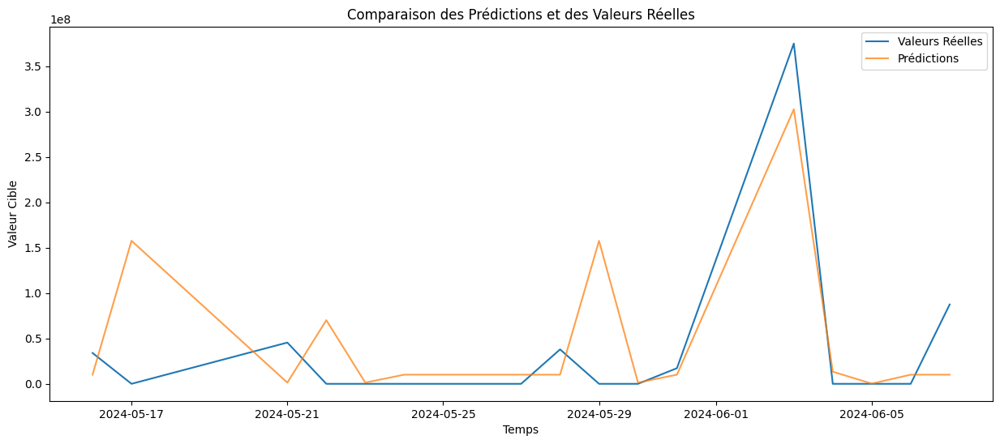

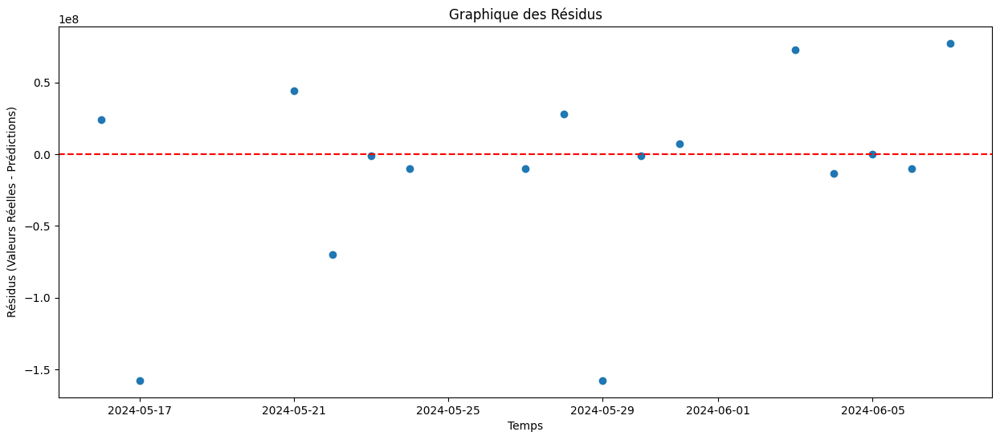

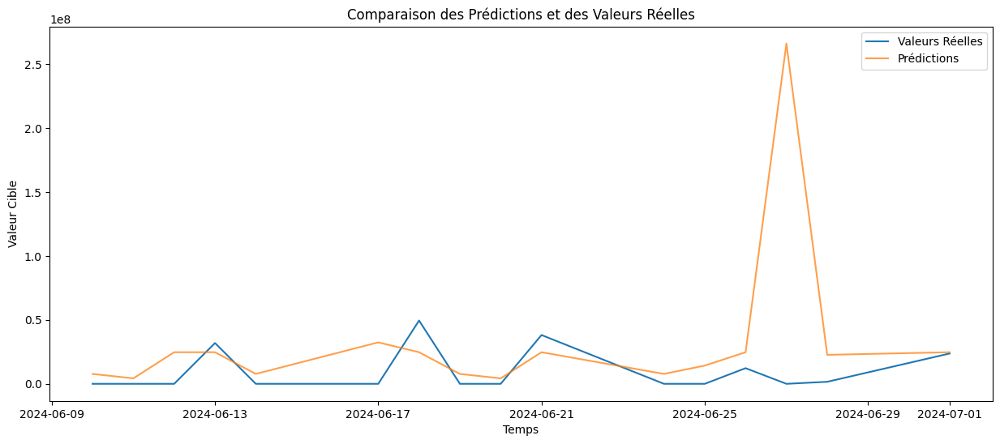

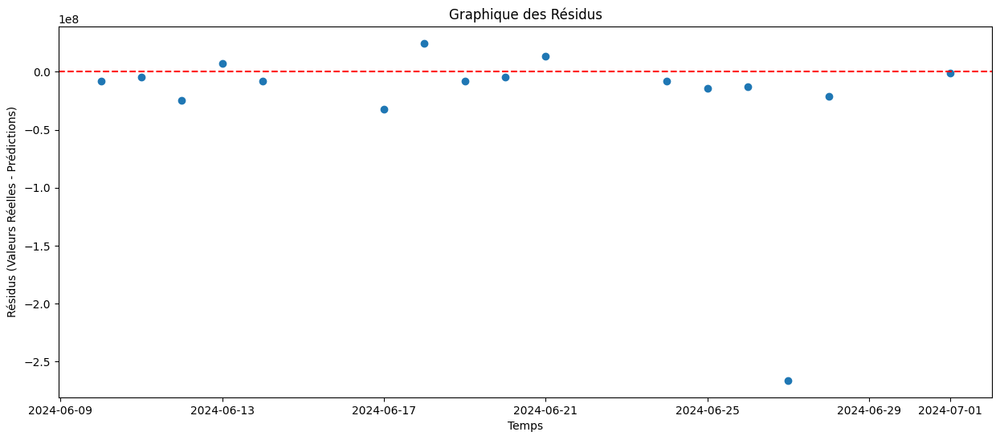

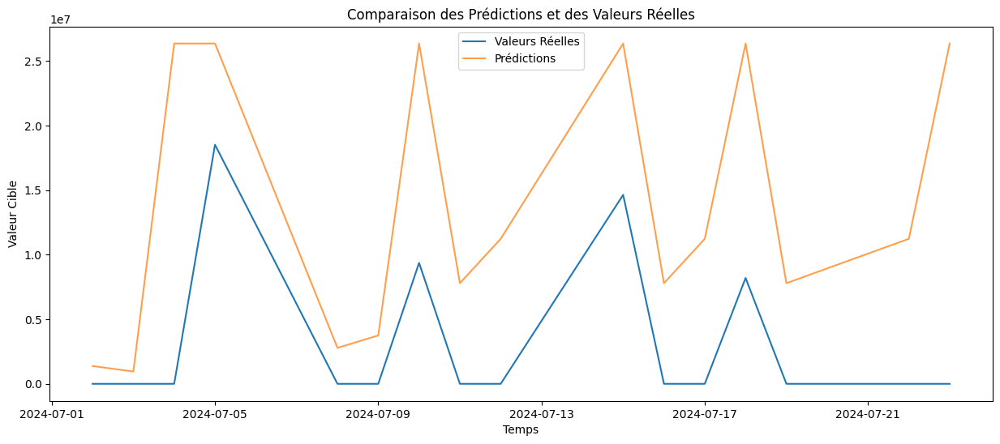

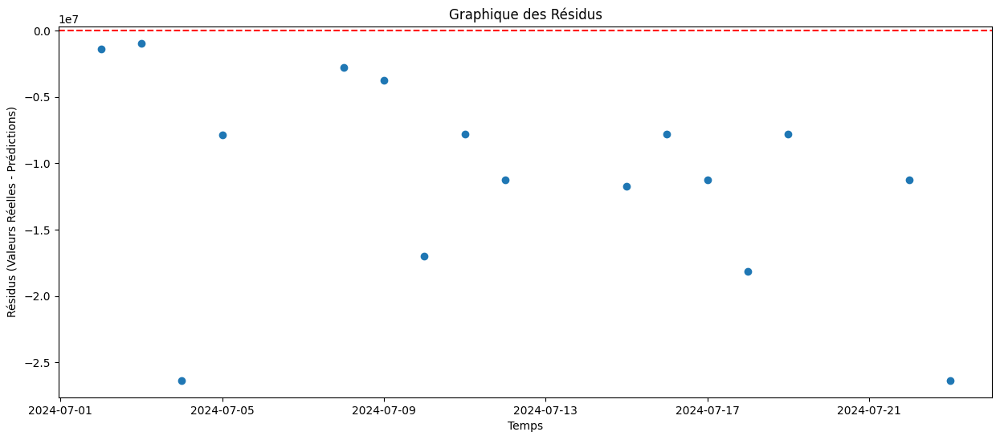

Rolling Window Analysis Average MSE for LNEFM_Collec: 4134484286735930.5
Processing series: LNENP_Collec
Temporal Cross-Validation Average MSE for LNENP_Collec: 5985530994920203.0
Enhanced Resampling MSE for LNENP_Collec: 1.6492394351046142e+16
Ensemble MSE with Varied Historical Contexts for LNENP_Collec: 4094024996164198.0
Average MSE with Cross-Validation on Shuffled Data for LNENP_Collec: 4687799997867198.0


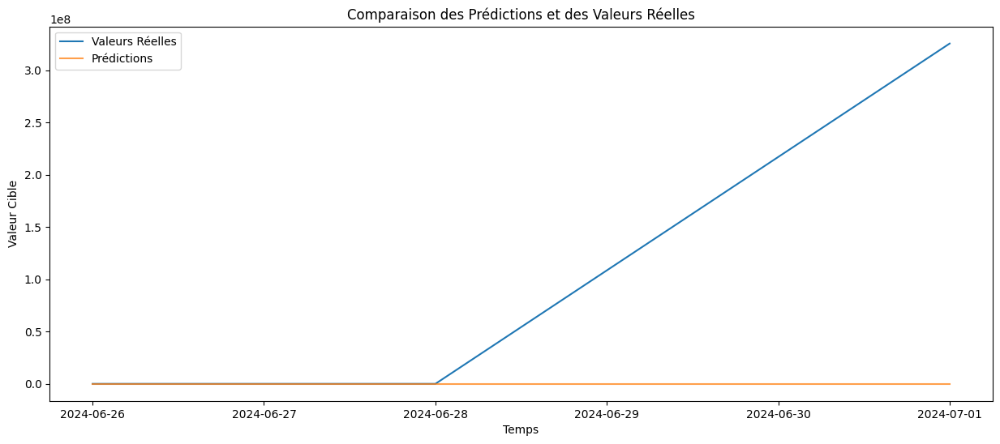

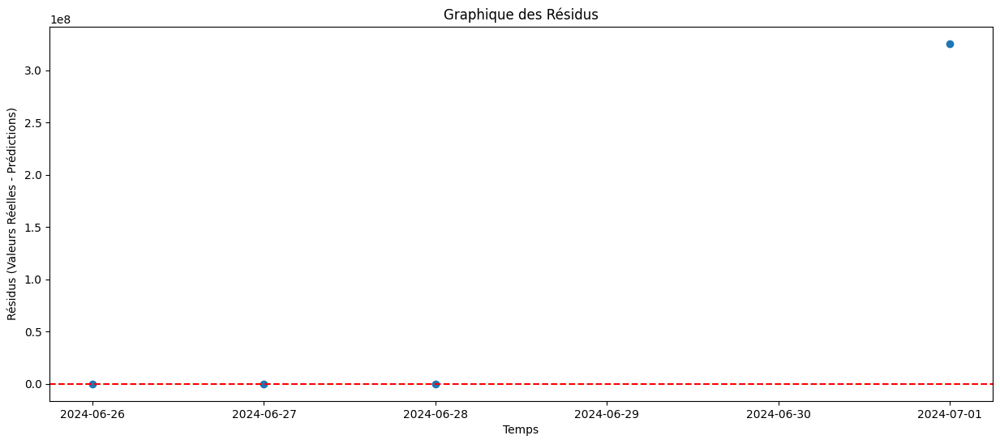

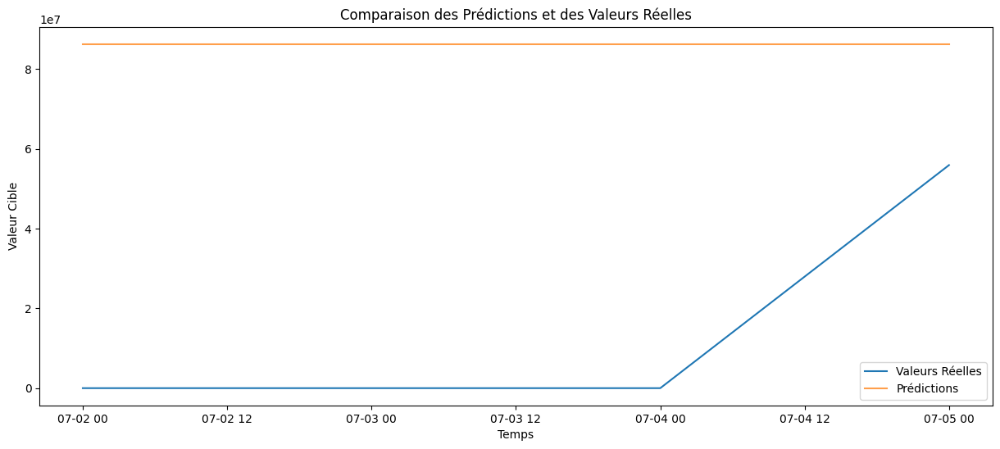

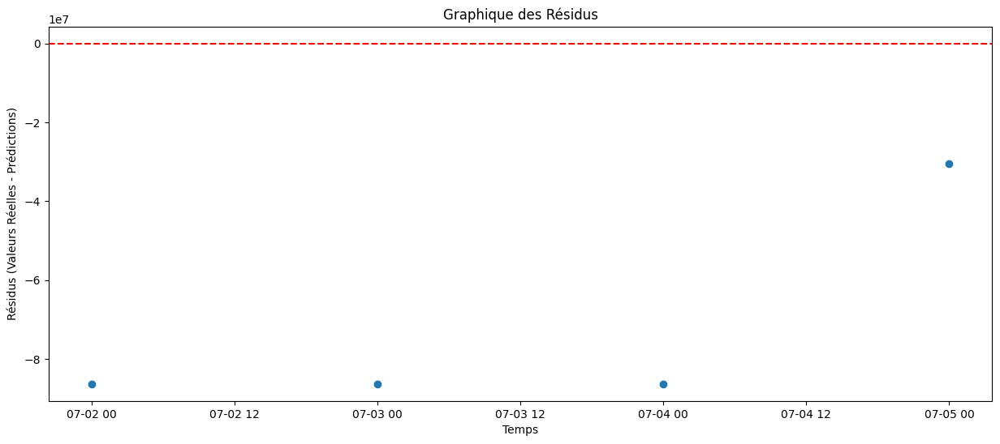

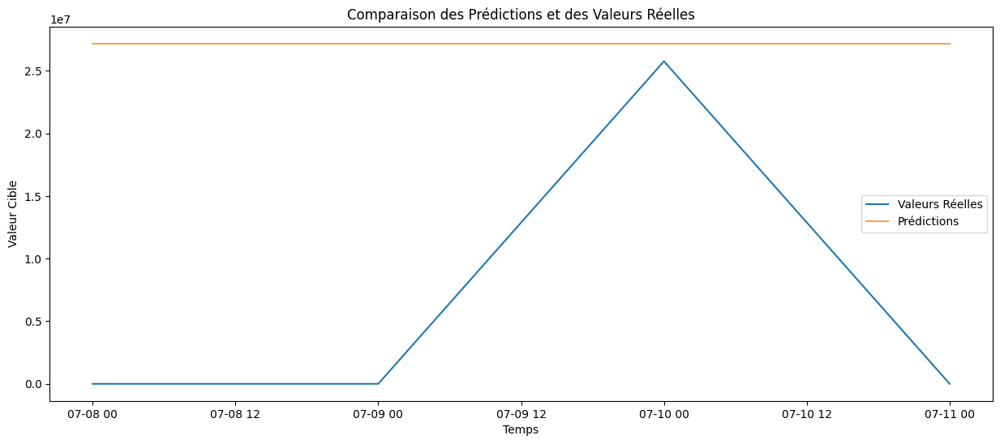

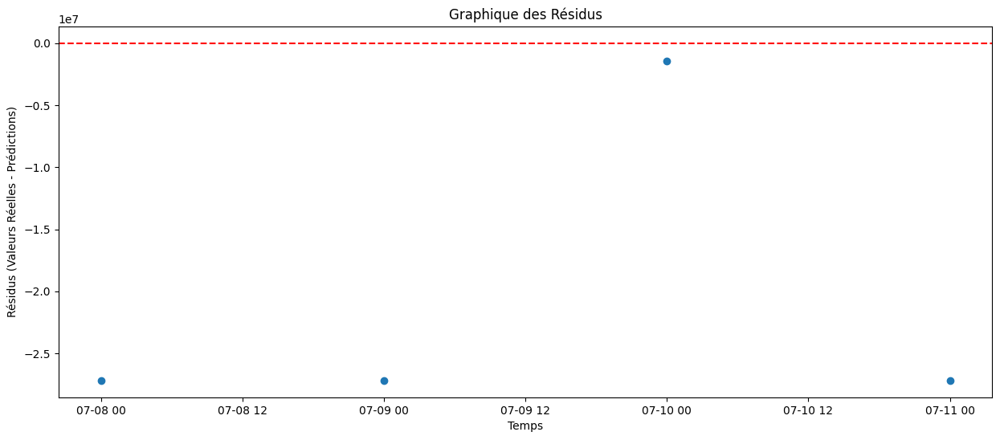

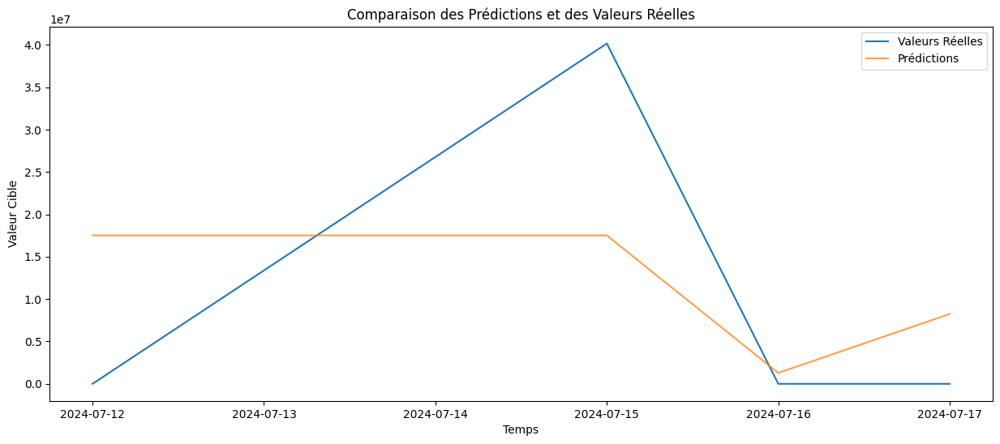

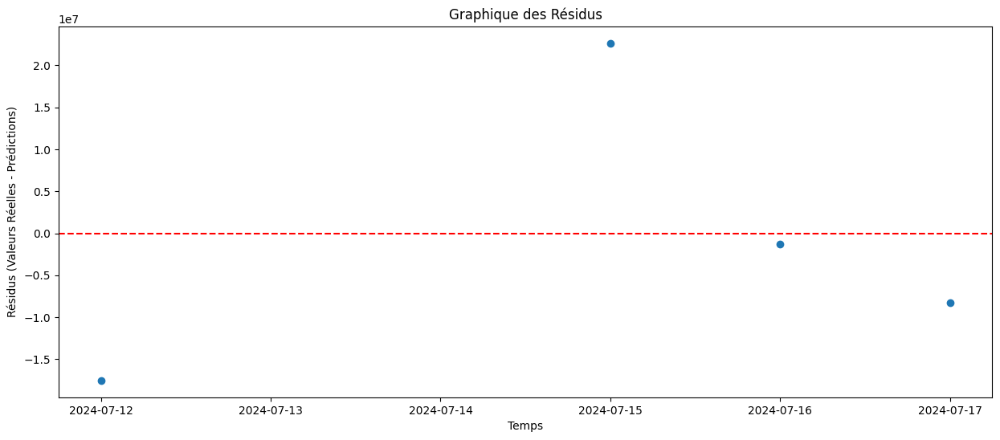

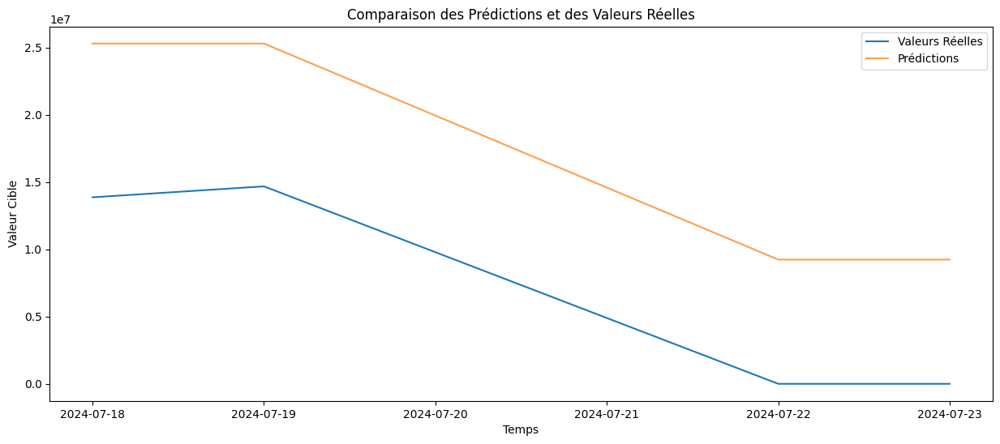

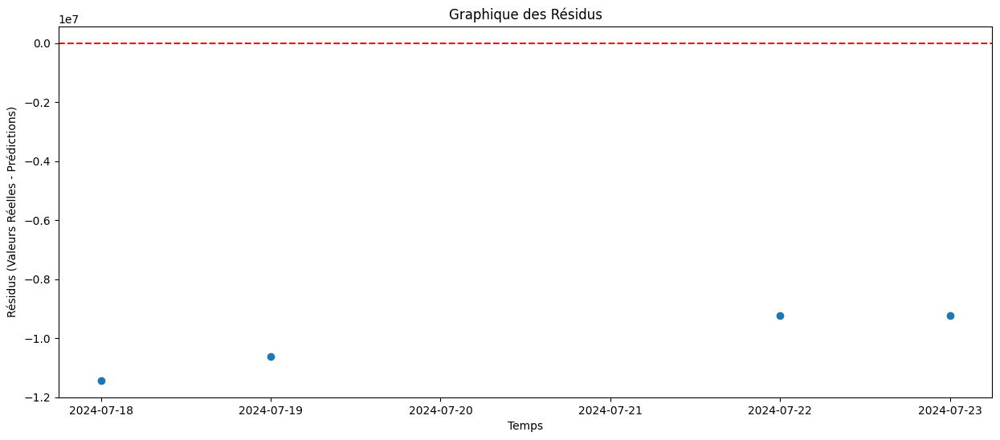

Rolling Window Analysis Average MSE for LNENP_Collec: 6642776464080887.0
Processing series: LNENG_Collec
Temporal Cross-Validation Average MSE for LNENG_Collec: 473865533966440.9
Enhanced Resampling MSE for LNENG_Collec: 704835043462798.2
Ensemble MSE with Varied Historical Contexts for LNENG_Collec: 327196465130508.75
Average MSE with Cross-Validation on Shuffled Data for LNENG_Collec: 367375894440062.1


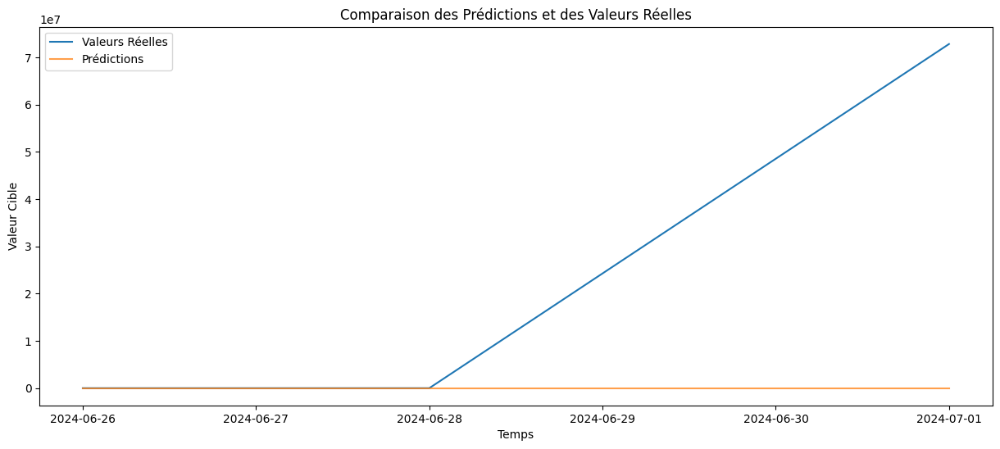

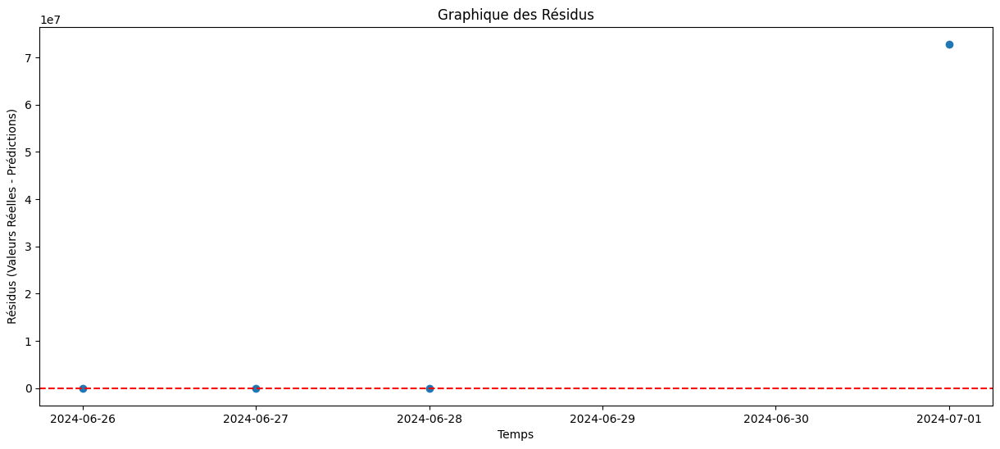

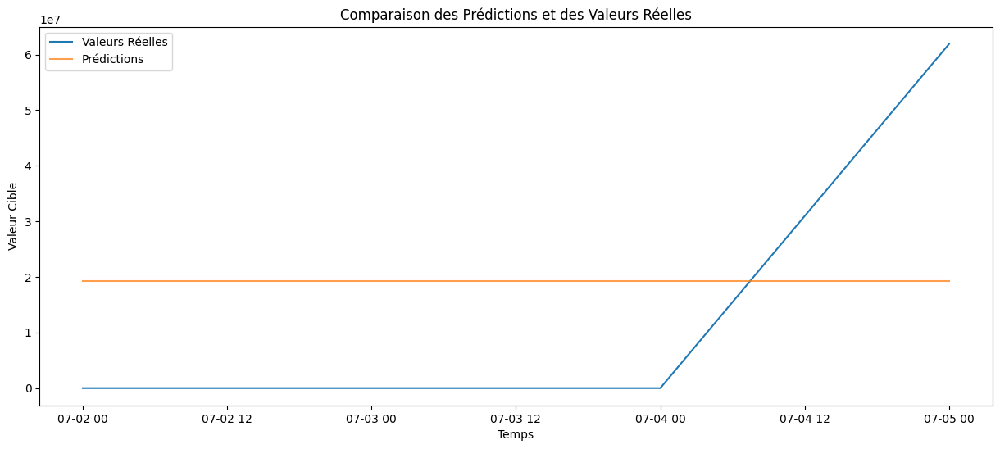

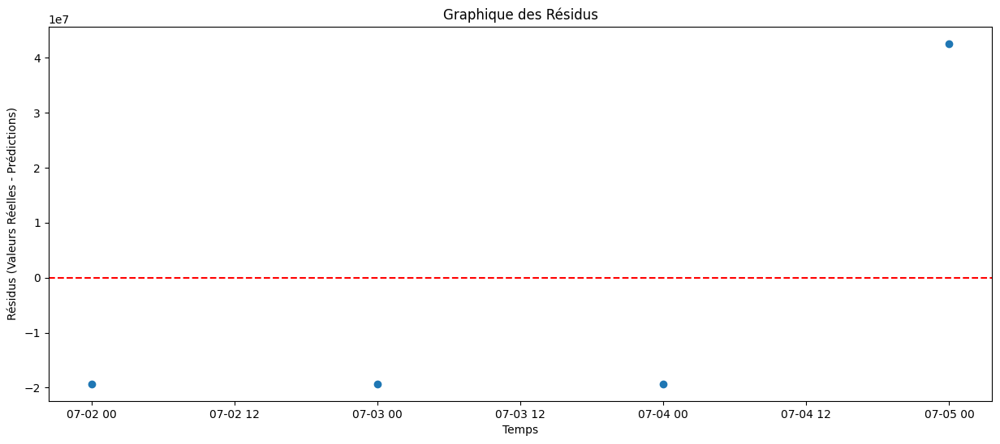

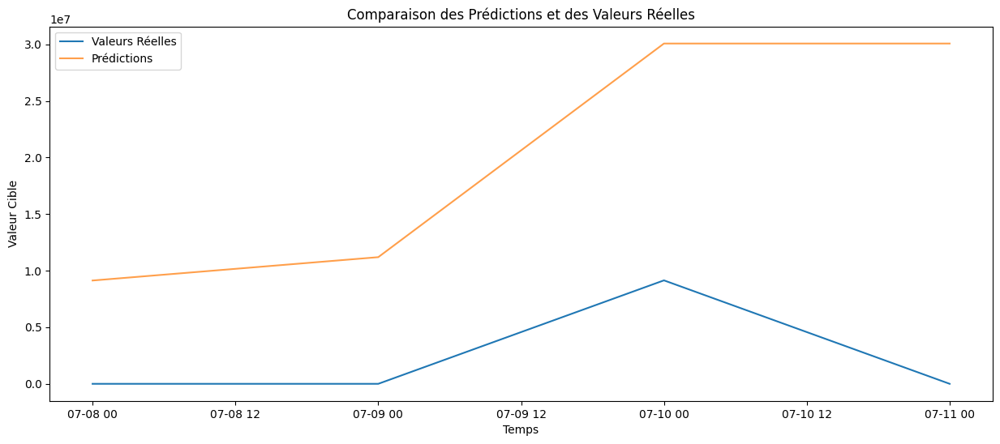

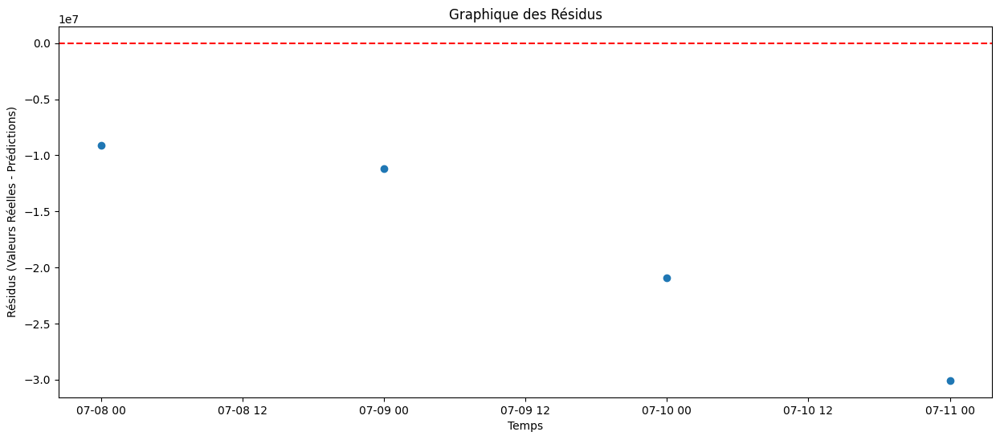

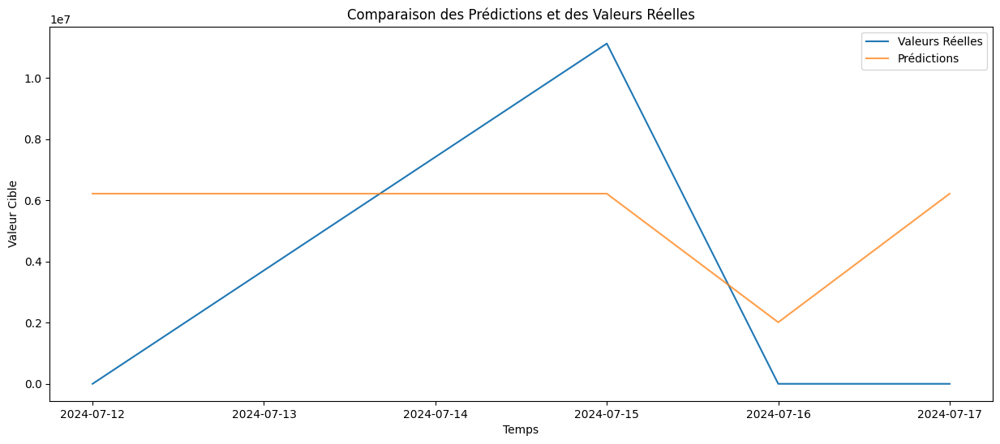

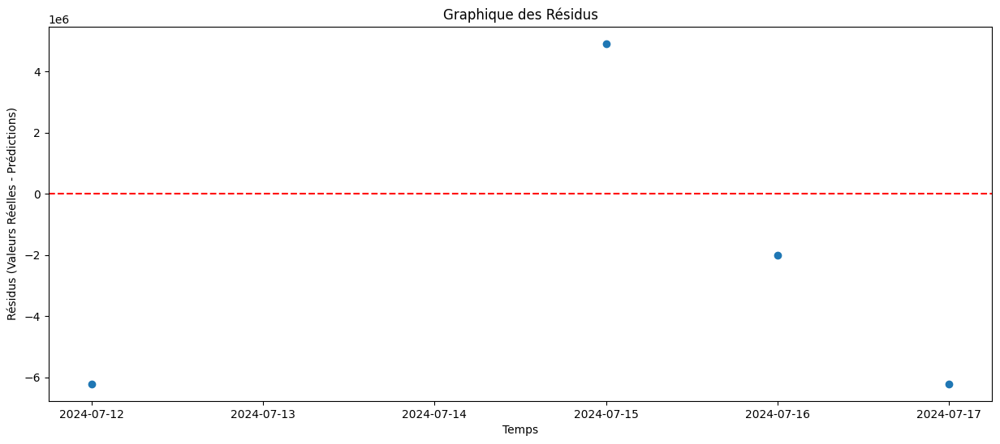

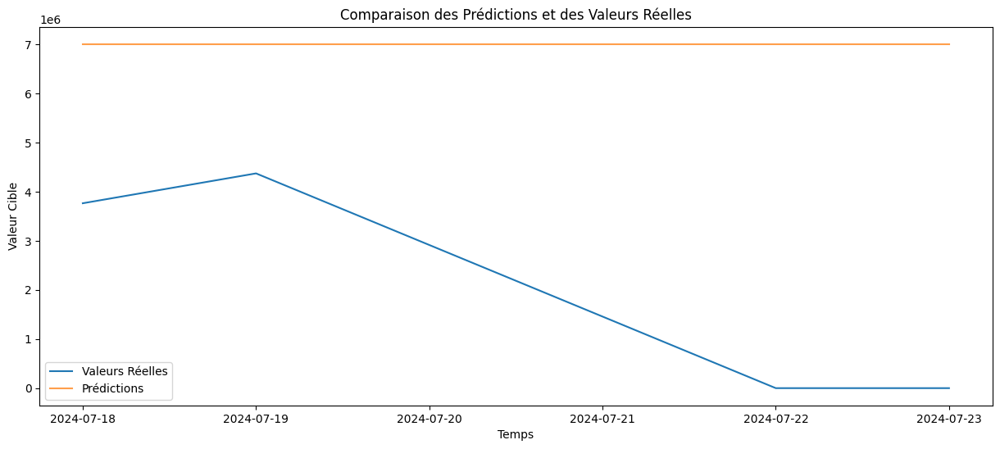

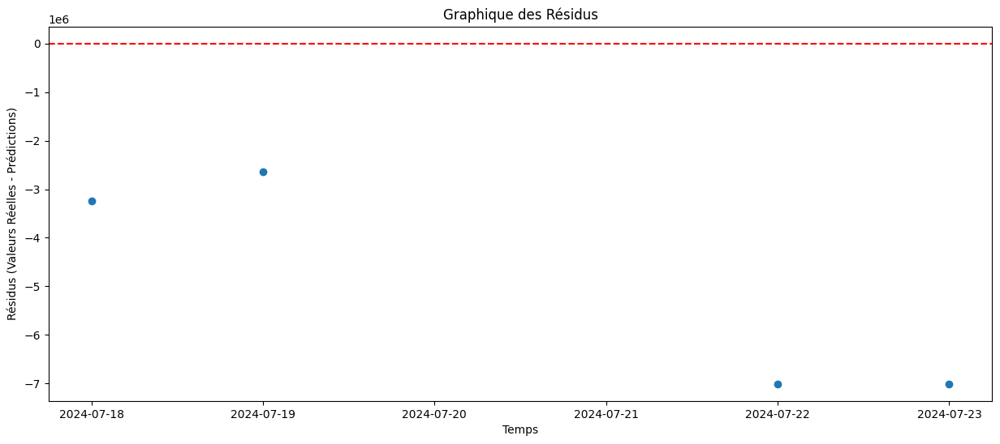

Rolling Window Analysis Average MSE for LNENG_Collec: 500474941145395.7
Processing series: LNSEN_Collec
Temporal Cross-Validation Average MSE for LNSEN_Collec: 0.0
Enhanced Resampling MSE for LNSEN_Collec: 0.0
Ensemble MSE with Varied Historical Contexts for LNSEN_Collec: 0.0
Average MSE with Cross-Validation on Shuffled Data for LNSEN_Collec: 0.0


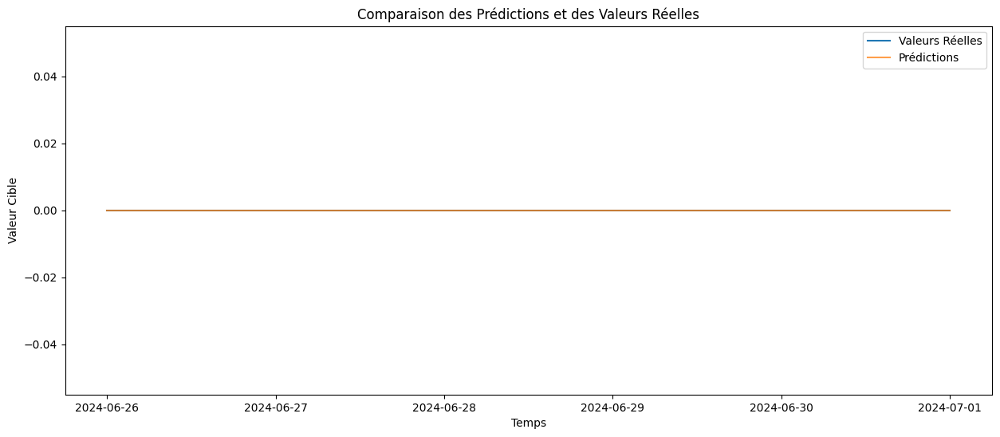

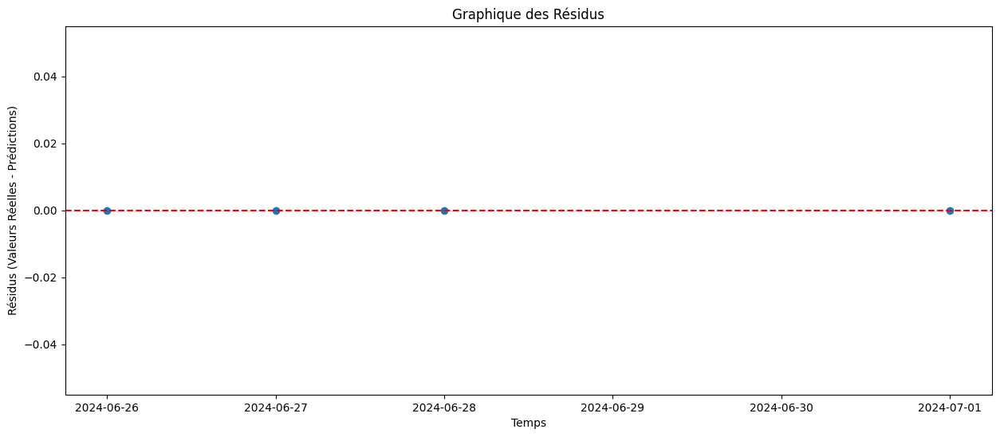

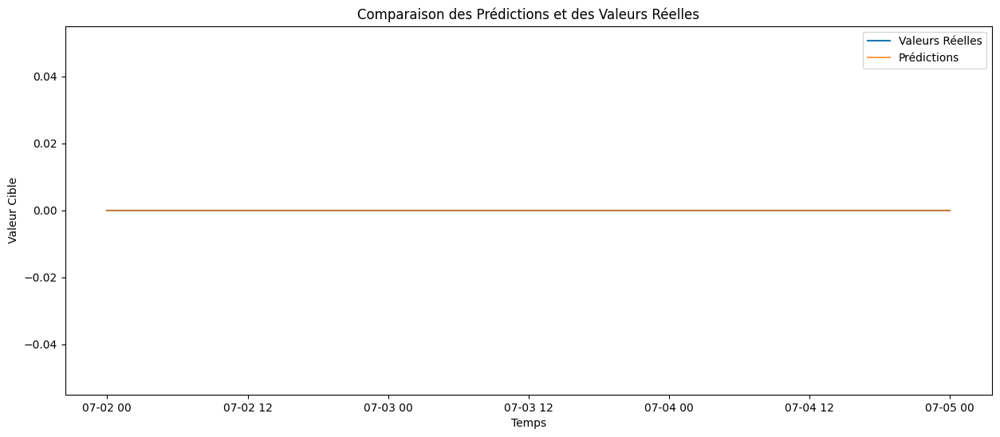

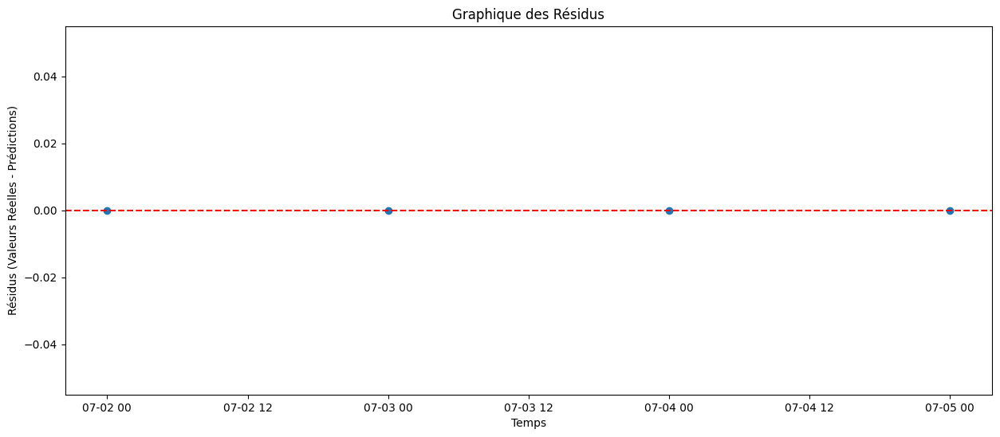

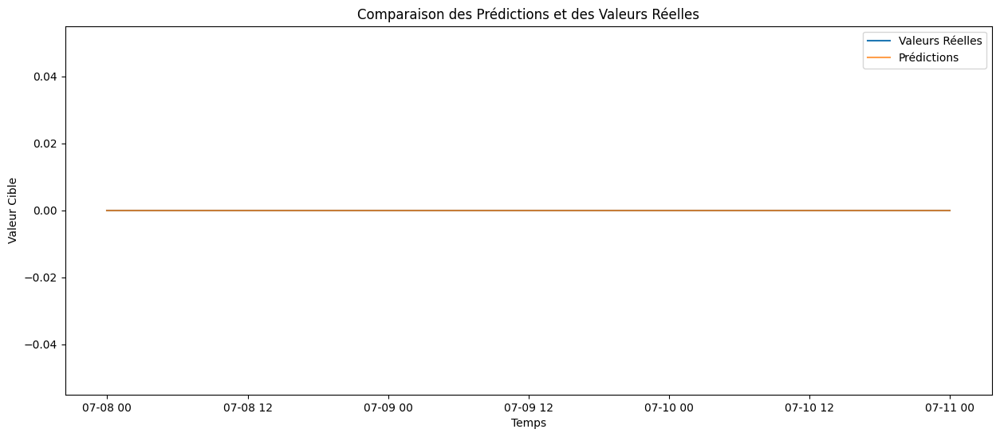

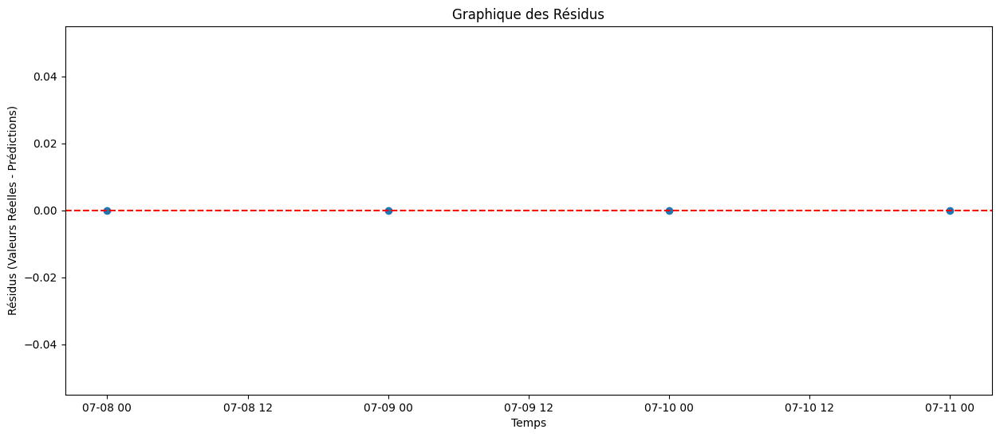

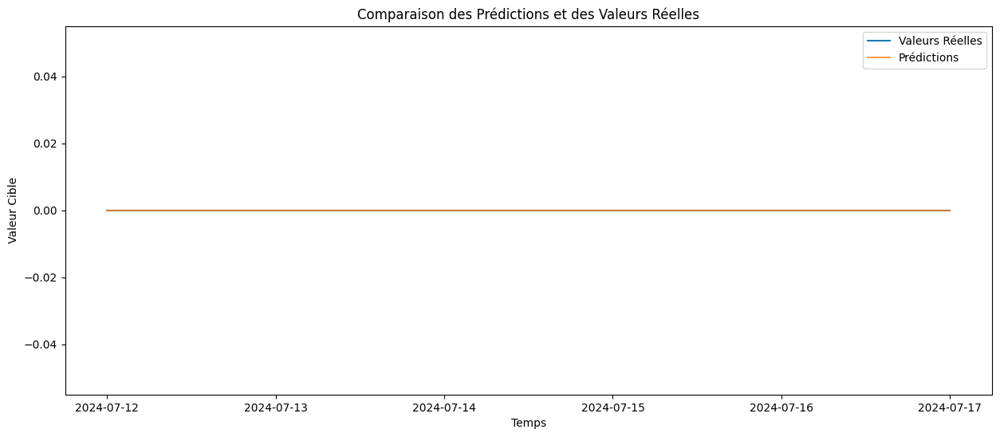

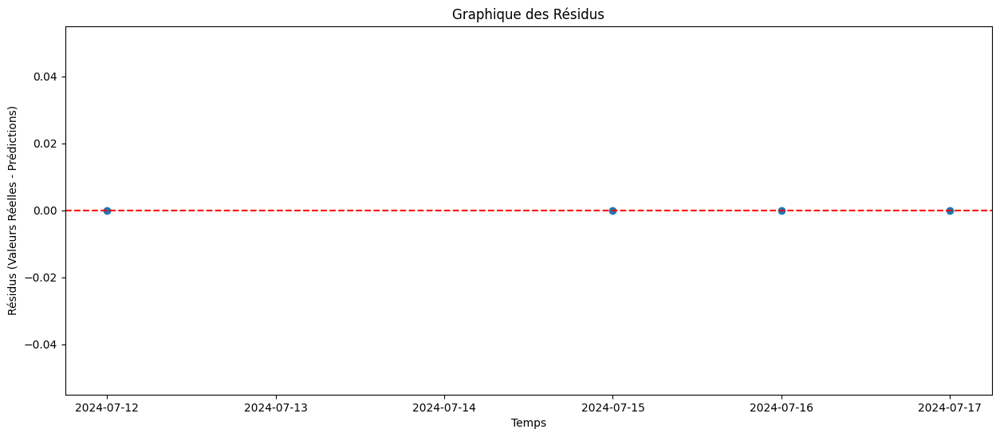

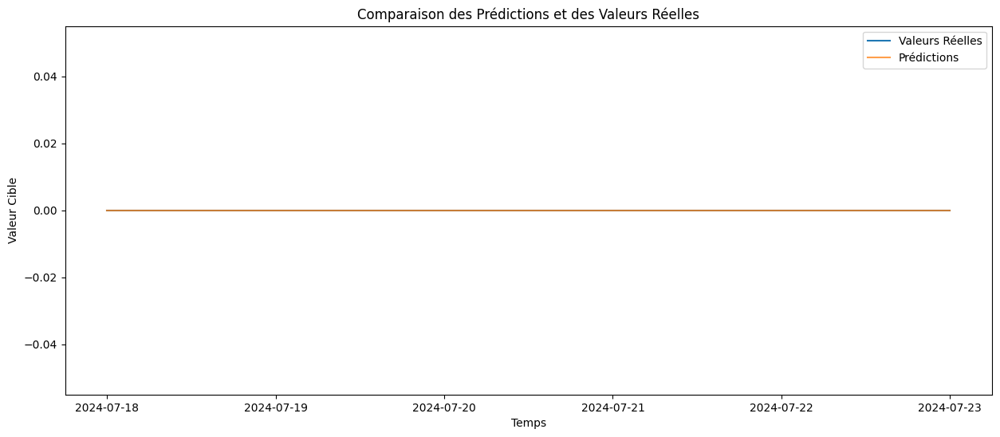

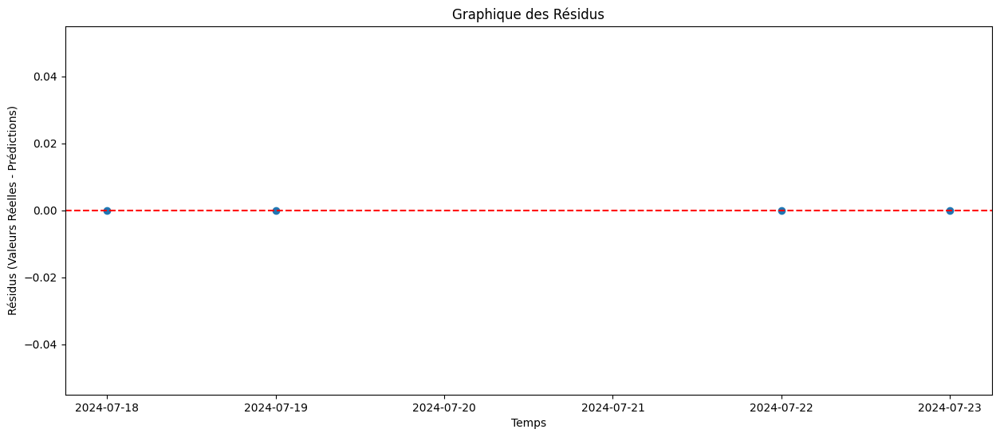

Rolling Window Analysis Average MSE for LNSEN_Collec: 0.0
Processing series: LNENI_Collec
Temporal Cross-Validation Average MSE for LNENI_Collec: 240944762229180.5
Enhanced Resampling MSE for LNENI_Collec: 329898995741122.5
Ensemble MSE with Varied Historical Contexts for LNENI_Collec: 232012314178188.6
Average MSE with Cross-Validation on Shuffled Data for LNENI_Collec: 232528961977346.3


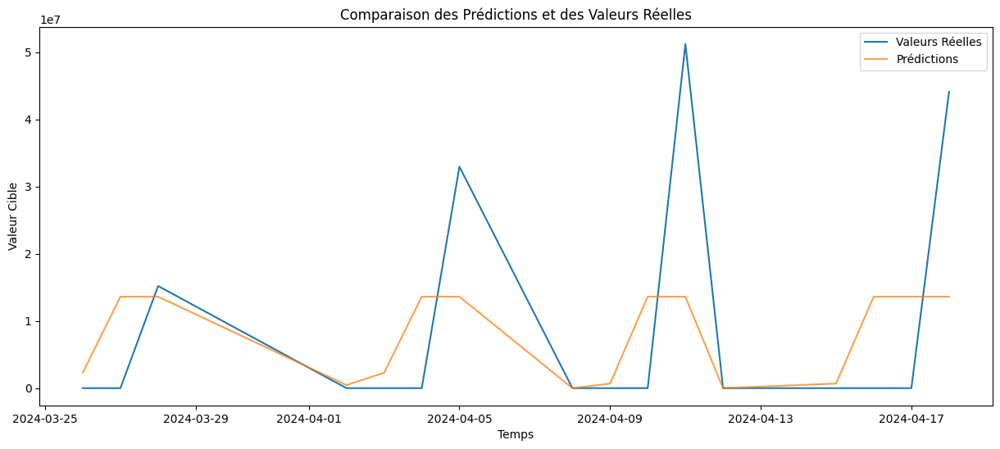

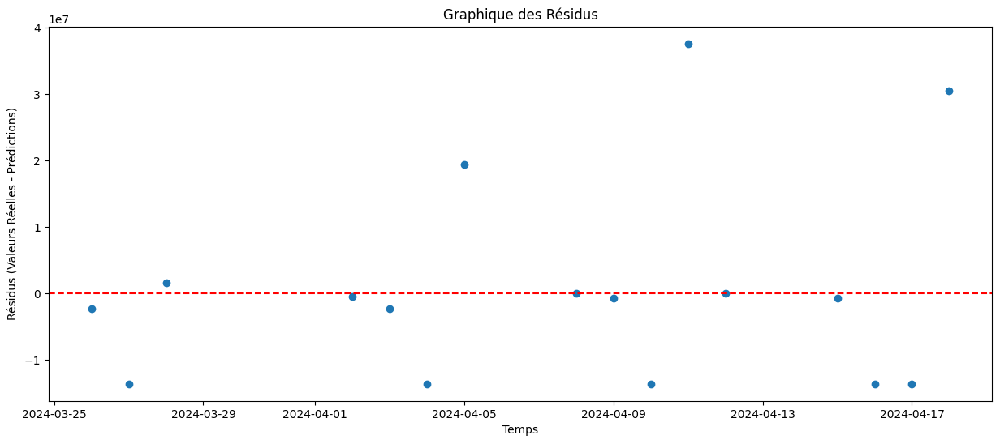

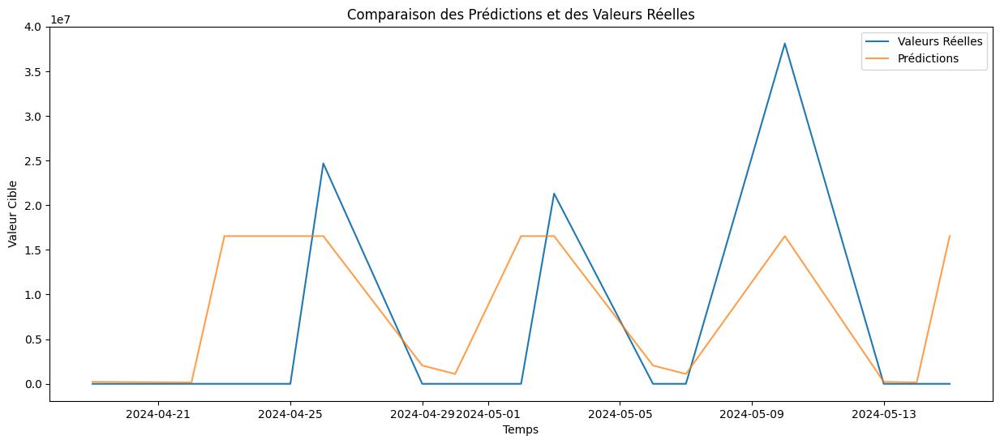

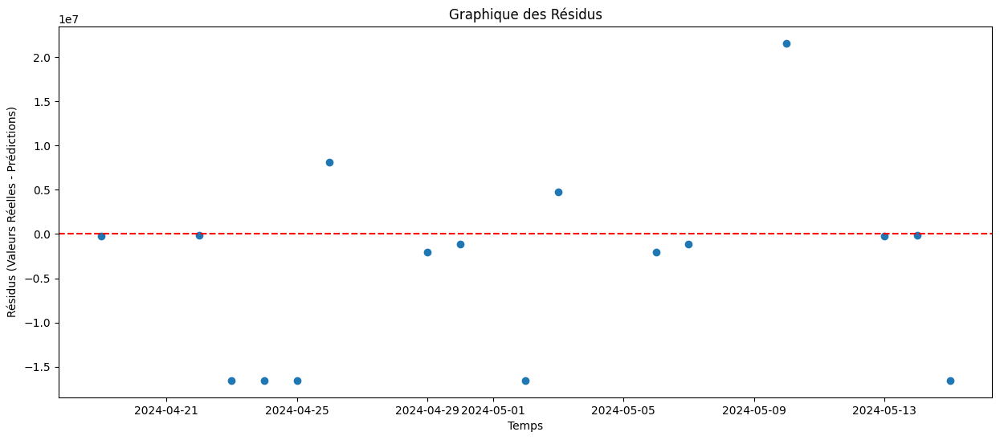

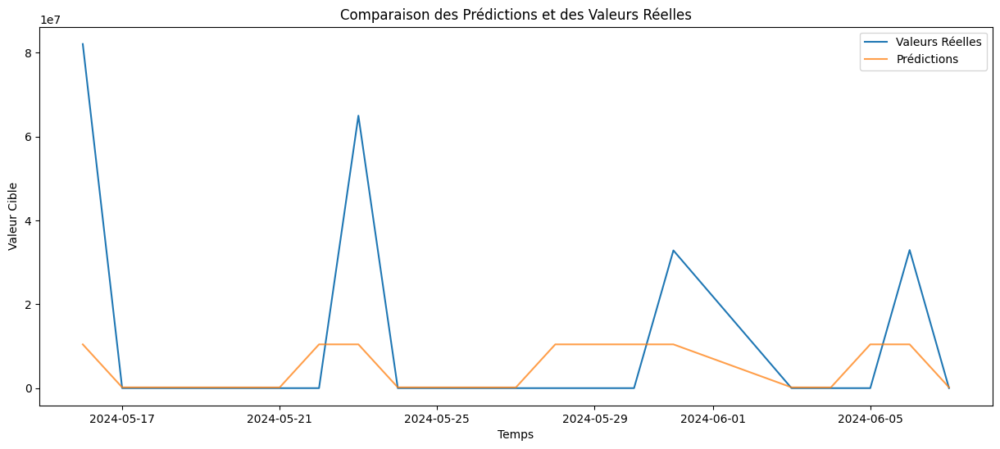

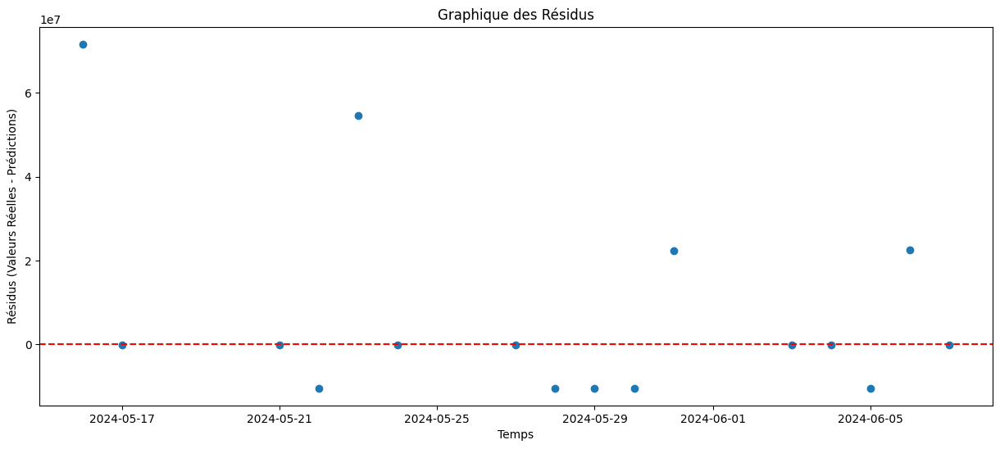

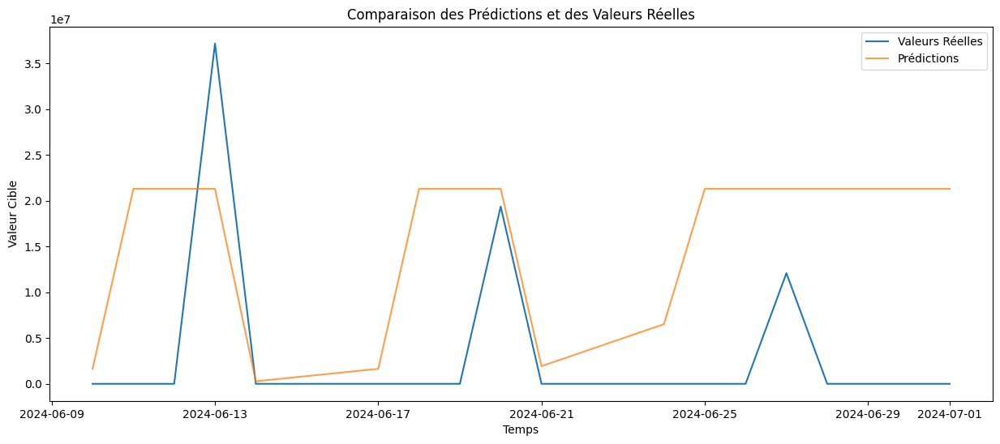

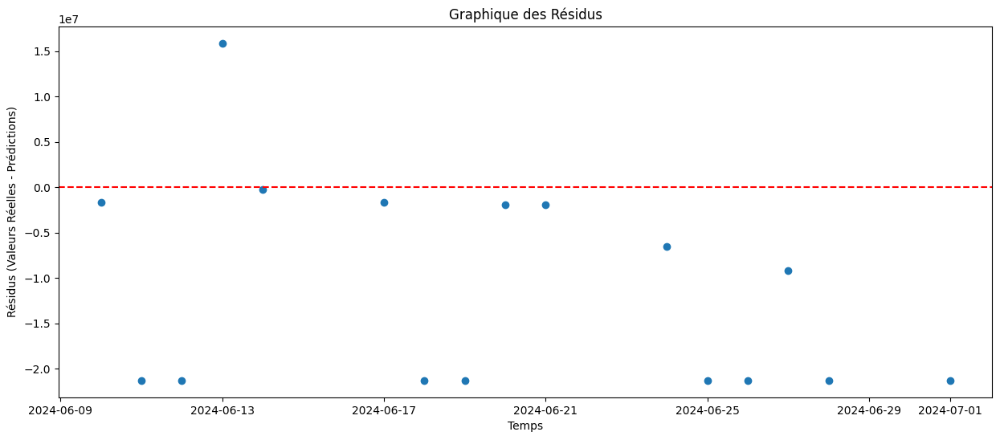

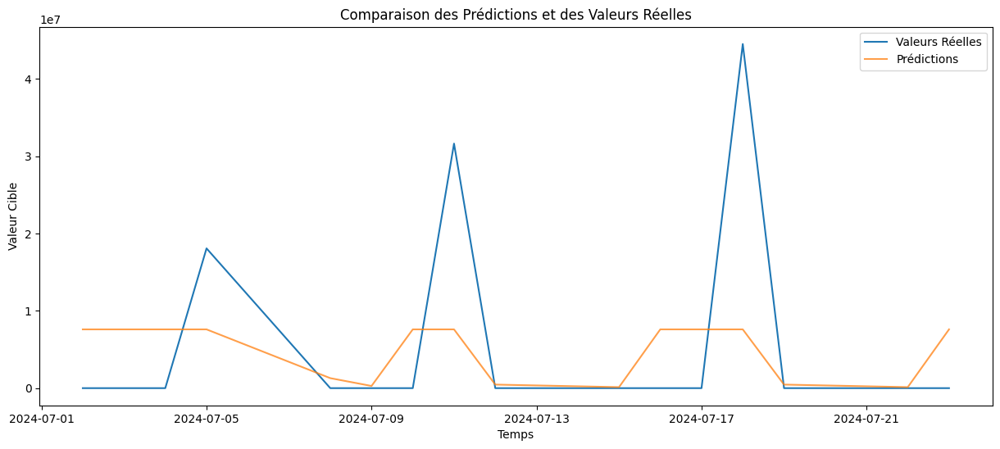

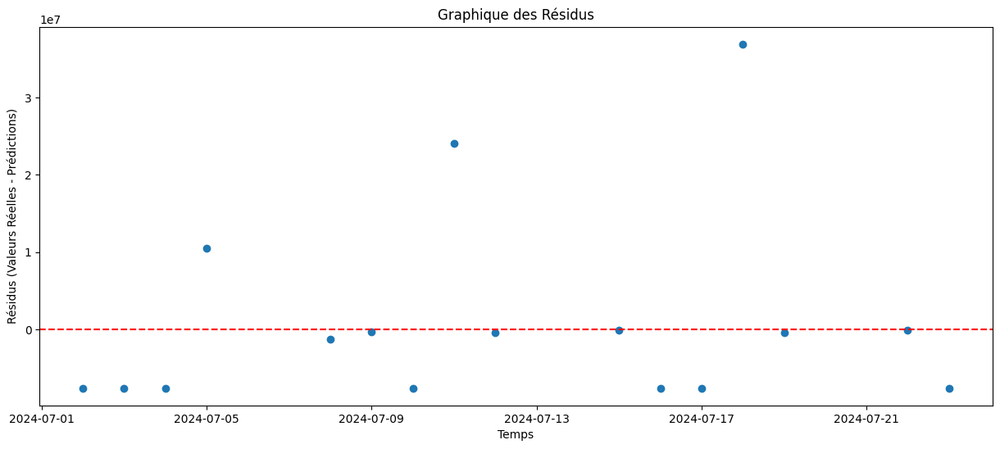

Rolling Window Analysis Average MSE for LNENI_Collec: 271555585233328.1
Processing series: LNENC_Collec
Temporal Cross-Validation Average MSE for LNENC_Collec: 4255.388307434609
Enhanced Resampling MSE for LNENC_Collec: 645.8536100853146
Ensemble MSE with Varied Historical Contexts for LNENC_Collec: 30609.993566594803
Average MSE with Cross-Validation on Shuffled Data for LNENC_Collec: 31330.759129897655


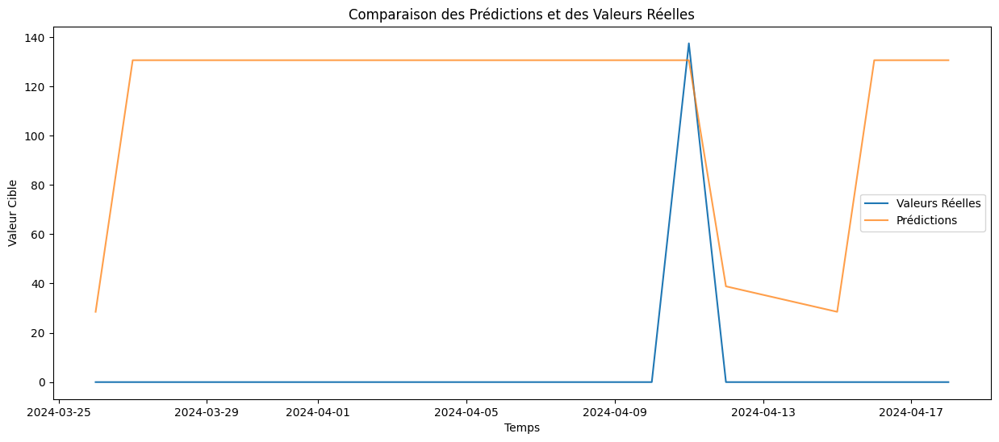

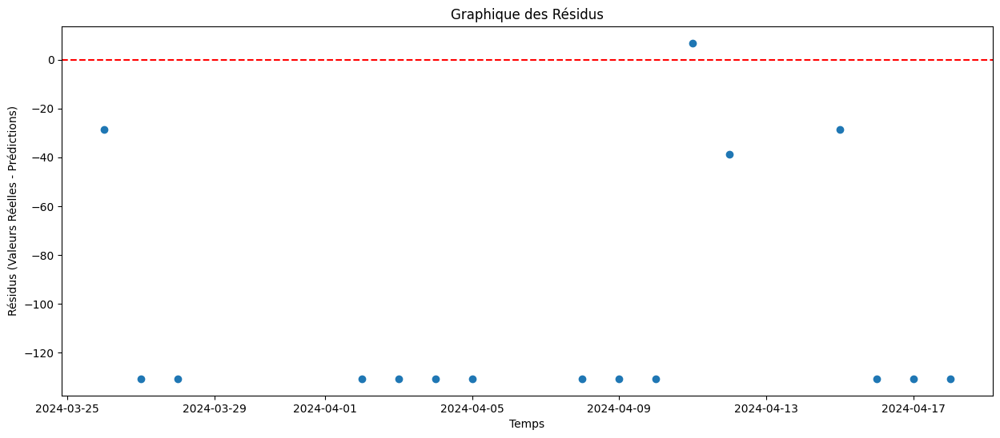

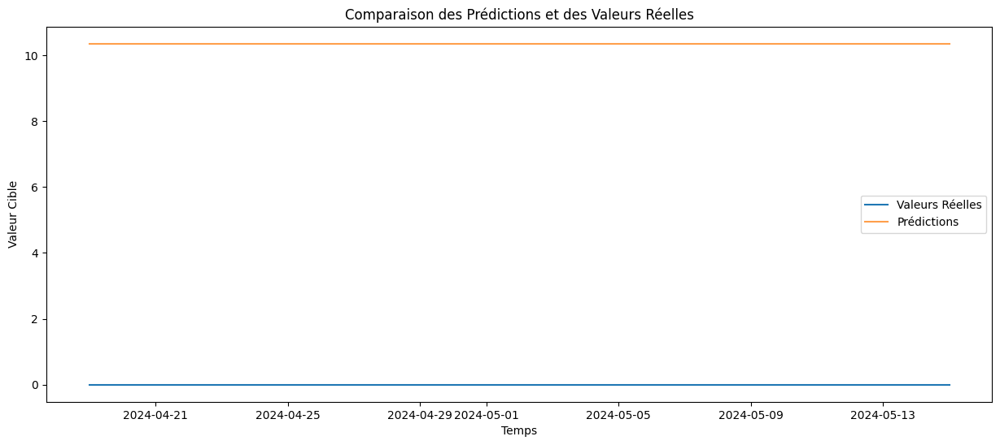

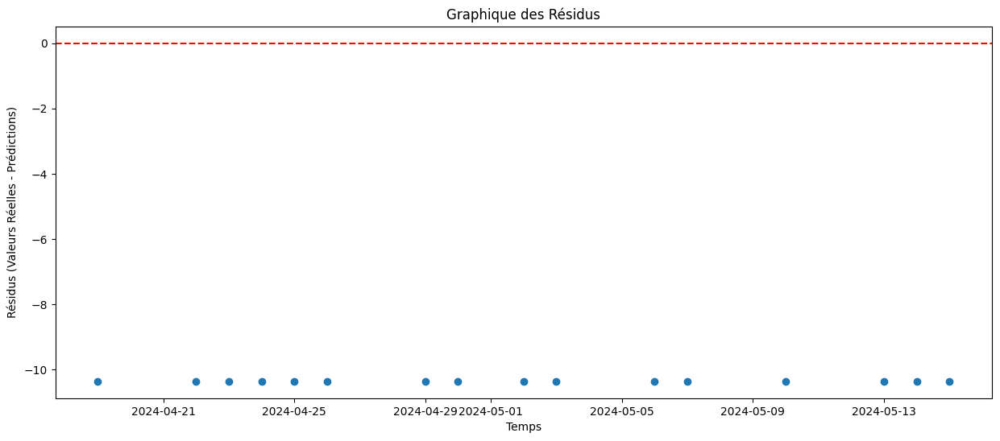

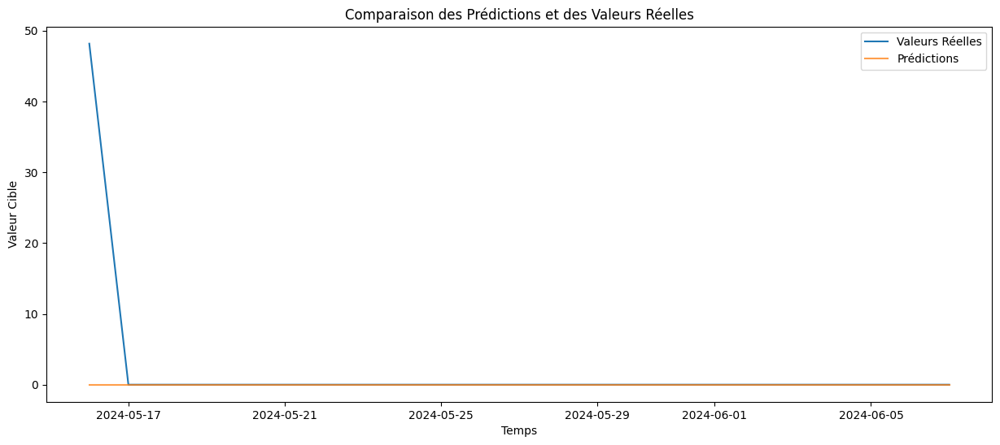

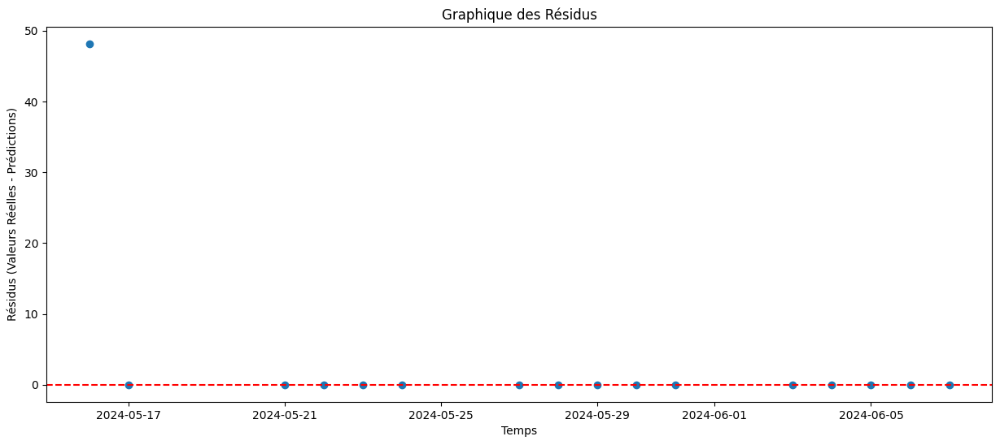

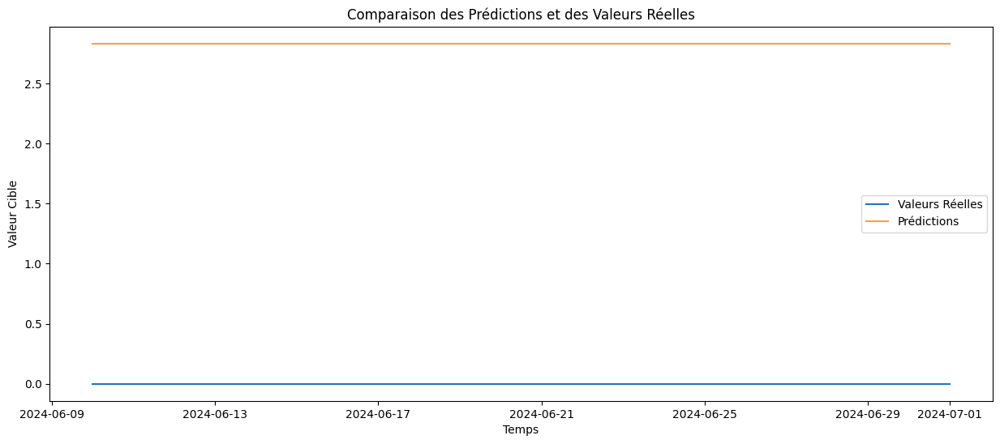

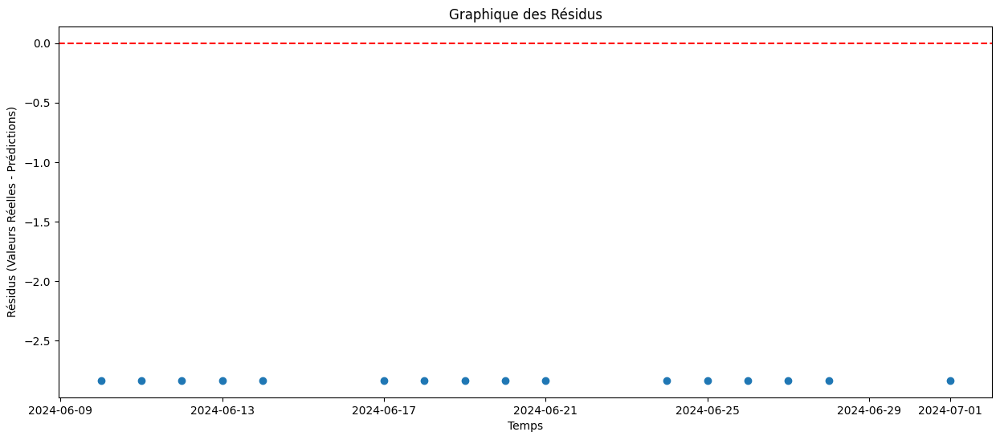

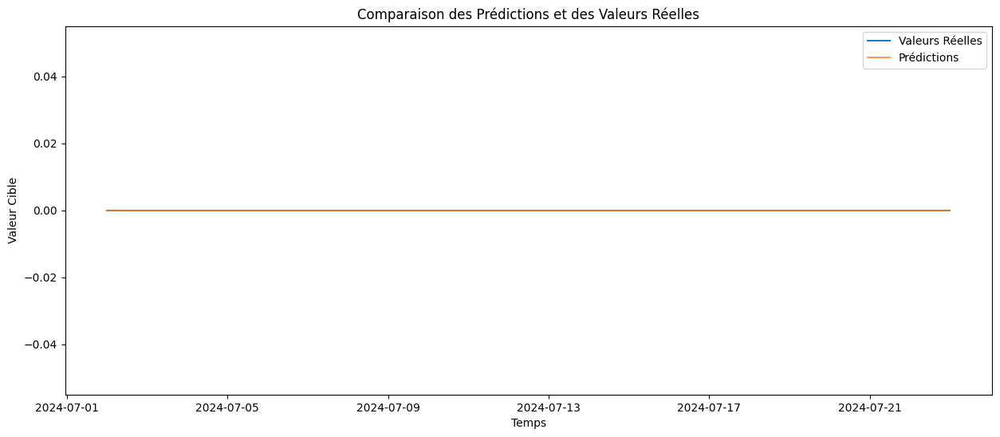

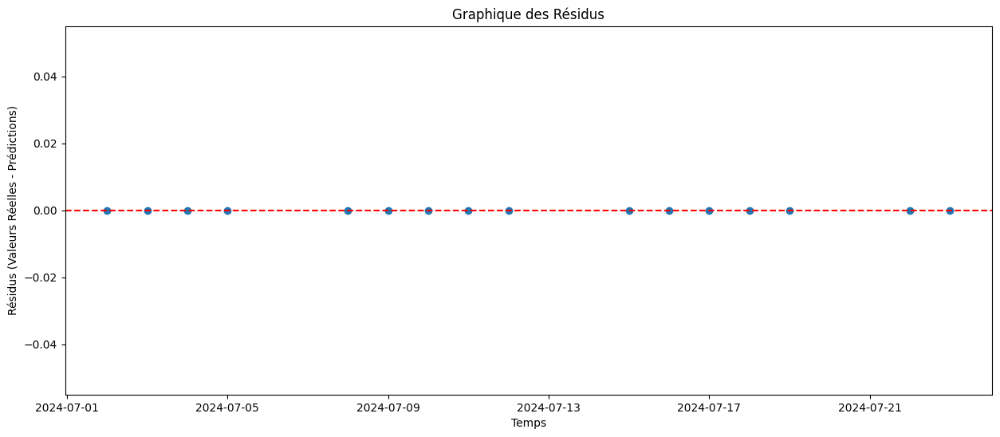

Rolling Window Analysis Average MSE for LNENC_Collec: 2650.061325399103
Processing series: LNEN3_Collec
Temporal Cross-Validation Average MSE for LNEN3_Collec: 1769.2643674236776
Enhanced Resampling MSE for LNEN3_Collec: 35.42426701009032
Ensemble MSE with Varied Historical Contexts for LNEN3_Collec: 1365.7769285496317
Average MSE with Cross-Validation on Shuffled Data for LNEN3_Collec: 1387.8481803311608


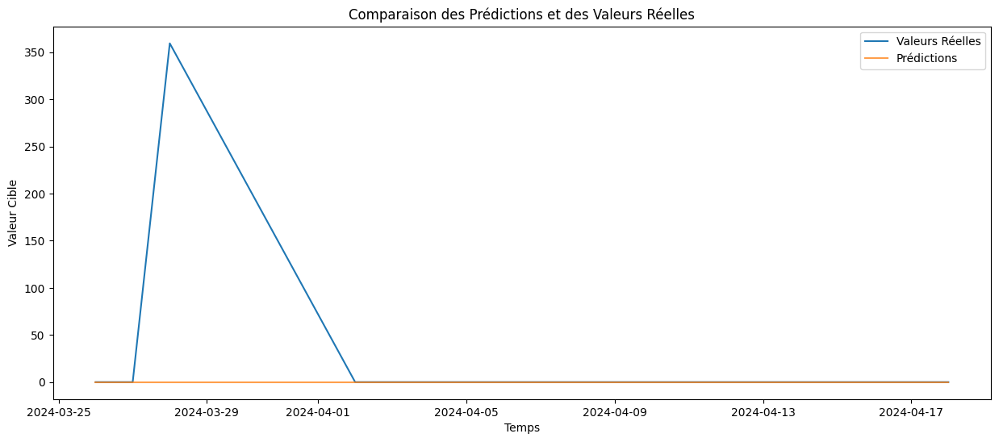

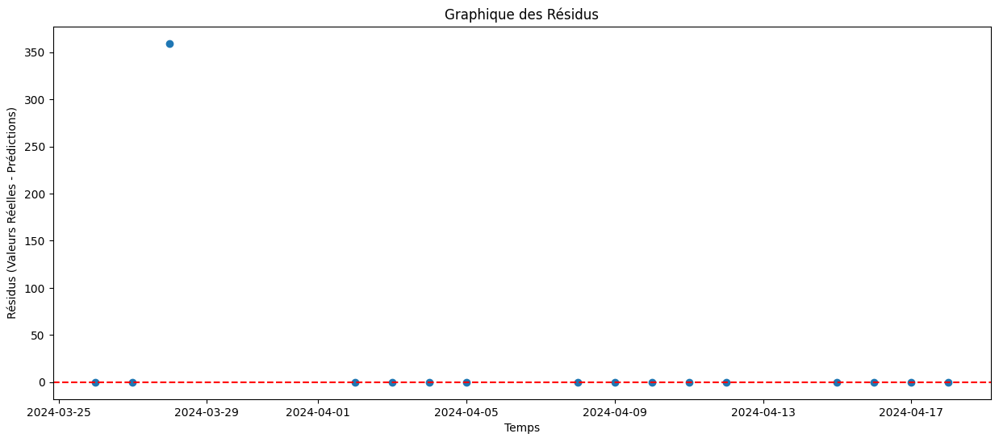

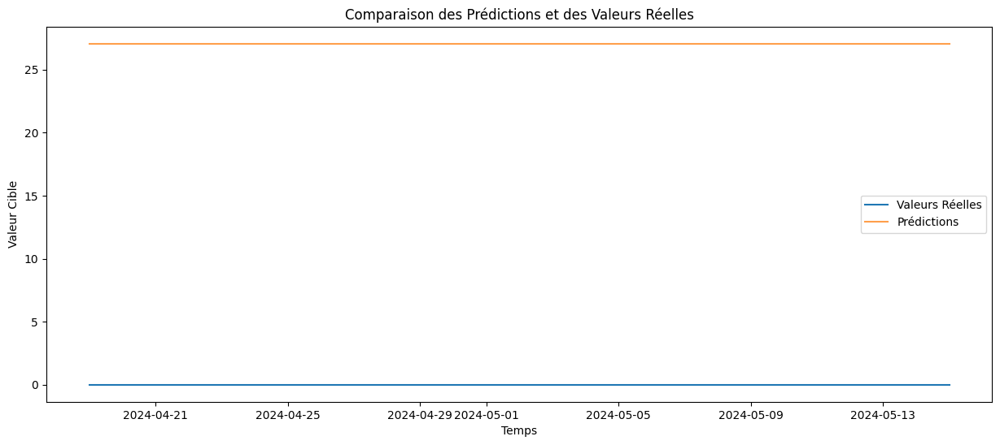

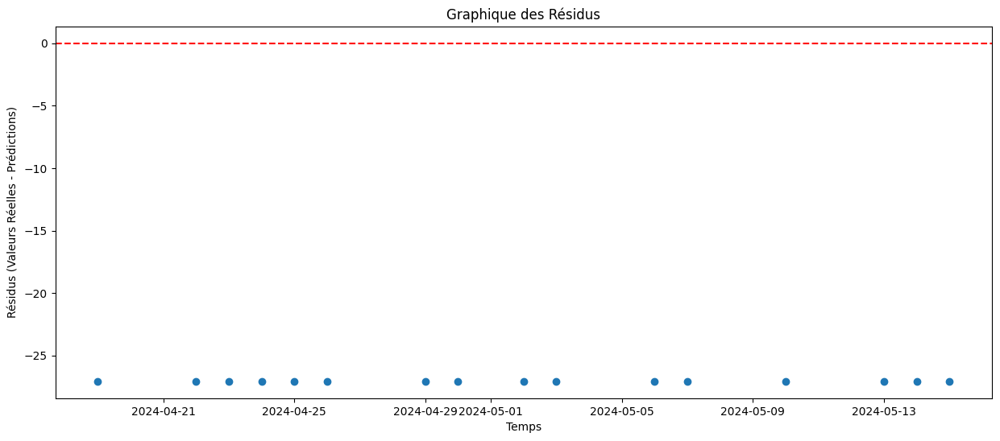

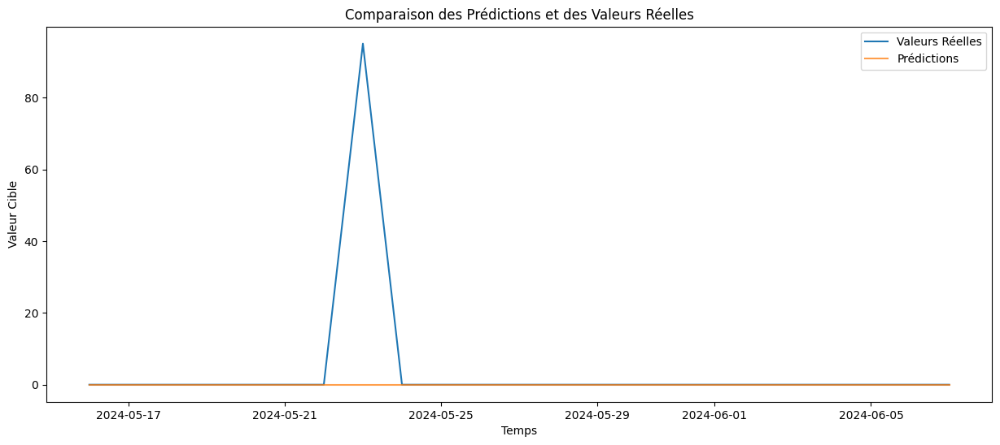

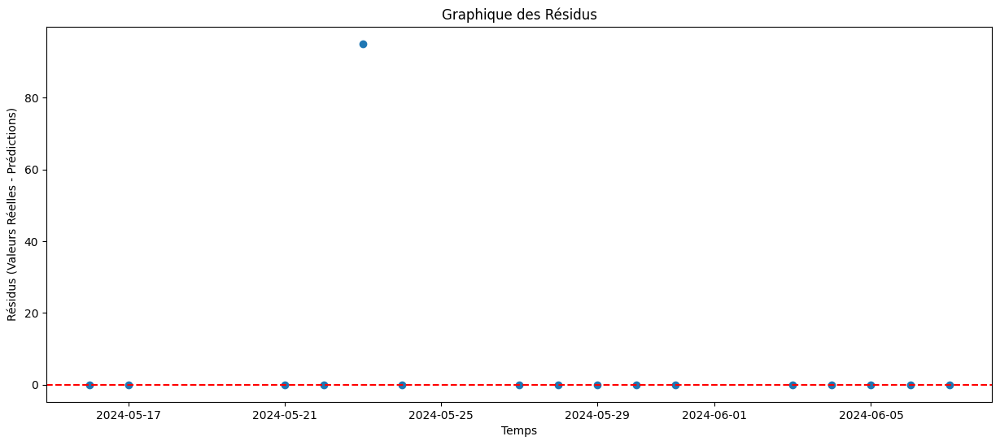

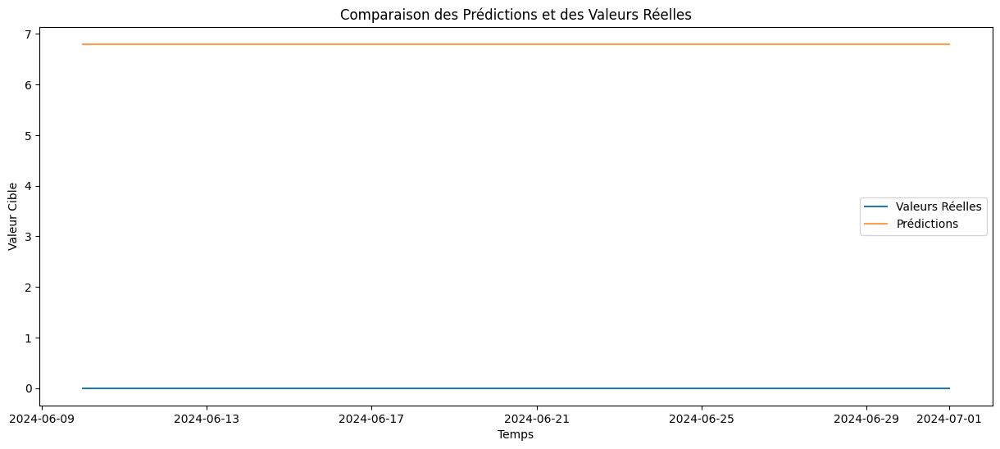

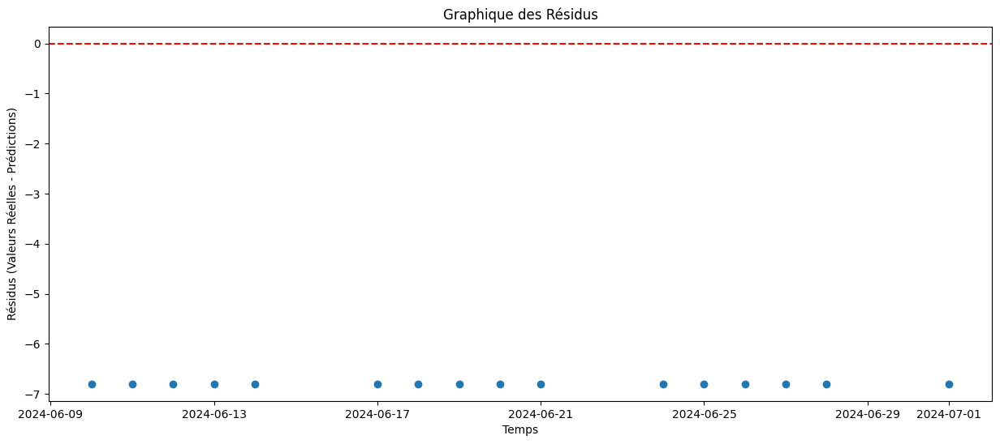

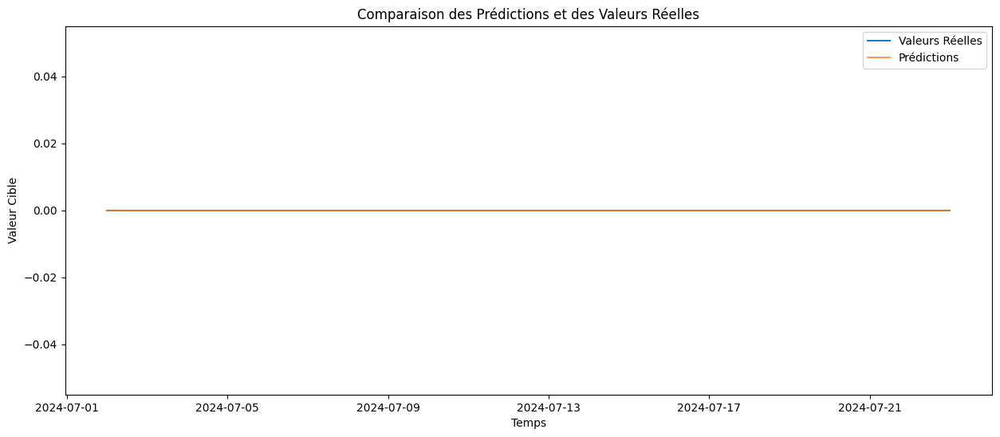

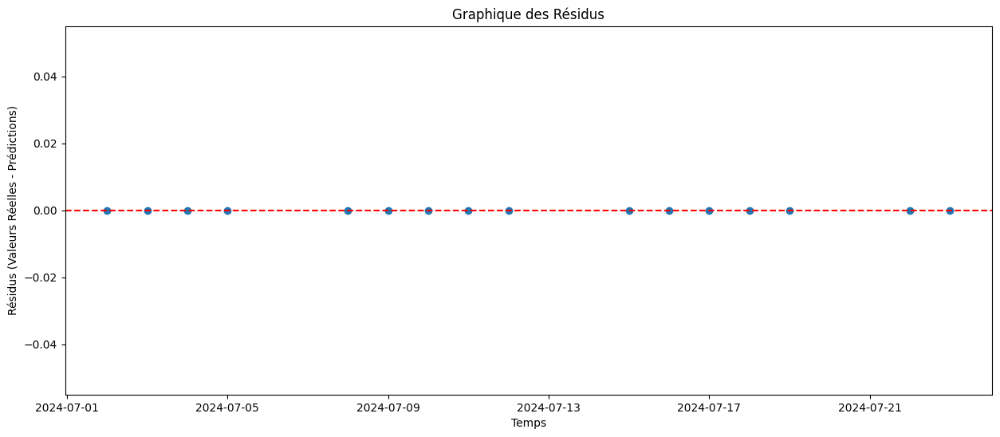

Rolling Window Analysis Average MSE for LNEN3_Collec: 1884.5727606473993
Processing series: LNGIV_Collec
Temporal Cross-Validation Average MSE for LNGIV_Collec: 1633142761356.5925
Enhanced Resampling MSE for LNGIV_Collec: 1142192944821.3293
Ensemble MSE with Varied Historical Contexts for LNGIV_Collec: 432827913857.80646
Average MSE with Cross-Validation on Shuffled Data for LNGIV_Collec: 1772404118613.116


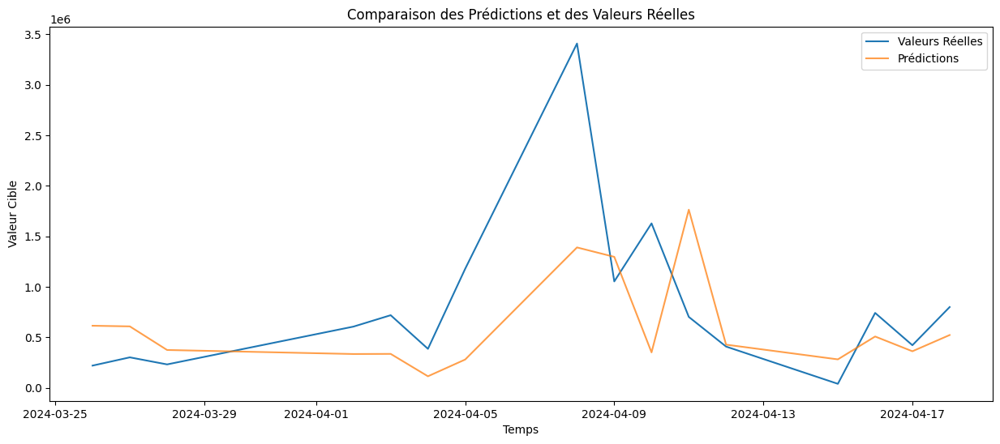

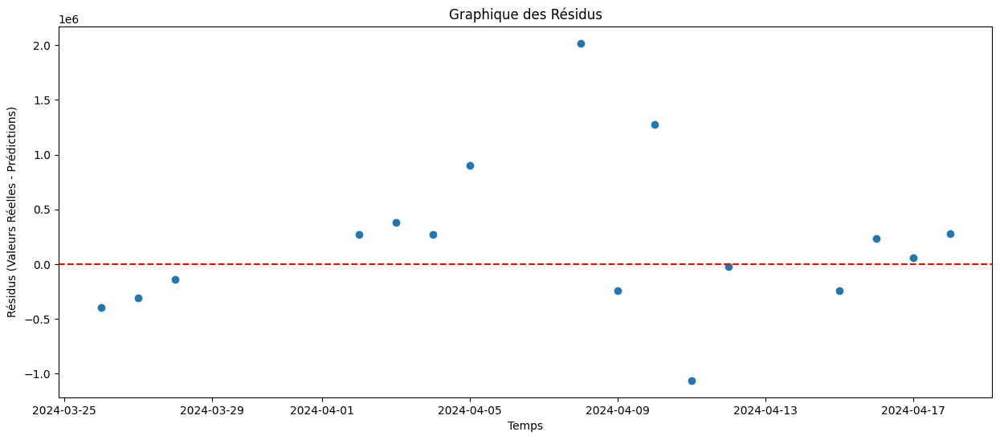

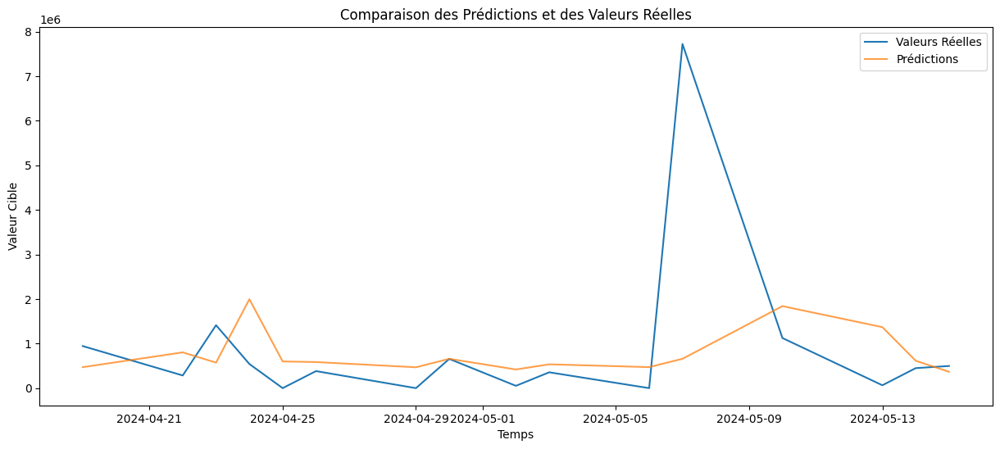

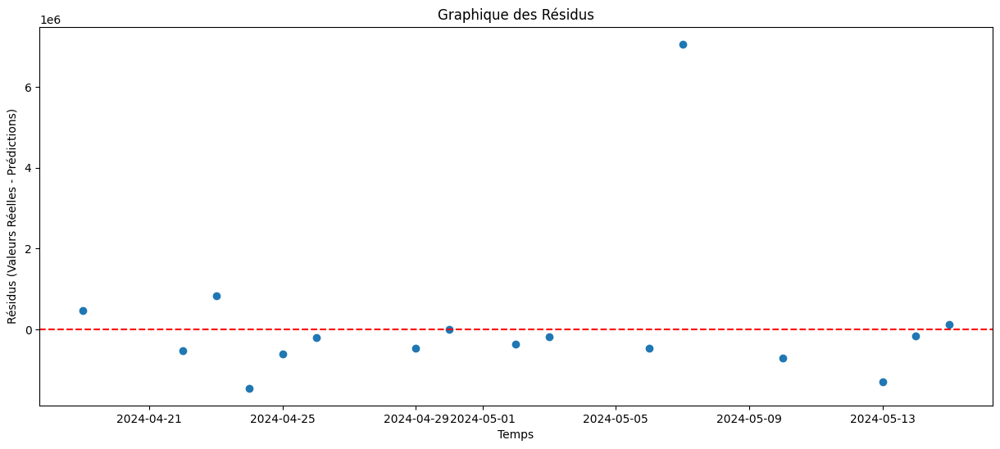

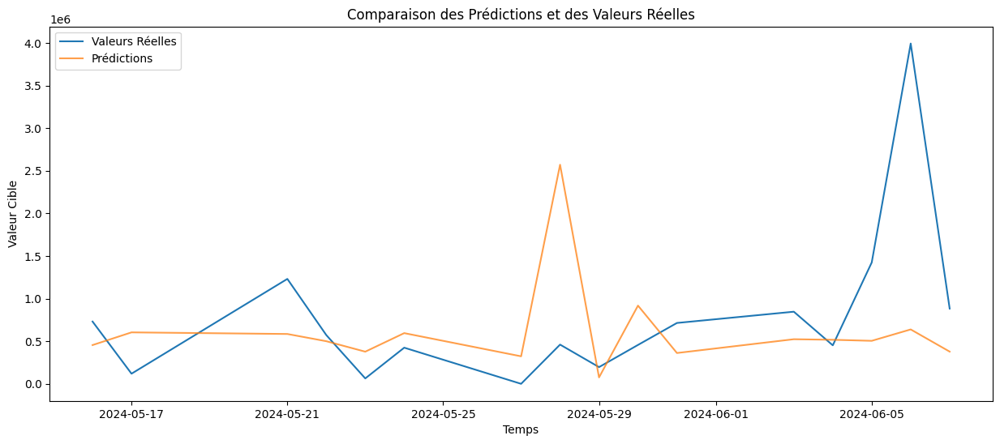

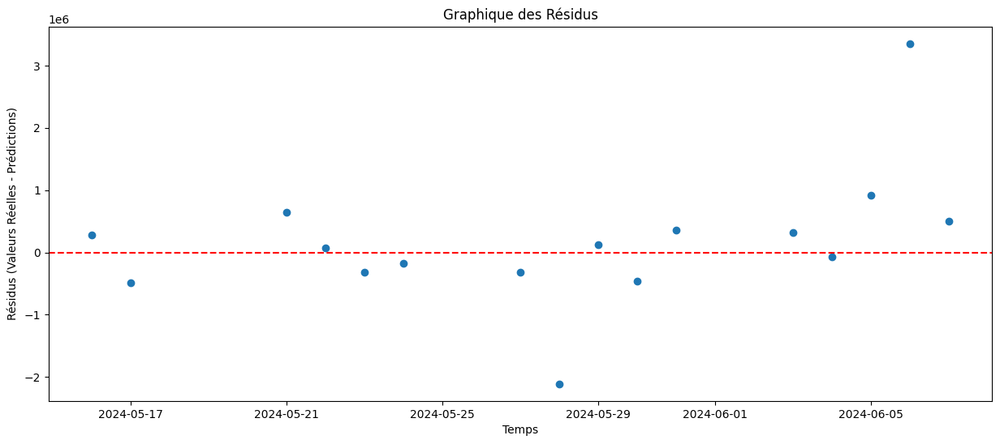

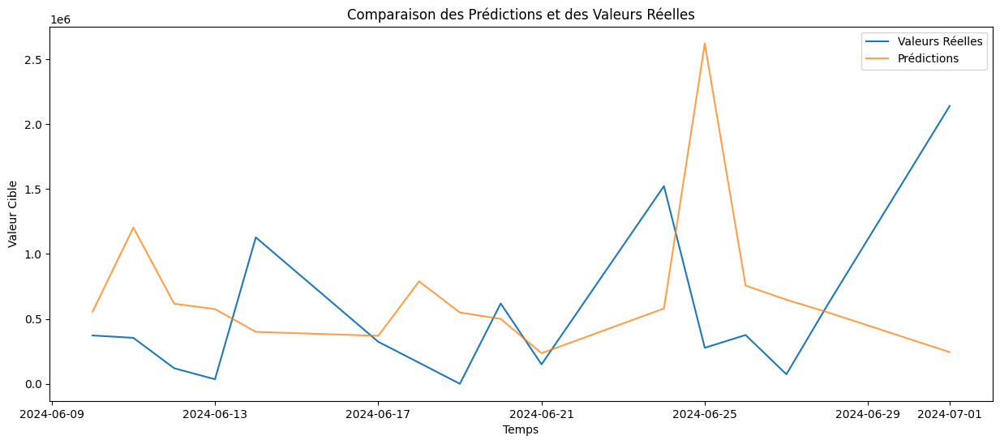

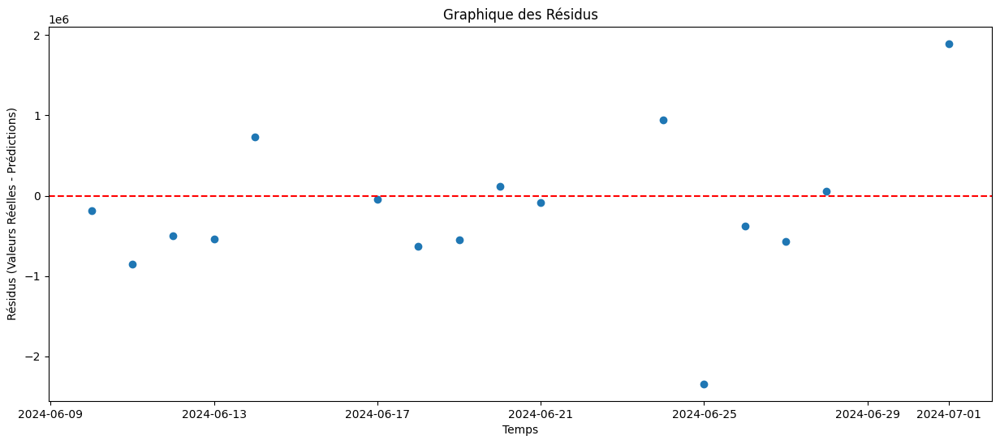

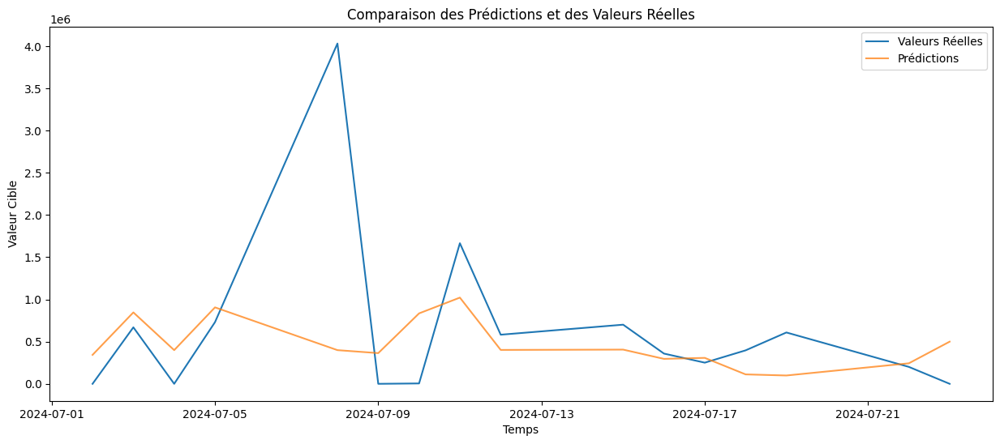

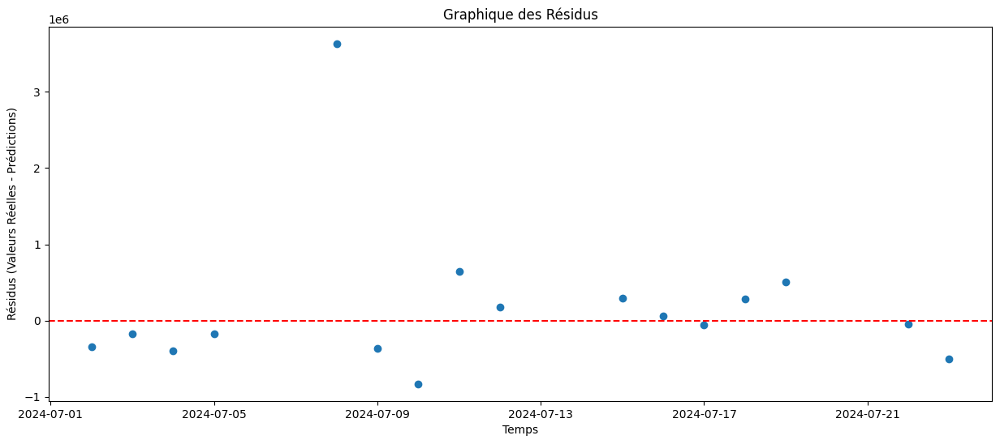

Rolling Window Analysis Average MSE for LNGIV_Collec: 1395447899894.2312
Processing series: LNGSI_Collec
Temporal Cross-Validation Average MSE for LNGSI_Collec: 45488920947065.3
Enhanced Resampling MSE for LNGSI_Collec: 10994796280147.63
Ensemble MSE with Varied Historical Contexts for LNGSI_Collec: 25275758300859.746
Average MSE with Cross-Validation on Shuffled Data for LNGSI_Collec: 52795570009617.77


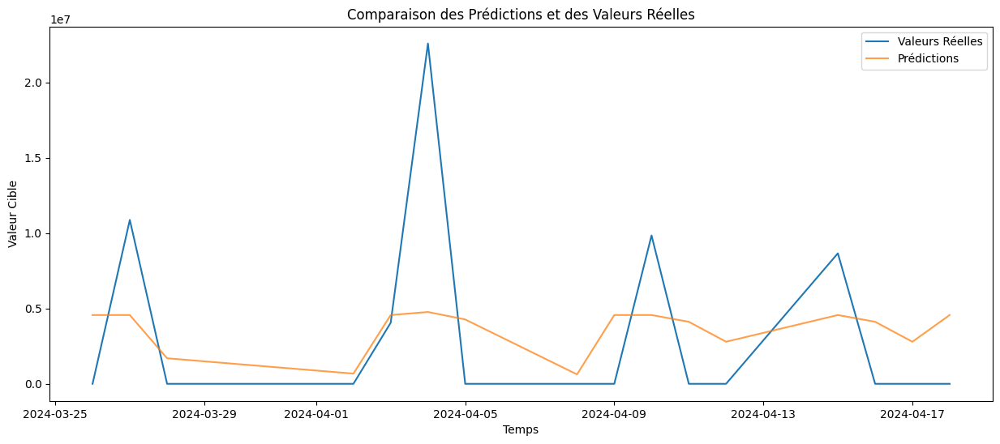

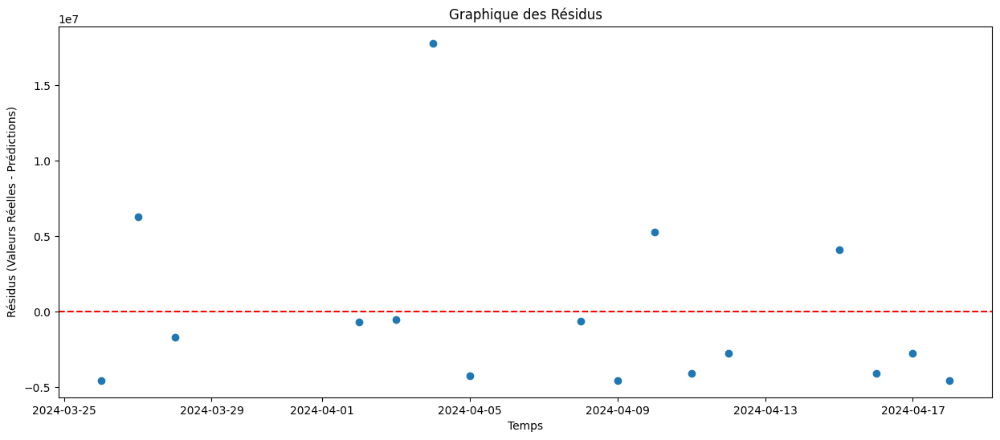

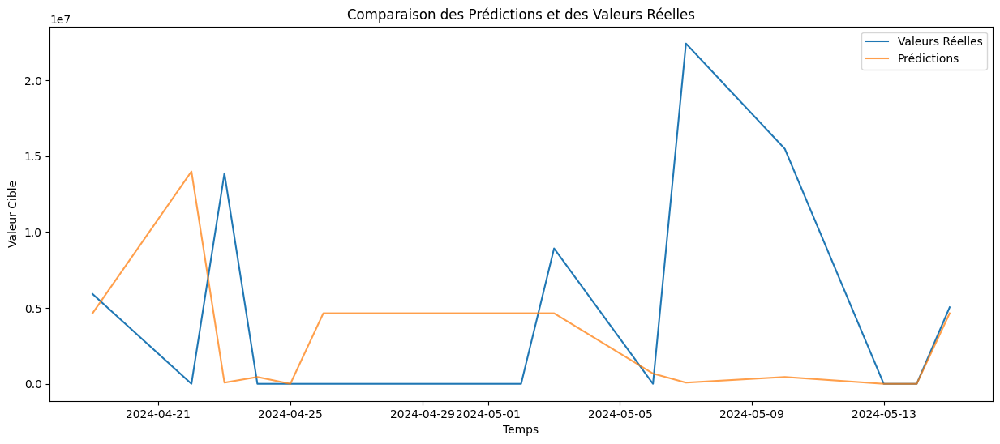

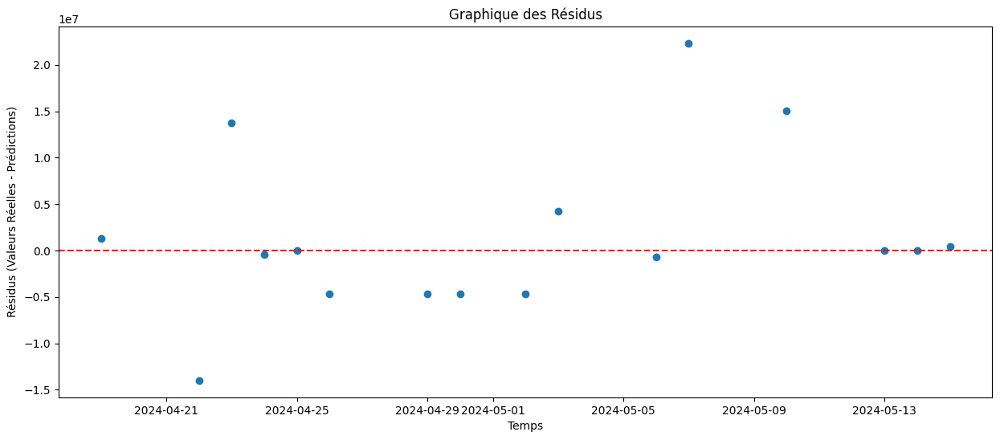

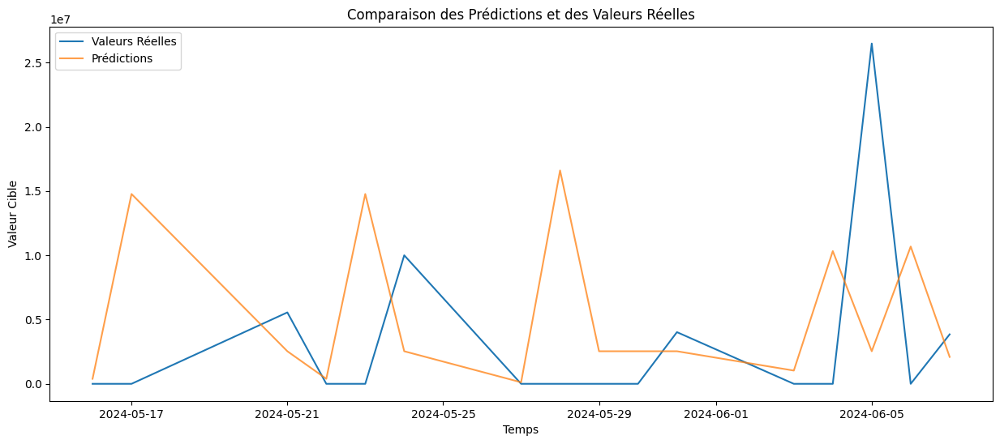

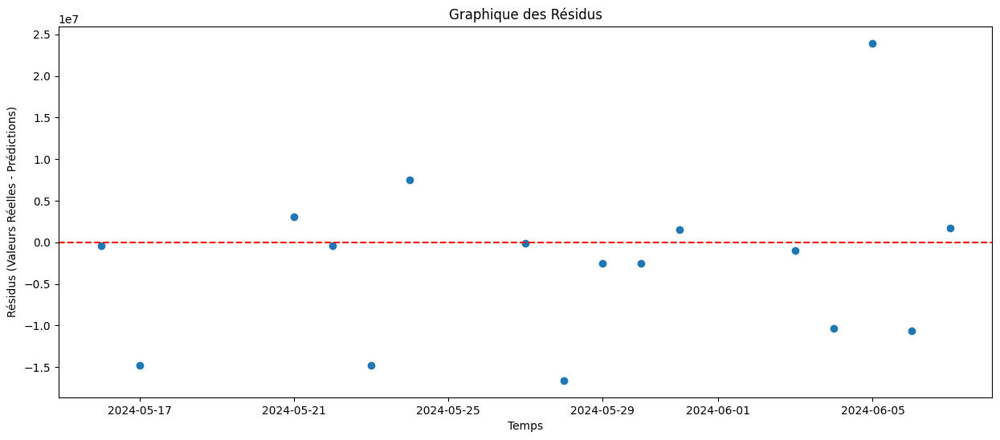

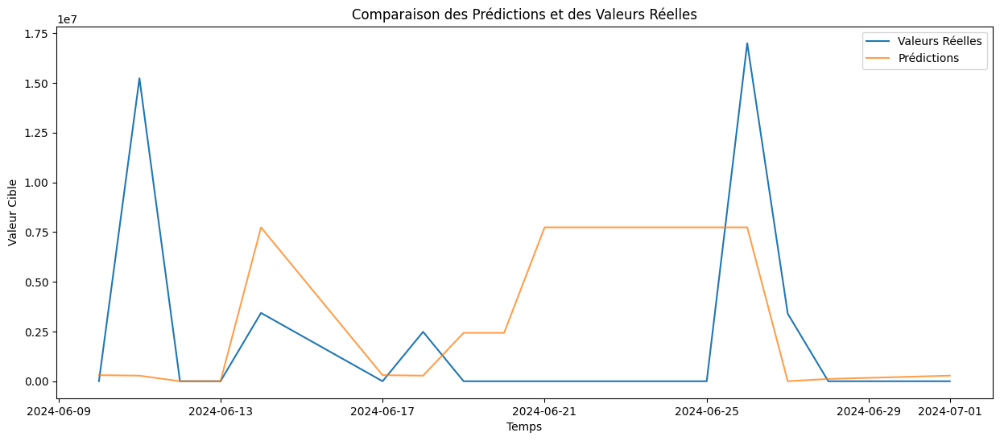

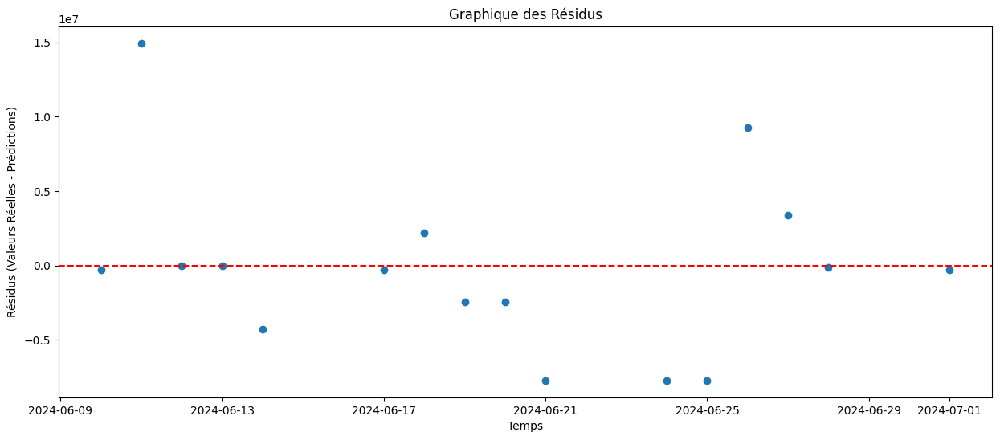

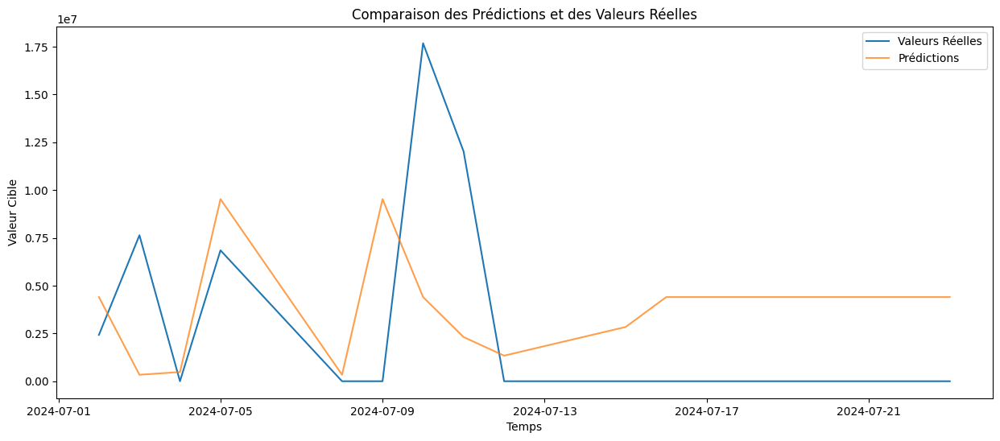

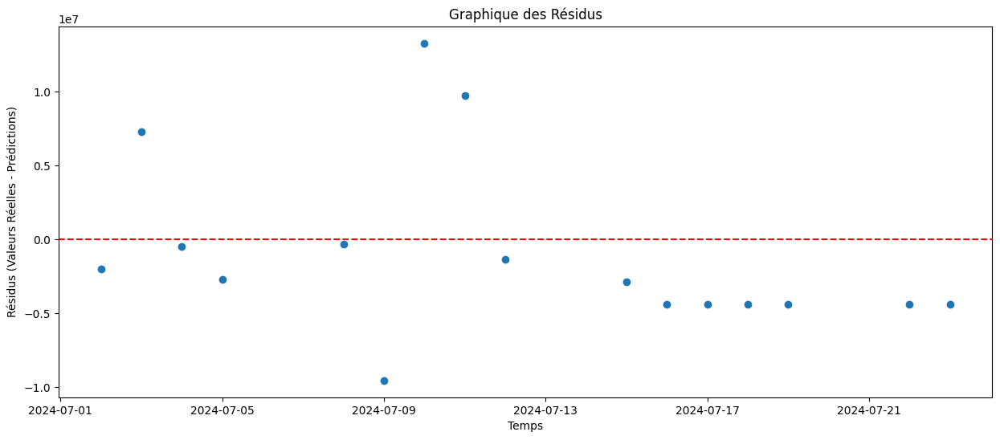

Rolling Window Analysis Average MSE for LNGSI_Collec: 55423143112582.99
Processing series: LNIGT_Collec
Temporal Cross-Validation Average MSE for LNIGT_Collec: 0.0
Enhanced Resampling MSE for LNIGT_Collec: 0.0
Ensemble MSE with Varied Historical Contexts for LNIGT_Collec: 0.0
Average MSE with Cross-Validation on Shuffled Data for LNIGT_Collec: 0.0


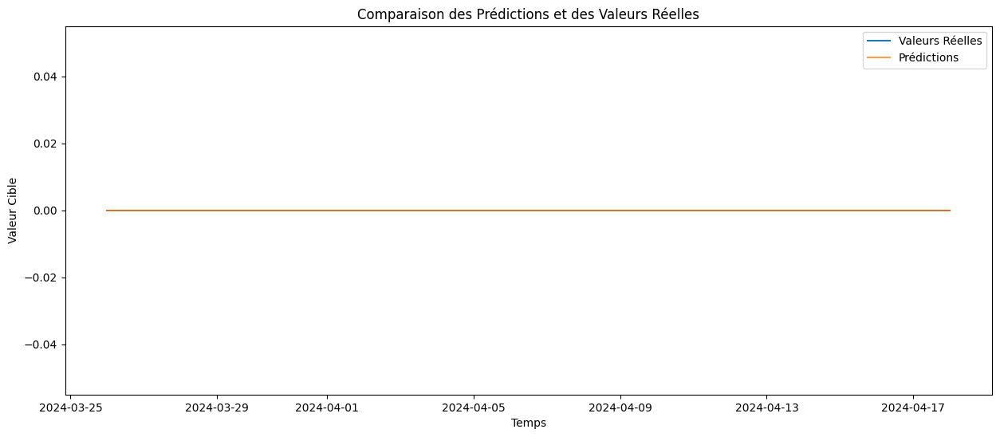

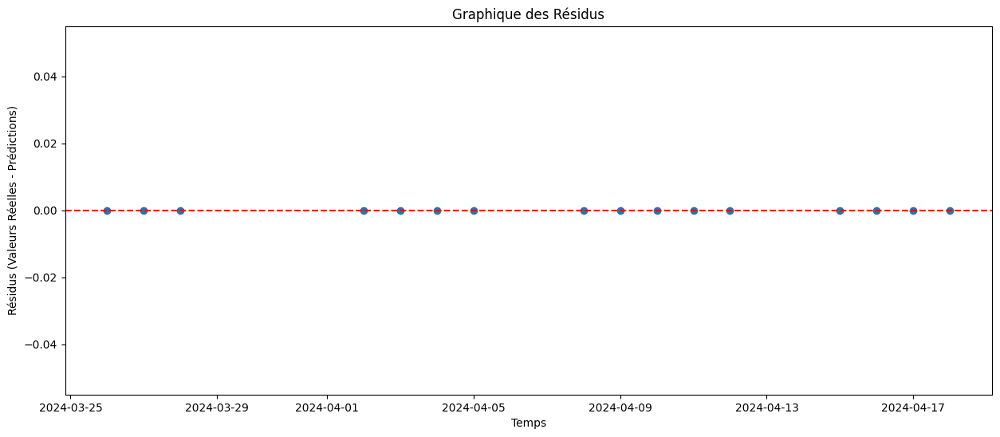

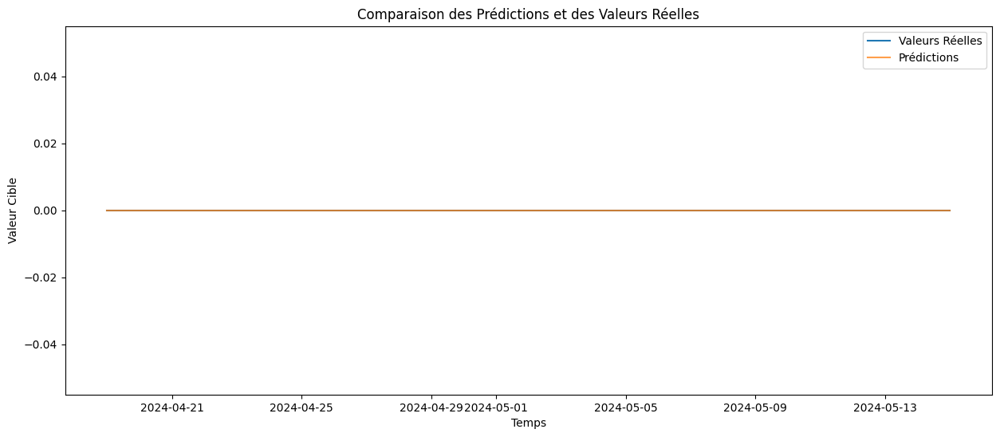

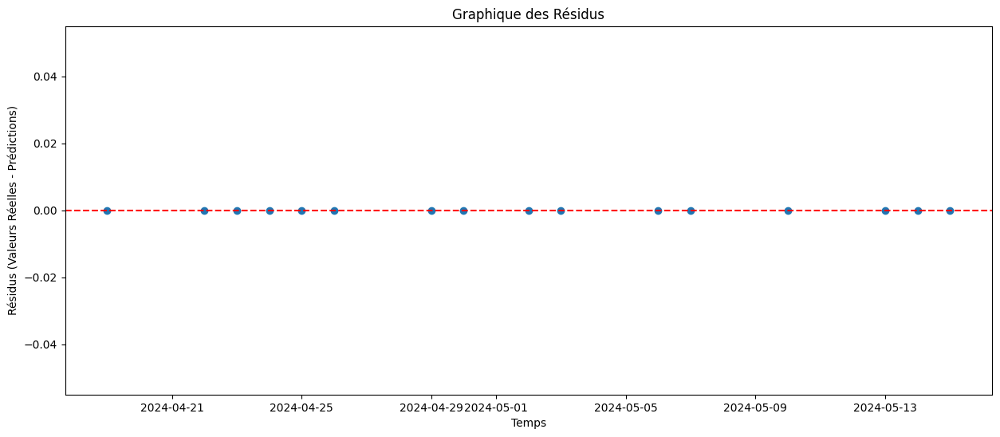

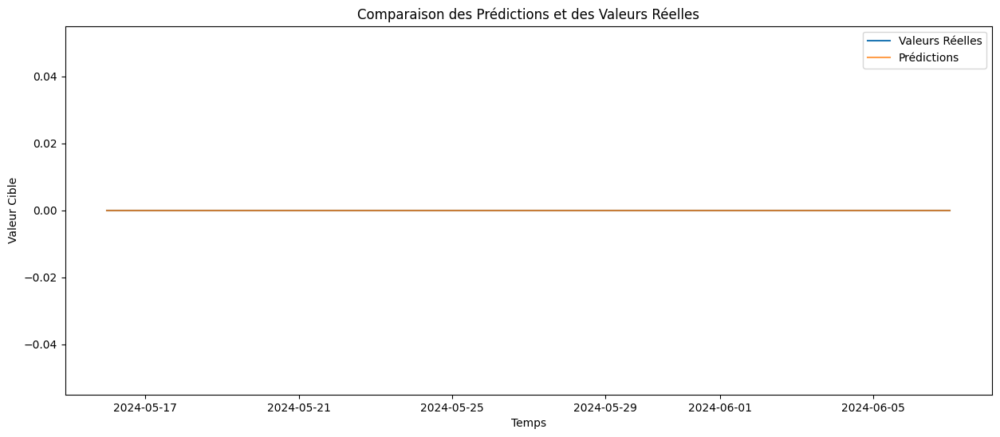

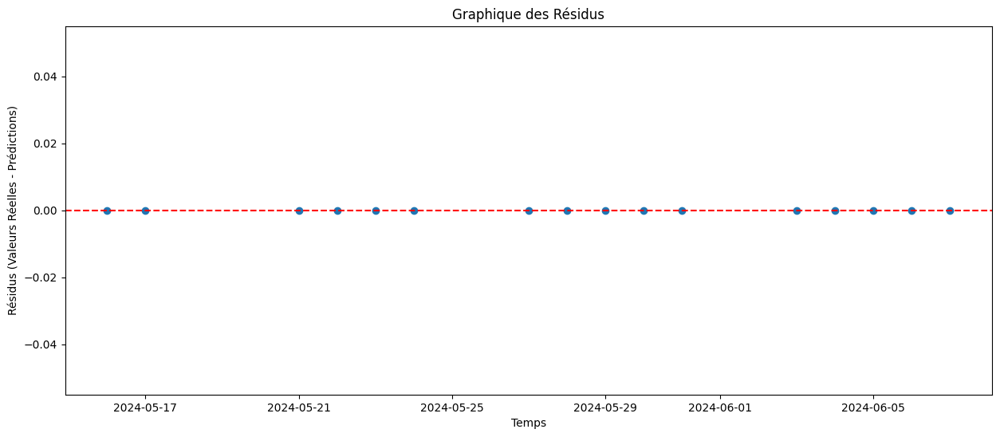

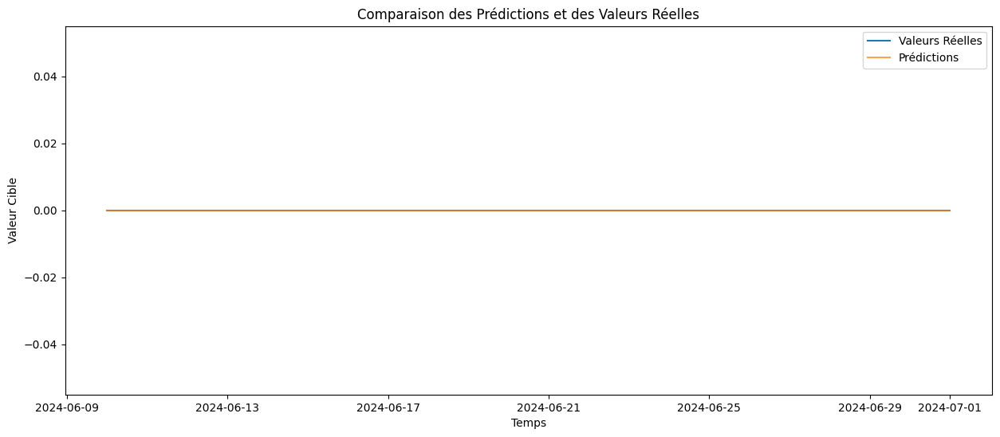

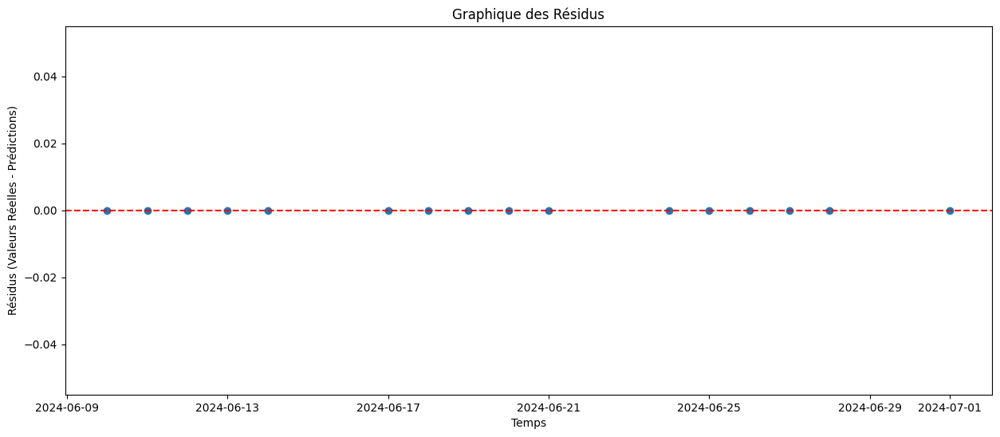

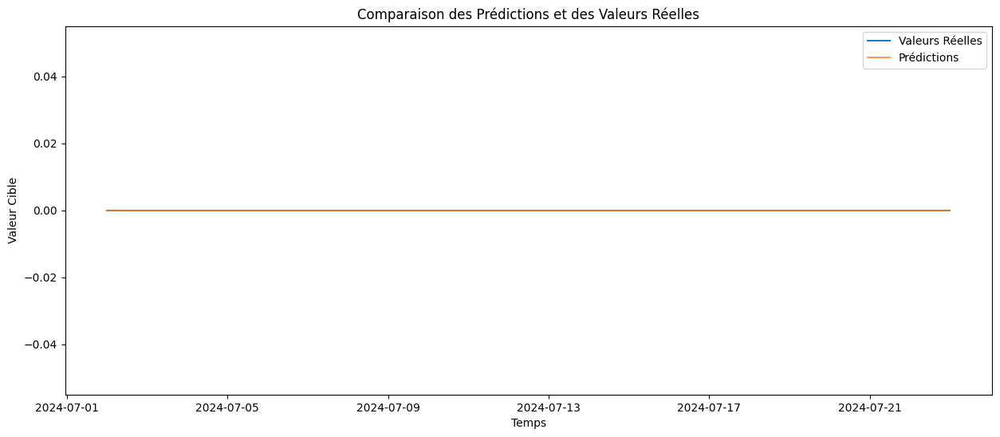

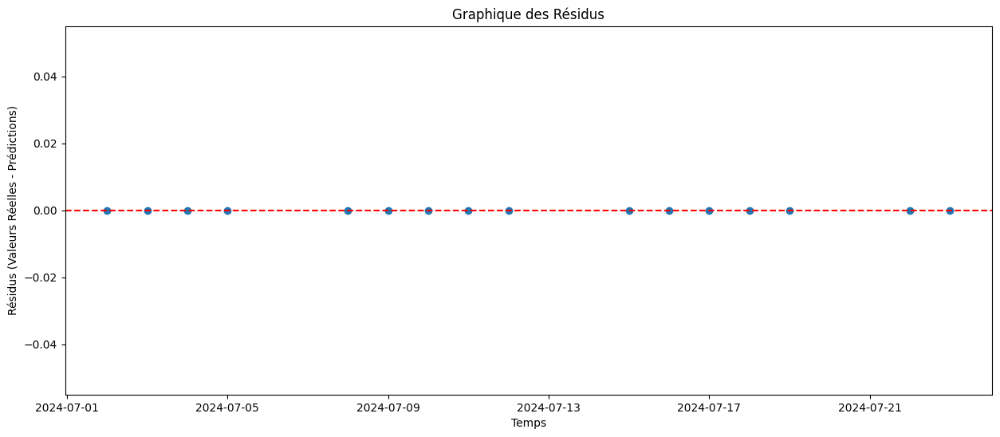

Rolling Window Analysis Average MSE for LNIGT_Collec: 0.0
Processing series: LNHET_Collec
Temporal Cross-Validation Average MSE for LNHET_Collec: 13339293286.470152
Enhanced Resampling MSE for LNHET_Collec: 3895126285.4078074
Ensemble MSE with Varied Historical Contexts for LNHET_Collec: 3726541138.611831
Average MSE with Cross-Validation on Shuffled Data for LNHET_Collec: 11625505515.280804


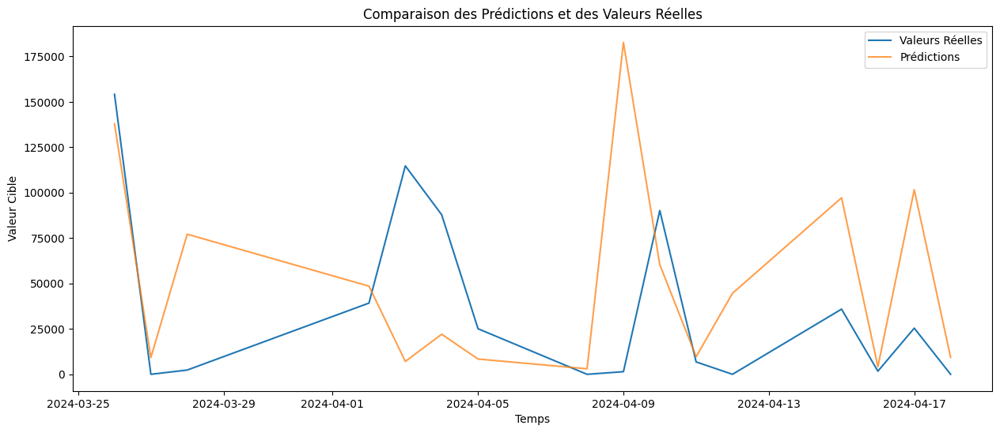

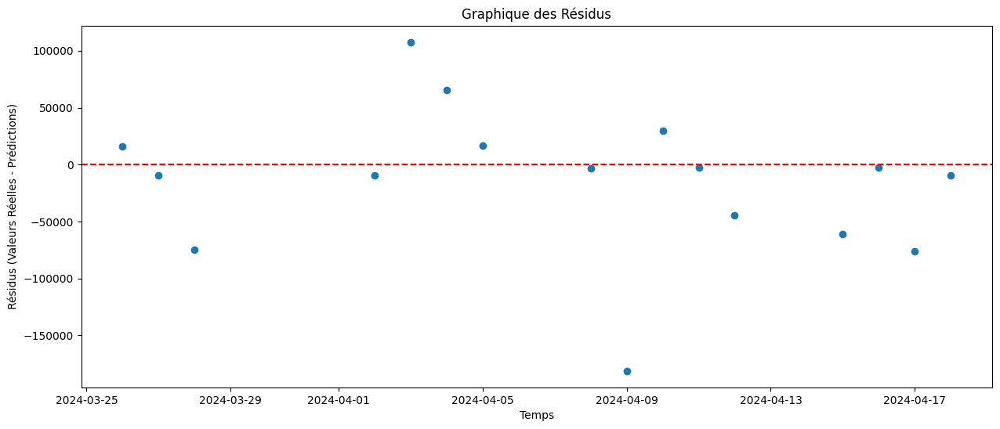

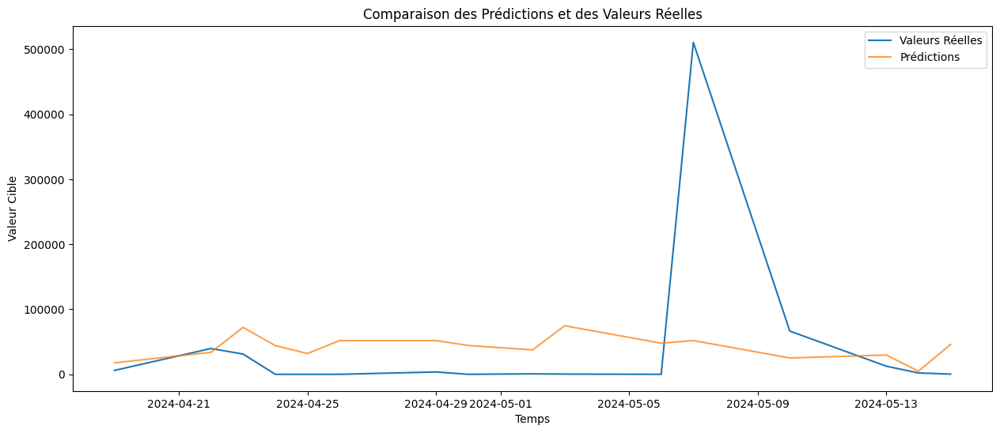

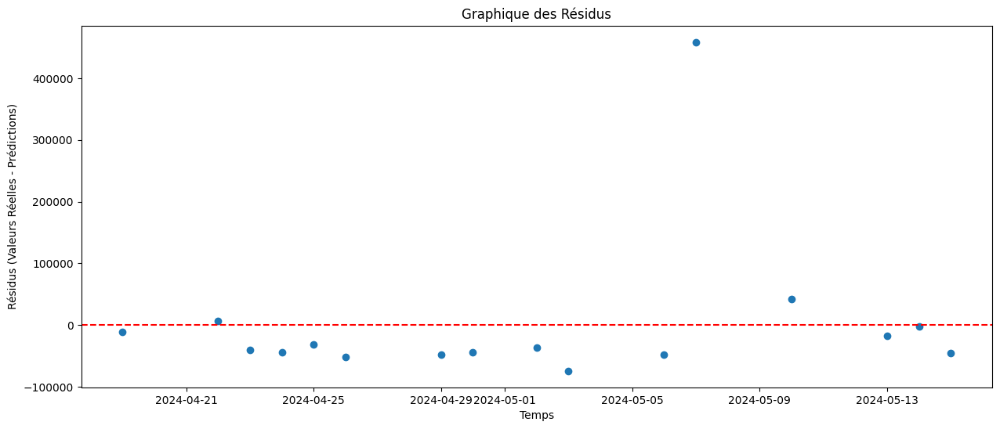

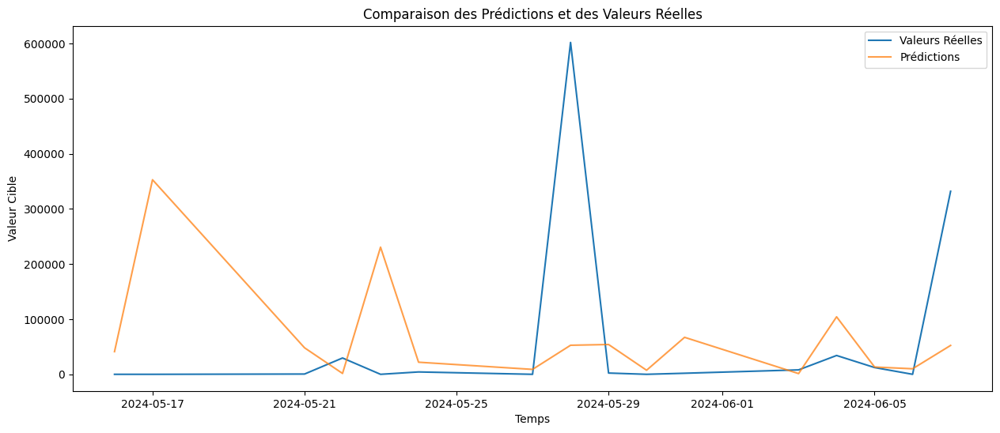

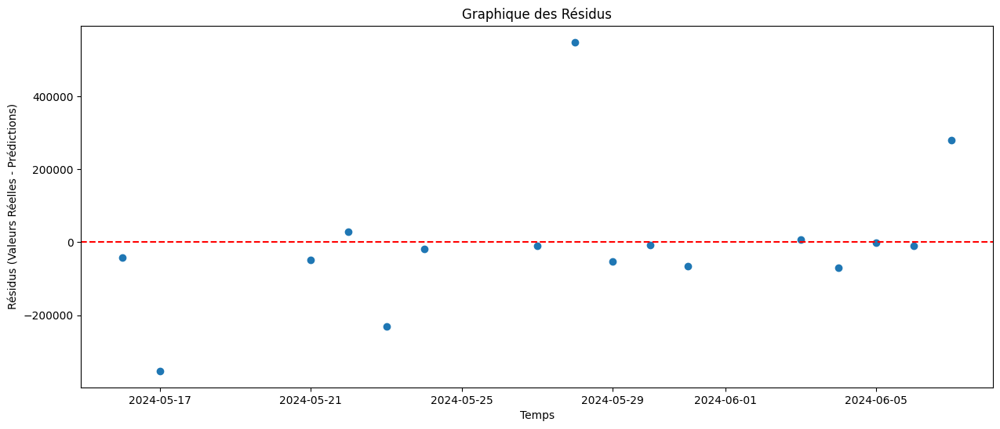

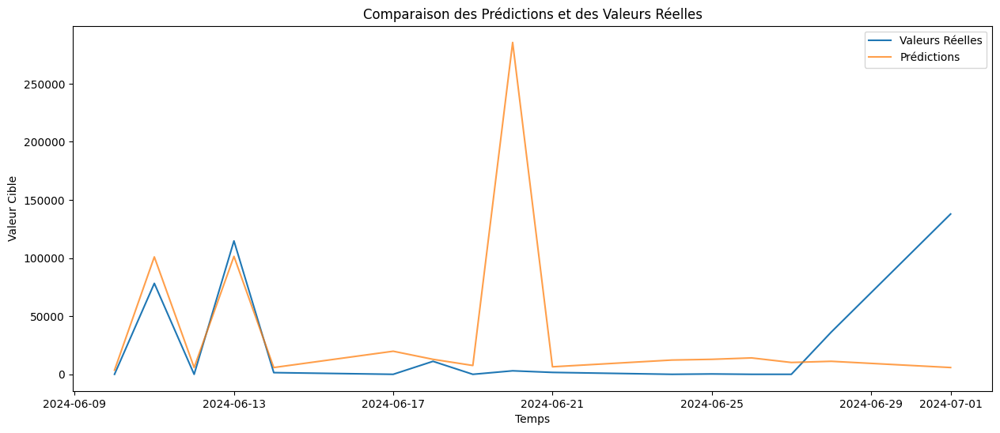

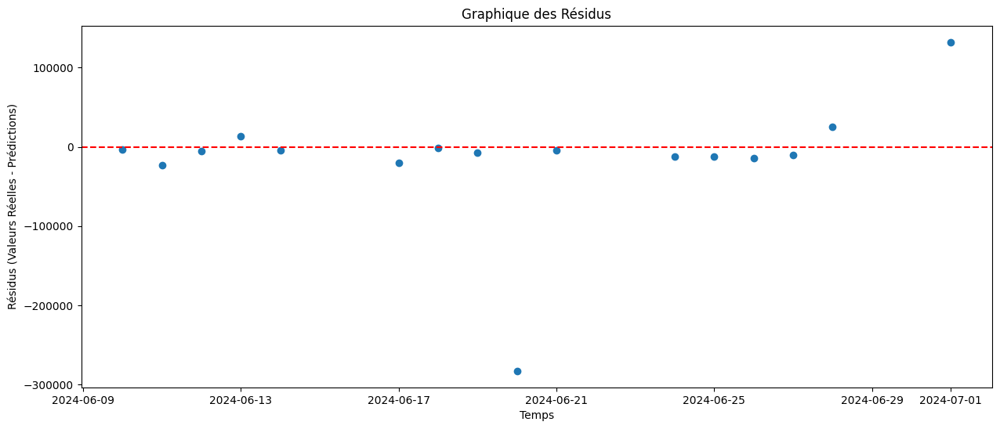

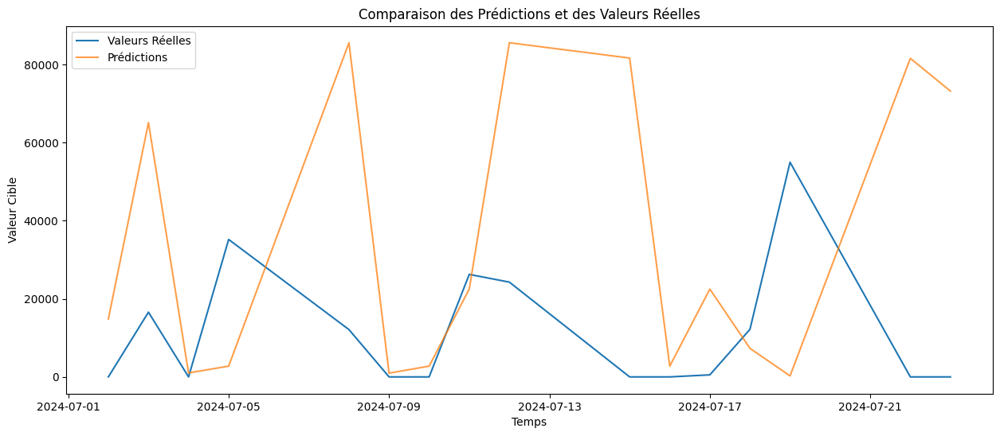

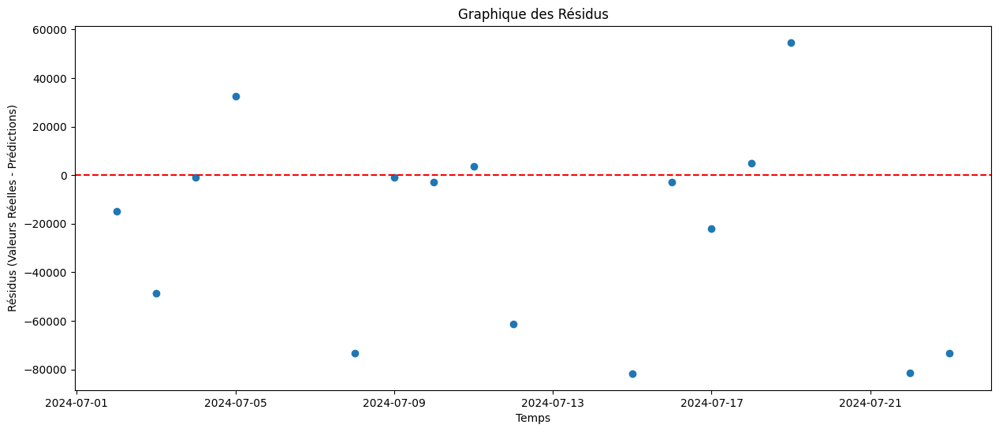

Rolling Window Analysis Average MSE for LNHET_Collec: 12655951385.499332
Processing series: LNHEC_Collec
Temporal Cross-Validation Average MSE for LNHEC_Collec: 11912679944.933687
Enhanced Resampling MSE for LNHEC_Collec: 2585435770.5097914
Ensemble MSE with Varied Historical Contexts for LNHEC_Collec: 3091663417.1306195
Average MSE with Cross-Validation on Shuffled Data for LNHEC_Collec: 13526765047.504969


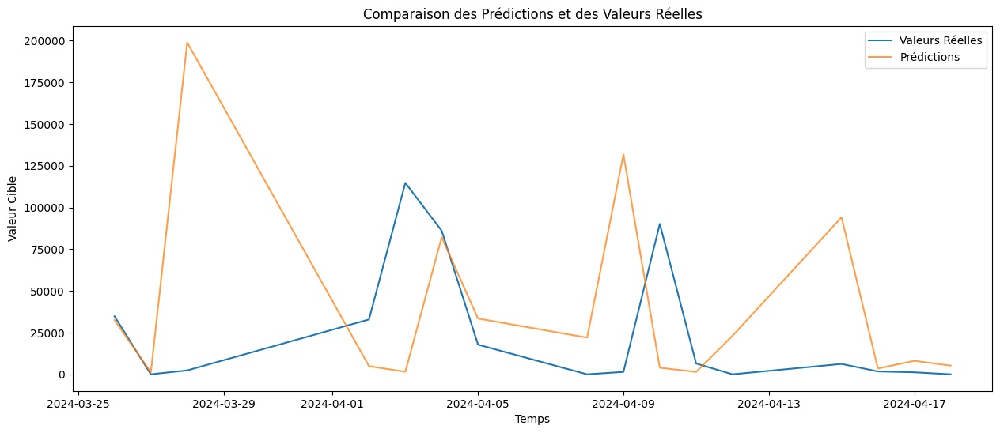

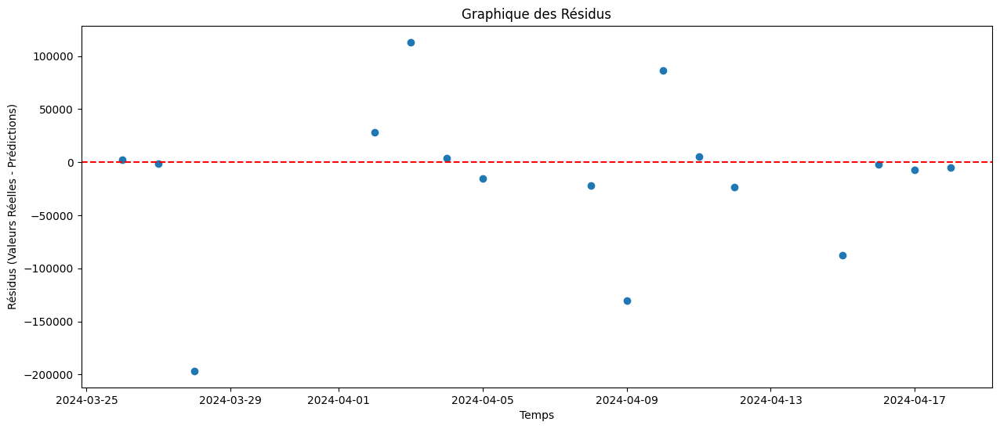

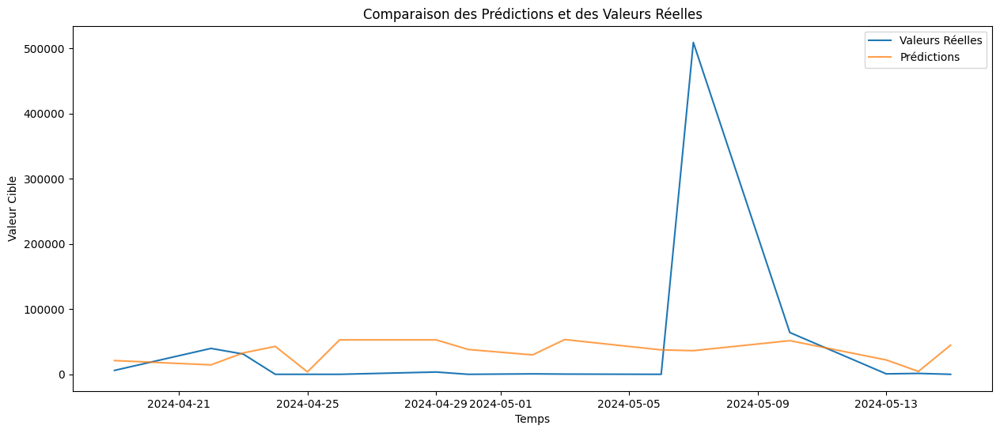

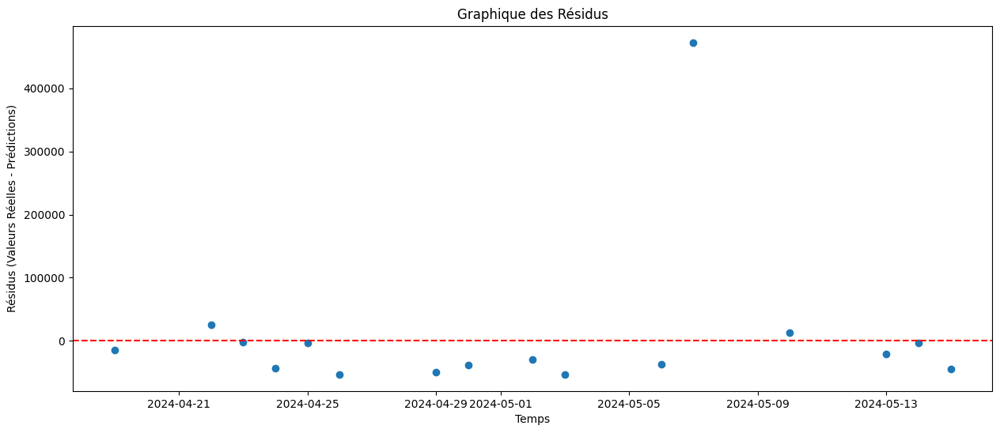

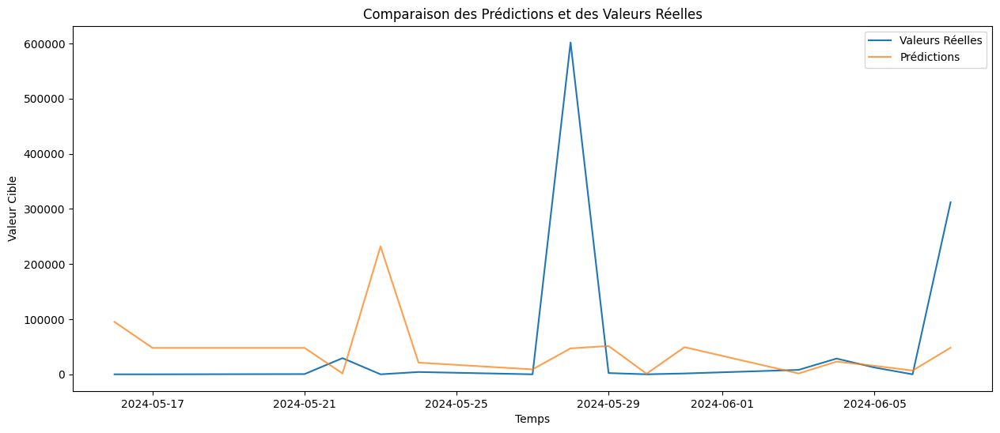

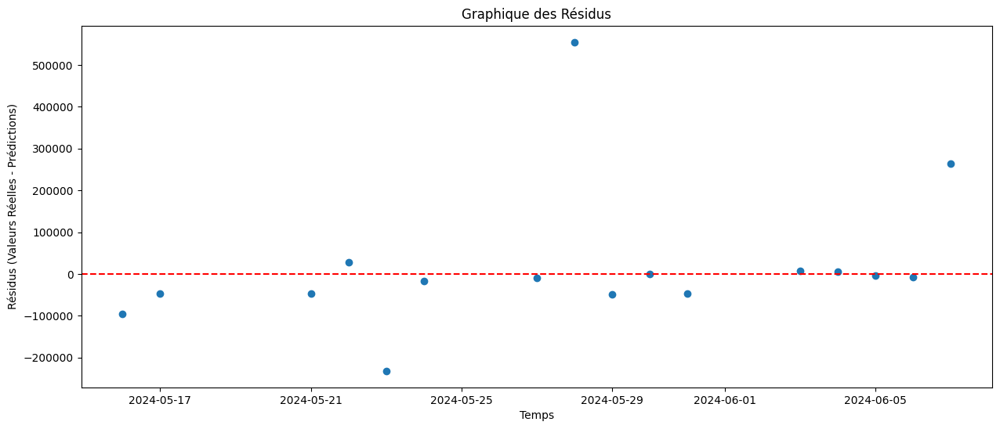

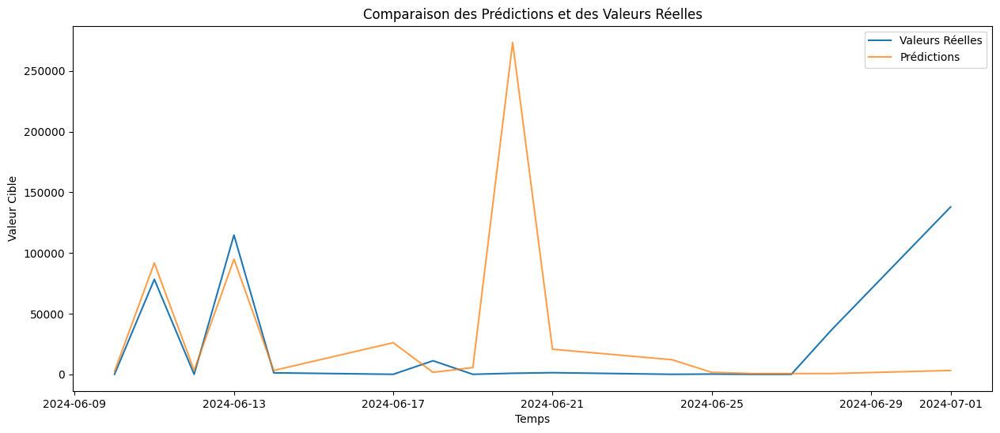

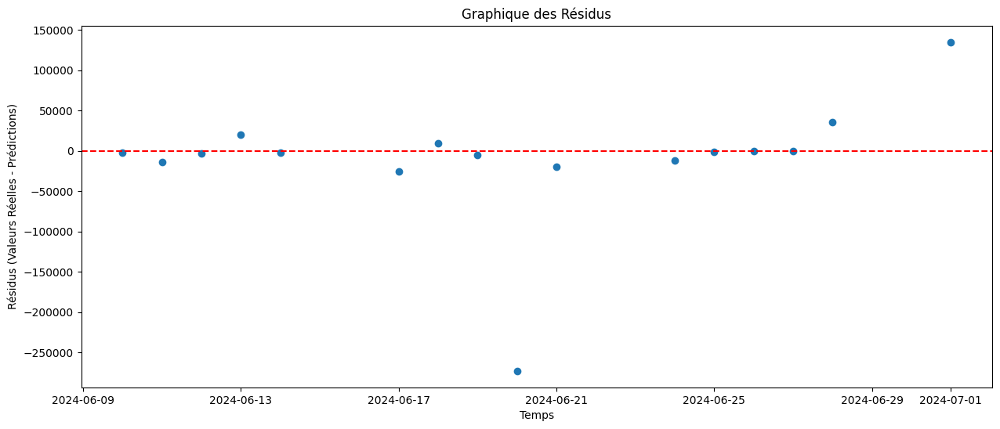

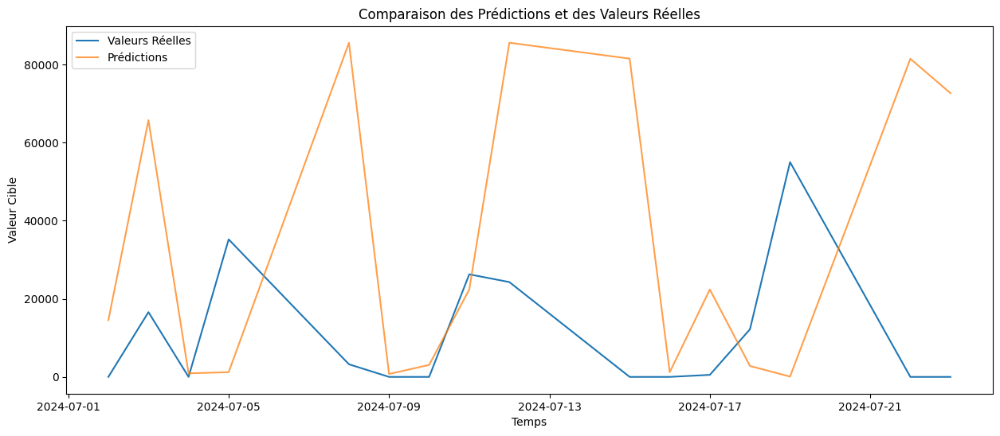

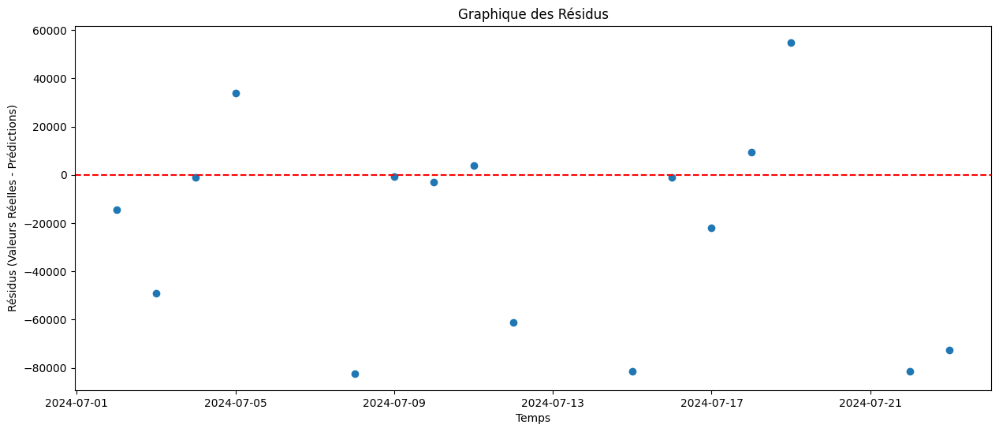

Rolling Window Analysis Average MSE for LNHEC_Collec: 11363196743.266438
Processing series: LNHEP_Collec
Temporal Cross-Validation Average MSE for LNHEP_Collec: 243399315.70014662
Enhanced Resampling MSE for LNHEP_Collec: 728436040.2010604
Ensemble MSE with Varied Historical Contexts for LNHEP_Collec: 112908800.88521329
Average MSE with Cross-Validation on Shuffled Data for LNHEP_Collec: 401657730.51229686


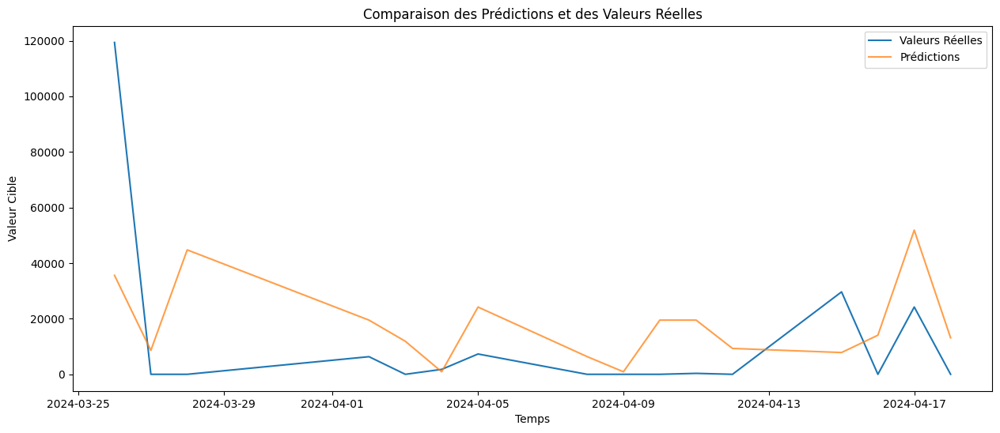

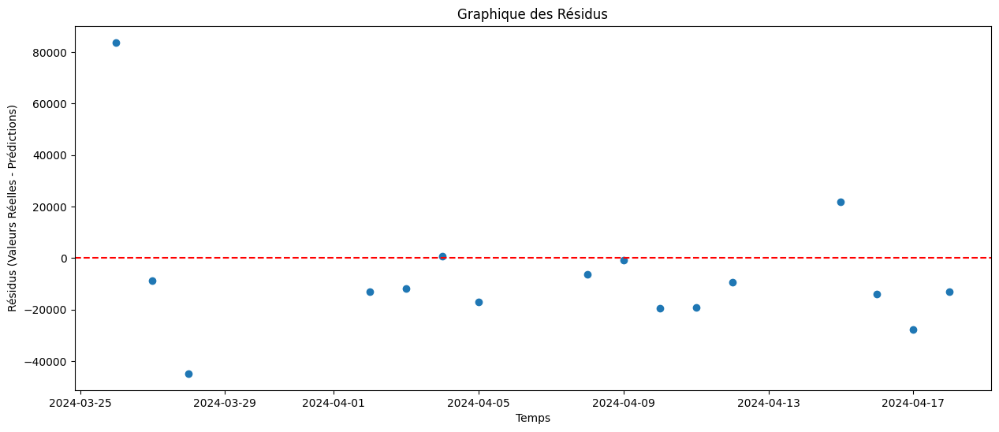

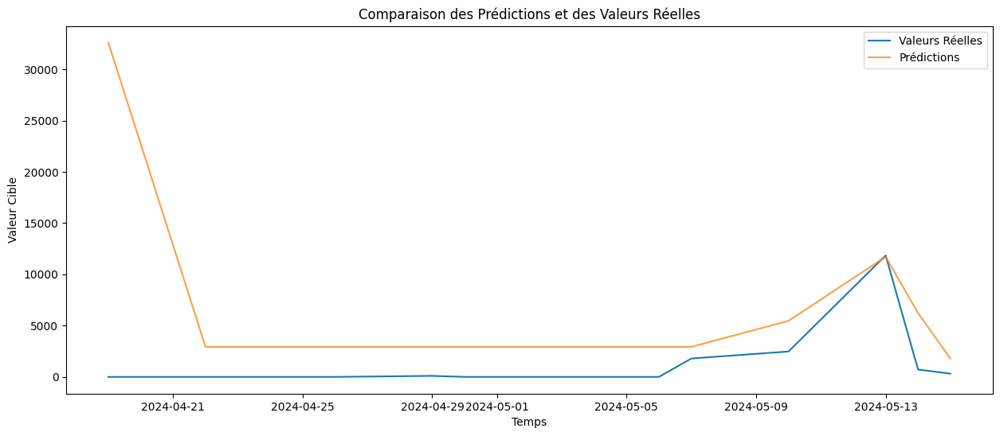

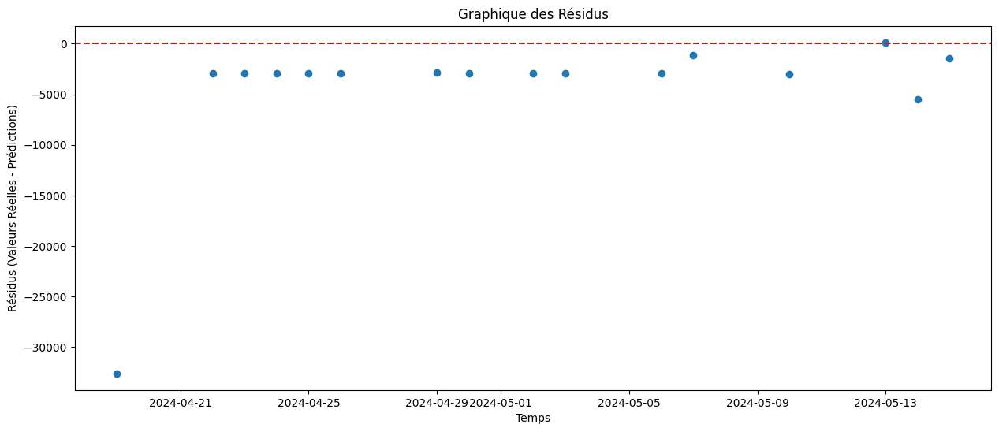

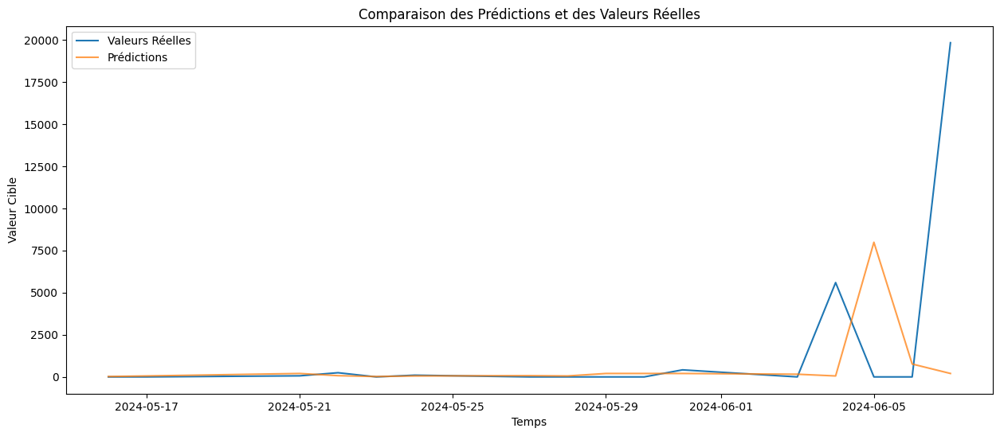

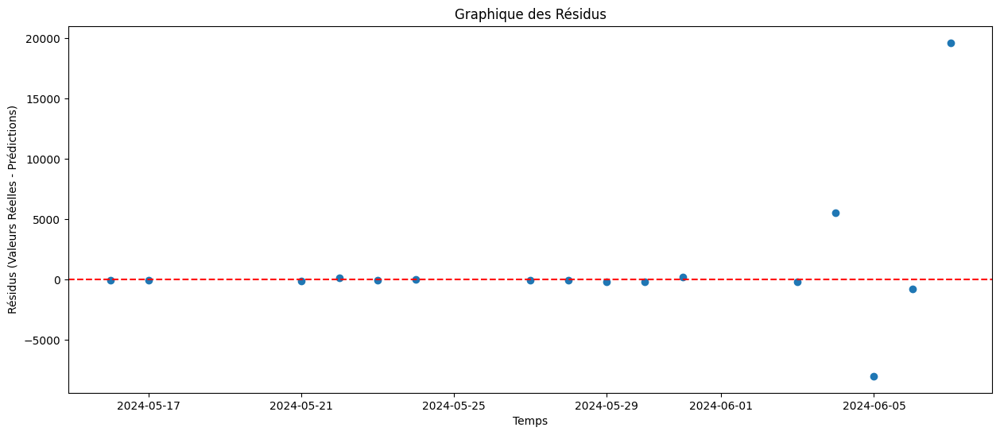

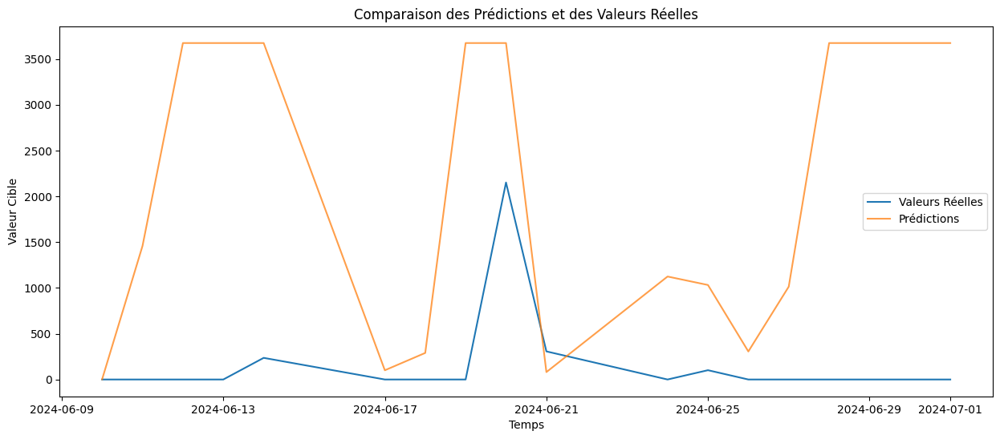

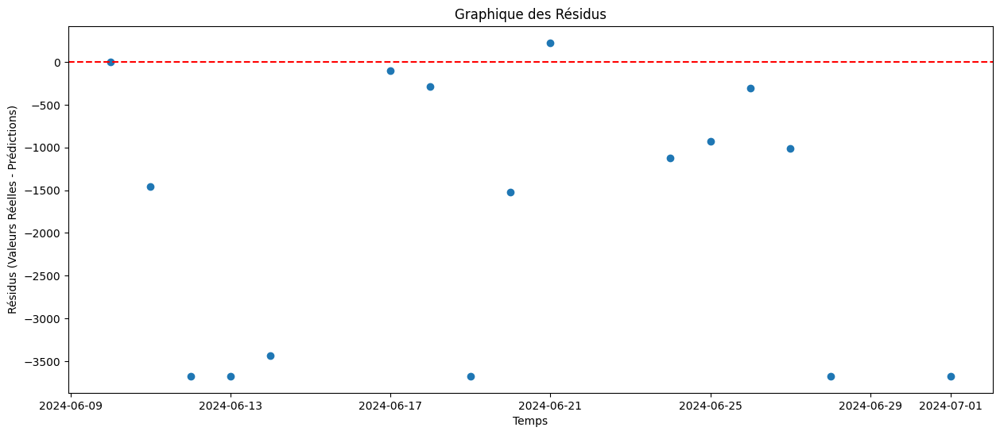

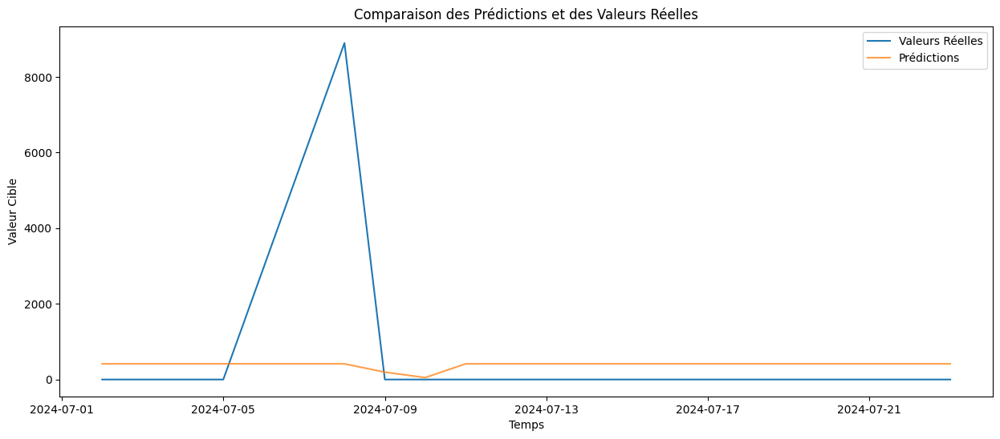

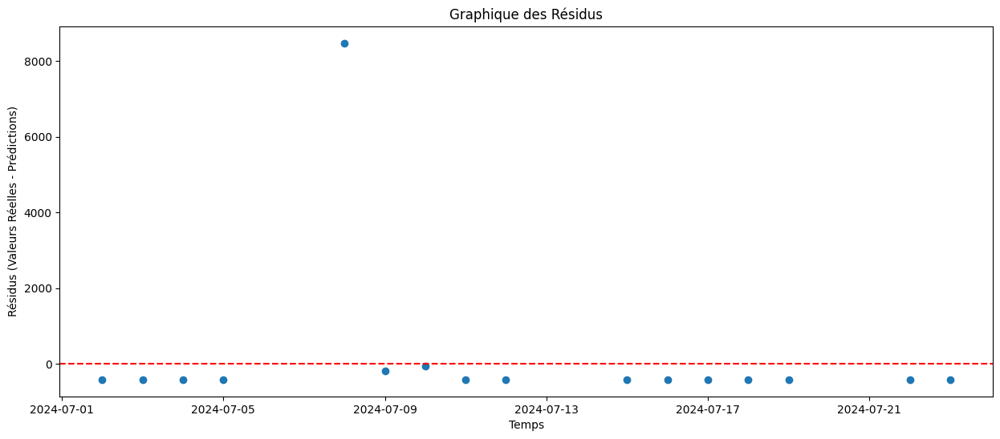

Rolling Window Analysis Average MSE for LNHEP_Collec: 175165987.29397494
Processing series: LNHER_Collec
Temporal Cross-Validation Average MSE for LNHER_Collec: 15217159464706.156
Enhanced Resampling MSE for LNHER_Collec: 31057628911040.418
Ensemble MSE with Varied Historical Contexts for LNHER_Collec: 4323767162061.38
Average MSE with Cross-Validation on Shuffled Data for LNHER_Collec: 18494265198396.855


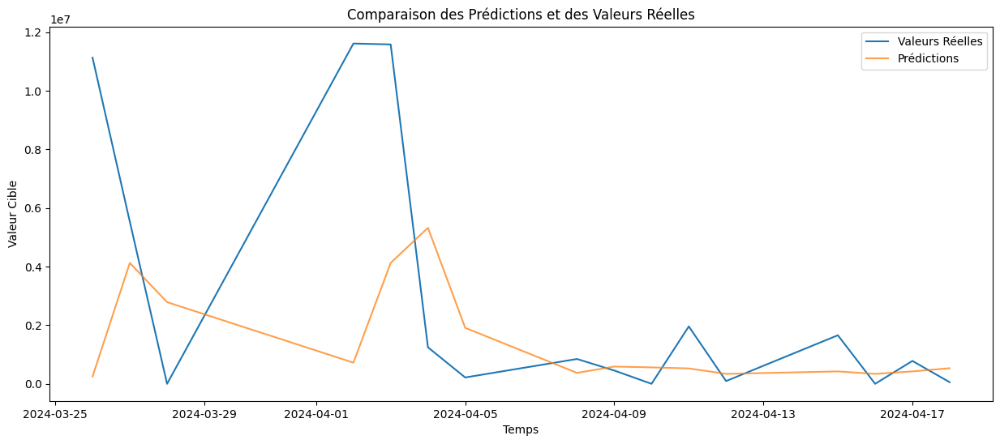

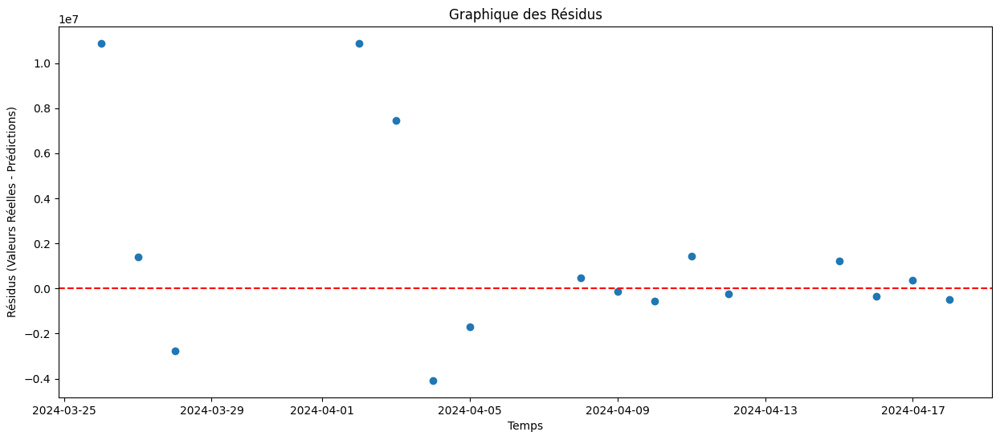

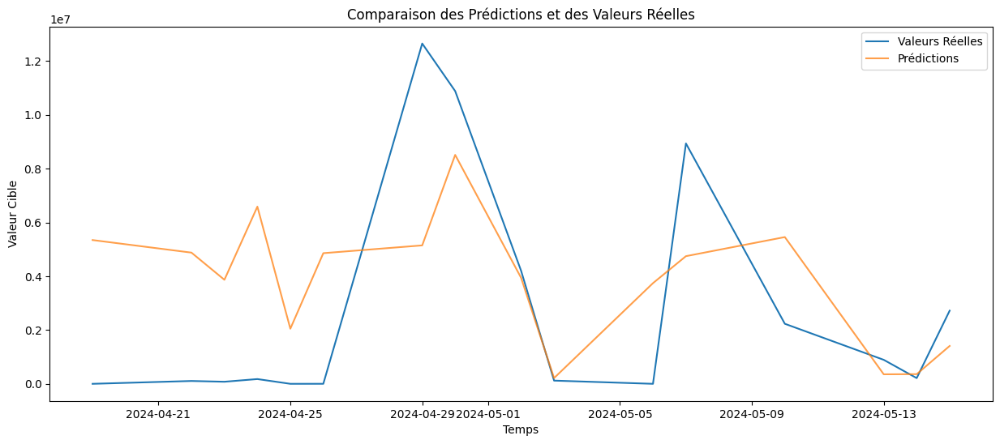

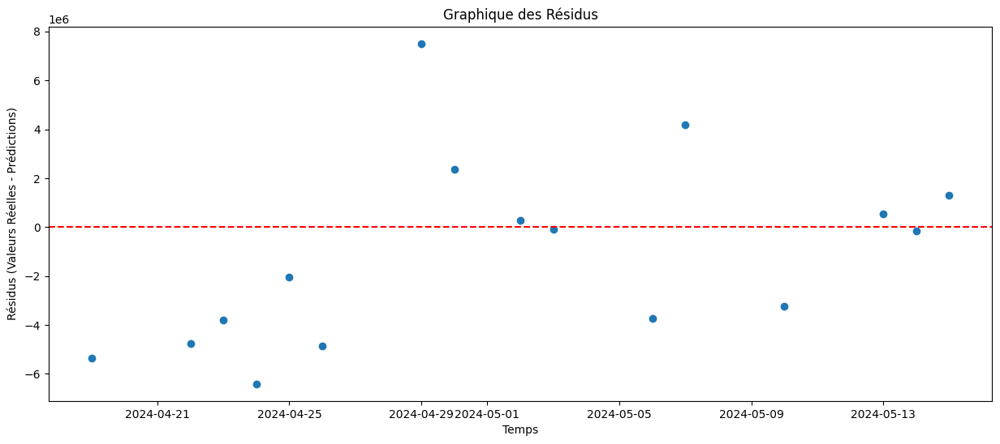

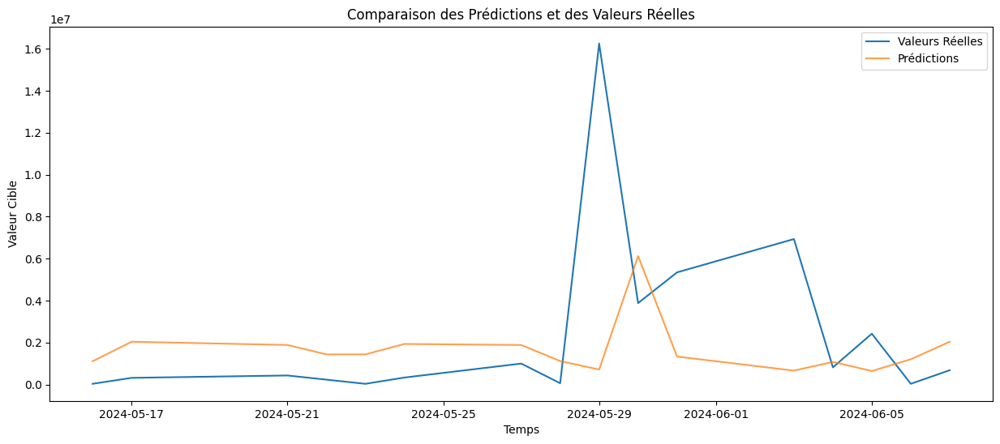

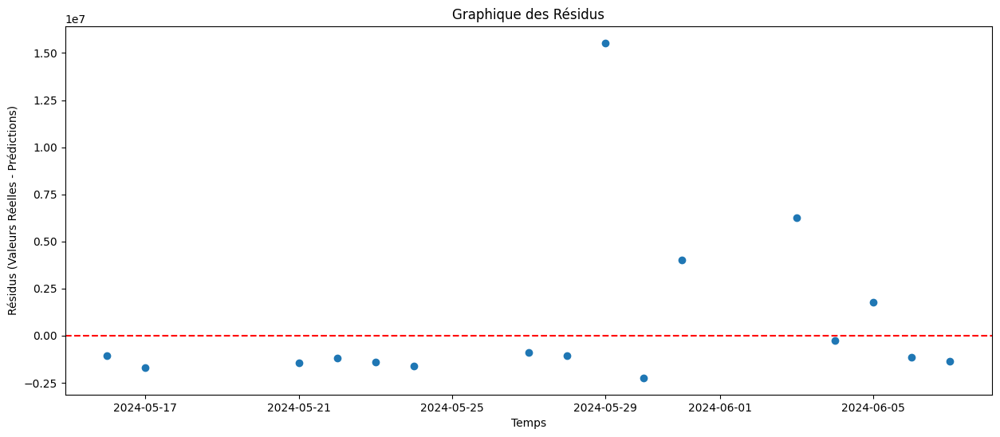

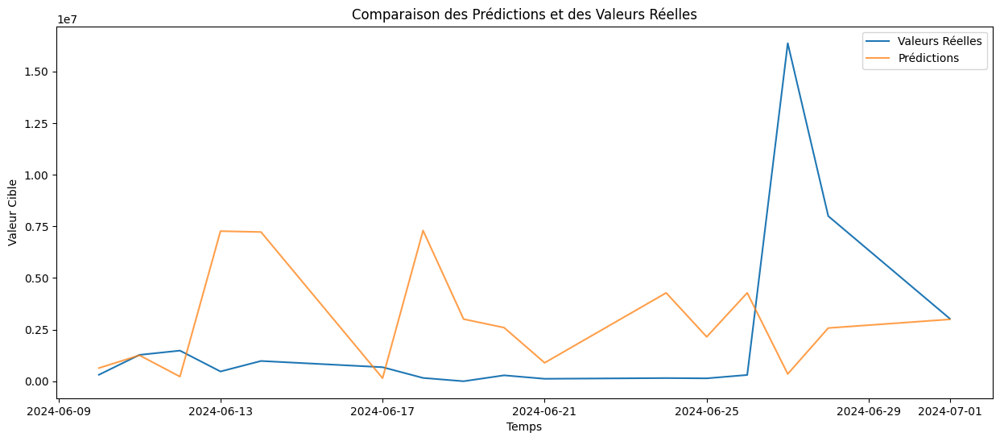

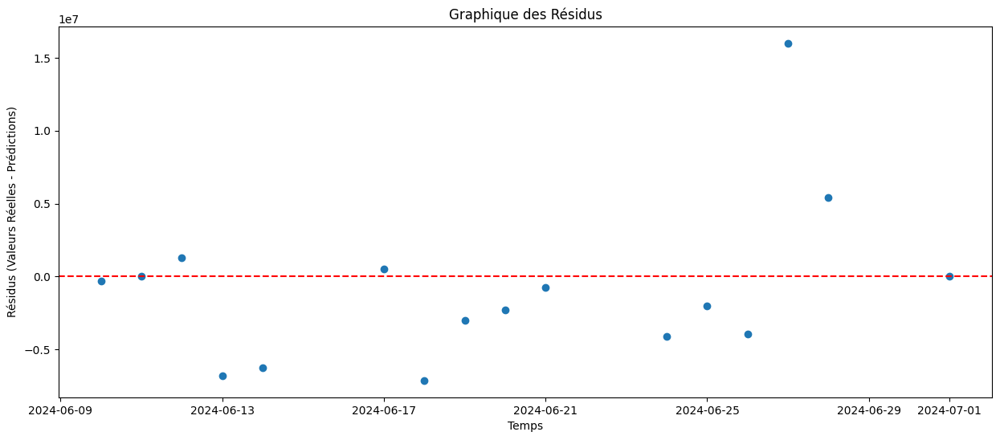

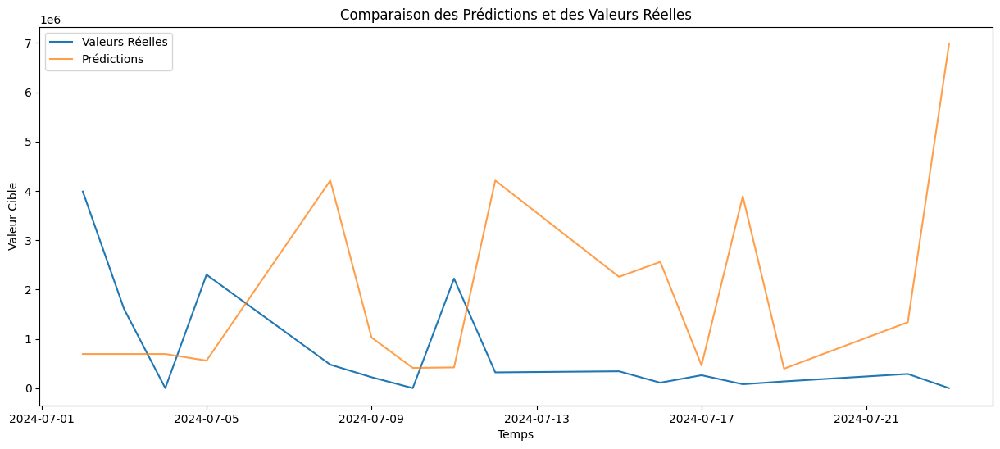

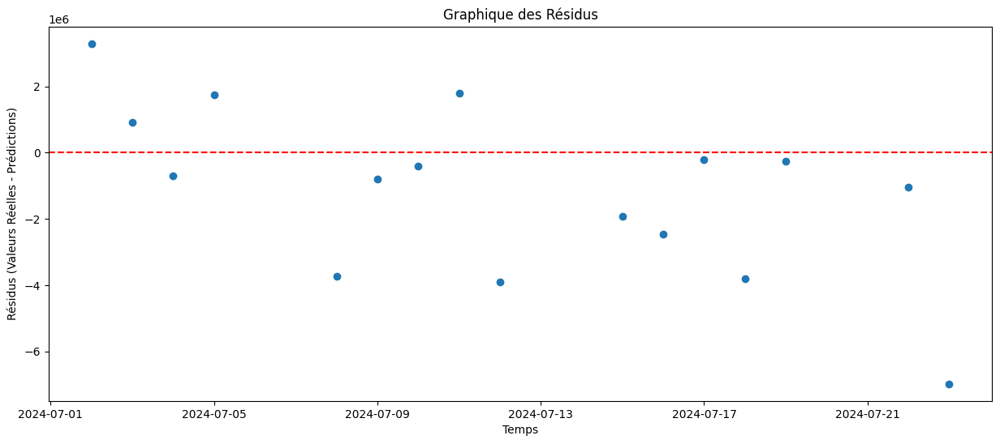

Rolling Window Analysis Average MSE for LNHER_Collec: 18596610816318.453
Processing series: LNLOA_Collec
Temporal Cross-Validation Average MSE for LNLOA_Collec: 0.0
Enhanced Resampling MSE for LNLOA_Collec: 0.0
Ensemble MSE with Varied Historical Contexts for LNLOA_Collec: 0.0
Average MSE with Cross-Validation on Shuffled Data for LNLOA_Collec: 0.0


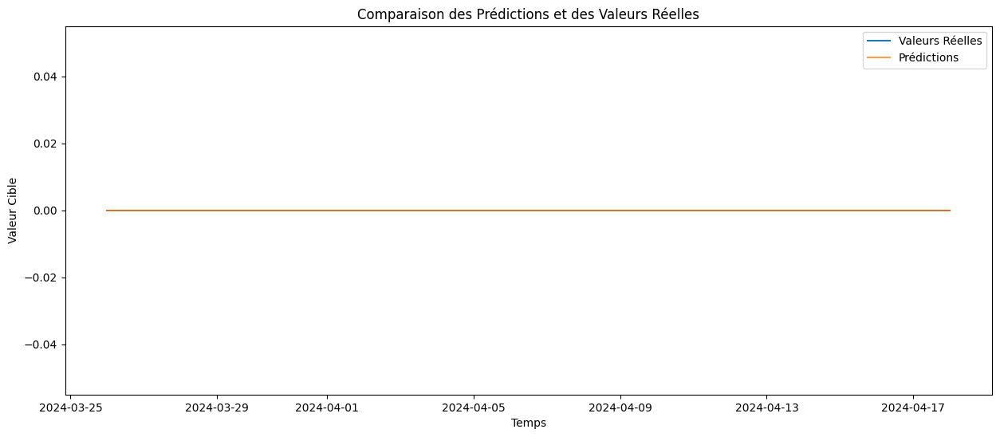

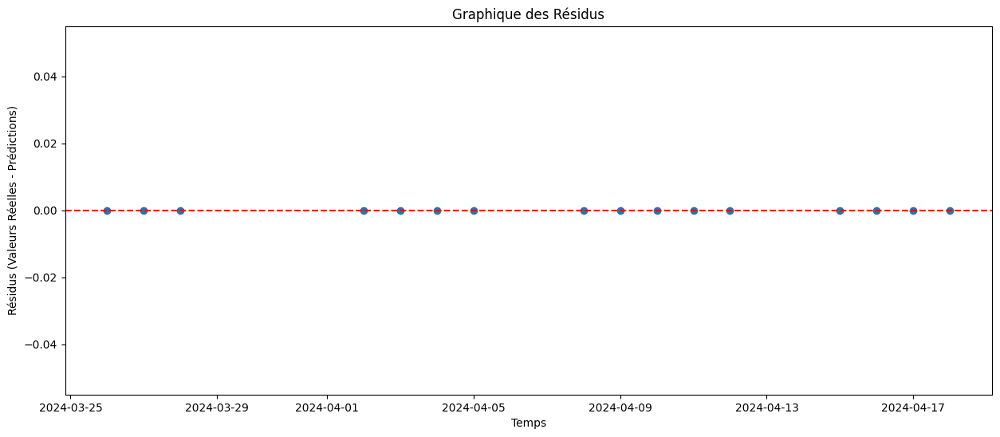

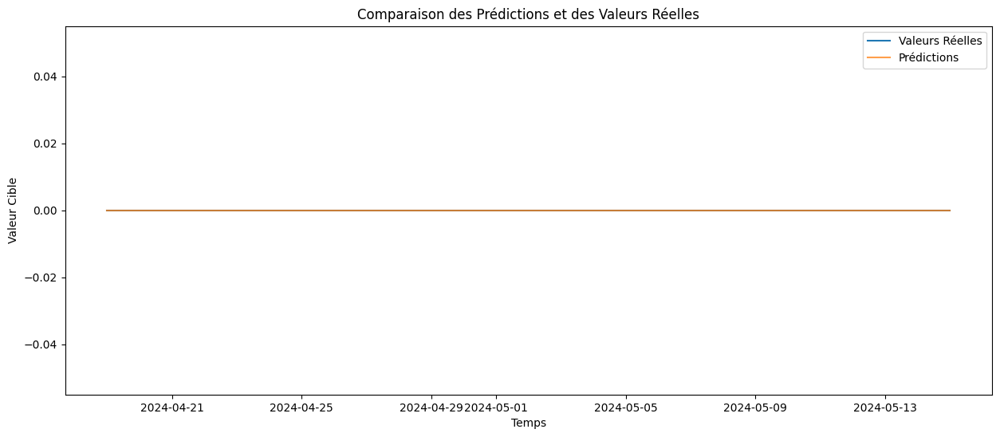

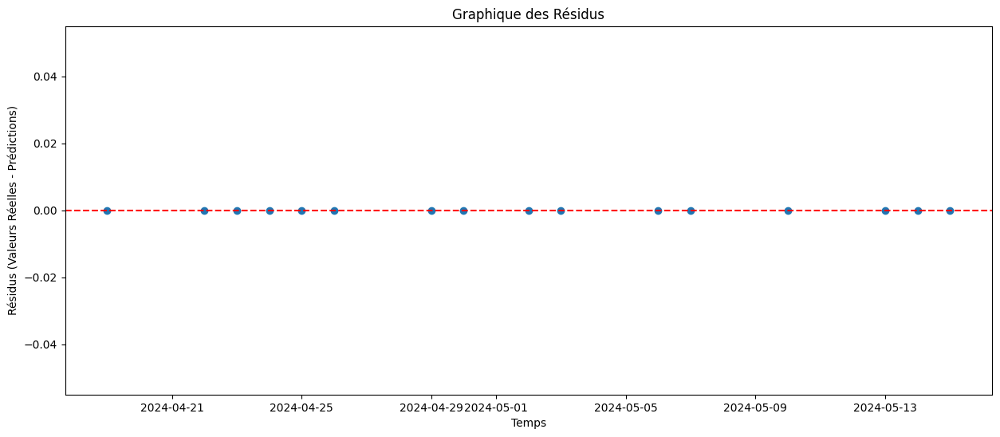

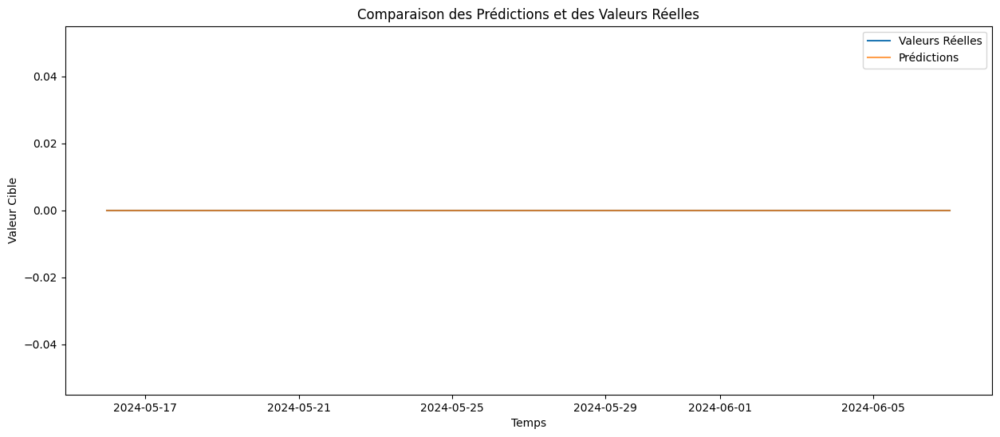

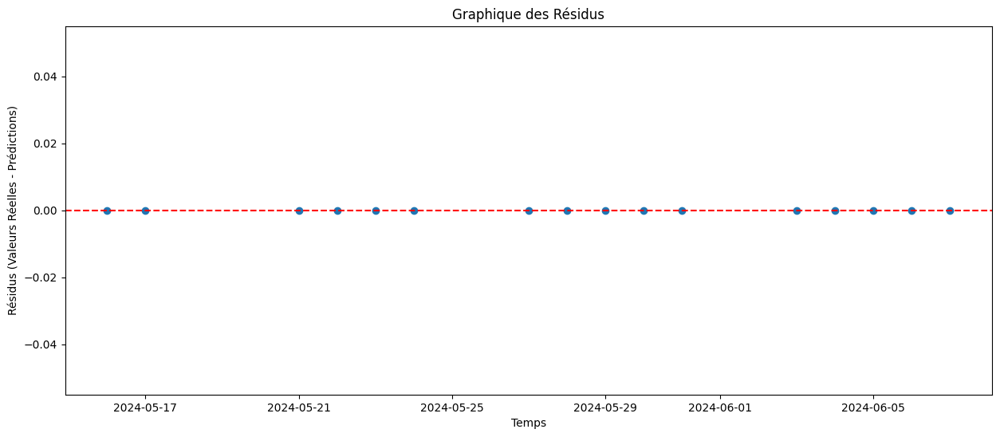

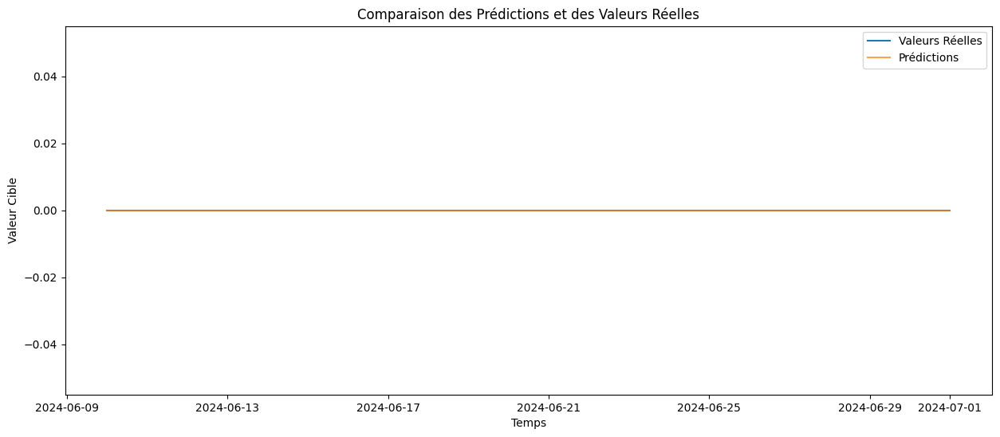

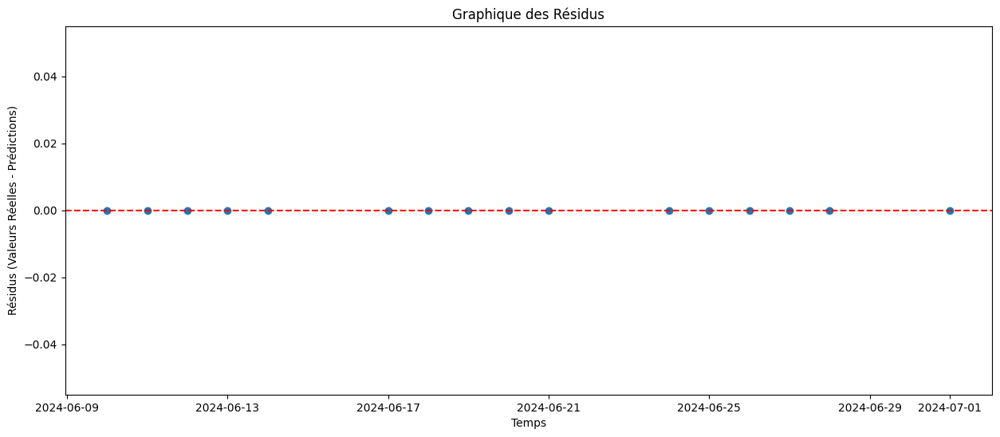

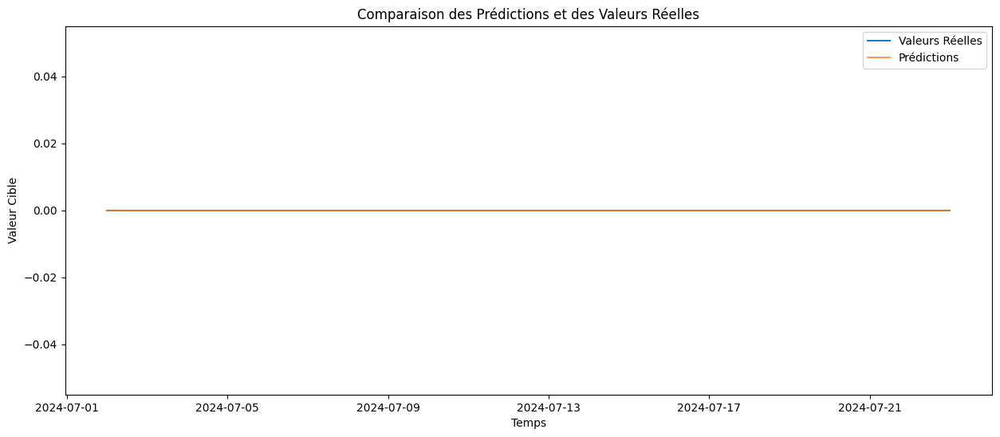

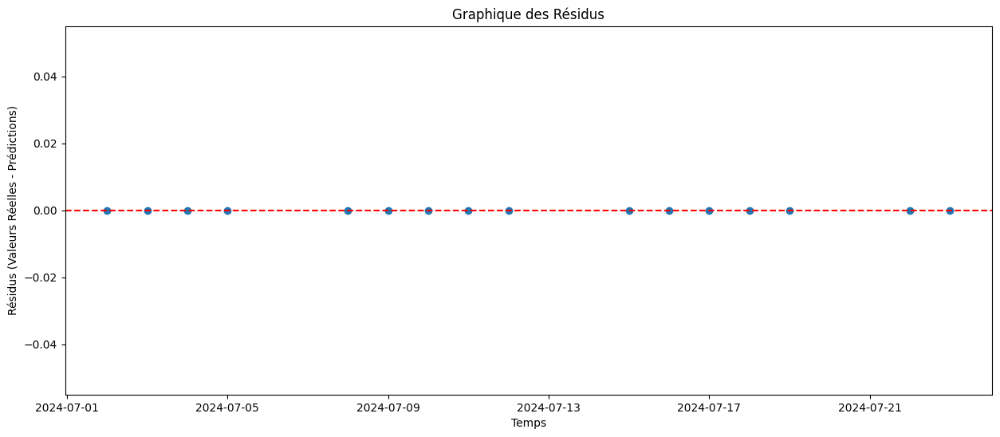

Rolling Window Analysis Average MSE for LNLOA_Collec: 0.0
Processing series: LNTI2_Collec
Temporal Cross-Validation Average MSE for LNTI2_Collec: 0.0
Enhanced Resampling MSE for LNTI2_Collec: 0.0
Ensemble MSE with Varied Historical Contexts for LNTI2_Collec: 0.0
Average MSE with Cross-Validation on Shuffled Data for LNTI2_Collec: 0.0


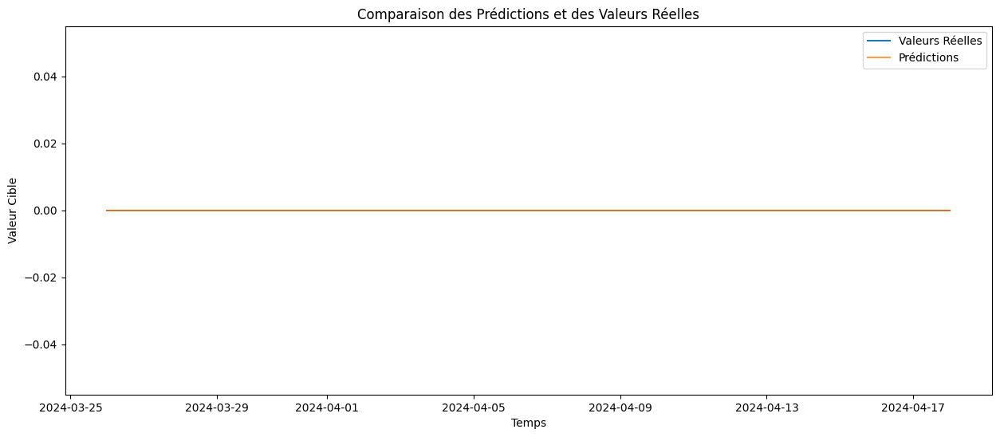

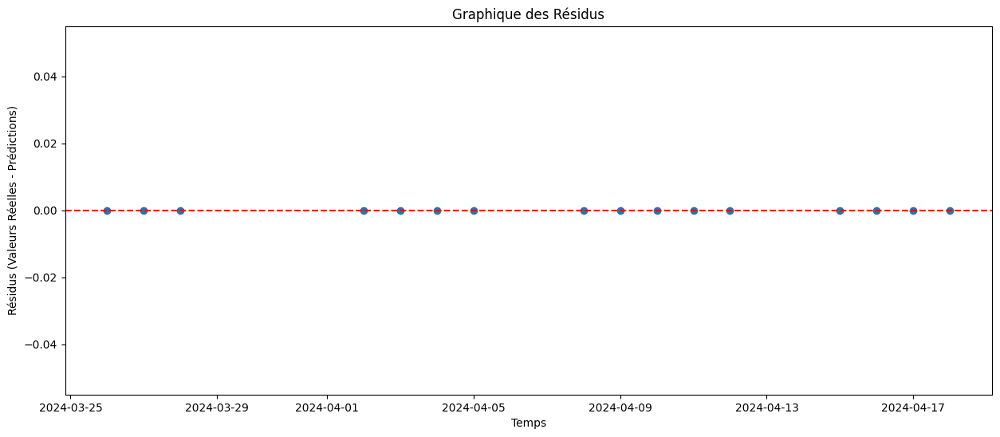

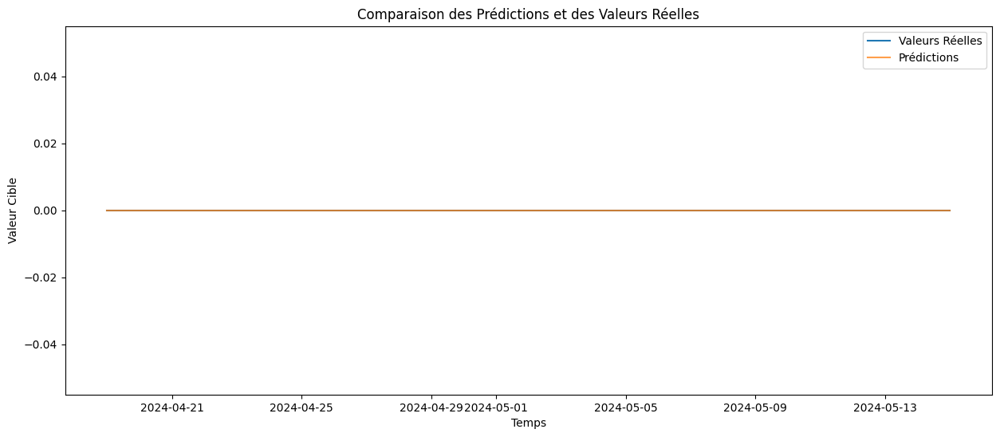

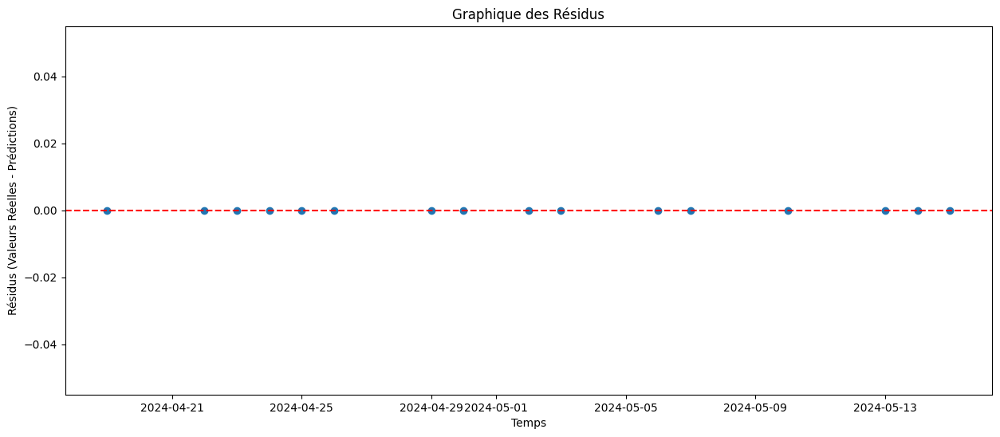

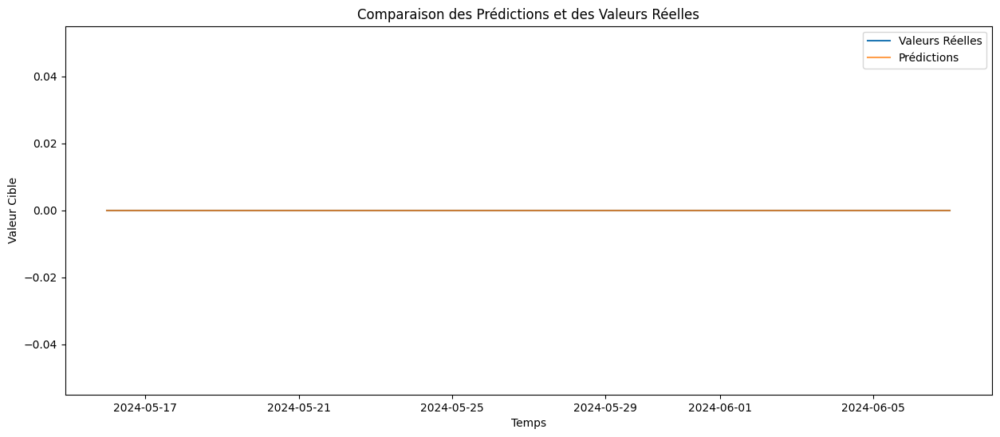

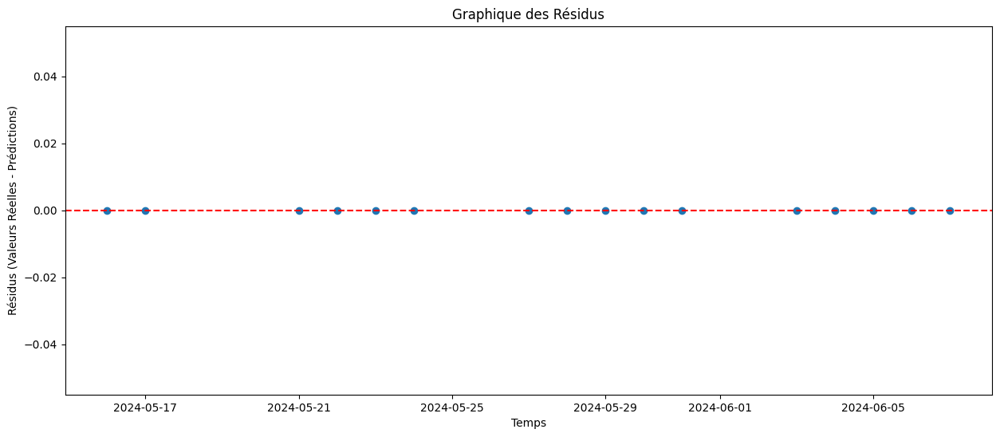

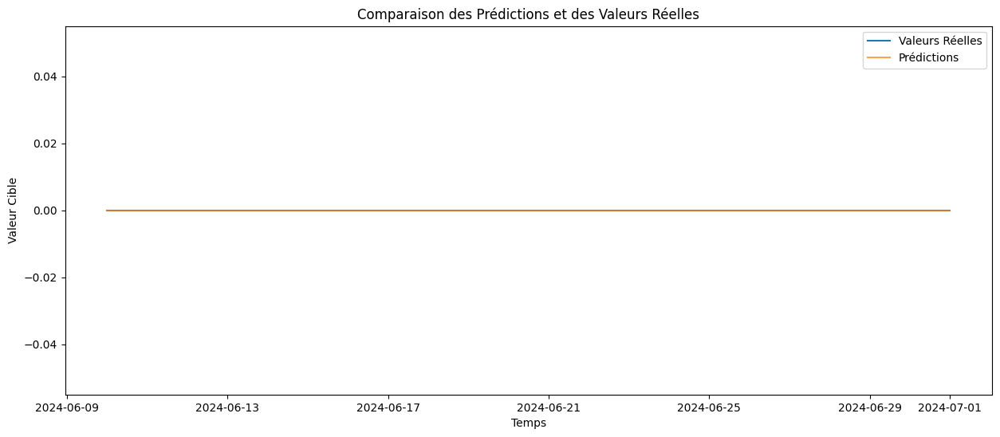

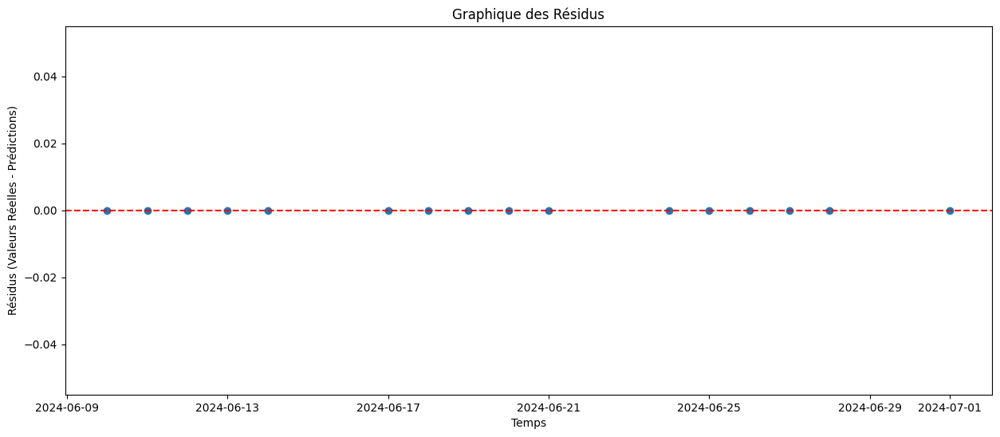

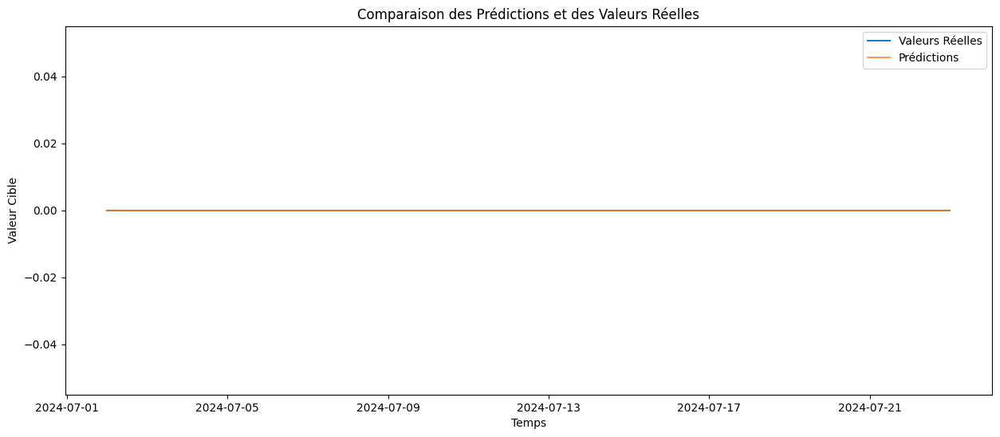

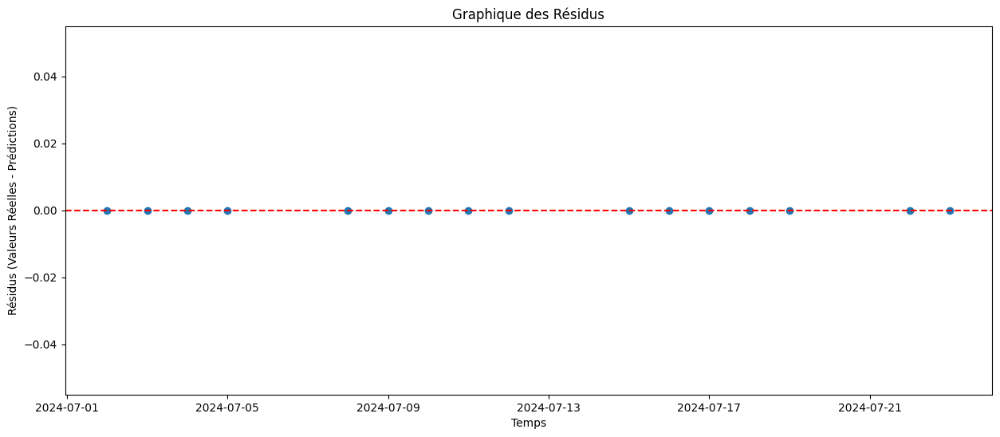

Rolling Window Analysis Average MSE for LNTI2_Collec: 0.0
Processing series: LNT2N_Collec
Temporal Cross-Validation Average MSE for LNT2N_Collec: 2520419516297023.0
Enhanced Resampling MSE for LNT2N_Collec: 876205475346518.9
Ensemble MSE with Varied Historical Contexts for LNT2N_Collec: 1078096547866790.8
Average MSE with Cross-Validation on Shuffled Data for LNT2N_Collec: 2936009663190247.0


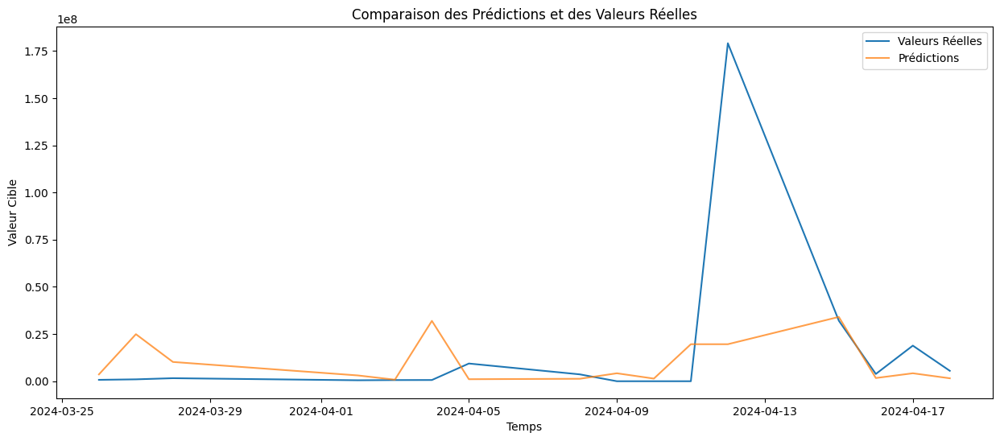

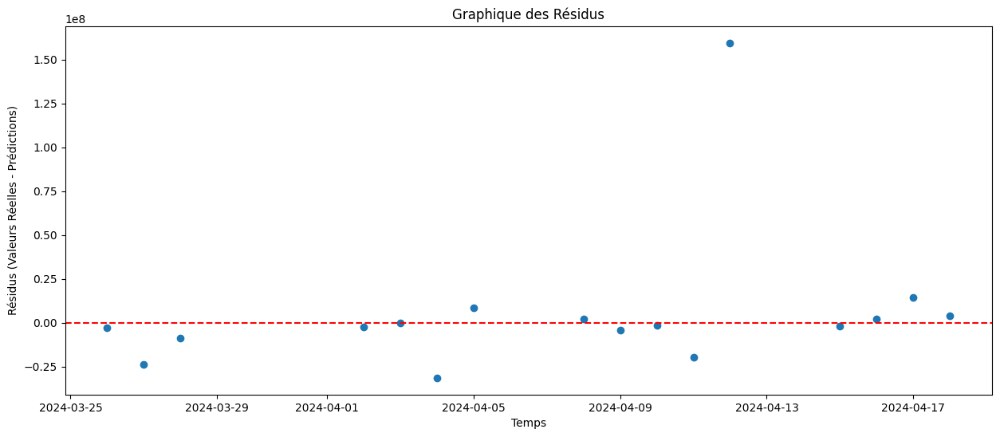

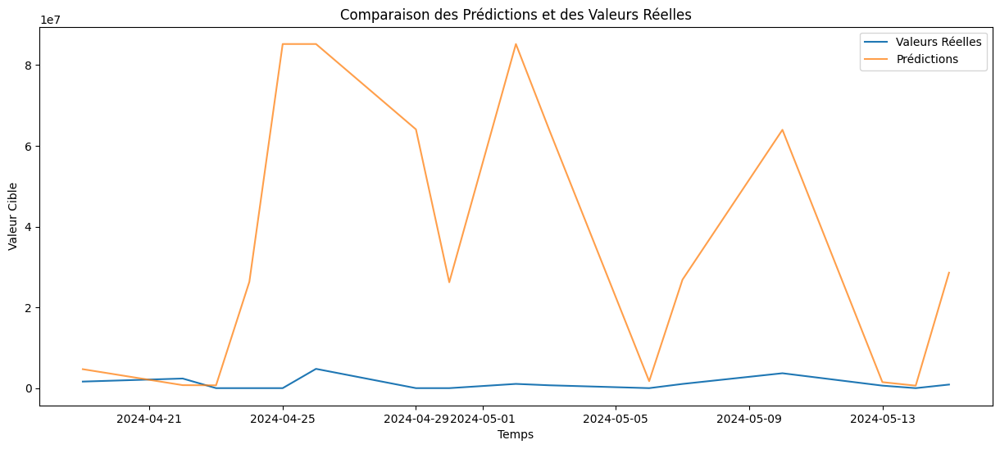

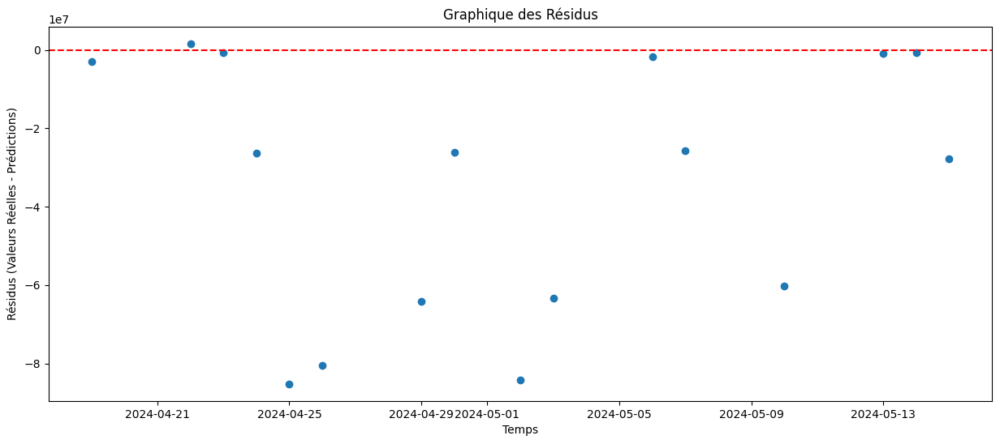

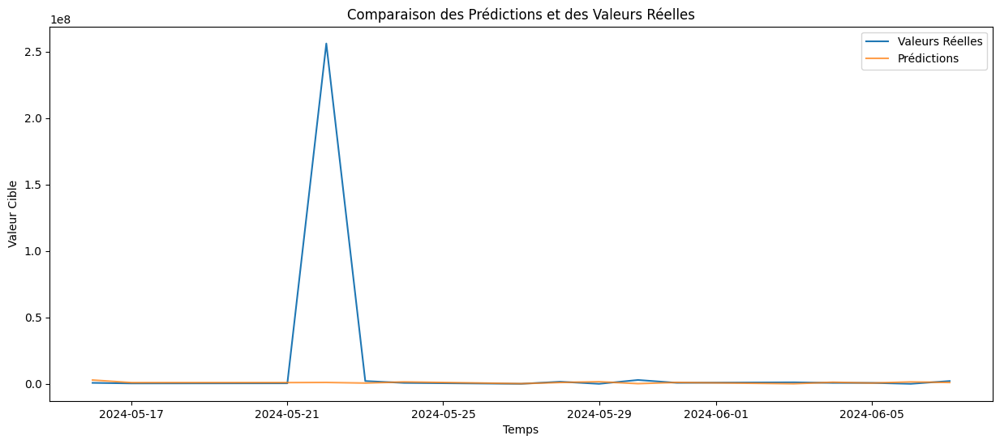

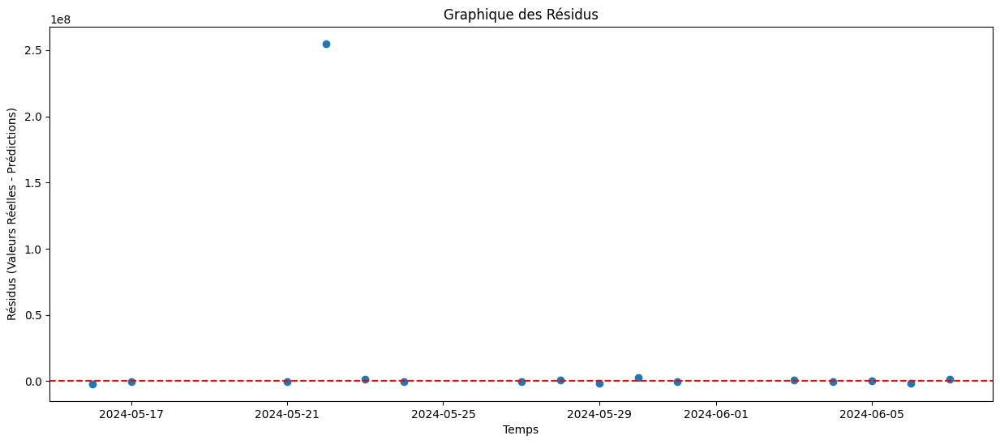

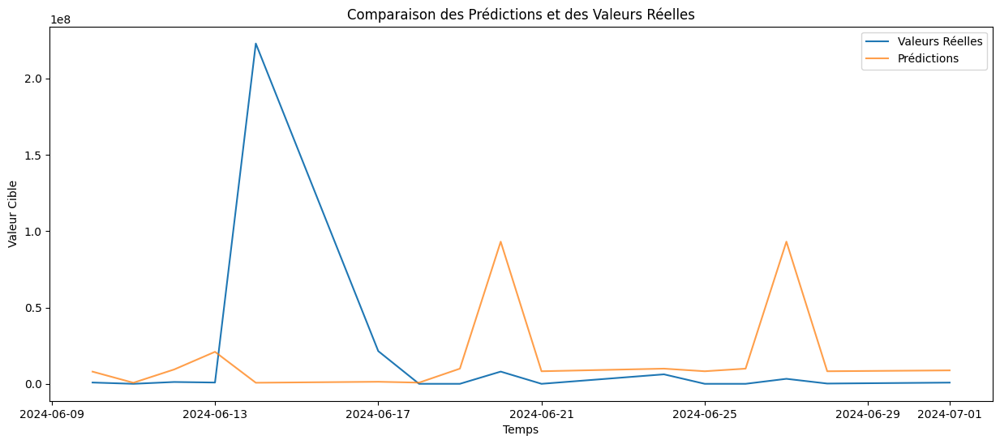

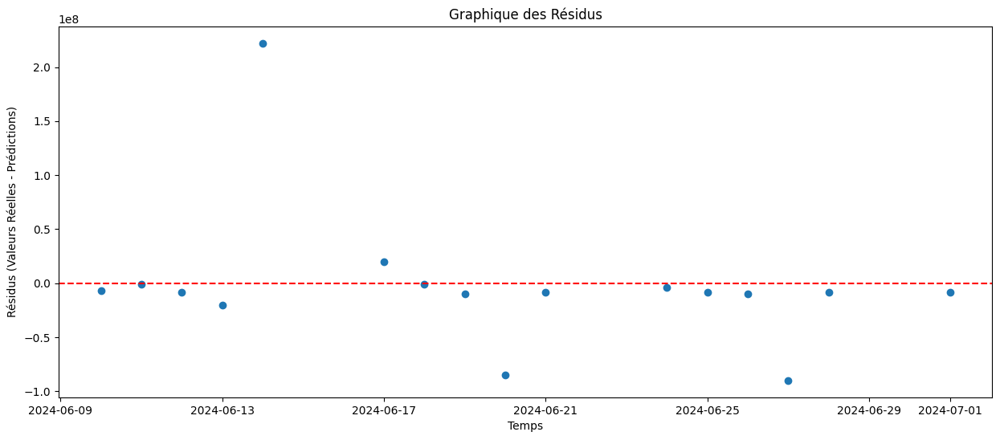

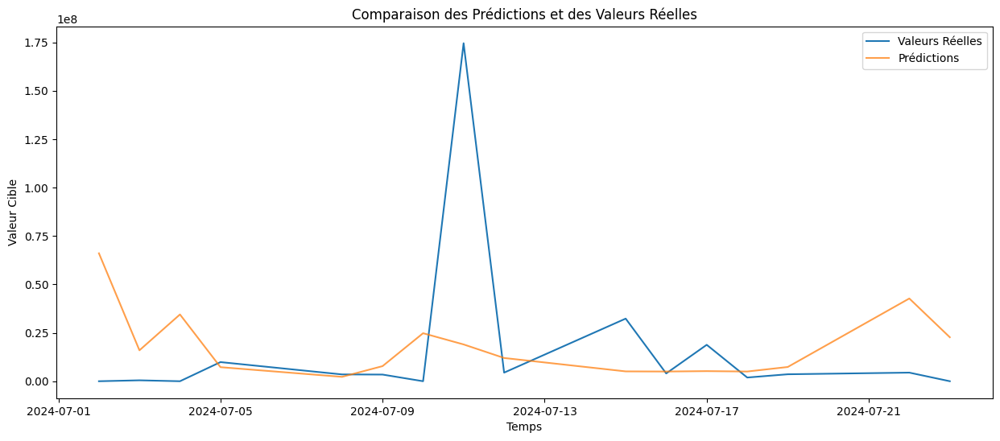

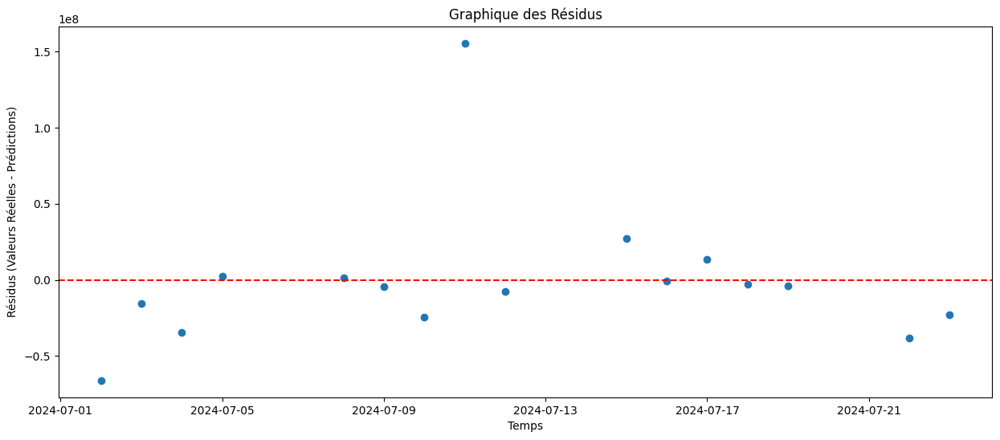

Rolling Window Analysis Average MSE for LNT2N_Collec: 2849326050764341.5
Processing series: LNT2E_Collec
Temporal Cross-Validation Average MSE for LNT2E_Collec: 0.0
Enhanced Resampling MSE for LNT2E_Collec: 0.0
Ensemble MSE with Varied Historical Contexts for LNT2E_Collec: 0.0
Average MSE with Cross-Validation on Shuffled Data for LNT2E_Collec: 0.0


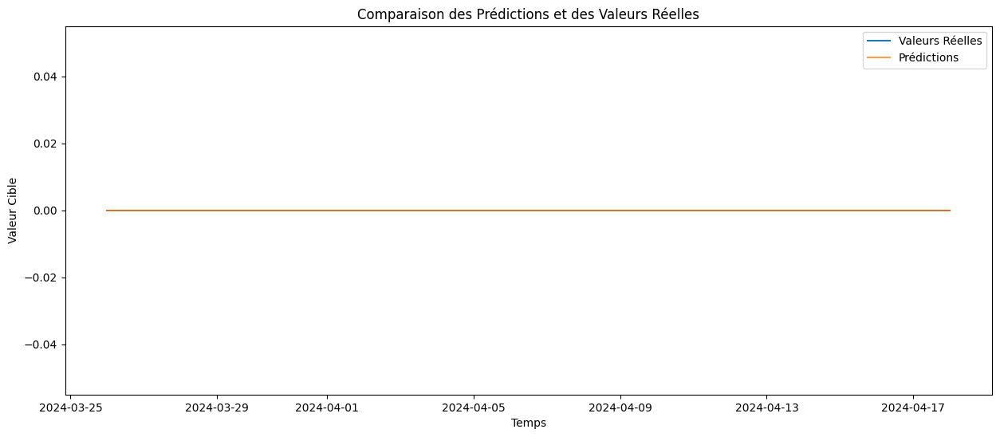

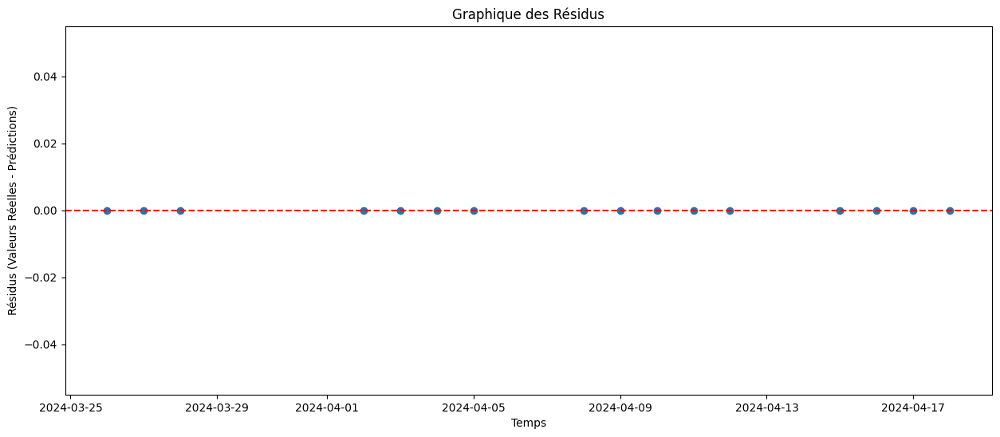

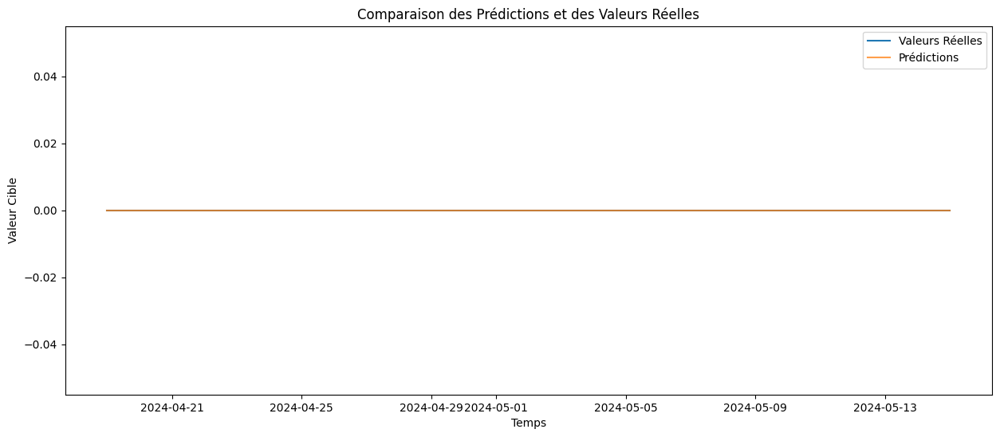

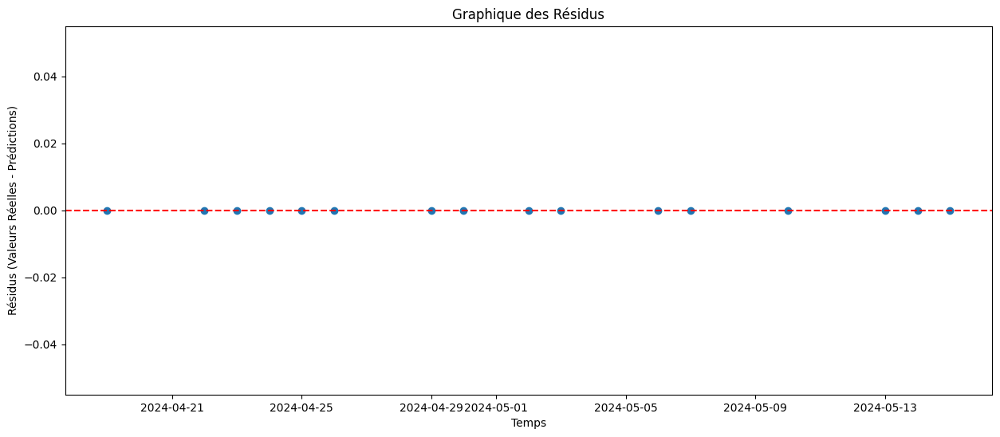

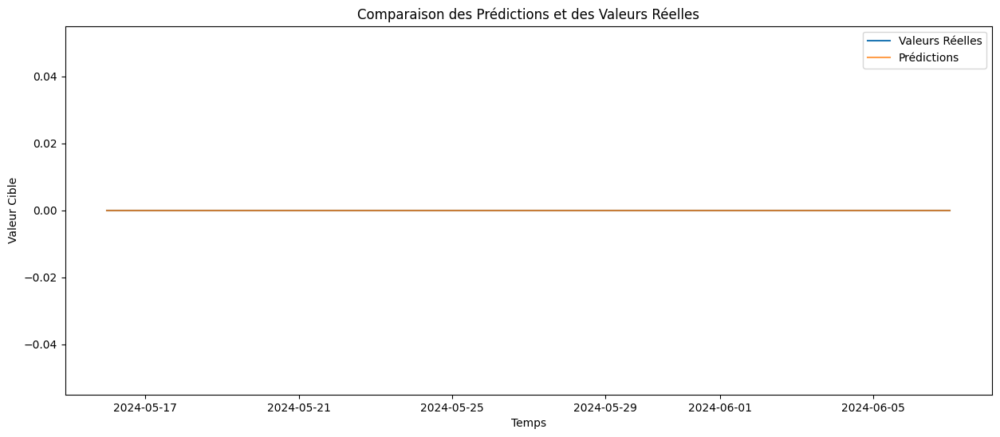

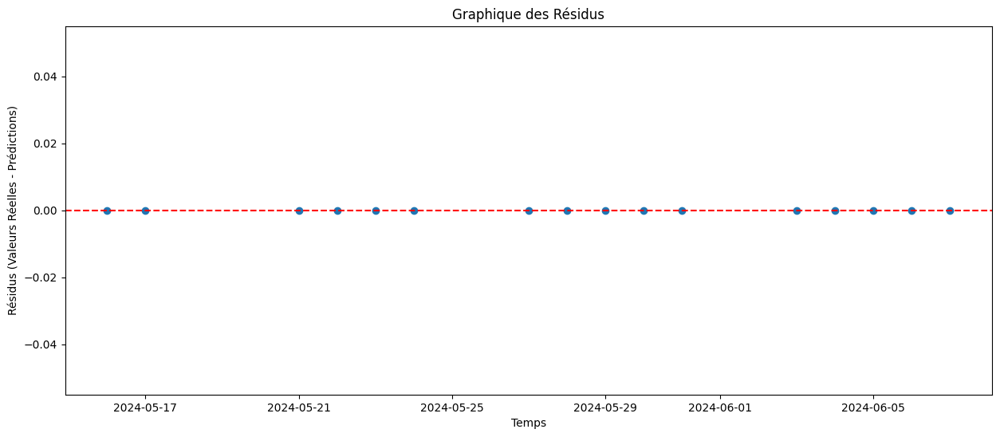

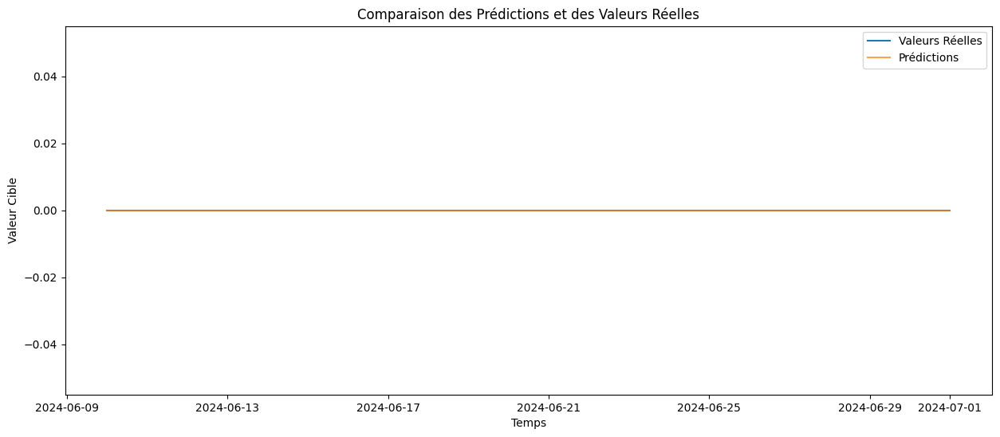

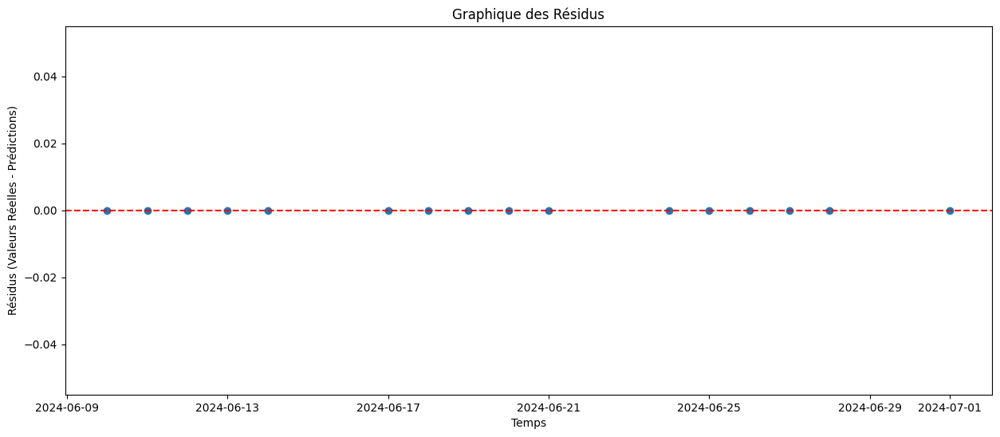

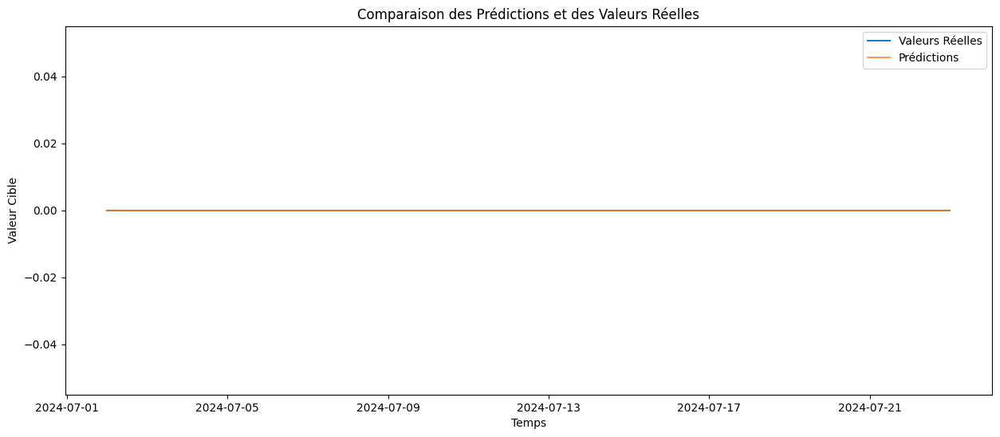

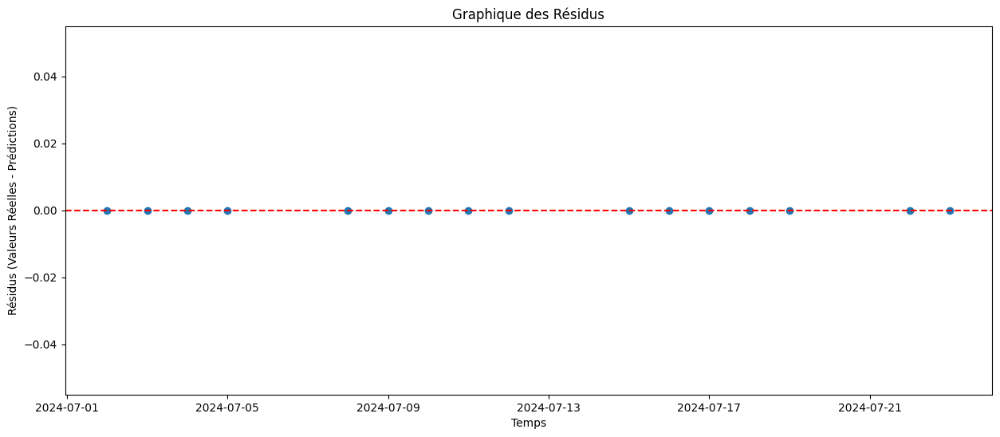

Rolling Window Analysis Average MSE for LNT2E_Collec: 0.0
Processing series: LNTI3_Collec
Temporal Cross-Validation Average MSE for LNTI3_Collec: 188732460111469.88
Enhanced Resampling MSE for LNTI3_Collec: 108275215044565.86
Ensemble MSE with Varied Historical Contexts for LNTI3_Collec: 52809961531189.96
Average MSE with Cross-Validation on Shuffled Data for LNTI3_Collec: 158256367307446.56


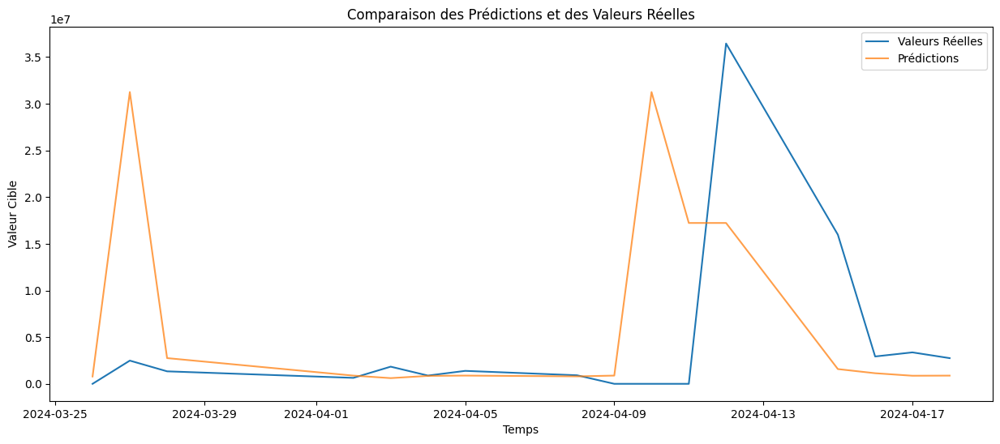

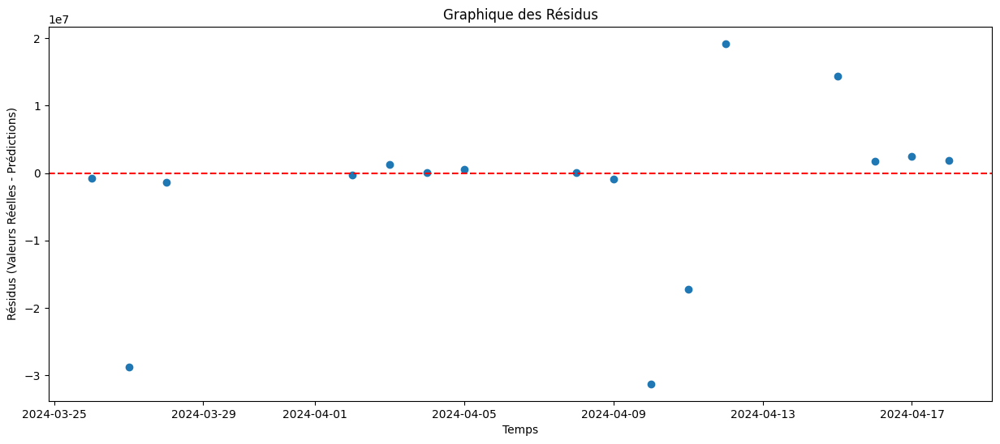

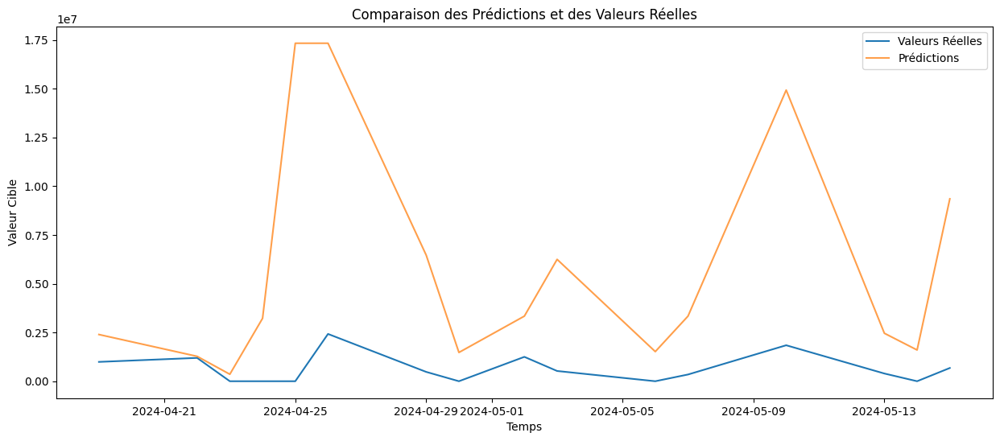

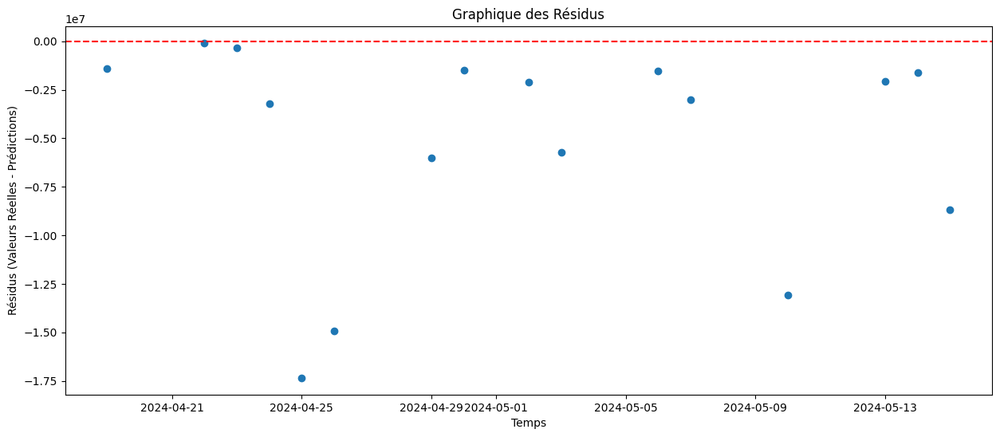

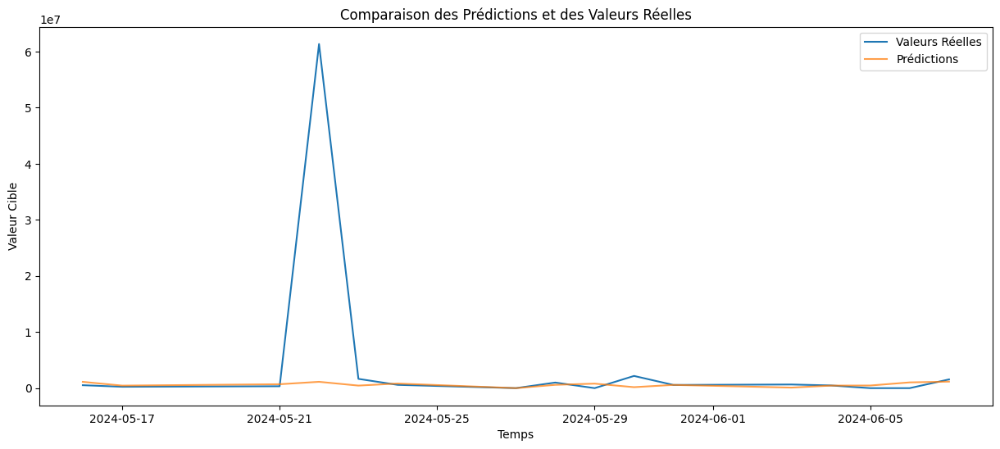

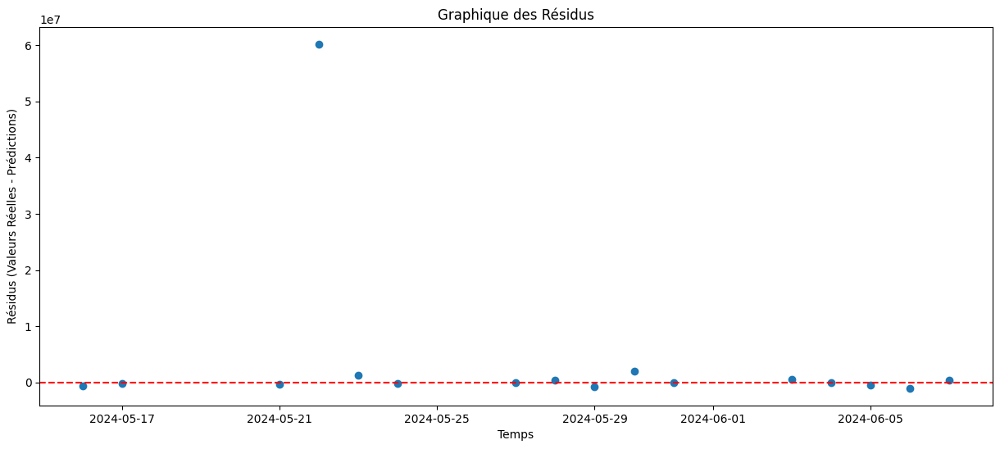

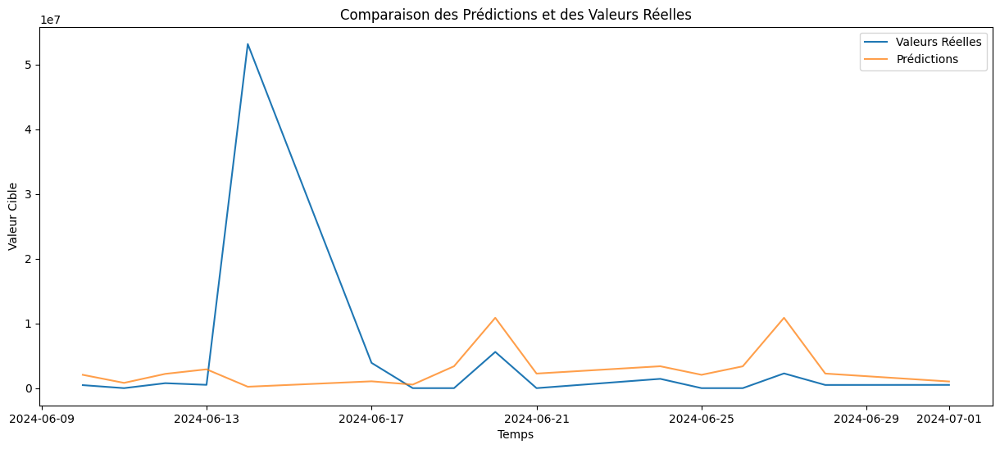

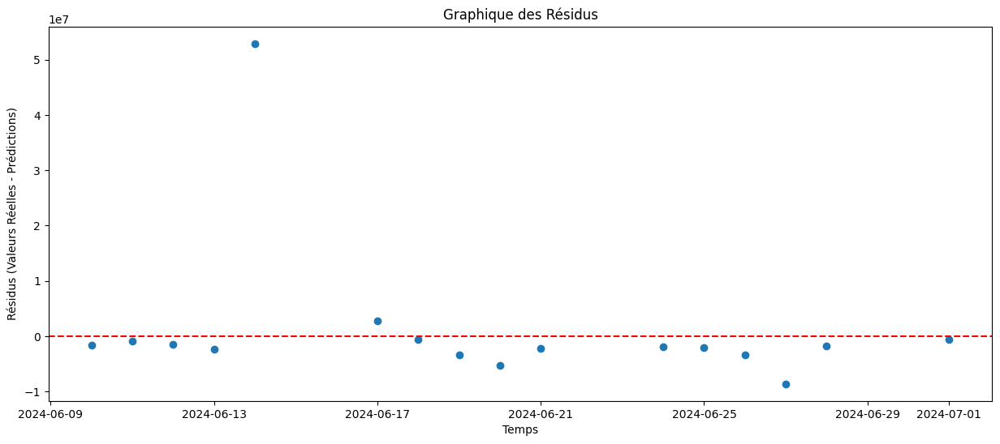

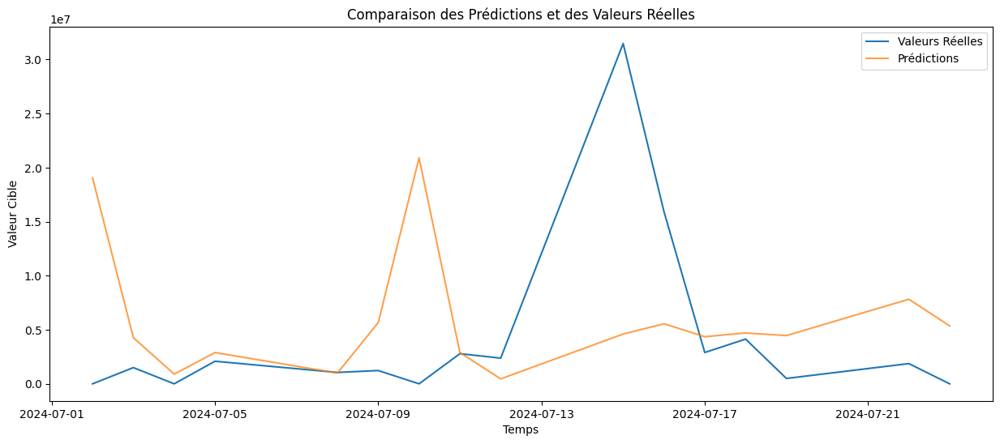

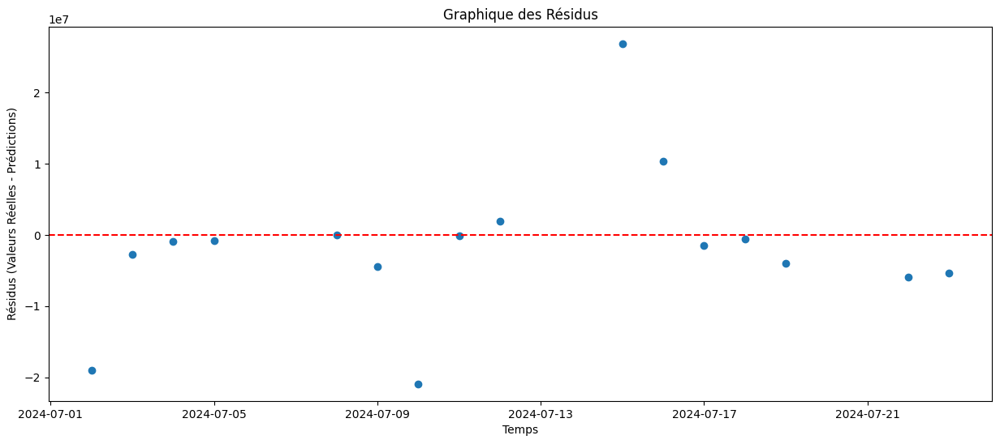

Rolling Window Analysis Average MSE for LNTI3_Collec: 148931848388475.25
Processing series: LNTIC_Collec
Temporal Cross-Validation Average MSE for LNTIC_Collec: 6163010025401.115
Enhanced Resampling MSE for LNTIC_Collec: 6697725170353.373
Ensemble MSE with Varied Historical Contexts for LNTIC_Collec: 5219818453790.502
Average MSE with Cross-Validation on Shuffled Data for LNTIC_Collec: 5965434448506.784


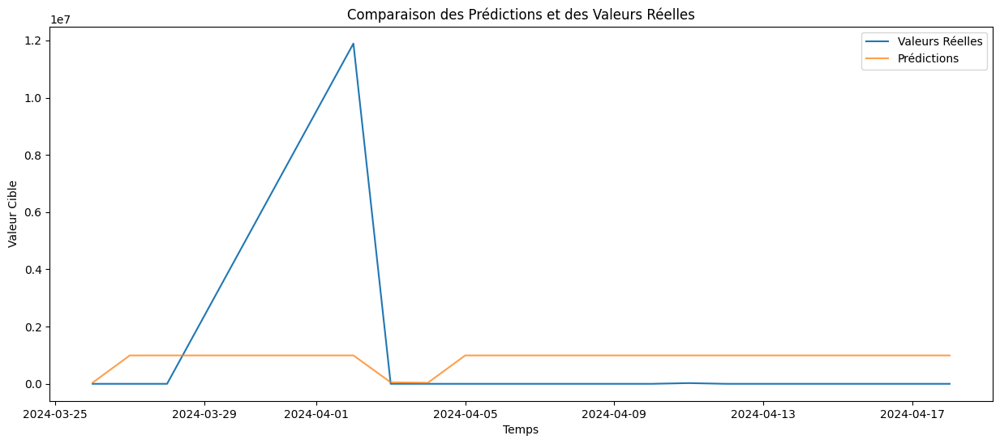

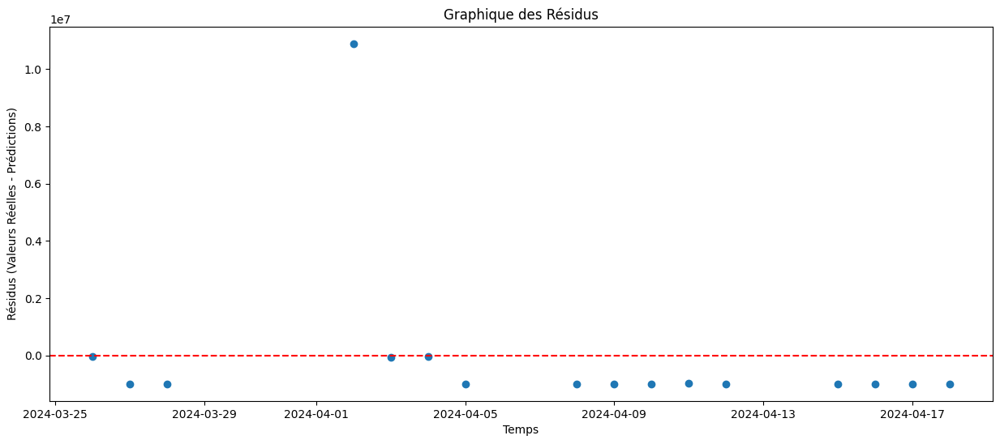

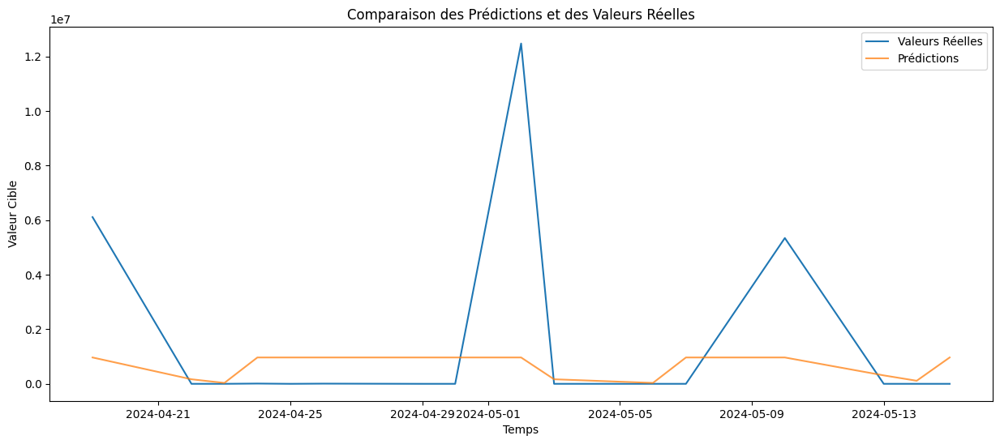

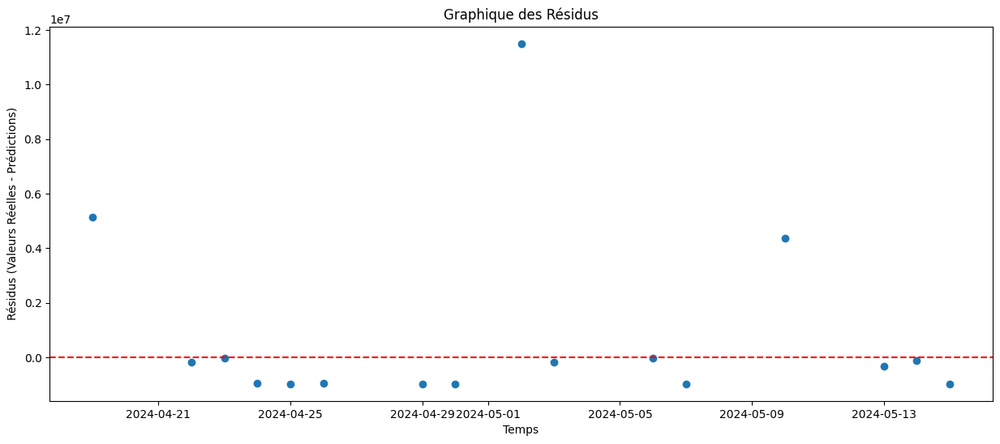

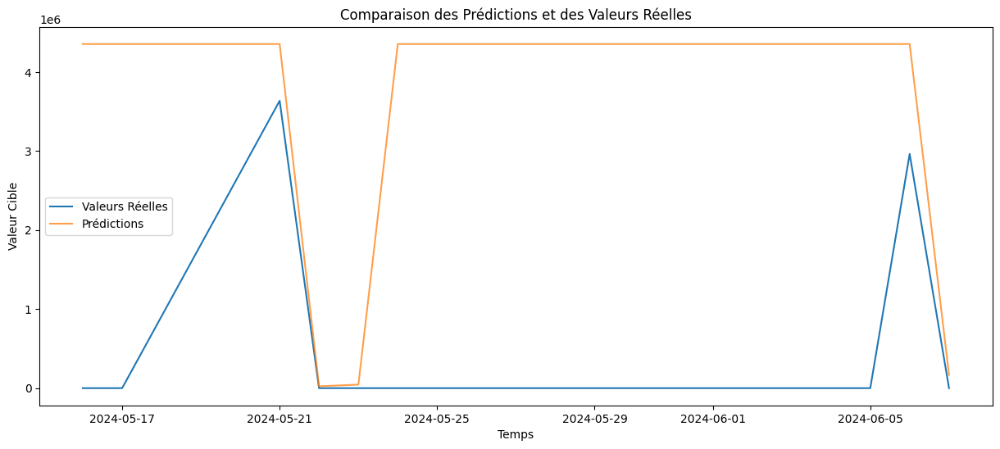

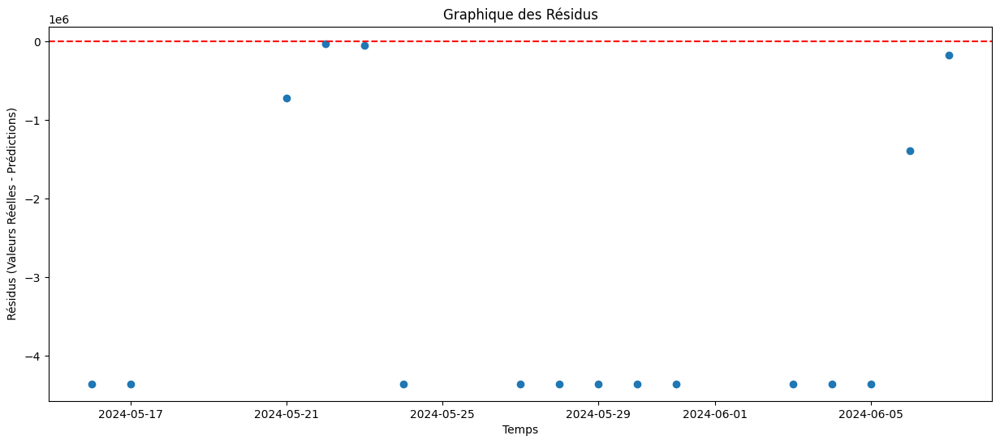

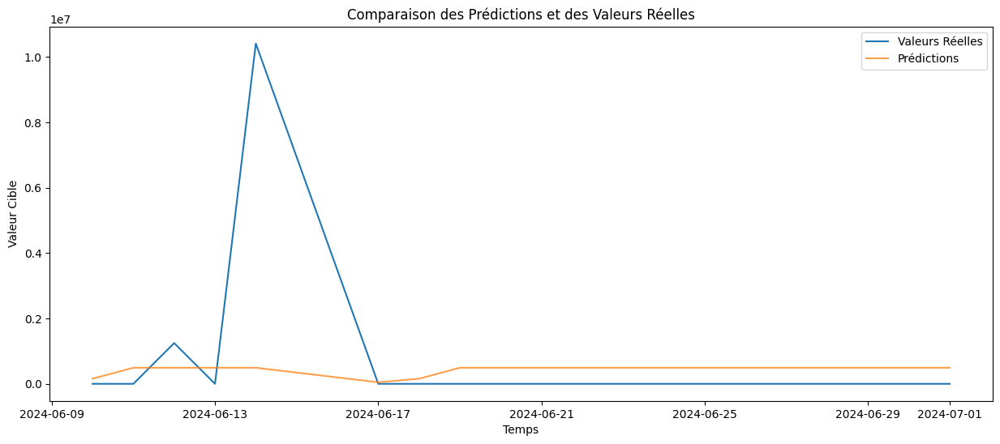

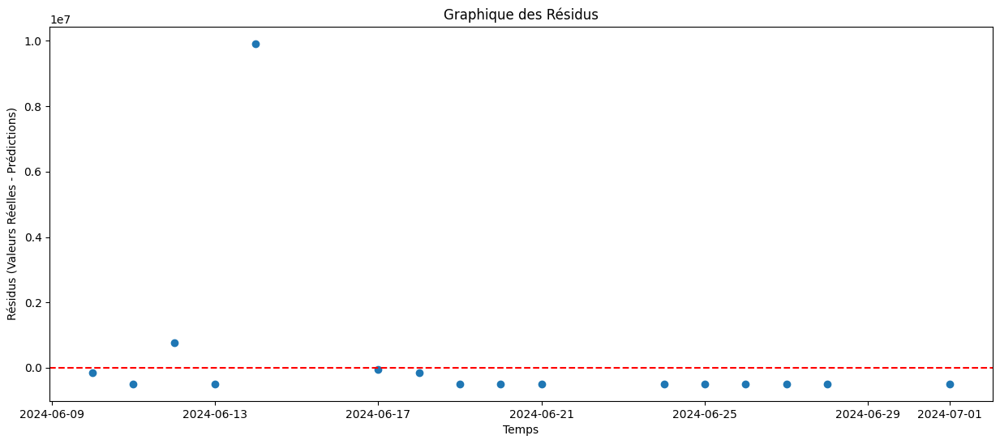

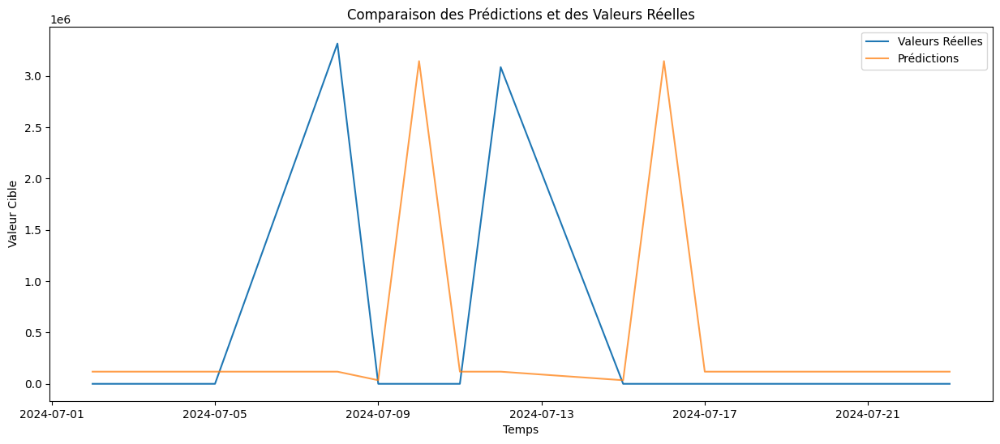

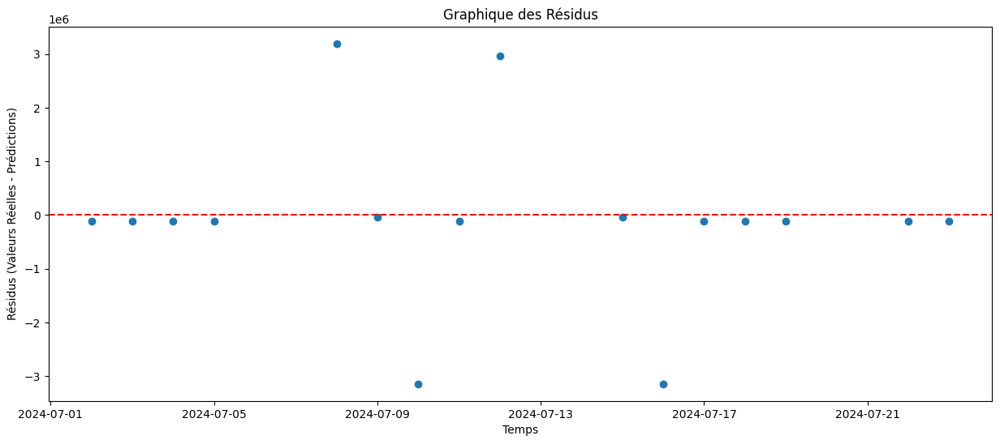

Rolling Window Analysis Average MSE for LNTIC_Collec: 8337191714140.05

Metrics for LNACT_Collec:
Temporal CV MSE: 18875012269182.6797
Enhanced Resampling MSE: 19028602312973.7969
Ensemble Historical Contexts MSE: 13989289618652.1074
Shuffled CV MSE: 22683372148456.6367
Rolling Window MSE: 20566155863926.5508

Metrics for LNAAE_Collec:
Temporal CV MSE: 1526642539355.1001
Enhanced Resampling MSE: 582179368518.8917
Ensemble Historical Contexts MSE: 1440216309803.6843
Shuffled CV MSE: 1874225347809.3516
Rolling Window MSE: 1609692563685.2229

Metrics for LNATO_Collec:
Temporal CV MSE: 9690900281071.3320
Enhanced Resampling MSE: 12965409052455.1484
Ensemble Historical Contexts MSE: 8572430823814.7139
Shuffled CV MSE: 9175755307325.7656
Rolling Window MSE: 9712513387403.9883

Metrics for LNAT2_Collec:
Temporal CV MSE: 78542025266.1179
Enhanced Resampling MSE: 87204276614.0126
Ensemble Historical Contexts MSE: 69496455682.6152
Shuffled CV MSE: 73136588545.6109
Rolling Window MSE: 83580895048

In [161]:
import numpy as np 
import pandas as pd
from sklearn.model_selection import TimeSeriesSplit, train_test_split, cross_val_score, KFold
from sklearn.ensemble import RandomForestRegressor, IsolationForest
from sklearn.metrics import mean_squared_error, mean_absolute_error
import matplotlib.pyplot as plt
from sklearn.utils import shuffle

# Load the data from the Excel file
file_path = 'P:/CALYX/Cash_Securitisation_Optimisation_20240722.xlsx'
df = pd.read_excel(file_path, sheet_name='Gestion Cash', header=None)

# Extract the relevant parts of the dataframe
series_names_it = df.iloc[32:67, 0].values

# Extract the time series and data series
time_series = df.iloc[4, 10:113]  # Columns K (index 10) to DH (index 113)
data_series_it = df.iloc[32:67, 10:113]  # Rows 33 to 67 (index 32 to 66), columns K (index 10) to DH (index 113)

# Convert the data to a DataFrame with time as the index
data_series_it.columns = time_series.values
data_series_it.index = series_names_it  # Adjust the index to match the original rows

# Transpose the DataFrame and convert the index to datetime
data_series_it = data_series_it.T
data_series_it.index = pd.to_datetime(data_series_it.index, format='%Y-%m-%d')

# Function to create lagged features
def create_lagged_features(df, n_lags=2):
    df_transformed = pd.DataFrame(index=df.index)
    df_transformed['y'] = df['Close']
    for i in range(1, n_lags + 1):
        df_transformed[f'Lag_{i}'] = df['Close'].shift(i)
    df_transformed.dropna(inplace=True)
    return df_transformed

# Function to perform temporal cross-validation with feature engineering
def temporal_cross_validation(X, y, n_splits=5):
    tscv = TimeSeriesSplit(n_splits=n_splits)
    mse_scores = []
    for train_index, test_index in tscv.split(X):
        X_train, X_test = X.iloc[train_index], X.iloc[test_index]
        y_train, y_test = y.iloc[train_index], y.iloc[test_index]
        model = RandomForestRegressor(n_estimators=100, random_state=42)
        model.fit(X_train, y_train)
        predictions = model.predict(X_test)
        mse = mean_squared_error(y_test, predictions)
        mse_scores.append(mse)
    return np.mean(mse_scores)

# Function to perform enhanced resampling with anomaly detection
def enhanced_resampling(X, y):
    iso_forest = IsolationForest(n_estimators=100, contamination=0.05, random_state=42)
    anomalies = iso_forest.fit_predict(X)
    anomaly_indices = np.where(anomalies == -1)[0]
    X_anomalous = X.iloc[anomaly_indices]
    y_anomalous = y.iloc[anomaly_indices]
    X_resampled = pd.concat([X, X_anomalous])
    y_resampled = pd.concat([y, y_anomalous])
    X_resampled, y_resampled = shuffle(X_resampled, y_resampled, random_state=42)
    X_train, X_test, y_train, y_test = train_test_split(X_resampled, y_resampled, test_size=0.2, shuffle=False)
    model = RandomForestRegressor(n_estimators=100, random_state=42)
    model.fit(X_train, y_train)
    predictions = model.predict(X_test)
    mse = mean_squared_error(y_test, predictions)
    return mse

# Function to perform ensemble learning with varied historical contexts
def ensemble_historical_contexts(X, y, contexts):
    model_predictions = []
    for context in contexts:
        split_point = int(len(X) * context)
        X_train_context, y_train_context = X.iloc[:split_point], y.iloc[:split_point]
        model = RandomForestRegressor(n_estimators=100, random_state=42)
        model.fit(X_train_context, y_train_context)
        predictions = model.predict(X)
        model_predictions.append(predictions)
    ensemble_predictions = np.mean(model_predictions, axis=0)
    ensemble_mse = mean_squared_error(y, ensemble_predictions)
    return ensemble_mse

# Function to perform cross-validation on shuffled data
def cross_validation_shuffled(X, y):
    X_shuffled, y_shuffled = shuffle(X, y, random_state=42)
    model = RandomForestRegressor(n_estimators=100, random_state=42)
    cv = KFold(n_splits=5, shuffle=False)
    scores = cross_val_score(model, X_shuffled, y_shuffled, cv=cv, scoring='neg_mean_squared_error')
    average_mse = np.mean(-scores)
    return average_mse

# Function to perform rolling window analysis
def rolling_window_analysis(X, y, n_splits=5):
    window_size = len(X) // (n_splits + 1)
    tscv = TimeSeriesSplit(n_splits=n_splits, max_train_size=window_size)
    mse_scores = []
    for train_index, test_index in tscv.split(X):
        X_train, X_test = X.iloc[train_index], X.iloc[test_index]
        y_train, y_test = y.iloc[train_index], y.iloc[test_index]
        model = RandomForestRegressor(n_estimators=100, random_state=42)
        model.fit(X_train, y_train)
        predictions = model.predict(X_test)
        mse = mean_squared_error(y_test, predictions)
        mse_scores.append(mse)
        plt.figure(figsize=(15, 6))
        plt.plot(y_test.index, y_test, label='Valeurs Réelles')
        plt.plot(y_test.index, predictions, label='Prédictions', alpha=0.75)
        plt.title('Comparaison des Prédictions et des Valeurs Réelles')
        plt.xlabel('Temps')
        plt.ylabel('Valeur Cible')
        plt.legend()
        plt.show()
        residuals = y_test - predictions
        plt.figure(figsize=(15, 6))
        plt.plot(y_test.index, residuals, marker='o', linestyle='')
        plt.title('Graphique des Résidus')
        plt.xlabel('Temps')
        plt.ylabel('Résidus (Valeurs Réelles - Prédictions)')
        plt.axhline(y=0, color='r', linestyle='--')
        plt.show()
    return np.mean(mse_scores)

# Perform all evaluations for each series in data_series_it
results = {}

for series_name in data_series_it.columns:
    print(f'Processing series: {series_name}')
    df_series = data_series_it[[series_name]].rename(columns={series_name: 'Close'})
    df_transformed = create_lagged_features(df_series, n_lags=2)
    X = df_transformed.drop('y', axis=1).astype(float)
    y = df_transformed['y'].astype(float)
    
    # Temporal cross-validation
    tcv_mse = temporal_cross_validation(X, y)
    print(f"Temporal Cross-Validation Average MSE for {series_name}: {tcv_mse}")
    
    # Enhanced resampling
    enhanced_mse = enhanced_resampling(X, y)
    print(f"Enhanced Resampling MSE for {series_name}: {enhanced_mse}")
    
    # Ensemble with varied historical contexts
    contexts = [0.5, 0.75, 1.0]
    ensemble_mse = ensemble_historical_contexts(X, y, contexts)
    print(f"Ensemble MSE with Varied Historical Contexts for {series_name}: {ensemble_mse}")
    
    # Cross-validation on shuffled data
    shuffled_cv_mse = cross_validation_shuffled(X, y)
    print(f"Average MSE with Cross-Validation on Shuffled Data for {series_name}: {shuffled_cv_mse}")
    
    # Rolling window analysis
    rolling_mse = rolling_window_analysis(X, y)
    print(f"Rolling Window Analysis Average MSE for {series_name}: {rolling_mse}")
    
    results[series_name] = {
        'Temporal CV MSE': tcv_mse,
        'Enhanced Resampling MSE': enhanced_mse,
        'Ensemble Historical Contexts MSE': ensemble_mse,
        'Shuffled CV MSE': shuffled_cv_mse,
        'Rolling Window MSE': rolling_mse
    }

# Display the results
for series_name, metrics in results.items():
    print(f"\nMetrics for {series_name}:")
    for metric, value in metrics.items():
        print(f"{metric}: {value:.4f}")


Given the context of evaluating resampling methods for a time series dataset of AAPL stock prices over 2 years, a suitable advanced technique that could be considered is Leave-Future-Out Cross-Validation (LFOCV). This method is an adaptation of Leave-One-Out Cross-Validation (LOOCV) tailored for time series data, ensuring the temporal order is preserved and future data is not used inappropriately during model training.

# Leave-Future-Out Cross-Validation (LFOCV)
LFOCV systematically leaves out a portion of the "future" data in the dataset for testing, training the model on the "past" data. This process repeats such that each "future" point (or block of points) serves as a test set exactly once. This approach is particularly well-suited for time series forecasting as it respects the chronological sequence of data, crucial for maintaining model validity.

Implementation with Random Forest in Python The Python example below illustrates how to implement LFOCV with a Random Forest model for forecasting AAPL stock prices. It assumes that X contains features derived from the stock price data, such as lagged prices, moving averages, etc., and y is the target variable (e.g., the closing price).

Evaluation and Impact
Advantages:
Temporal Integrity: LFOCV respects the time series' chronological order, crucial for accurate forecasting. Model Performance Insight: Provides a granular view of how the model performs as it incrementally learns from more data.

Considerations:
Computational Intensity: Especially for larger datasets, LFOCV can be computationally demanding due to the high number of training cycles. Sensitivity to Noise: Given the iterative nature, the model's performance might be more sensitive to noise in the data at specific points.

Conclusion
Leave-Future-Out Cross-Validation offers a rigorous and time-respecting method for evaluating the performance of forecasting models on time series datasets, such as stock prices. By carefully implementing LFOCV and analyzing its outcomes, practitioners can gain valuable insights into the temporal dynamics of their models, ensuring that forecasts are both accurate and reliable. This method underscores the importance of methodical evaluation in developing robust forecasting models for financial time series data.

For the AAPL stock price dataset covering 2 years of historical data, a resampling method that can be particularly effective is Subsampling with a Sliding Window. This method is tailored for time series forecasting, allowing models to train on various segments of the data to capture different temporal patterns and trends.

# Subsampling with a Sliding Window
This approach involves creating multiple, overlapping training sets (windows) that move forward in time, each of which is used to train a separate model. Predictions from these models can then be aggregated to form a final forecast. This method enables the model to learn from and adapt to changes in the data's underlying behavior over time.

Implementation with Random Forest in Python Here's how to implement Subsampling with a Sliding Window using a Random Forest regressor for the AAPL stock price forecasting task:

Processing series: LNACT_Collec
Rolling Window Analysis Overall MSE for LNACT_Collec: 15760766788516.27
Processing series: LNAAE_Collec
Rolling Window Analysis Overall MSE for LNAAE_Collec: 1152341772096.346
Processing series: LNATO_Collec
Rolling Window Analysis Overall MSE for LNATO_Collec: 9812650988922.252
Processing series: LNAT2_Collec
Rolling Window Analysis Overall MSE for LNAT2_Collec: 76297062191.01514
Processing series: LNACC_Collec
Rolling Window Analysis Overall MSE for LNACC_Collec: 55672344914575.74
Processing series: LNACE_Collec
Rolling Window Analysis Overall MSE for LNACE_Collec: 0.0
Processing series: LNAC3_Collec
Rolling Window Analysis Overall MSE for LNAC3_Collec: 0.0
Processing series: LNAC4_Collec
Rolling Window Analysis Overall MSE for LNAC4_Collec: 0.0
Processing series: LNAC6_Collec
Rolling Window Analysis Overall MSE for LNAC6_Collec: 117000057.58620833
Processing series: LNDOL_Collec
Rolling Window Analysis Overall MSE for LNDOL_Collec: 1669718718779.4646


c:\Users\UT3NDP\My_IT_Applications\test_gitlab\venv\Lib\site-packages\numpy\core\fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
c:\Users\UT3NDP\My_IT_Applications\test_gitlab\venv\Lib\site-packages\numpy\core\_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
c:\Users\UT3NDP\My_IT_Applications\test_gitlab\venv\Lib\site-packages\numpy\core\fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
c:\Users\UT3NDP\My_IT_Applications\test_gitlab\venv\Lib\site-packages\numpy\core\_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
c:\Users\UT3NDP\My_IT_Applications\test_gitlab\venv\Lib\site-packages\numpy\core\fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
c:\Users\UT3NDP\My_IT_Applications\test_gi

Rolling Window Analysis Overall MSE for LNENI_Collec: 149057461694492.75
Processing series: LNENC_Collec
Rolling Window Analysis Overall MSE for LNENC_Collec: 704.1533165432172
Processing series: LNEN3_Collec
Rolling Window Analysis Overall MSE for LNEN3_Collec: 47.4038984067694
Processing series: LNGIV_Collec
Rolling Window Analysis Overall MSE for LNGIV_Collec: 1016181404045.8787
Processing series: LNGSI_Collec
Rolling Window Analysis Overall MSE for LNGSI_Collec: 43581825442072.414
Processing series: LNIGT_Collec
Rolling Window Analysis Overall MSE for LNIGT_Collec: 0.0
Processing series: LNHET_Collec
Rolling Window Analysis Overall MSE for LNHET_Collec: 7771274571.771631
Processing series: LNHEC_Collec
Rolling Window Analysis Overall MSE for LNHEC_Collec: 8303873773.374521
Processing series: LNHEP_Collec
Rolling Window Analysis Overall MSE for LNHEP_Collec: 33212631.793622322
Processing series: LNHER_Collec
Rolling Window Analysis Overall MSE for LNHER_Collec: 16859964157357.79
Pro

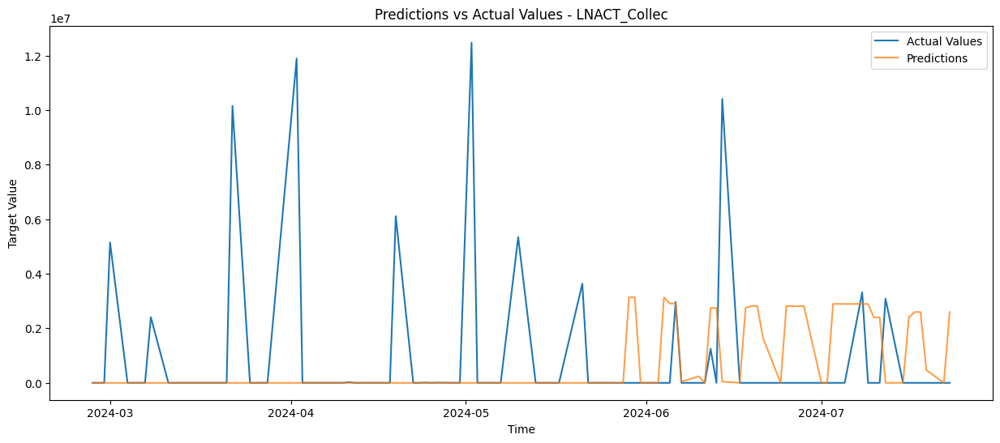

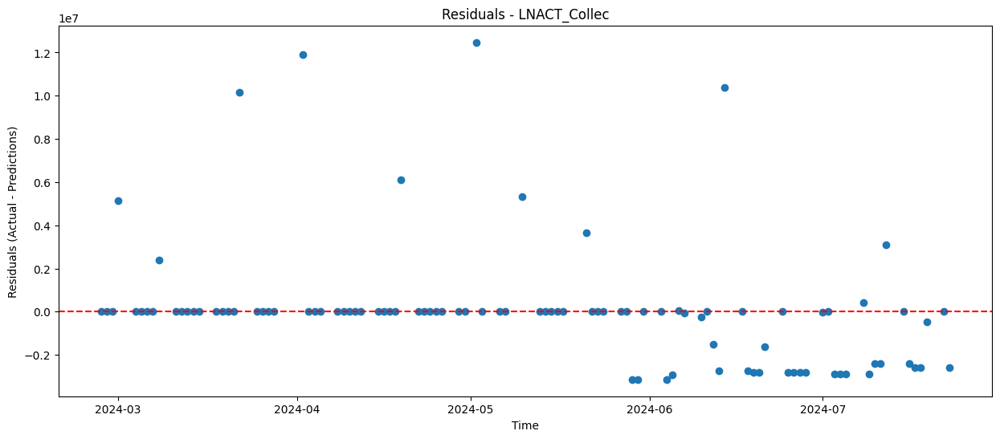


Metrics for LNAAE_Collec:
Overall MSE: 1152341772096.3459


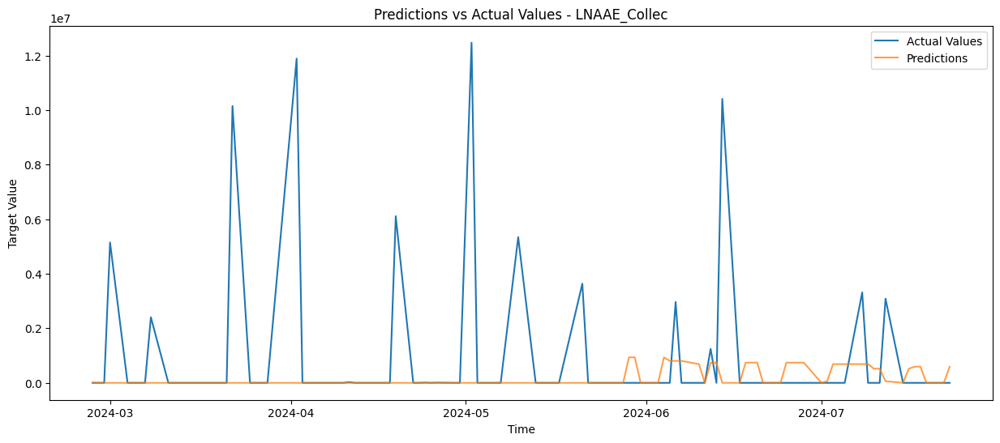

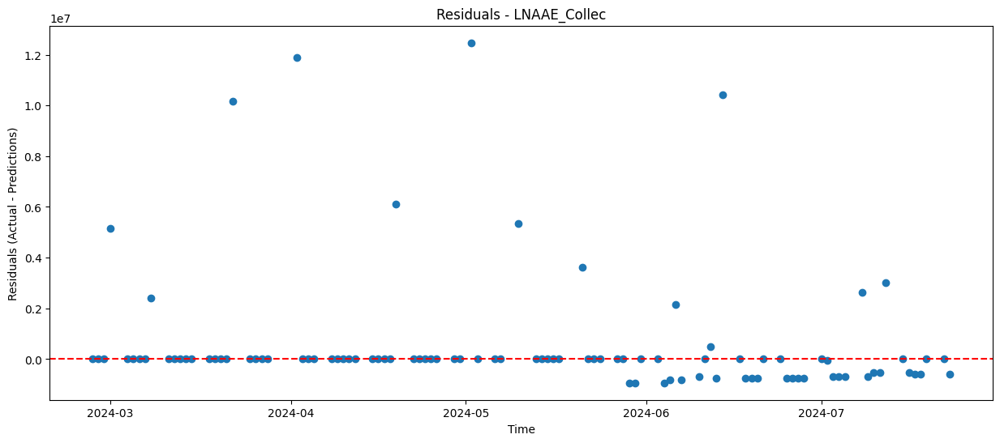


Metrics for LNATO_Collec:
Overall MSE: 9812650988922.2520


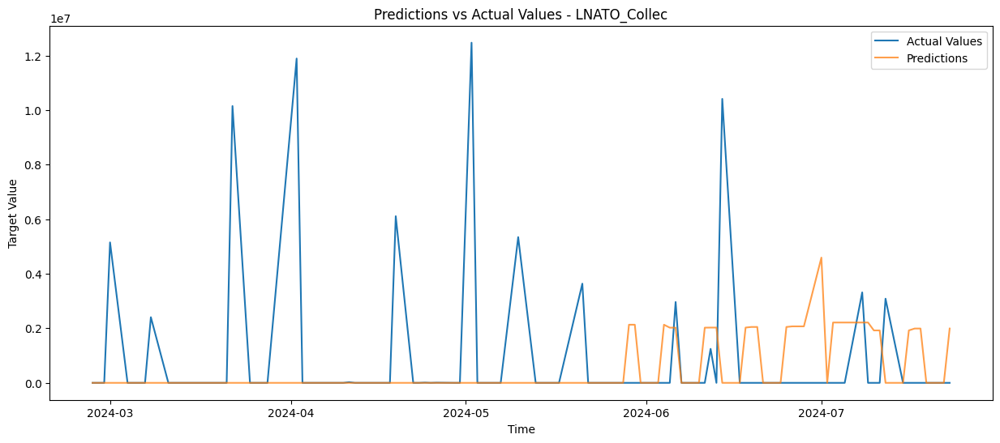

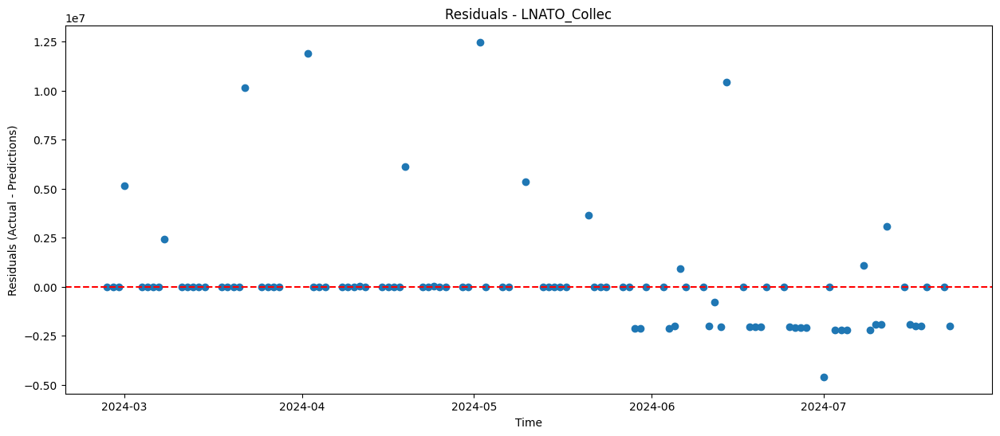


Metrics for LNAT2_Collec:
Overall MSE: 76297062191.0151


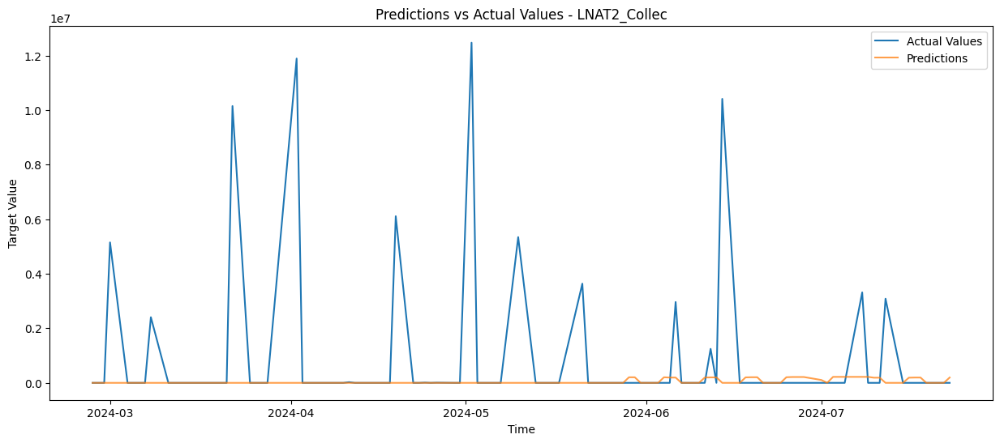

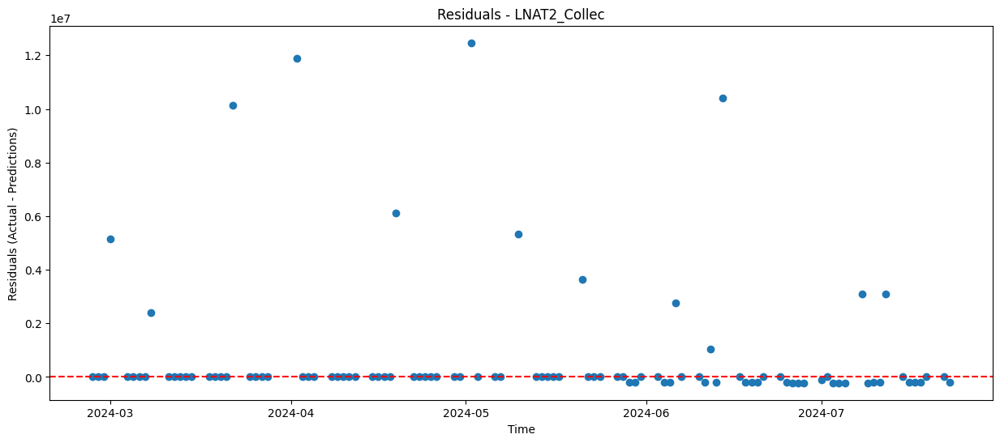


Metrics for LNACC_Collec:
Overall MSE: 55672344914575.7422


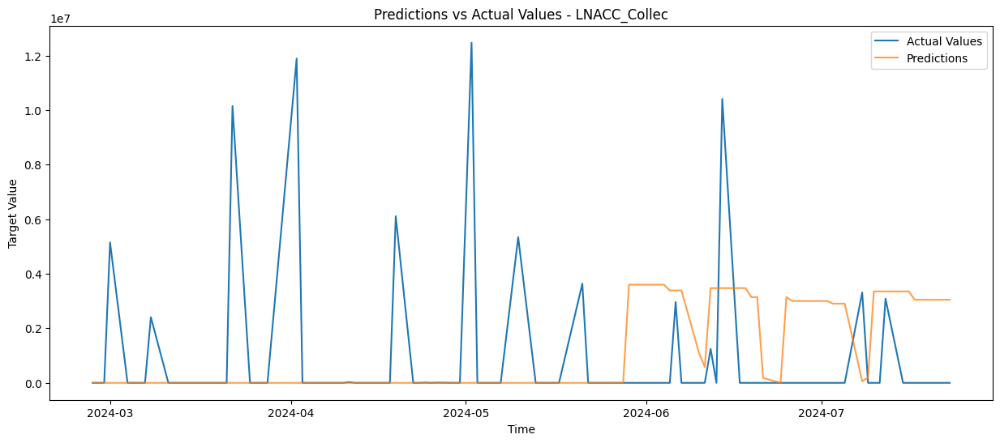

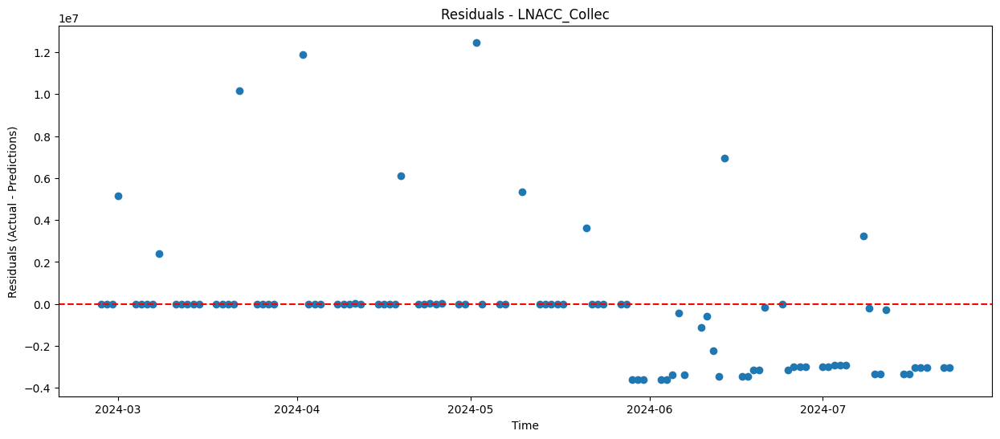


Metrics for LNACE_Collec:
Overall MSE: 0.0000


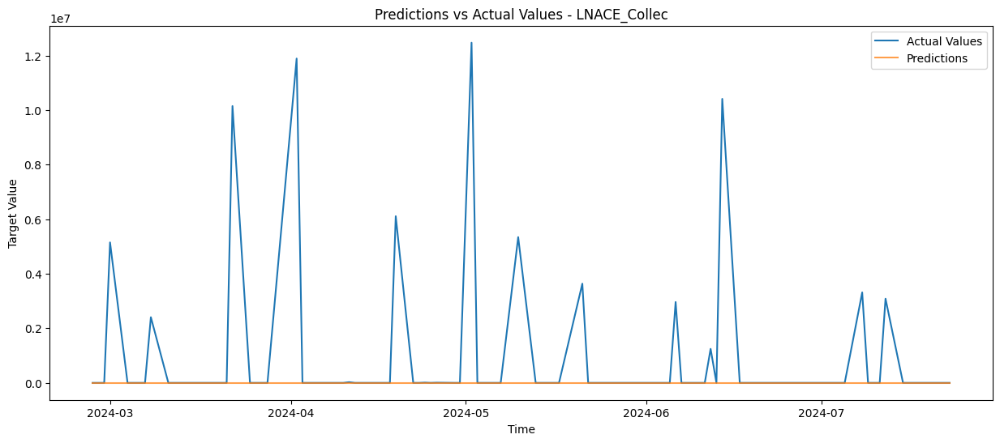

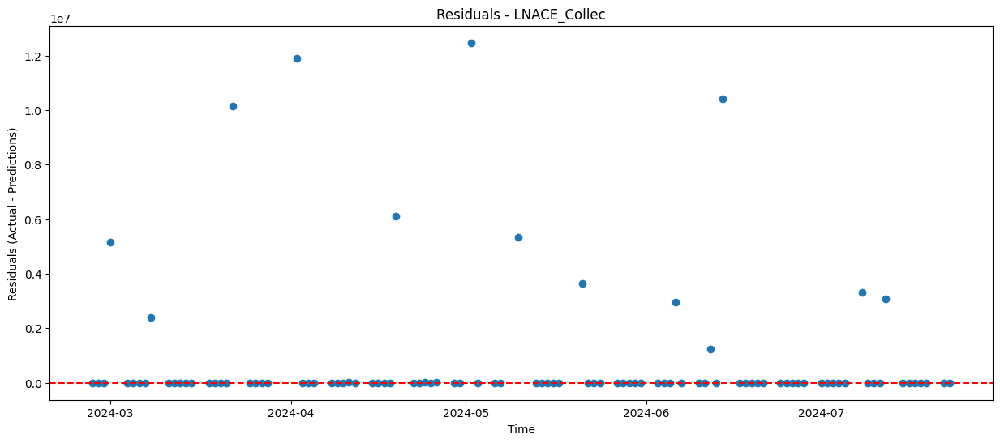


Metrics for LNAC3_Collec:
Overall MSE: 0.0000


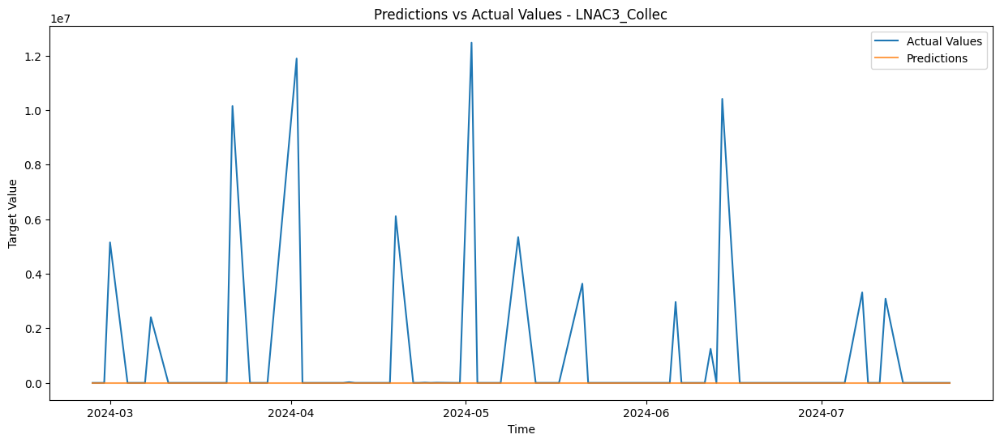

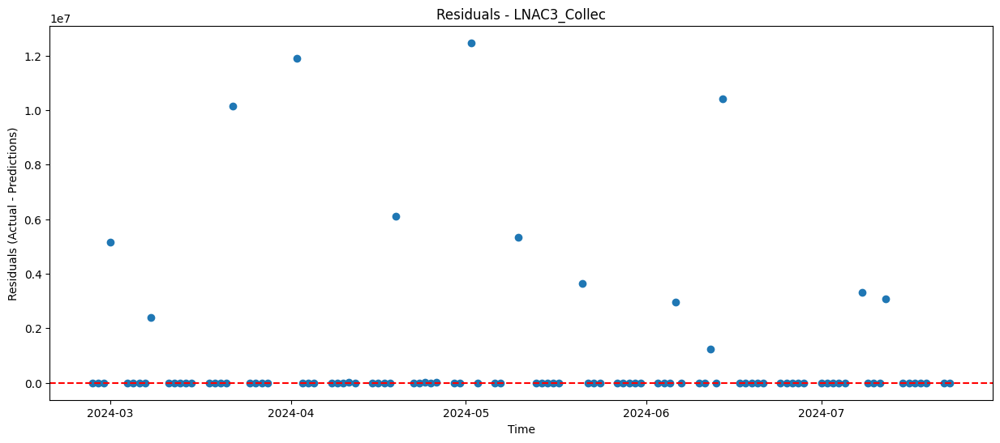


Metrics for LNAC4_Collec:
Overall MSE: 0.0000


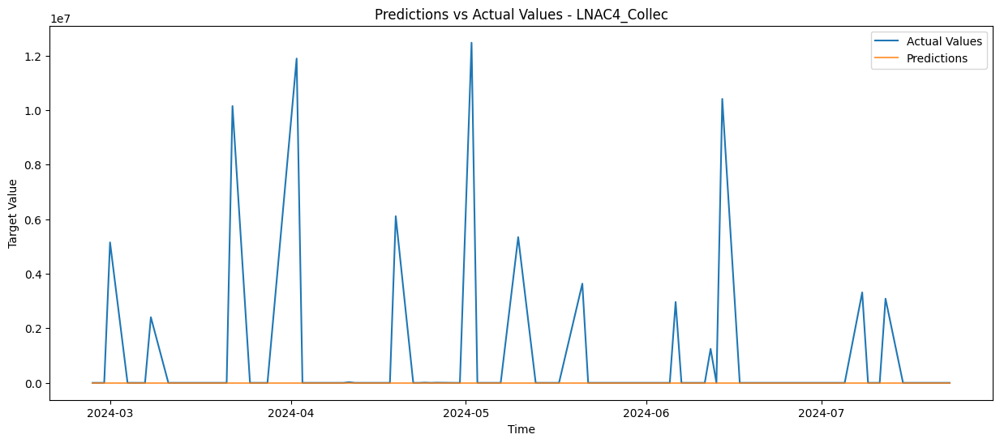

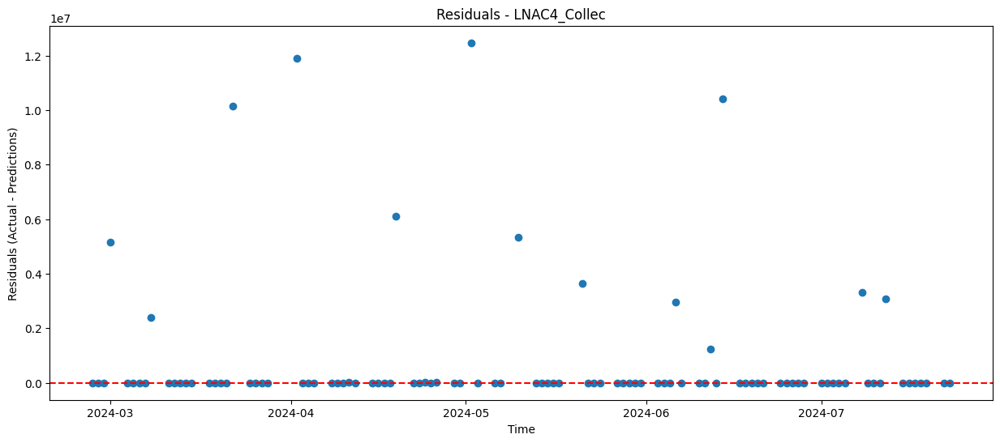


Metrics for LNAC6_Collec:
Overall MSE: 117000057.5862


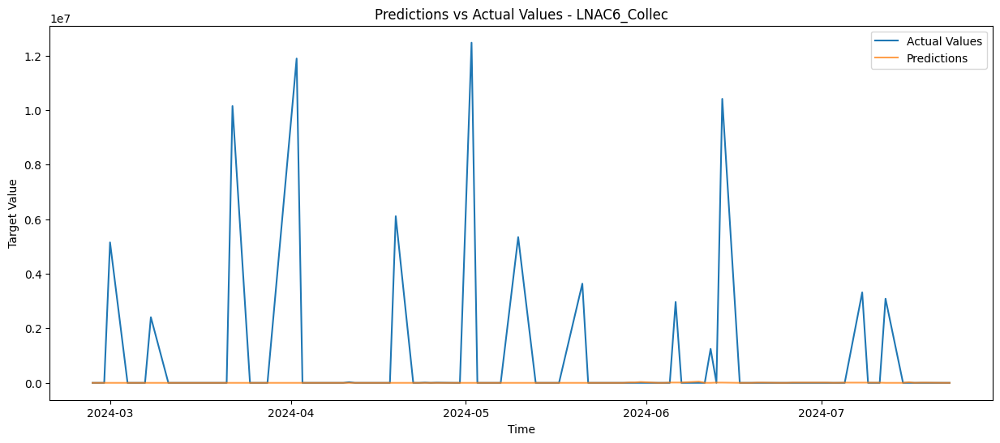

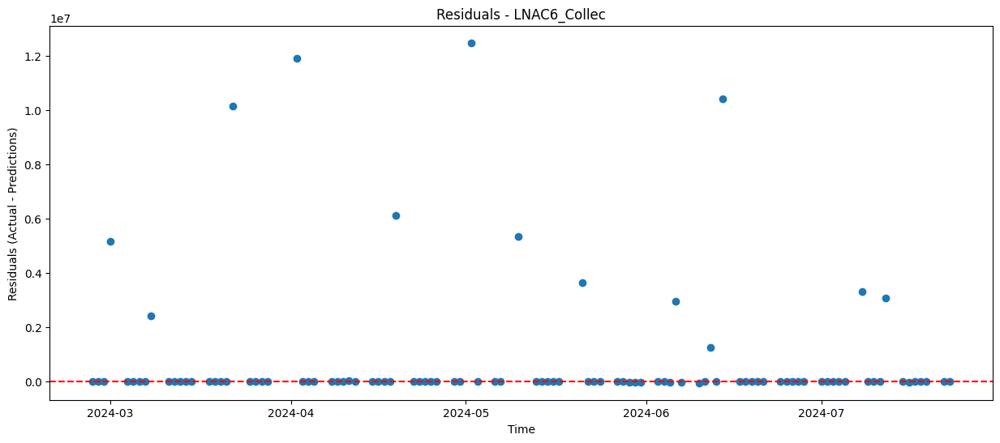


Metrics for LNDOL_Collec:
Overall MSE: 1669718718779.4646


ValueError: x and y must have same first dimension, but have shapes (100,) and (81,)

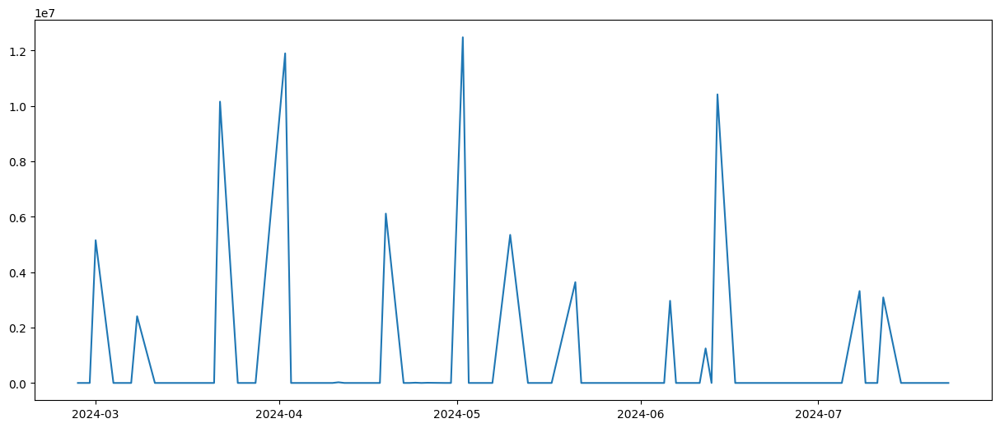

In [162]:
from sklearn.ensemble import RandomForestRegressor 
from sklearn.metrics import mean_squared_error
import numpy as np
import pandas as pd

# Function to create lagged features
def create_lagged_features(df, n_lags=2):
    df_transformed = pd.DataFrame(index=df.index)
    df_transformed['y'] = df['Close']
    for i in range(1, n_lags + 1):
        df_transformed[f'Lag_{i}'] = df['Close'].shift(i)
    df_transformed.dropna(inplace=True)
    return df_transformed

# Function to perform rolling window analysis
def rolling_window_analysis(X, y, window_size=60, step_size=5, n_estimators=100):
    n_windows = (len(X) - window_size) // step_size + 1
    predictions = np.zeros(len(y))
    mse_scores = []

    for i in range(n_windows):
        start = i * step_size
        end = start + window_size
        
        X_train, y_train = X.iloc[start:end], y.iloc[start:end]
        X_test, y_test = X.iloc[end:end + step_size], y.iloc[end:end + step_size]
        
        model = RandomForestRegressor(n_estimators=n_estimators, random_state=42)
        model.fit(X_train, y_train)
        
        if len(X_test) == 0:
            break
        
        current_predictions = model.predict(X_test)
        predictions[end:end + step_size] = current_predictions
        
        mse = mean_squared_error(y_test, current_predictions)
        mse_scores.append(mse)
    
    overall_mse = np.mean(mse_scores)
    return overall_mse, mse_scores, predictions

# Load the data from the Excel file
file_path = 'P:/CALYX/Cash_Securitisation_Optimisation_20240722.xlsx'
df = pd.read_excel(file_path, sheet_name='Gestion Cash', header=None)

# Extract the relevant parts of the dataframe
series_names_it = df.iloc[32:67, 0].values

# Extract the time series and data series
time_series = df.iloc[4, 10:113]  # Columns K (index 10) to DH (index 113)
data_series_it = df.iloc[32:67, 10:113]  # Rows 33 to 67 (index 32 to 66), columns K (index 10) to DH (index 113)

# Convert the data to a DataFrame with time as the index
data_series_it.columns = time_series.values
data_series_it.index = series_names_it  # Adjust the index to match the original rows

# Transpose the DataFrame and convert the index to datetime
data_series_it = data_series_it.T
data_series_it.index = pd.to_datetime(data_series_it.index, format='%Y-%m-%d')

# Perform rolling window analysis for each series in data_series_it
results = {}

for series_name in data_series_it.columns:
    print(f'Processing series: {series_name}')
    df_series = data_series_it[[series_name]].rename(columns={series_name: 'Close'})
    df_transformed = create_lagged_features(df_series, n_lags=2)
    X = df_transformed.drop('y', axis=1).astype(float)
    y = df_transformed['y'].astype(float)
    
    overall_mse, mse_scores, predictions = rolling_window_analysis(X, y)
    print(f"Rolling Window Analysis Overall MSE for {series_name}: {overall_mse}")
    
    results[series_name] = {
        'Overall MSE': overall_mse,
        'MSE Scores': mse_scores,
        'Predictions': predictions
    }

# Display the results
for series_name, metrics in results.items():
    print(f"\nMetrics for {series_name}:")
    print(f"Overall MSE: {metrics['Overall MSE']:.4f}")
    # Plot predictions vs actual values
    plt.figure(figsize=(15, 6))
    plt.plot(y.index, y, label='Actual Values')
    plt.plot(y.index, metrics['Predictions'], label='Predictions', alpha=0.75)
    plt.title(f'Predictions vs Actual Values - {series_name}')
    plt.xlabel('Time')
    plt.ylabel('Target Value')
    plt.legend()
    plt.show()
    # Plot residuals
    residuals = y - metrics['Predictions']
    plt.figure(figsize=(15, 6))
    plt.plot(y.index, residuals, marker='o', linestyle='')
    plt.title(f'Residuals - {series_name}')
    plt.xlabel('Time')
    plt.ylabel('Residuals (Actual - Predictions)')
    plt.axhline(y=0, color='r', linestyle='--')
    plt.show()


# Evaluation and Impact
### Advantages:
Adaptability: This method allows the model to learn from different segments of the data, potentially improving its adaptability to changes over time. Robustness: Training separate models on overlapping windows can enhance the robustness of the forecasting, as it reduces the impact of anomalies in any single segment.

### Considerations:
Computational Demand: Training multiple models across sliding windows can be computationally intensive, especially for large datasets or complex models. Aggregation Strategy: Deciding on the best way to aggregate predictions from different models requires careful consideration to ensure optimal forecasting performance.

# Conclusion
Subsampling with a Sliding Window is a powerful resampling method for time series forecasting, offering a dynamic approach to model training that can capture temporal variations in the data. By implementing this strategy and evaluating its impact through measures like MSE, practitioners can enhance the accuracy and reliability of forecasts for datasets like AAPL's stock prices, leveraging the strengths of ensemble methods like Random Forest to navigate the complexities of financial time series data.

Implementing and evaluating different resampling methods for time series forecasting, especially with complex models like Bagging and Random Forest, requires a nuanced approach that respects the inherent sequential nature of the data. A method well-suited for this purpose, which hasn't been explicitly described yet, is Dynamic Time Warping (DTW) as a Resampling Technique.

# Weighted Sampling Based on Time Proximity
The core idea here is to apply a non-uniform sampling strategy where recent data points have a higher probability of being included in the training set than older data points. This approach can be particularly useful in time series forecasting when recent trends and patterns are believed to be more relevant for predicting future outcomes.

Implementation with Random Forest in Python Below is a conceptual Python example demonstrating how to implement Weighted Sampling Based on Time Proximity using a Random Forest model for forecasting. This example assumes X and y represent your dataset's features and target variable, respectively, prepared for time series forecasting

In [165]:
import numpy as np 
import pandas as pd
from sklearn.ensemble import RandomForestRegressor
from sklearn.metrics import mean_squared_error
from sklearn.model_selection import train_test_split

# Assuming X and y are already defined from the data provided above

# Define the weights linearly increasing from 0.1 to 1.0
weights = np.linspace(start=0.1, stop=1.0, num=len(y))

# Normalize weights to sum up to 1
normalized_weights = weights / weights.sum()

# Select weighted indices based on the defined weights
weighted_indices = np.random.choice(a=np.arange(len(y)), size=int(len(y) * 0.8), replace=False, p=normalized_weights)

# Subset the data based on weighted indices
X_weighted = X.iloc[weighted_indices]
y_weighted = y.iloc[weighted_indices]

# Split the weighted data into training and testing sets
X_train, X_test, y_train, y_test = train_test_split(X_weighted, y_weighted, test_size=0.2, random_state=42)

# Initialize and train the RandomForestRegressor
model = RandomForestRegressor(n_estimators=100, random_state=42)
model.fit(X_train, y_train)

# Predict on the test set
predictions = model.predict(X_test)

# Calculate the mean squared error
mse = mean_squared_error(y_test, predictions)
print(f"Weighted Sampling MSE: {mse}")

# Handling other datasets in the data_series_it

# Function to process each series
def process_series(X, y, series_name):
    # Define the weights linearly increasing from 0.1 to 1.0
    weights = np.linspace(start=0.1, stop=1.0, num=len(y))
    normalized_weights = weights / weights.sum()

    # Select weighted indices based on the defined weights
    weighted_indices = np.random.choice(a=np.arange(len(y)), size=int(len(y) * 0.8), replace=False, p=normalized_weights)

    # Subset the data based on weighted indices
    X_weighted = X.iloc[weighted_indices]
    y_weighted = y.iloc[weighted_indices]

    # Split the weighted data into training and testing sets
    X_train, X_test, y_train, y_test = train_test_split(X_weighted, y_weighted, test_size=0.2, random_state=42)

    # Initialize and train the RandomForestRegressor
    model = RandomForestRegressor(n_estimators=100, random_state=42)
    model.fit(X_train, y_train)

    # Predict on the test set
    predictions = model.predict(X_test)

    # Calculate the mean squared error
    mse = mean_squared_error(y_test, predictions)
    print(f"Weighted Sampling MSE for {series_name}: {mse}")

# Iterate over each series in data_series_it
for series_name in data_series_it.columns:
    df_series = data_series_it[[series_name]].rename(columns={series_name: 'Close'})
    df_transformed = create_lagged_features(df_series, n_lags=2)
    X = df_transformed.drop('y', axis=1).astype(float)
    y = df_transformed['y'].astype(float)
    process_series(X, y, series_name)


Weighted Sampling MSE: 15556647659816.072
Weighted Sampling MSE for LNACT_Collec: 20485113409867.457
Weighted Sampling MSE for LNAAE_Collec: 2508737302512.7686
Weighted Sampling MSE for LNATO_Collec: 7738785600036.645
Weighted Sampling MSE for LNAT2_Collec: 55402417071.016464
Weighted Sampling MSE for LNACC_Collec: 11304587892502.023
Weighted Sampling MSE for LNACE_Collec: 0.0
Weighted Sampling MSE for LNAC3_Collec: 0.0
Weighted Sampling MSE for LNAC4_Collec: 0.0
Weighted Sampling MSE for LNAC6_Collec: 152855985.3976837
Weighted Sampling MSE for LNDOL_Collec: 2090216860152.8005
Weighted Sampling MSE for LNEDI_Collec: 60250257156898.6
Weighted Sampling MSE for LNEDN_Collec: 13417965493791.787
Weighted Sampling MSE for LNENT_Collec: 402795601091110.56
Weighted Sampling MSE for LNENE_Collec: 448336727970368.75
Weighted Sampling MSE for LNENM_Collec: 309570069583754.25
Weighted Sampling MSE for LNEFM_Collec: 1370291152792101.2
Weighted Sampling MSE for LNENP_Collec: 1944857390248151.2
Weig

# Evaluation and Impact
Advantages:
Increased Relevance of Recent Trends: By focusing on more recent observations, the model may better capture the latest patterns and trends that are more relevant for forecasting future values. Flexibility in Weight Assignment: The method allows for customizable weight distributions, enabling forecasters to adjust how much recent data influences model training.

Considerations:
Risk of Overfitting: Overemphasis on recent data can lead to overfitting, especially if the recent trends do not persist into the future. Choice of Weighting Scheme: Determining the optimal weighting scheme requires careful consideration and might need adjustments based on the specific characteristics of the time series. Conclusion Weighted Sampling Based on Time Proximity offers a strategic way to prioritize recent observations in time series forecasting, potentially enhancing the predictive performance of models like Bagging and Random Forest. This method underscores the importance of recent data in forecasting efforts but also highlights the need for judicious weight management to avoid overfitting. By carefully implementing and evaluating this resampling technique, practitioners can more effectively leverage recent trends in their forecasting models, achieving a balance between responsiveness to new data and the robustness of predictions.

To address the request for exploring additional resampling methods tailored for time series forecasting with supervised learning models like Bagging and Random Forest, and to accurately assess their impact, we turn our attention to a strategic approach known as Custom Time Blocks Resampling. This method is particularly effective for datasets that exhibit distinct cyclical patterns or seasonality, such as stock prices, which may have underlying trends that vary by day of the week, month, or quarter.

# Custom Time Blocks Resampling
Custom Time Blocks Resampling involves segmenting the time series data into blocks that correspond to specific, potentially meaningful periods (e.g., monthly, quarterly) and then sampling within these blocks to create training and test sets. This approach allows the model to learn from the nuances of each period's data, potentially enhancing its ability to generalize across similar periods in the future.

Implementation with Random Forest in Python The Python example below demonstrates how to implement Custom Time Blocks Resampling for forecasting, using the AAPL stock price dataset as a reference. This example assumes X contains features derived from the dataset, including lagged values, and y is the target variable (e.g., closing price).


# Evaluation and Impact
### Advantages:
Period-Specific Learning: This method enables the model to capture and learn from the unique characteristics of different time periods. Improved Forecasting Accuracy: By training on a diverse set of periods, the model may better generalize to unseen data, potentially improving forecasting accuracy.

### Considerations:
Data Distribution: Care must be taken to ensure that the resampling does not introduce bias, particularly if certain periods are over- or under-represented. Computational Complexity: Depending on the number of blocks and the size of the dataset, this approach may increase the computational workload. Conclusion Custom Time Blocks Resampling offers a targeted approach to harnessing cyclical patterns and seasonal effects in time series data, enhancing the ability of models like Bagging and Random Forest to forecast future trends accurately. By thoughtfully implementing this resampling method and critically assessing its impact, data scientists can refine their models to better capture the dynamic behaviors of time series datasets, such as stock prices, improving both the relevance and reliability of their forecasts.

To further explore and evaluate resampling methods for a time series dataset, specifically for supervised learning models like Bagging and Random Forest, another innovative approach is Synthetic Minority Over-sampling Technique for Time Series (SMOTETS). While SMOTE is traditionally used in classification tasks to address imbalances by creating synthetic samples, SMOTETS adapts this concept for time series forecasting, focusing on generating synthetic time series data to improve model training and performance.

# Resampling Based on Anomaly Detection
This approach involves identifying anomalies or outliers in the time series data, then selectively resampling the data to either focus on these points or exclude them, depending on the specific objectives of the forecasting model. The rationale is that anomalies can significantly influence the model's performance, either by providing valuable information about rare events or by introducing noise that could lead to overfitting.

Implementation with Random Forest in Python Here's how to implement this method using a Random Forest model for forecasting, incorporating a simple anomaly detection mechanism based on statistical thresholds. This example assumes X and y represent your dataset's features and target variable, respectively, prepared for time series forecasting.

# Evaluation and Impact
### Advantages:
Targeted Learning: By focusing on or excluding anomalies, the model can be tailored to either predict rare events more accurately or to provide more stable forecasts for typical conditions. Improved Model Performance: This approach can help mitigate the influence of outliers on model training, potentially leading to more reliable predictions.

### Considerations:
Anomaly Definition: The definition of what constitutes an anomaly is crucial and can significantly affect the resampled dataset. Loss of Information: Excluding anomalies might lead to the loss of valuable information, especially if these points are indicative of underlying trends or seasonal effects.

# Conclusion
Resampling Based on Anomaly Detection offers a nuanced method for preparing time series data for forecasting models, allowing practitioners to tailor their models based on the specific characteristics of the data and their forecasting goals. By selectively focusing on or excluding anomalies, models like Bagging and Random Forest can be better optimized for either capturing rare events or improving general forecasting accuracy. This method highlights the importance of a strategic approach to data preparation in enhancing the performance of time series forecasting models.

In [174]:
pip install statsmodels

Looking in indexes: https://repository.saas.cagip.group.gca/artifactory/api/pypi/pypi-remote/simple
     ---------------------------------------- 0.0/9.9 MB ? eta -:--:--
     ---- ----------------------------------- 1.2/9.9 MB 26.3 MB/s eta 0:00:01
     -------- ------------------------------- 2.0/9.9 MB 21.5 MB/s eta 0:00:01
     ----------- ---------------------------- 2.8/9.9 MB 19.7 MB/s eta 0:00:01
     -------------- ------------------------- 3.6/9.9 MB 19.0 MB/s eta 0:00:01
     ----------------- ---------------------- 4.4/9.9 MB 18.6 MB/s eta 0:00:01
     -------------------- ------------------- 5.1/9.9 MB 18.2 MB/s eta 0:00:01
     ------------------------ --------------- 5.9/9.9 MB 18.0 MB/s eta 0:00:01
     --------------------------- ------------ 6.7/9.9 MB 17.9 MB/s eta 0:00:01
     ------------------------------ --------- 7.5/9.9 MB 17.8 MB/s eta 0:00:01
     --------------------------------- ------ 8.3/9.9 MB 17.7 MB/s eta 0:00:01
     ----------------------------------


[notice] A new release of pip is available: 24.0 -> 24.1.2
[notice] To update, run: python.exe -m pip install --upgrade pip


In [176]:
pip install seaborn

Looking in indexes: https://repository.saas.cagip.group.gca/artifactory/api/pypi/pypi-remote/simple
     ---------------------------------------- 0.0/294.9 kB ? eta -:--:--
     -------------------------------------- - 286.7/294.9 kB ? eta -:--:--
     -------------------------------------- 294.9/294.9 kB 4.5 MB/s eta 0:00:00
Note: you may need to restart the kernel to use updated packages.



[notice] A new release of pip is available: 24.0 -> 24.1.2
[notice] To update, run: python.exe -m pip install --upgrade pip


# Analyse des Séries Financières

Autocorrelation
link: https://tomaugspurger.github.io/modern-7-timeseries.html
Another problem our lagged model suffered from is autocorrelation https://en.wikipedia.org/wiki/Autocorrelation (also know as serial correlation). Roughly speaking, autocorrelation is when there's a clear pattern in the residuals of your regression (the observed minus the predicted). Let's fit a simple model of 
𝑦=𝛽0+𝛽1𝑇+𝜖
, where T is the time trend (np.arange(len(y))).
Residuals (the observed minus the expected, or 
𝑒𝑡^=𝑦𝑡−𝑦𝑡^
) are supposed to be white noise. That's one of the assumptions many of the properties of linear regression are founded upon. In this case there's a correlation between one residual and the next: if the residual at time 
𝑡
 was above expectation, then the residual at time 
𝑡+1
 is much more likely to be above average as well (
𝑒𝑡>0⟹𝐸𝑡[𝑒𝑡+1]>0
).


Processing series: LNACT_Collec


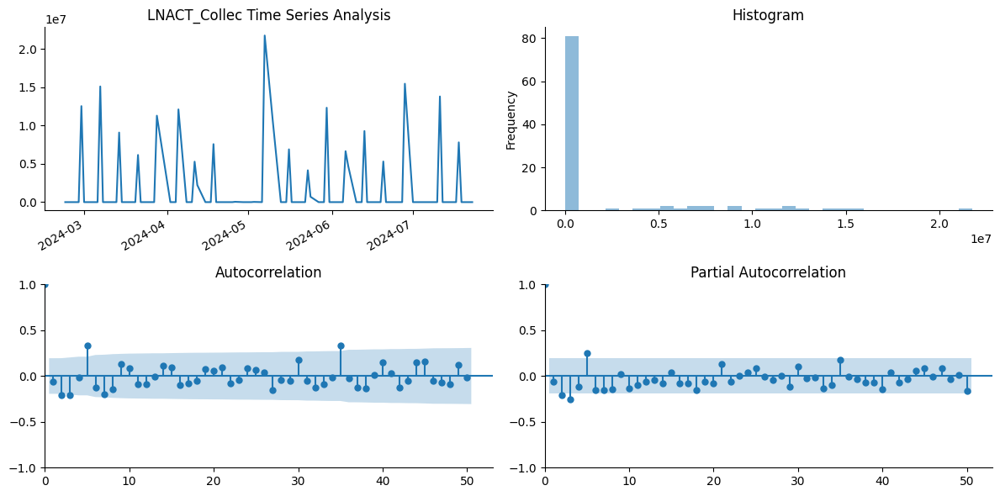

Processing series: LNAAE_Collec


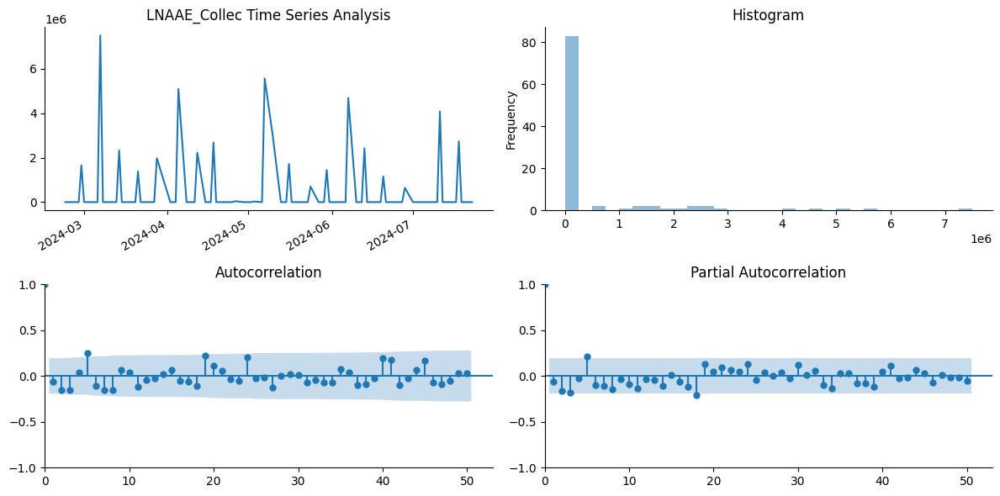

Processing series: LNATO_Collec


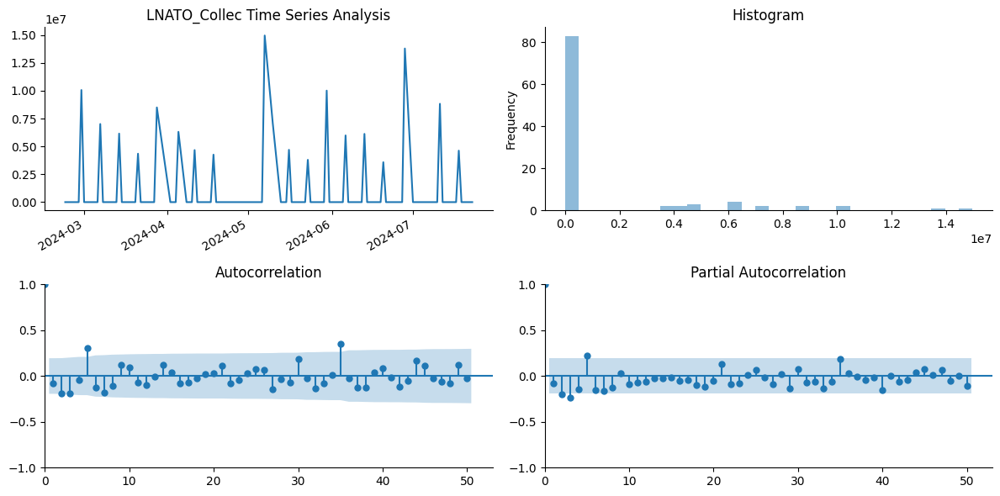

Processing series: LNAT2_Collec


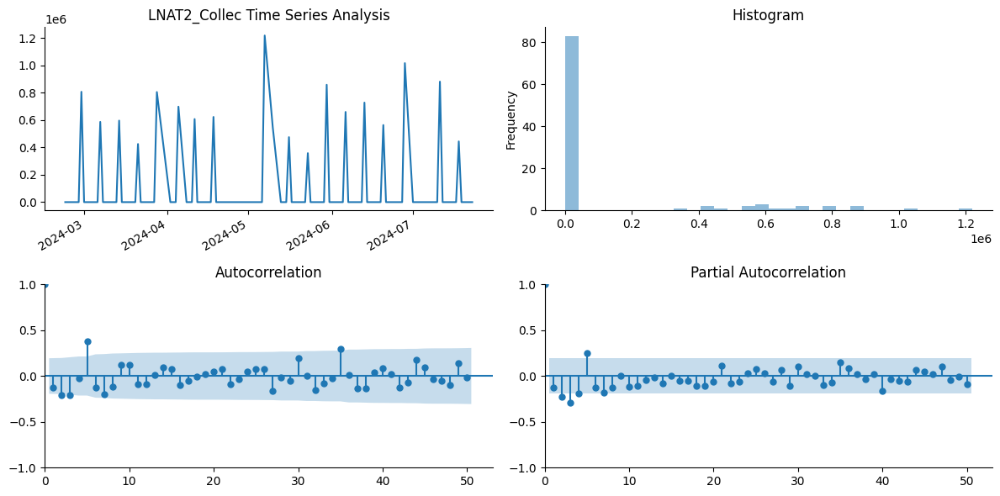

Processing series: LNACC_Collec


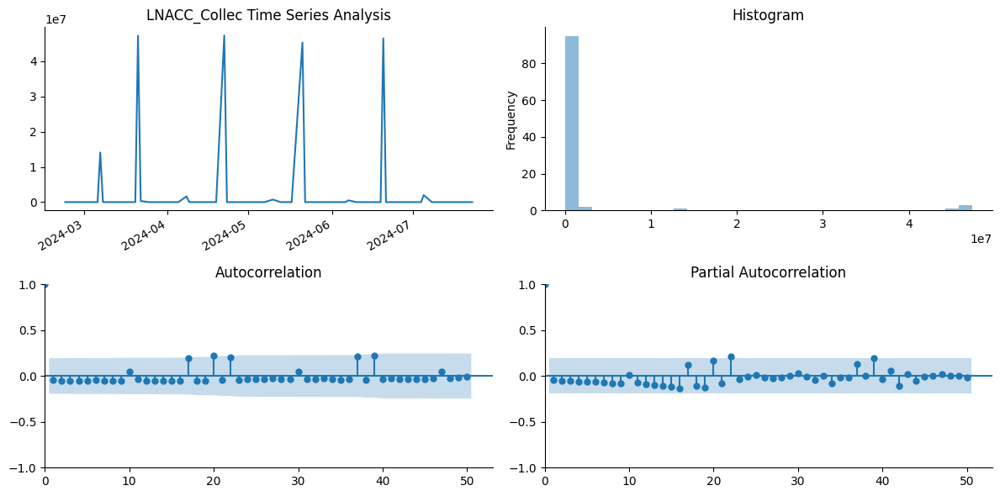

Processing series: LNACE_Collec


c:\Users\UT3NDP\My_IT_Applications\test_gitlab\venv\Lib\site-packages\statsmodels\tsa\stattools.py:693: RuntimeWarning: invalid value encountered in divide
  acf = avf[: nlags + 1] / avf[0]
c:\Users\UT3NDP\My_IT_Applications\test_gitlab\venv\Lib\site-packages\statsmodels\regression\linear_model.py:1491: ValueWarning: Matrix is singular. Using pinv.
  warnings.warn("Matrix is singular. Using pinv.", ValueWarning)


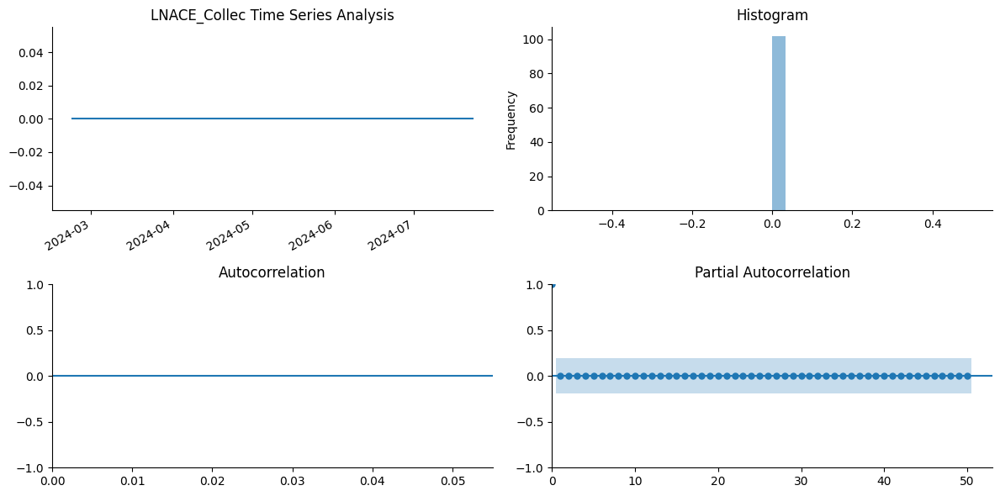

Processing series: LNAC3_Collec


c:\Users\UT3NDP\My_IT_Applications\test_gitlab\venv\Lib\site-packages\statsmodels\tsa\stattools.py:693: RuntimeWarning: invalid value encountered in divide
  acf = avf[: nlags + 1] / avf[0]
c:\Users\UT3NDP\My_IT_Applications\test_gitlab\venv\Lib\site-packages\statsmodels\regression\linear_model.py:1491: ValueWarning: Matrix is singular. Using pinv.
  warnings.warn("Matrix is singular. Using pinv.", ValueWarning)


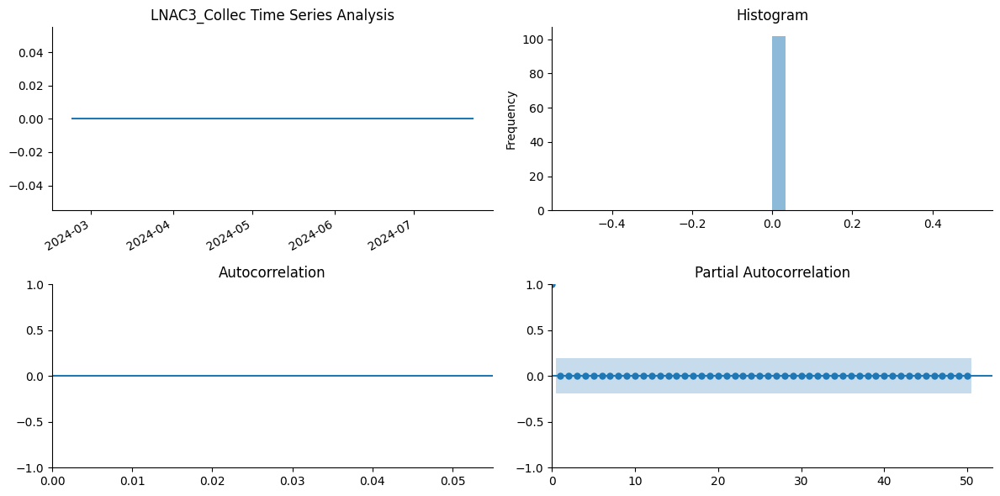

Processing series: LNAC4_Collec


c:\Users\UT3NDP\My_IT_Applications\test_gitlab\venv\Lib\site-packages\statsmodels\tsa\stattools.py:693: RuntimeWarning: invalid value encountered in divide
  acf = avf[: nlags + 1] / avf[0]
c:\Users\UT3NDP\My_IT_Applications\test_gitlab\venv\Lib\site-packages\statsmodels\regression\linear_model.py:1491: ValueWarning: Matrix is singular. Using pinv.
  warnings.warn("Matrix is singular. Using pinv.", ValueWarning)


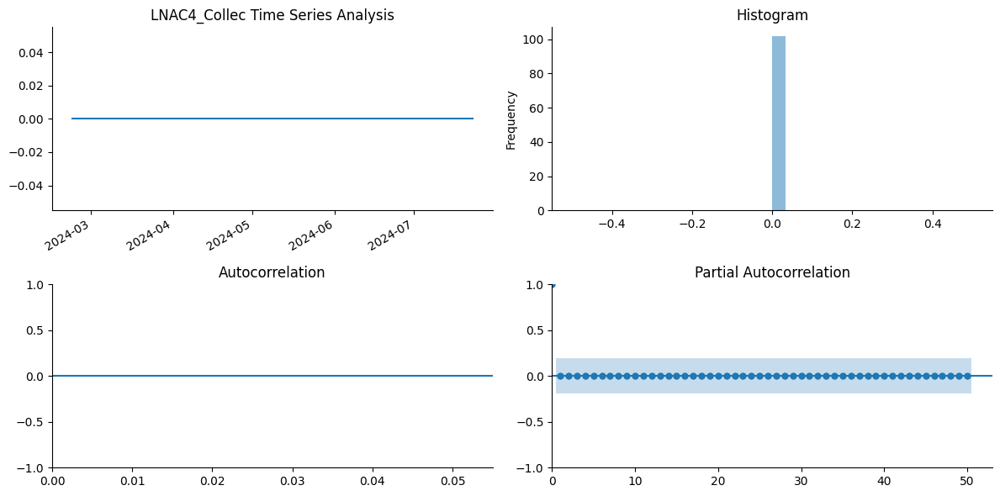

Processing series: LNAC6_Collec


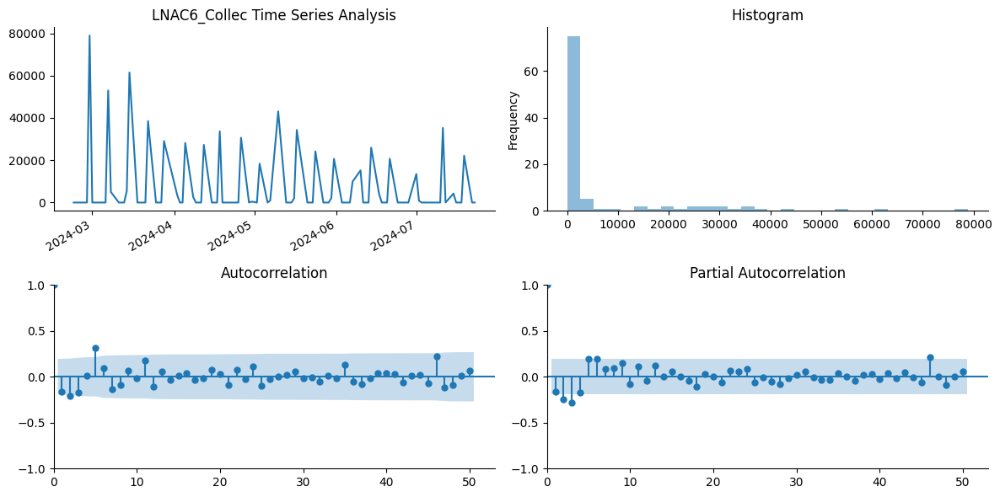

Processing series: LNDOL_Collec


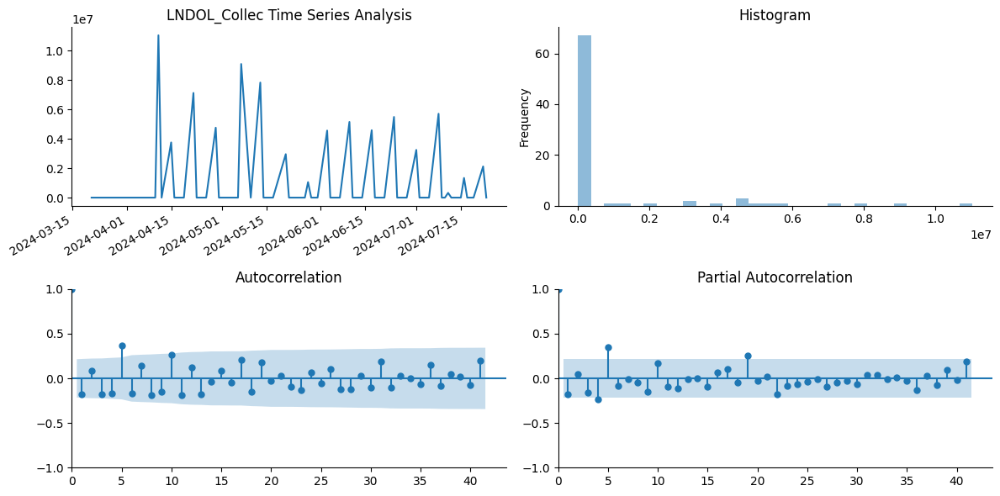

Processing series: LNEDI_Collec


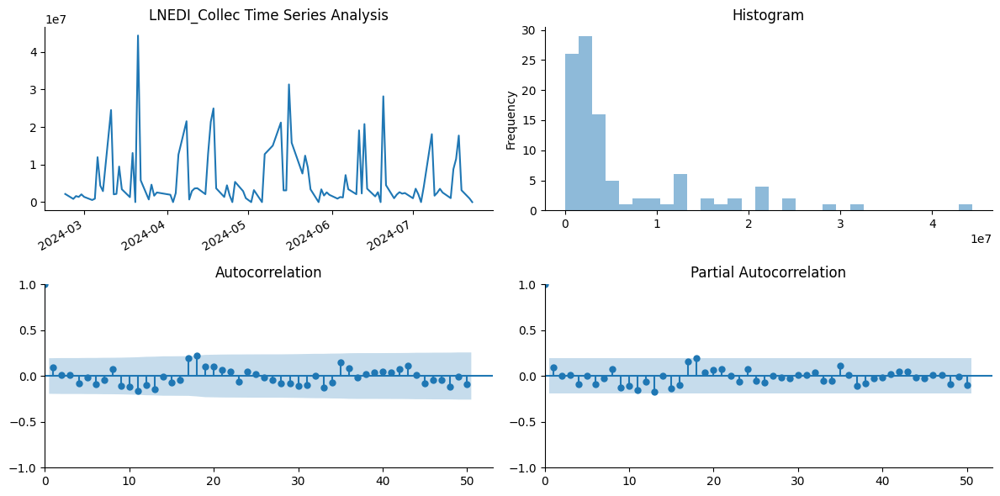

Processing series: LNEDN_Collec


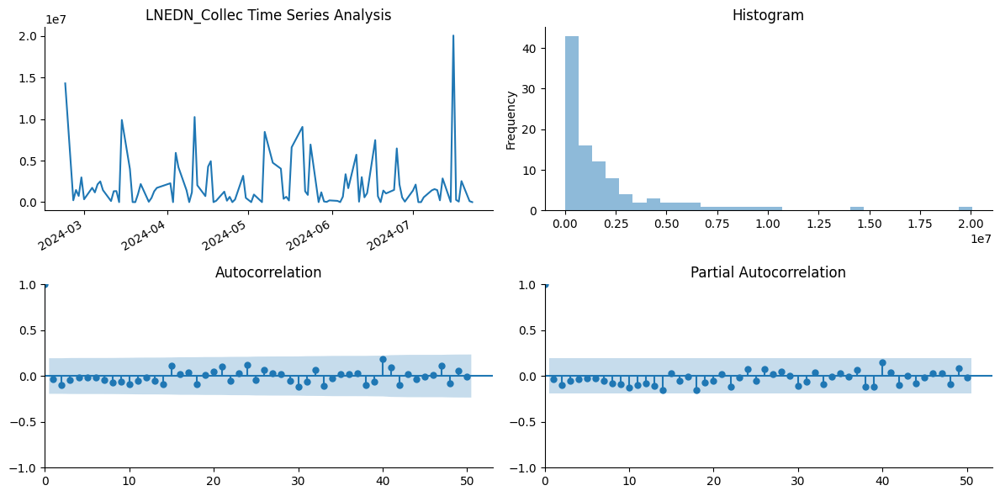

Processing series: LNENT_Collec


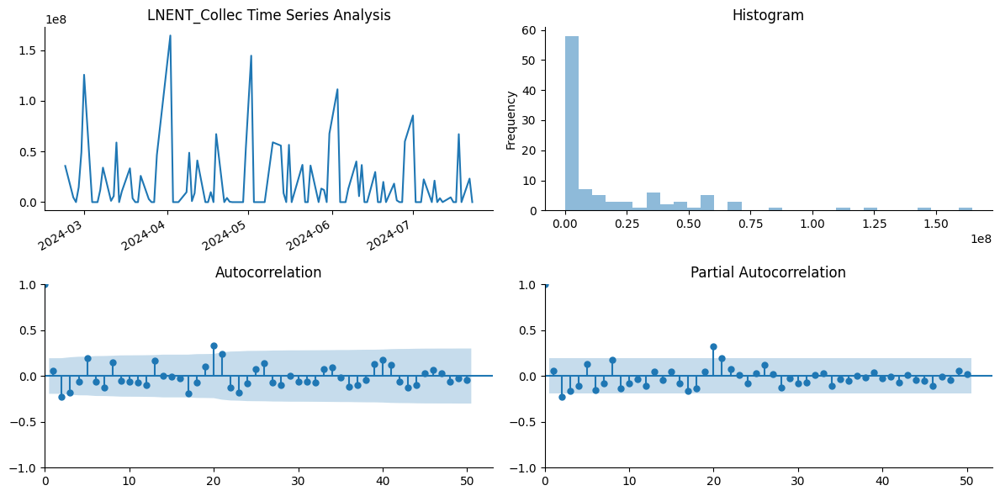

Processing series: LNENE_Collec


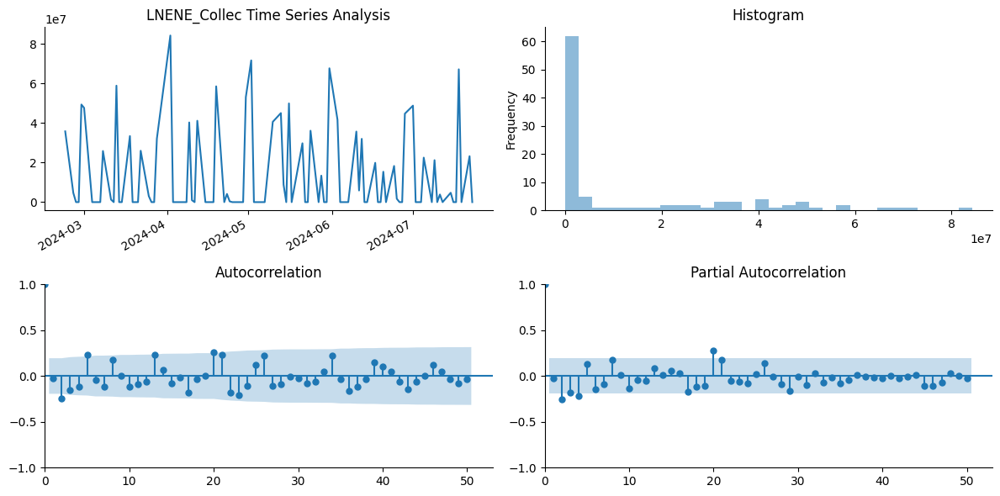

Processing series: LNENM_Collec


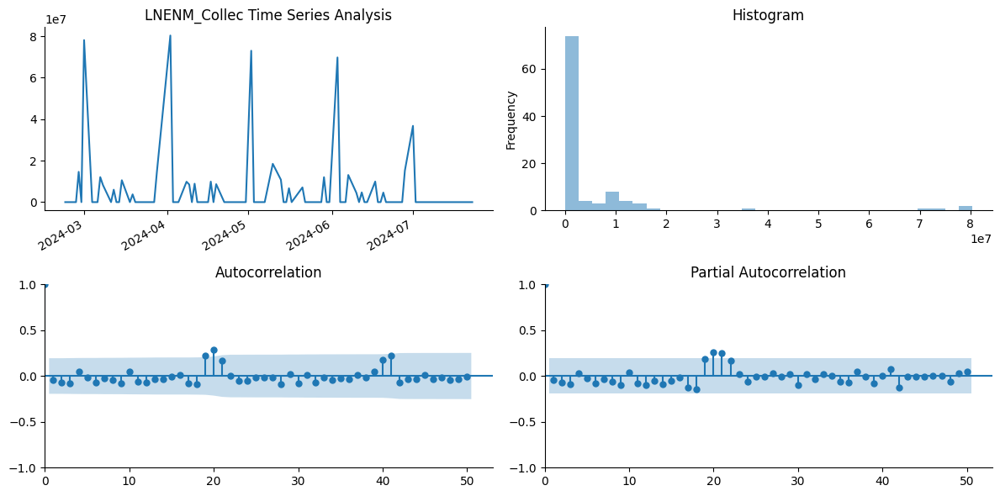

Processing series: LNEFM_Collec


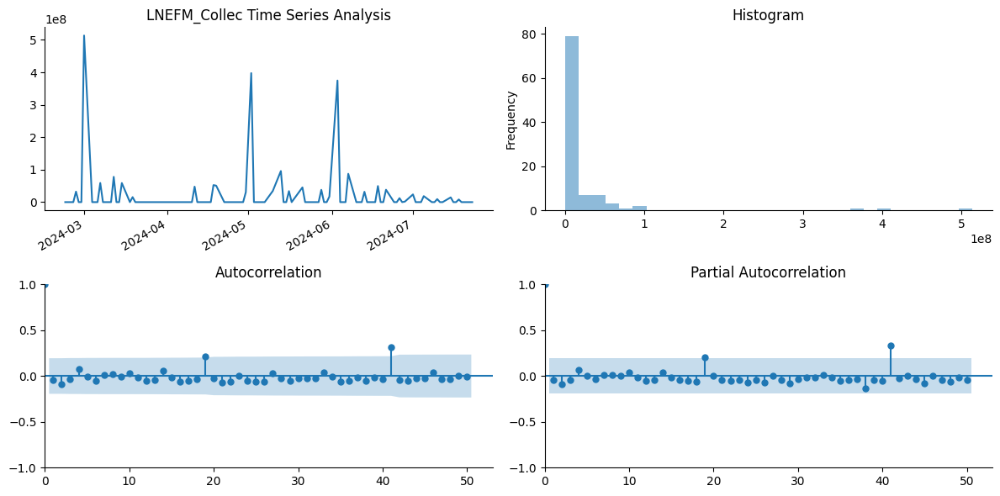

Processing series: LNENP_Collec


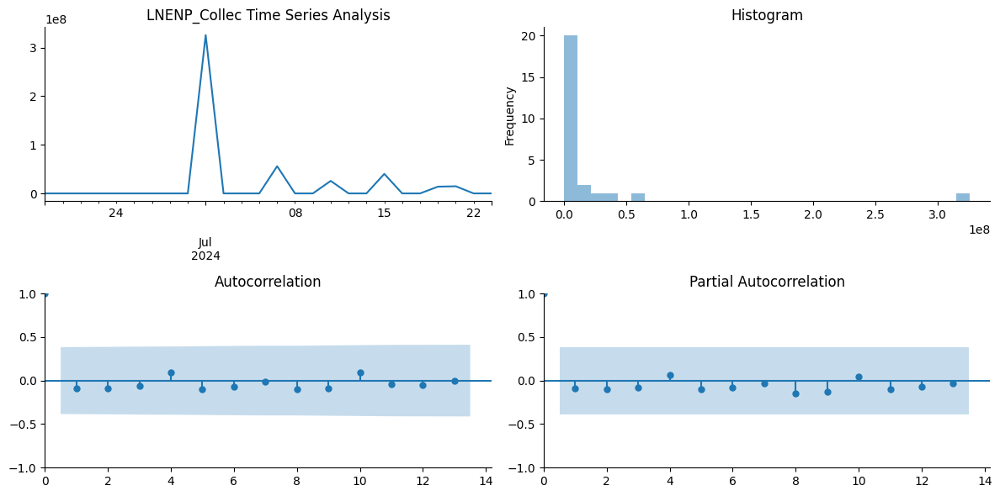

Processing series: LNENG_Collec


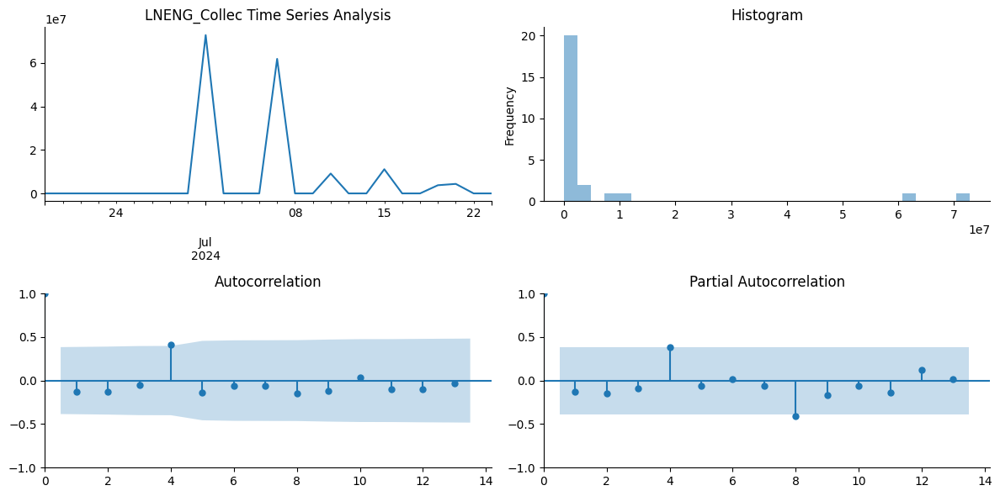

Processing series: LNSEN_Collec


c:\Users\UT3NDP\My_IT_Applications\test_gitlab\venv\Lib\site-packages\statsmodels\tsa\stattools.py:693: RuntimeWarning: invalid value encountered in divide
  acf = avf[: nlags + 1] / avf[0]
c:\Users\UT3NDP\My_IT_Applications\test_gitlab\venv\Lib\site-packages\statsmodels\regression\linear_model.py:1491: ValueWarning: Matrix is singular. Using pinv.
  warnings.warn("Matrix is singular. Using pinv.", ValueWarning)


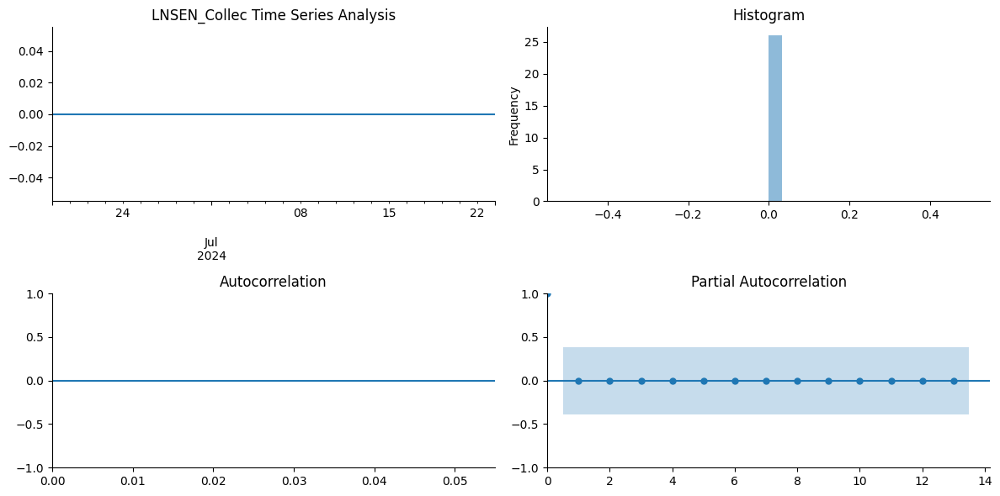

Processing series: LNENI_Collec


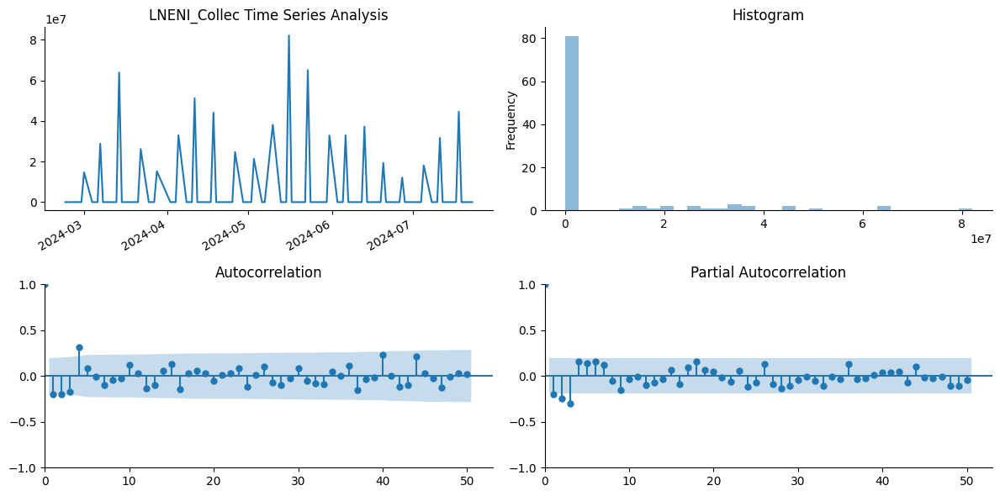

Processing series: LNENC_Collec


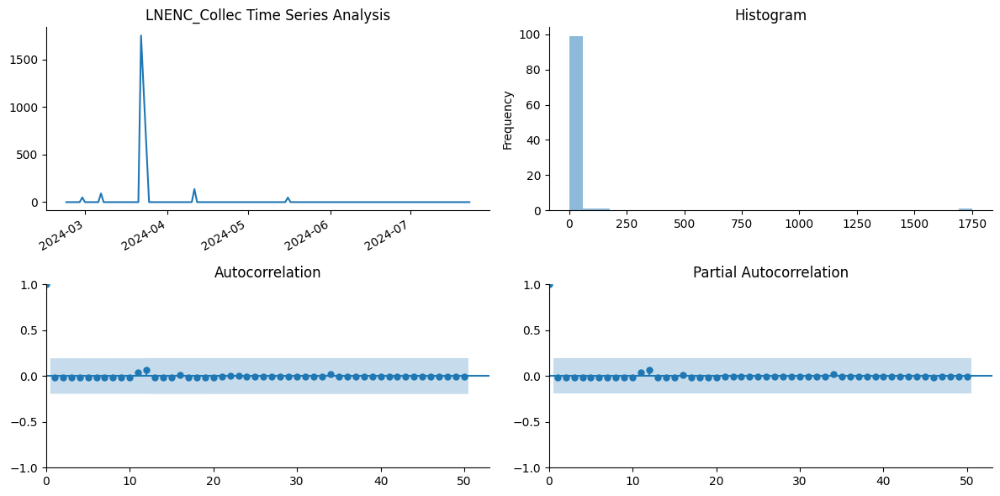

Processing series: LNEN3_Collec


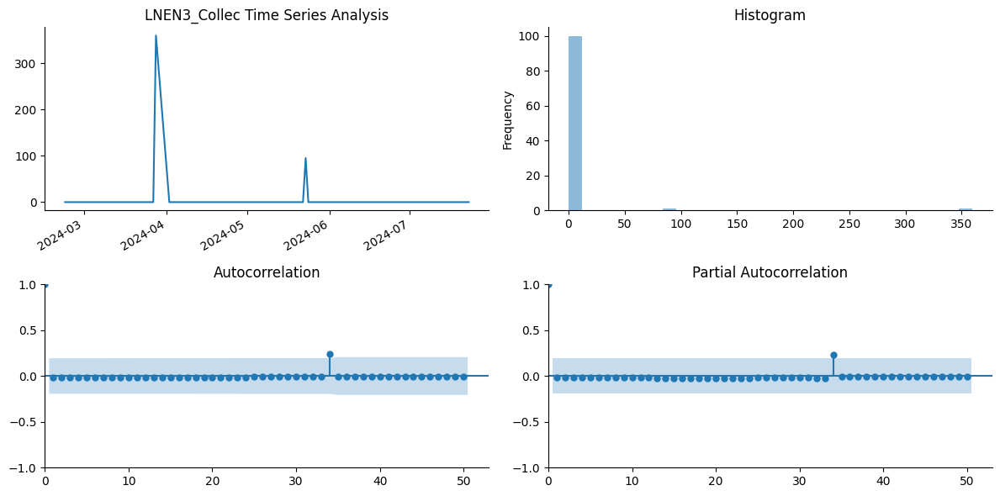

Processing series: LNGIV_Collec


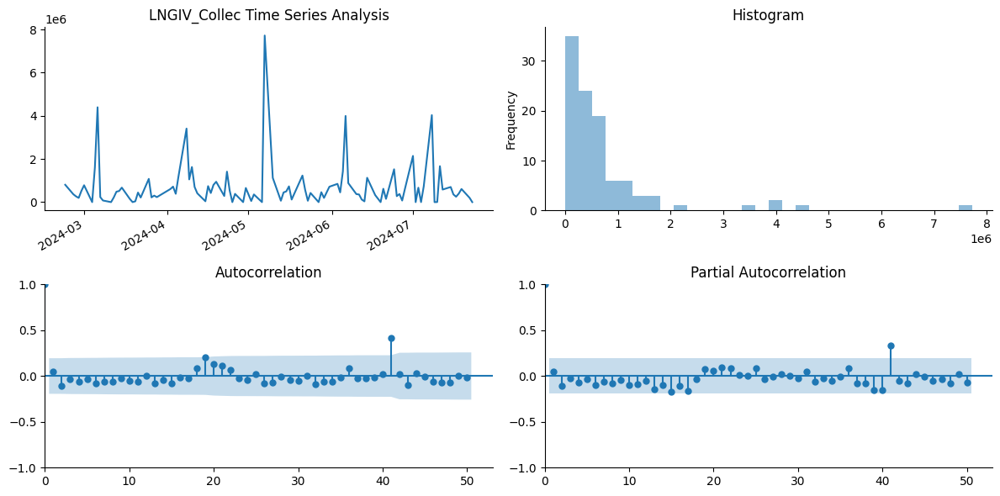

Processing series: LNGSI_Collec


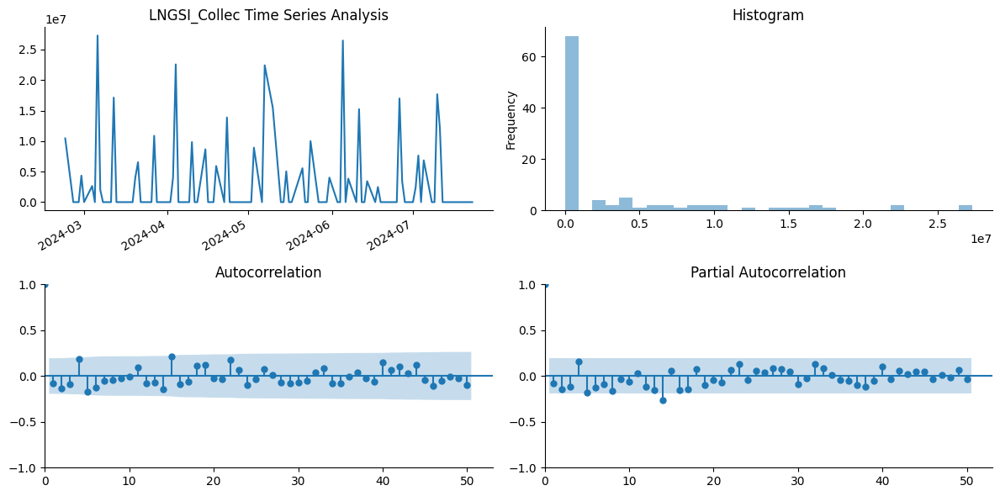

Processing series: LNIGT_Collec


c:\Users\UT3NDP\My_IT_Applications\test_gitlab\venv\Lib\site-packages\statsmodels\tsa\stattools.py:693: RuntimeWarning: invalid value encountered in divide
  acf = avf[: nlags + 1] / avf[0]
c:\Users\UT3NDP\My_IT_Applications\test_gitlab\venv\Lib\site-packages\statsmodels\regression\linear_model.py:1491: ValueWarning: Matrix is singular. Using pinv.
  warnings.warn("Matrix is singular. Using pinv.", ValueWarning)


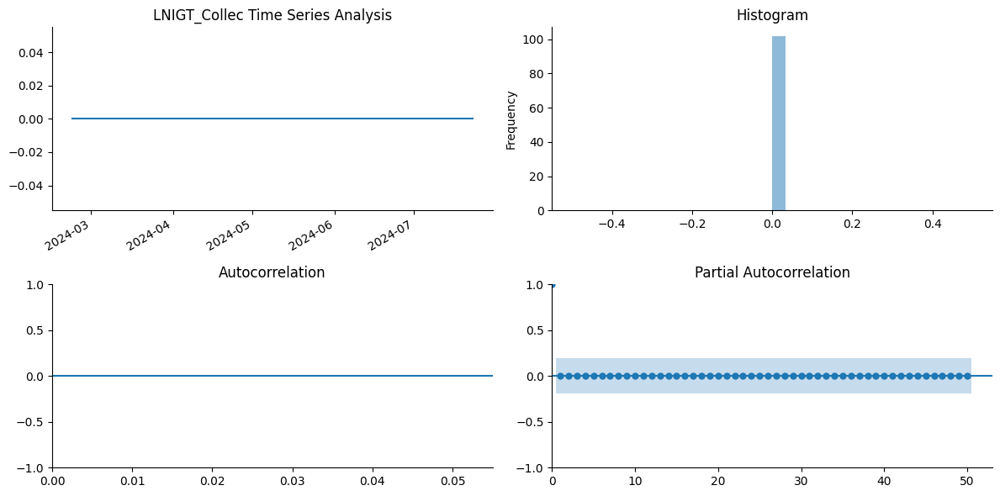

Processing series: LNHET_Collec


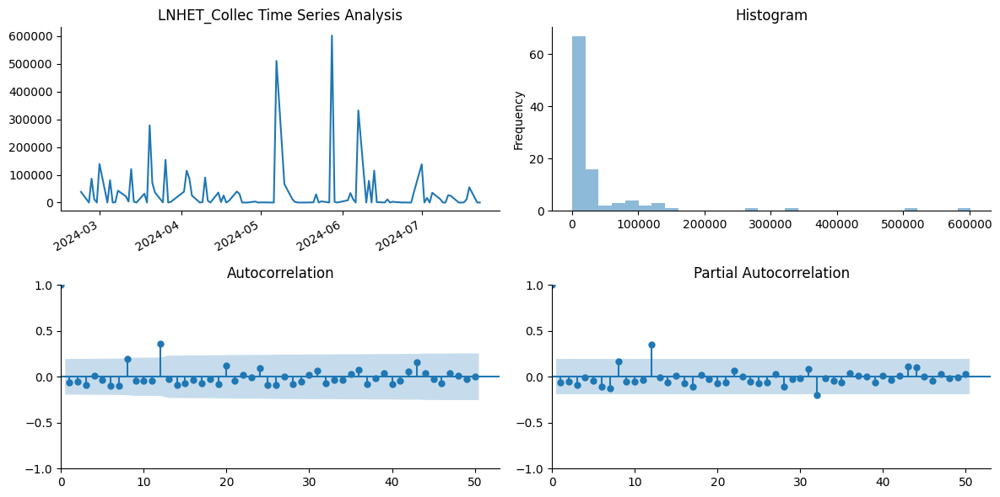

Processing series: LNHEC_Collec


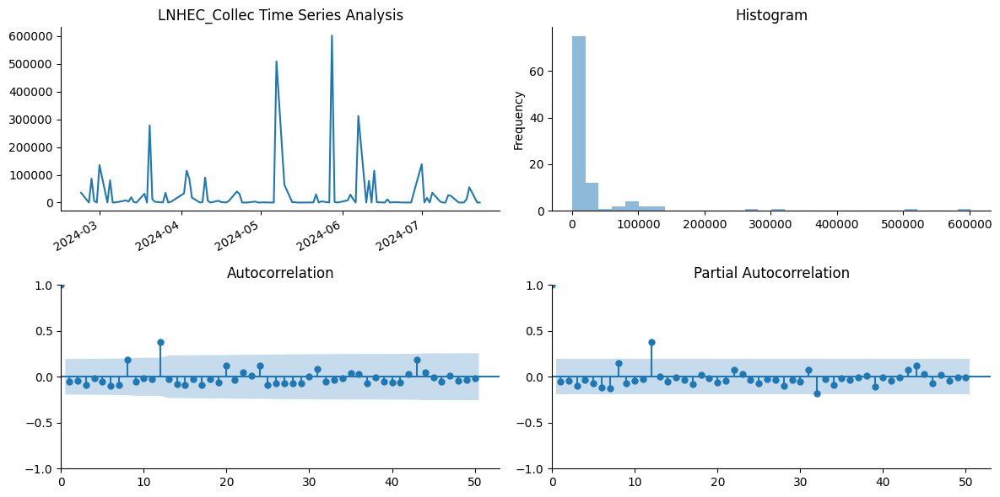

Processing series: LNHEP_Collec


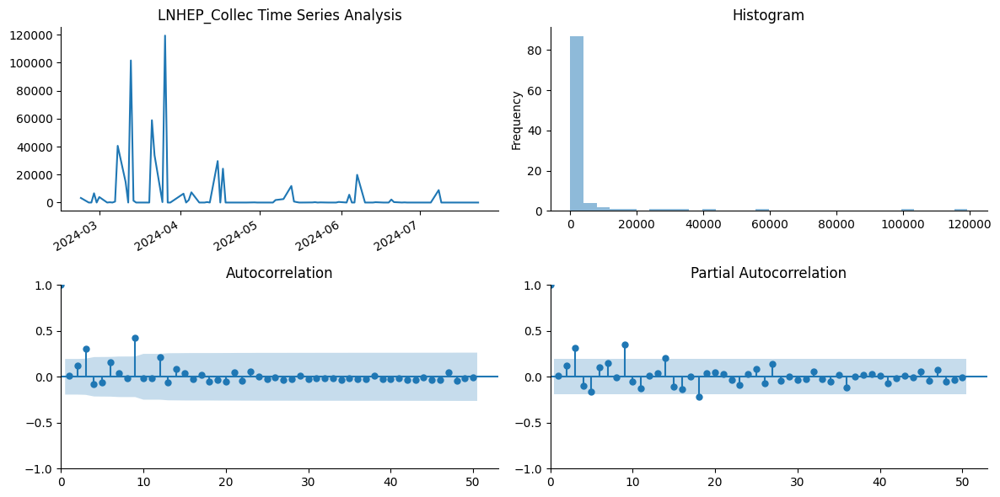

Processing series: LNHER_Collec


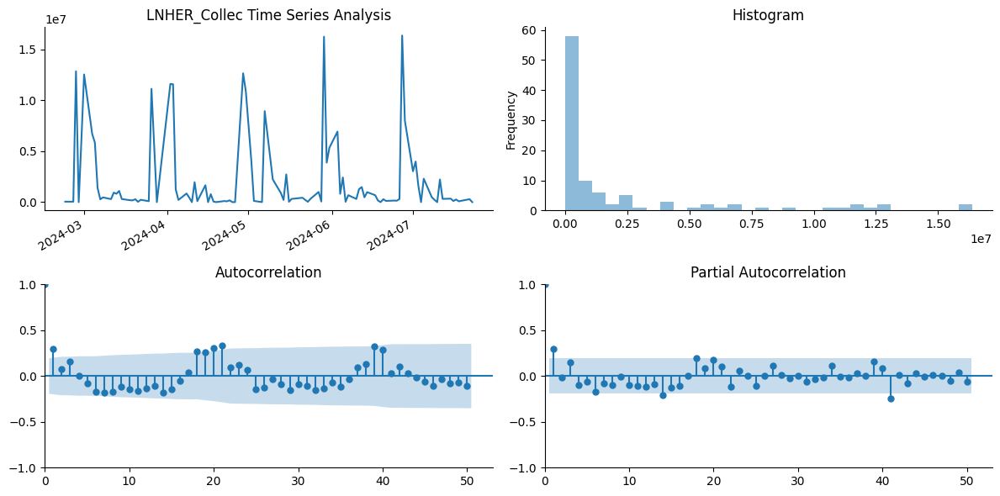

Processing series: LNLOA_Collec


c:\Users\UT3NDP\My_IT_Applications\test_gitlab\venv\Lib\site-packages\statsmodels\tsa\stattools.py:693: RuntimeWarning: invalid value encountered in divide
  acf = avf[: nlags + 1] / avf[0]
c:\Users\UT3NDP\My_IT_Applications\test_gitlab\venv\Lib\site-packages\statsmodels\regression\linear_model.py:1491: ValueWarning: Matrix is singular. Using pinv.
  warnings.warn("Matrix is singular. Using pinv.", ValueWarning)


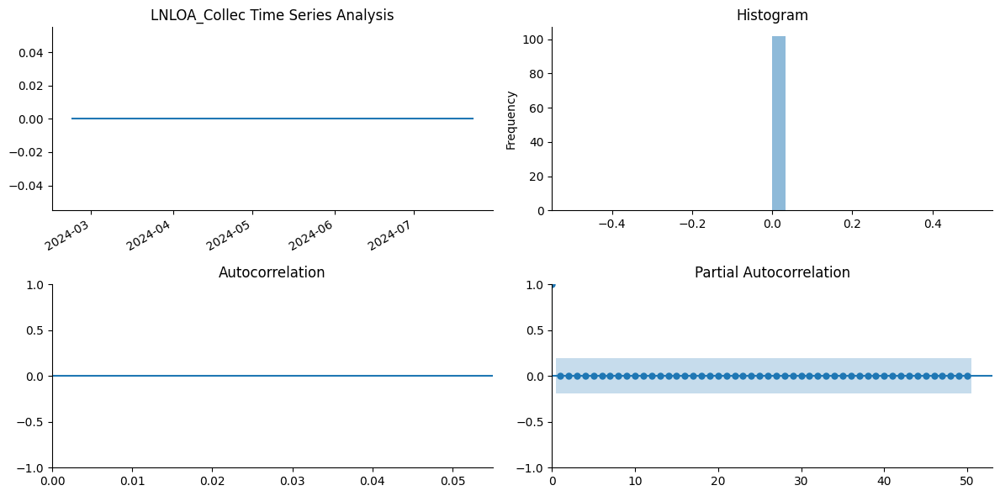

Processing series: LNTI2_Collec


c:\Users\UT3NDP\My_IT_Applications\test_gitlab\venv\Lib\site-packages\statsmodels\tsa\stattools.py:693: RuntimeWarning: invalid value encountered in divide
  acf = avf[: nlags + 1] / avf[0]
c:\Users\UT3NDP\My_IT_Applications\test_gitlab\venv\Lib\site-packages\statsmodels\regression\linear_model.py:1491: ValueWarning: Matrix is singular. Using pinv.
  warnings.warn("Matrix is singular. Using pinv.", ValueWarning)


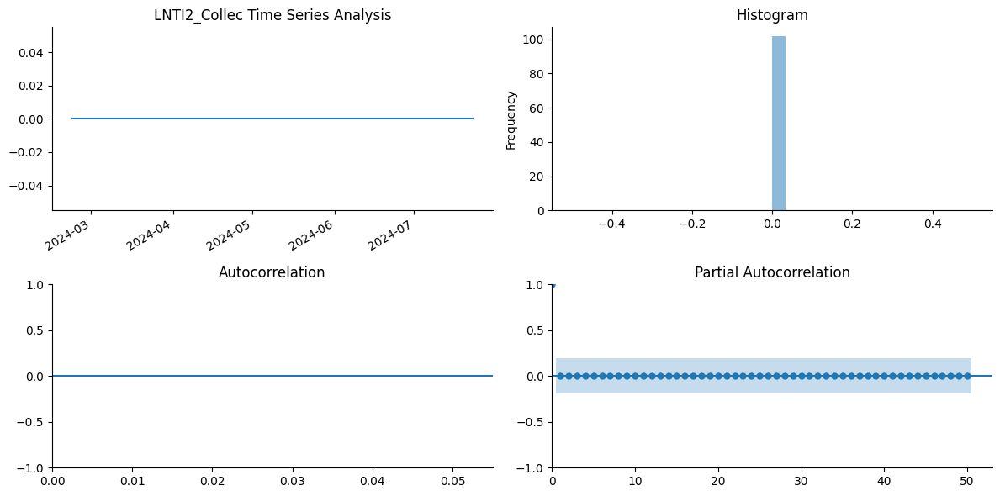

Processing series: LNT2N_Collec


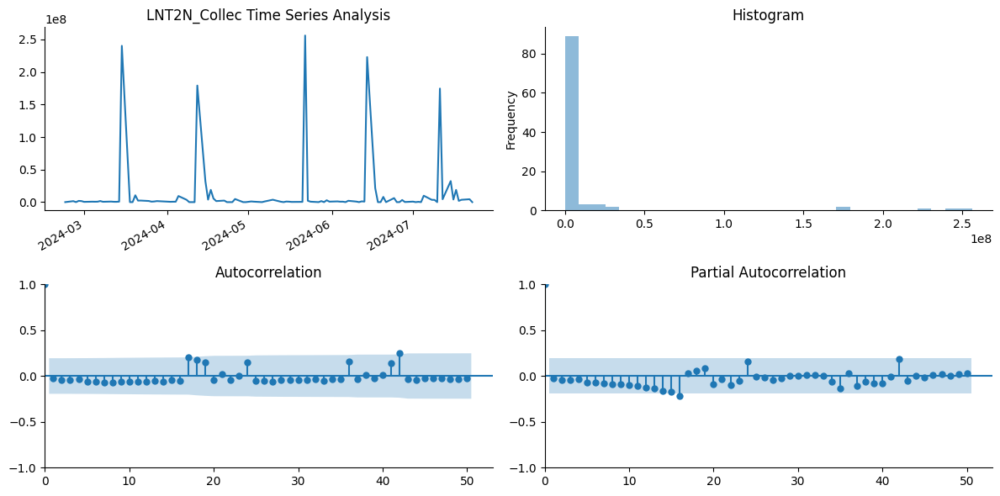

Processing series: LNT2E_Collec


c:\Users\UT3NDP\My_IT_Applications\test_gitlab\venv\Lib\site-packages\statsmodels\tsa\stattools.py:693: RuntimeWarning: invalid value encountered in divide
  acf = avf[: nlags + 1] / avf[0]
c:\Users\UT3NDP\My_IT_Applications\test_gitlab\venv\Lib\site-packages\statsmodels\regression\linear_model.py:1491: ValueWarning: Matrix is singular. Using pinv.
  warnings.warn("Matrix is singular. Using pinv.", ValueWarning)


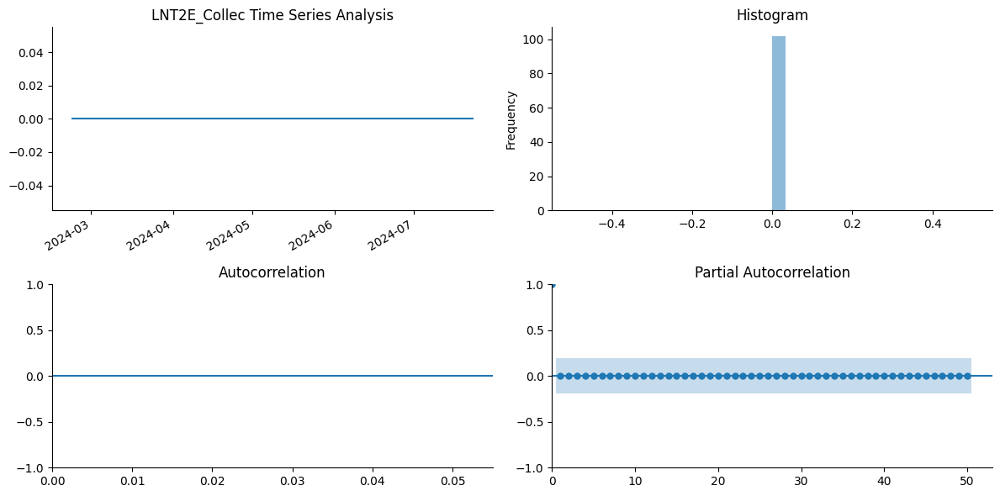

Processing series: LNTI3_Collec


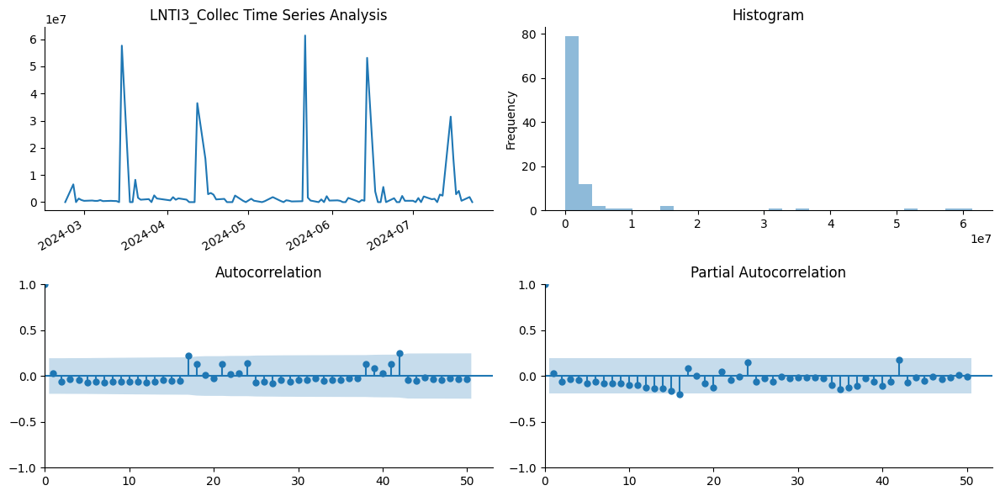

Processing series: LNTIC_Collec


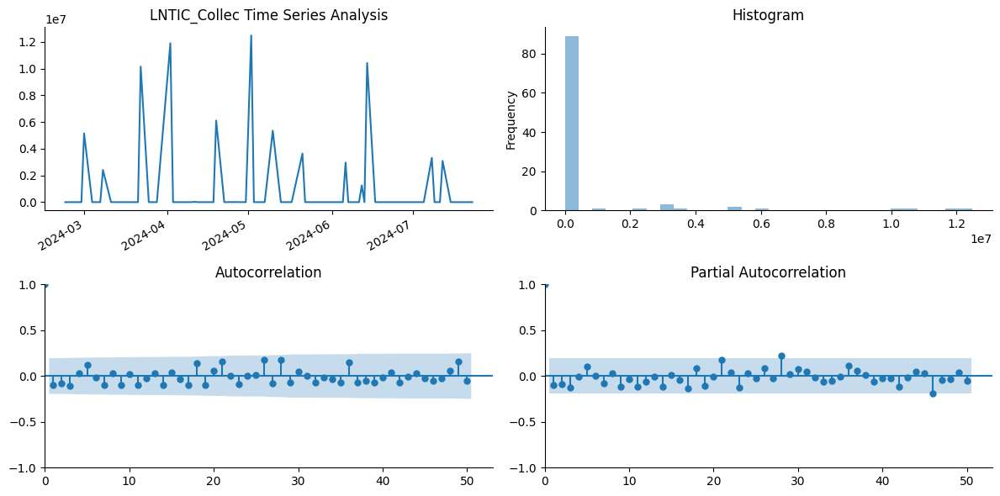

In [186]:
# Define the tsplot function
def tsplot(y, lags=None, title='', figsize=(12, 6)):
    fig = plt.figure(figsize=figsize)
    layout = (2, 2)
    ts_ax   = plt.subplot2grid(layout, (0, 0))
    hist_ax = plt.subplot2grid(layout, (0, 1))
    acf_ax  = plt.subplot2grid(layout, (1, 0))
    pacf_ax = plt.subplot2grid(layout, (1, 1))
   
    y.plot(ax=ts_ax)
    ts_ax.set_title(title)
    y.plot(ax=hist_ax, kind='hist', bins=30, alpha=.5)
    hist_ax.set_title('Histogram')
    smt.graphics.plot_acf(y, lags=lags, ax=acf_ax)
    smt.graphics.plot_pacf(y, lags=lags, ax=pacf_ax)
    [ax.set_xlim(0) for ax in [acf_ax, pacf_ax]]
    sns.despine()
    plt.tight_layout()
   
    return ts_ax, acf_ax, pacf_ax

# Iterate over each series in the DataFrame and apply tsplot
for series_name in data_series_it.columns:
    print(f"Processing series: {series_name}")
    ts_data = data_series_it[series_name]
   
    # Ensure the data is numeric and drop NaN values
    ts_data = pd.to_numeric(ts_data, errors='coerce').dropna()
   
    # Calculate the maximum number of lags allowed (50% of the sample size)
    max_lags = min(50, len(ts_data) // 2)

    # Plot the time series analysis for the current series
    tsplot(ts_data, lags=max_lags, title=f'{series_name} Time Series Analysis')
    plt.show()  # Display the plot for each series


The top subplot shows the time series of our residuals 
𝑒𝑡
, which should be white noise (but it isn't). The bottom shows the autocorrelation of the residuals as a correlogram. It measures the correlation between a value and it's lagged self, e.g. 
𝑐𝑜𝑟𝑟(𝑒𝑡,𝑒𝑡−1),𝑐𝑜𝑟𝑟(𝑒𝑡,𝑒𝑡−2),…
. The partial autocorrelation plot in the bottom-right shows a similar concept. It's partial in the sense that the value for 
𝑐𝑜𝑟𝑟(𝑒𝑡,𝑒𝑡−𝑘)
 is the correlation between those two periods, after controlling for the values at all shorter lags.
